In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import os
import shutil
import cython
from ripser import ripser, plot_dgms
from scipy.fftpack import fft,ifft
import wfdb
from scipy import signal
from gwpy.spectrogram import Spectrogram

In [2]:

def theStart(aString):
    print(aString)
    theSamp = wfdb.rdsamp('/home/dr-dunstan/Downloads/training2017/' + aString)
    #fields = wfdb.rdrecord('/home/dr-dunstan/Downloads/training2017/A00061')
    #wfdb.plot_wfdb(record=fields, title='Record A00061 from Physionet Challenge 2017')

    theX = []
    for i in range(0,len(theSamp[0])):
    #print(theSamp[0][i][0])
        theX.append(theSamp[0][i][0])


#print(theX)
    values, ybins, xbins, im = plt.specgram(theX,Fs=300)
    print(xbins)
    #plt.xlabel('Time')

    #plt.ylabel('Frequency')

 

    plt.show()
    theGoodList = stepTwo(values,ybins,xbins,im)
    print("good List")
    print(theGoodList)
    longSegment = getLongestSegment(theGoodList)
    print("longest")
    print(longSegment)
    signalVals = getSignalVals(longSegment,theX,xbins)
    #print("Samp")
    #print(signalVals)
    plotSave(signalVals,aString)
    

In [3]:
def stepTwo(values,ybins,xbins,im):
    #print(theVal)
    theVal = values.transpose() 
    minFreq = 0
    maxFreq = 50
    minFreqIndex = ""
    maxFreqIndex = ""
    theThreshold = .0000001

    countMode = 0

    if (minFreq == 0):
        minFreqIndex = 0
        countMode = 1

    for i in range(len(ybins)-1):
        if(ybins[i] < minFreq and ybins[i+1] > minFreq):
            minFreqIndex = i+1
        if(ybins[i] < maxFreq and ybins[i+1] > maxFreq):
            maxFreqIndex = i

#print(minFreqIndex)
#print(maxFreqIndex)

    theList = []
    theList2 = []
    theGoodList = []
    countMode = 0
    badMode = 0

    for i in range(len(theVal)):
        for j in range(len(theVal[i])):
        #if freq is too low 
            if(j < minFreqIndex):
                if(theVal[i][j] > theThreshold):
                #print("Bad freq exsists (Low) at " + str(i))
                    if(countMode == 0):
                        theList.append(i)
                        countMode += 1
            elif(j > maxFreqIndex):
                if(theVal[i][j] > theThreshold):
                #print("Bad freq exsists (High) at " + str(i)
                    badMode += 1
                    if(countMode == 1):
                        theList2.append(i)
                        countMode += 1
                    
        if(badMode == 0):
            theGoodList.append(i)
        else:
            badMode = 0
    
        countMode = 0
        if(minFreq == 0):
            countMode = 1
    #print(len(theList))
    #print(len(theList2))
    return (theGoodList)

In [4]:
maxLen = 0
first = 0 
last = 0
temp = 0

def getLongestSegment(aList):
    maxLen = 0
    first = 0
    if(len(aList) != 0):
        last = aList[0]
        first = aList[0]
    aTemp = []
    aTemp2 = []
    aTemp3 = []
    maxList = []
    finalList = []
    maxIndex = 0
    for i in range(0,len(aList) -1):
        aTemp.append(aList[i+1] - aList[i])
    
    print(aTemp)
    
    for i in range(len(aTemp)):
        if(aTemp[i] != 1):
            aTemp[i] = "NO"
            
            
    
    for i in range(len(aTemp)):
        if(aTemp[i] != 1):
            aTemp3.append(aTemp2)
            aTemp2 = []
        else:
            aTemp2.append(i+1)
            #finTemp.append
    
    print("the temp 3")
    print(aTemp3)
    
    for element in aTemp3:
        if(maxIndex < len(element)):
            maxList = element
            maxIndex = len(element)
    
    for element in maxList:
        finalList.append(aList[element])
    
    #print(maxList)
    if(len(maxList) != 0):
        finalList.insert(0, aList[maxList[0]] - 1)
        
    
    print(finalList)    
    return(finalList)


def getSignalVals(aList,theSamp,timeList):
    theMin = 0
    theMax = 0
    print("indexList")
    print(aList)
    if(len(aList) != 0):
        theMin = int(timeList[aList[0]]) * 300
        theMax = int(timeList[aList[len(aList)-1]]) *300
        if(theMin == theMax):
            theMax = 300 + theMax
    print("theMin")
    print(theMin)
    print("theMax")
    print(theMax)
    #print(theSamp[theMin:theMax+1])
    return(theSamp[theMin:theMax+1])

#theFinal = getLongestSegment(theGoodList)
#theCleaned = getSignalVals(theFinal)
#print(theCleaned)



In [5]:
#nm#wfdb.wrsamp("A00061_clean",fs=300,sig_name=["ECG"],p_signal=theCleaned,units=["mV"],fmt=['16', '16'])

In [6]:
def plotSave(aList,aString):
    #print(aList)
    x = np.arange(len(aList))
    theCleanedFin = []
    for i in range(0,len(aList)):
        if(len(aList) > 1):
            theCleanedFin.append(aList[i])
        else:
            theCleanedFin.append(aList[i])
        
    y = theCleanedFin

    plt.plot(x,y)
    plt.show()
    z = open(aString +".txt","w")
    for i in range(len(aList)):
        z.write(str(aList[i])+"\n")
    z.close()

A00008
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

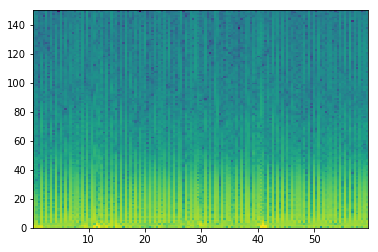

good List
[2, 6, 12, 31, 35, 37, 39, 43, 47, 49, 51, 55, 57, 62, 72, 74, 77, 83, 85, 87, 90, 100, 102, 111, 115, 119, 126, 130, 132, 134]
[4, 6, 19, 4, 2, 2, 4, 4, 2, 2, 4, 2, 5, 10, 2, 3, 6, 2, 2, 3, 10, 2, 9, 4, 4, 7, 4, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


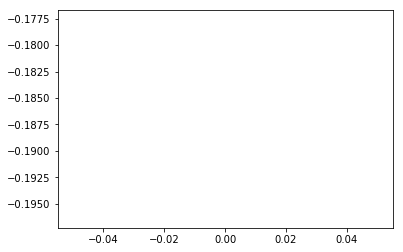

A00013
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


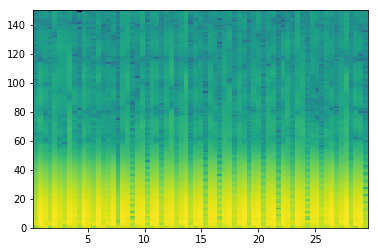

good List
[17, 23, 26, 32, 35, 41, 44, 50, 53, 65, 68]
[6, 3, 6, 3, 6, 3, 6, 3, 12, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


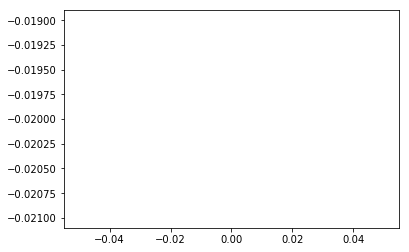

A00017
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


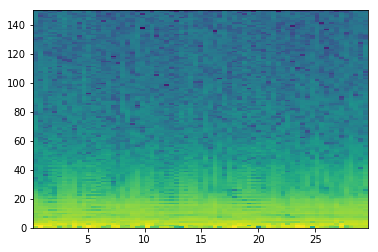

good List
[17, 26, 36, 39]
[9, 10, 3]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


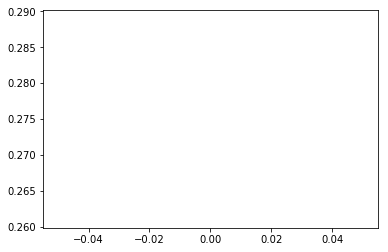

A00020
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


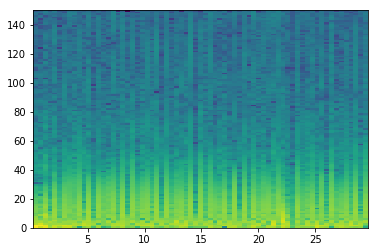

good List
[5, 12, 14, 17, 21, 28, 33, 37, 41, 48, 53, 60]
[7, 2, 3, 4, 7, 5, 4, 4, 7, 5, 7]
the temp 3
[[], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


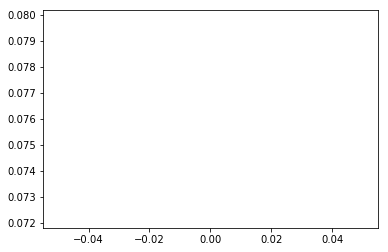

A00023
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


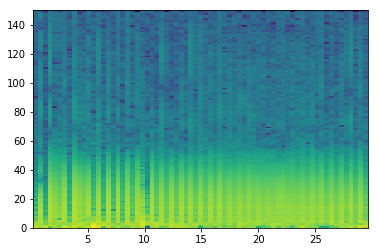

good List
[0, 2, 7, 14, 18, 23, 25, 31, 60, 64, 68]
[2, 5, 7, 4, 5, 2, 6, 29, 4, 4]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


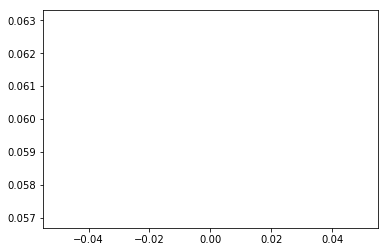

A00024
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


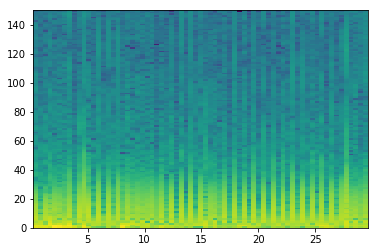

good List
[6, 8, 14, 18, 25, 29, 31, 34, 38, 40, 42, 44, 46, 48, 50, 52, 54, 60, 62, 63]
[2, 6, 4, 7, 4, 2, 3, 4, 2, 2, 2, 2, 2, 2, 2, 2, 6, 2, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


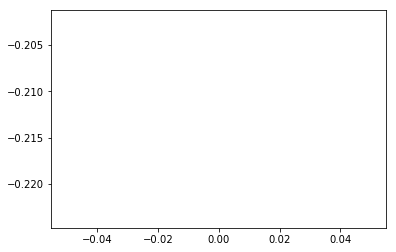

A00029
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


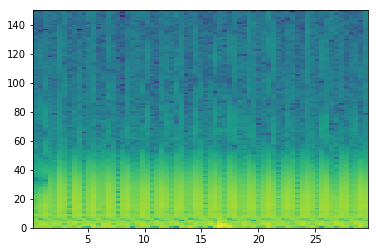

good List
[1, 7, 24, 31, 39, 50, 58]
[6, 17, 7, 8, 11, 8]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


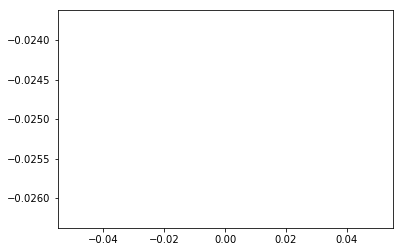

A00030
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

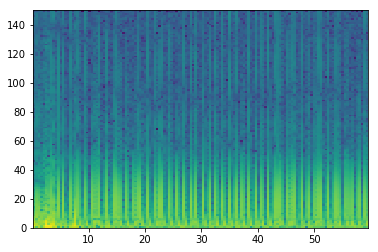

good List
[9, 11, 13, 14, 16, 20, 22, 23, 28, 29, 31, 32, 35, 37, 40, 42, 46, 48, 49, 51, 54, 55, 57, 58, 60, 61, 63, 64, 66, 68, 69, 71, 72, 74, 77, 79, 80, 82, 83, 85, 88, 90, 91, 93, 96, 98, 99, 103, 104, 109, 110, 112, 113, 115, 120, 121, 123, 128, 131, 132, 133, 136]
[2, 2, 1, 2, 4, 2, 1, 5, 1, 2, 1, 3, 2, 3, 2, 4, 2, 1, 2, 3, 1, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 2, 3, 2, 1, 2, 3, 2, 1, 4, 1, 5, 1, 2, 1, 2, 5, 1, 2, 5, 3, 1, 1, 3]
the temp 3
[[], [], [3], [], [], [7], [9], [11], [], [], [], [], [], [18], [], [21], [23], [25], [27], [], [30], [32], [], [], [36], [38], [], [], [42], [], [], [46], [48], [50], [52], [], [55], [], [], [59, 60]]
[131, 132, 133]
longest
[131, 132, 133]
indexList
[131, 132, 133]
theMin
16800
theMax
17100


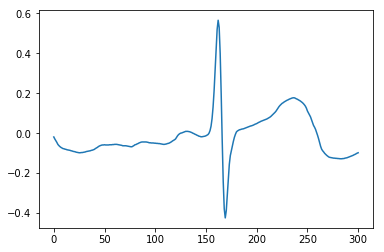

A00038
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


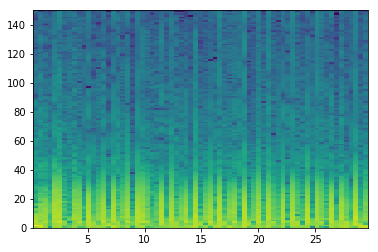

good List
[3, 13, 15, 20, 27, 32, 62, 64, 65]
[10, 2, 5, 7, 5, 30, 2, 1]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


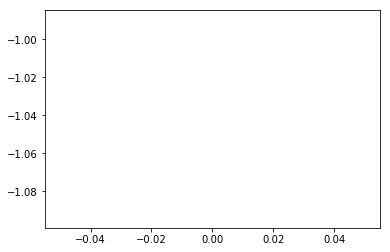

A00041
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


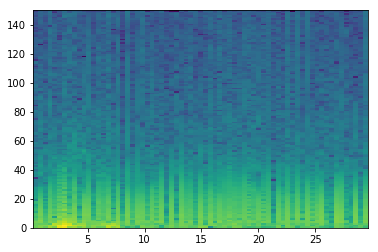

good List
[18, 27, 49]
[9, 22]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


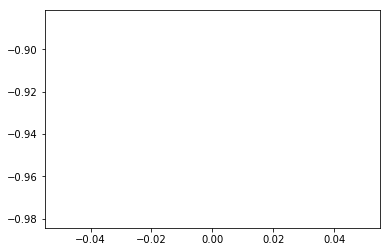

A00043
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

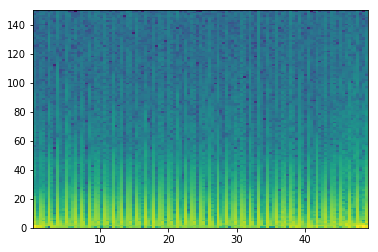

good List
[1, 2, 3, 4, 7, 9, 10, 13, 15, 18, 20, 23, 25, 26, 28, 29, 31, 32, 33, 34, 36, 37, 39, 40, 42, 43, 44, 45, 48, 50, 51, 52, 53, 54, 56, 57, 59, 61, 62, 64, 65, 67, 68, 72, 73, 75, 76, 78, 79, 81, 82, 84, 85, 87, 89, 90, 92, 93, 95, 96, 98, 99, 101, 102, 104, 112]
[1, 1, 1, 3, 2, 1, 3, 2, 3, 2, 3, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 3, 2, 1, 1, 1, 1, 2, 1, 2, 2, 1, 2, 1, 2, 1, 4, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 8]
the temp 3
[[1, 2, 3], [], [6], [], [], [], [], [], [13], [15], [17, 18, 19], [21], [23], [25, 26, 27], [], [30, 31, 32, 33], [35], [], [38], [40], [42], [44], [46], [48], [50], [52], [], [55], [57], [59], [61], [63], []]
[50, 51, 52, 53, 54]
longest
[50, 51, 52, 53, 54]
indexList
[50, 51, 52, 53, 54]
theMin
6300
theMax
6900


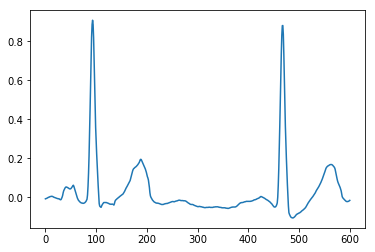

A00047
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


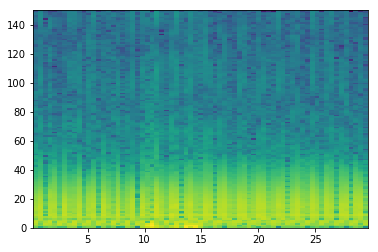

good List
[5, 10, 12, 13, 15, 18, 21, 41, 65, 68]
[5, 2, 1, 2, 3, 3, 20, 24, 3]
the temp 3
[[], [], [3], [], [], [], [], []]
[12, 13]
longest
[12, 13]
indexList
[12, 13]
theMin
1500
theMax
1800


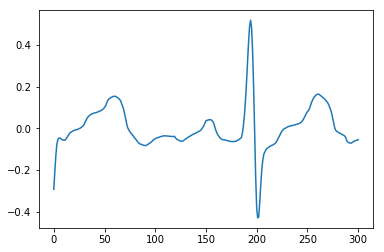

A00055
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


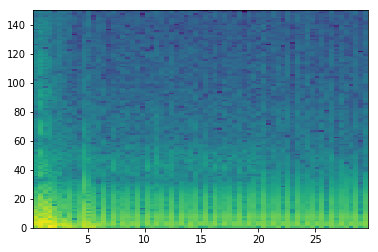

good List
[53, 62, 64, 67]
[9, 2, 3]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


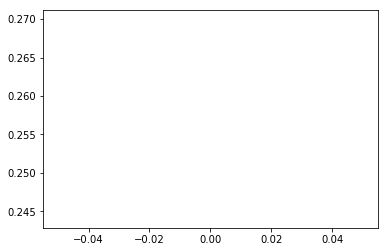

A00058
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

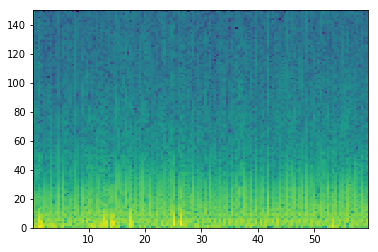

good List
[4, 5, 6, 11, 16, 19, 31, 36, 48, 59, 72, 76, 93, 96, 101, 114, 126]
[1, 1, 5, 5, 3, 12, 5, 12, 11, 13, 4, 17, 3, 5, 13, 12]
the temp 3
[[1, 2], [], [], [], [], [], [], [], [], [], [], [], [], []]
[4, 5, 6]
longest
[4, 5, 6]
indexList
[4, 5, 6]
theMin
600
theMax
900


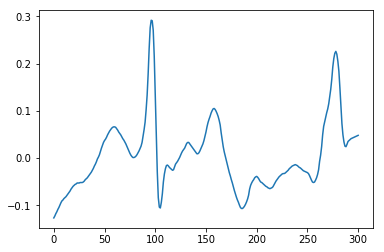

A00061
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


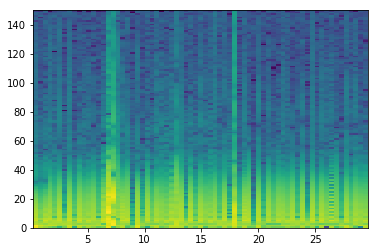

good List
[0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 20, 21, 22, 24, 31, 33, 35, 38, 40, 42, 45, 47, 48, 49, 51, 52, 53, 54, 56, 58, 59, 60, 61, 63, 65, 67, 68]
[1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 7, 1, 1, 2, 7, 2, 2, 3, 2, 2, 3, 2, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 2, 2, 1]
the temp 3
[[1, 2, 3, 4, 5, 6], [8, 9, 10, 11, 12], [14, 15], [], [], [], [], [], [], [], [], [25, 26], [28, 29, 30], [], [33, 34, 35], [], []]
[0, 1, 2, 3, 4, 5, 6]
longest
[0, 1, 2, 3, 4, 5, 6]
indexList
[0, 1, 2, 3, 4, 5, 6]
theMin
0
theMax
600


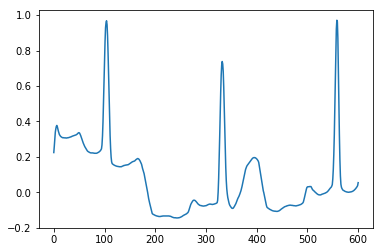

A00065
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333]


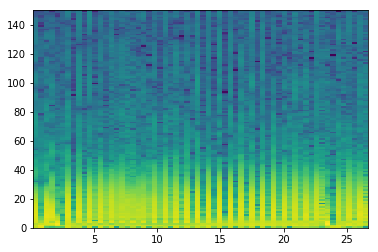

good List
[7, 13, 19, 20, 23, 27, 29, 33, 35, 37, 41, 43, 45, 59]
[6, 6, 1, 3, 4, 2, 4, 2, 2, 4, 2, 2, 14]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], [], []]
[19, 20]
longest
[19, 20]
indexList
[19, 20]
theMin
2400
theMax
2700


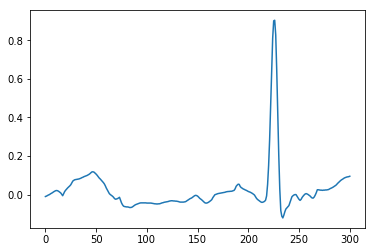

A00069
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


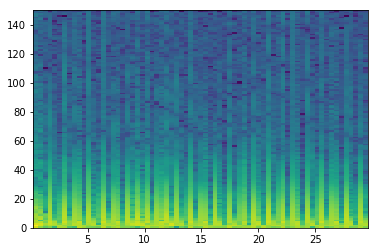

good List
[2, 4, 5, 7, 8, 10, 12, 13, 15, 16, 18, 19, 20, 22, 24, 25, 28, 30, 31, 33, 34, 36, 38, 39, 41, 42, 44, 46, 47, 49, 50, 51, 52, 54, 55, 58, 60, 61, 63, 65, 66, 67, 68]
[2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 3, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 3, 2, 1, 2, 2, 1, 1, 1]
the temp 3
[[], [2], [4], [], [7], [9], [11, 12], [], [15], [], [18], [20], [], [23], [25], [], [28], [30, 31, 32], [34], [], [37], []]
[49, 50, 51, 52]
longest
[49, 50, 51, 52]
indexList
[49, 50, 51, 52]
theMin
6300
theMax
6600


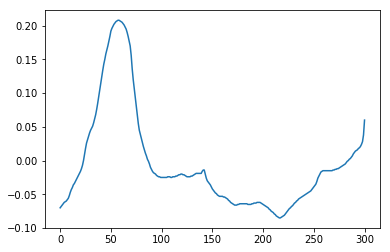

A00070
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


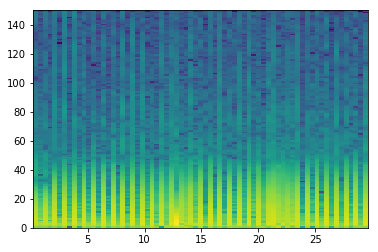

good List
[7, 9, 11, 13, 15, 17, 19, 21, 23, 24, 43, 45, 47, 55, 57, 61, 67]
[2, 2, 2, 2, 2, 2, 2, 2, 1, 19, 2, 2, 8, 2, 4, 6]
the temp 3
[[], [], [], [], [], [], [], [], [9], [], [], [], [], [], []]
[23, 24]
longest
[23, 24]
indexList
[23, 24]
theMin
3000
theMax
3300


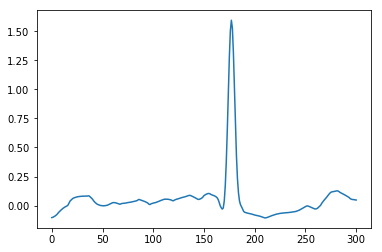

A00074
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


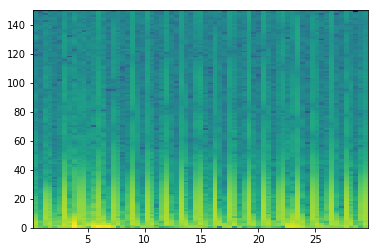

good List
[0, 1, 2, 4, 5, 9, 10, 11, 12, 15, 18, 19, 21, 22, 25, 26, 28, 29, 32, 33, 35, 36, 38, 39, 42, 43, 45, 46, 48, 49, 50, 55, 56, 59, 60, 62, 63, 65, 66, 67]
[1, 1, 2, 1, 4, 1, 1, 1, 3, 3, 1, 2, 1, 3, 1, 2, 1, 3, 1, 2, 1, 2, 1, 3, 1, 2, 1, 2, 1, 1, 5, 1, 3, 1, 2, 1, 2, 1, 1]
the temp 3
[[1, 2], [4], [6, 7, 8], [], [11], [13], [15], [17], [19], [21], [23], [25], [27], [29, 30], [32], [34], [36]]
[9, 10, 11, 12]
longest
[9, 10, 11, 12]
indexList
[9, 10, 11, 12]
theMin
1200
theMax
1500


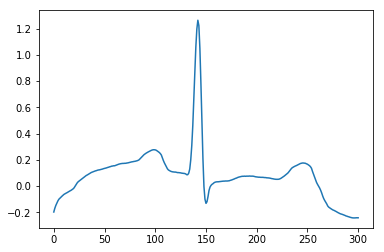

A00075
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


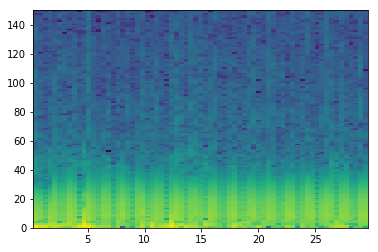

good List
[16, 20, 25, 26, 27, 38, 39, 50, 52, 54, 58, 59, 64, 65, 66, 68]
[4, 5, 1, 1, 11, 1, 11, 2, 2, 4, 1, 5, 1, 1, 2]
the temp 3
[[], [], [3, 4], [6], [], [], [], [11], [13, 14]]
[25, 26, 27]
longest
[25, 26, 27]
indexList
[25, 26, 27]
theMin
3300
theMax
3600


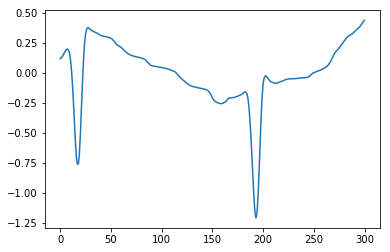

A00077
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


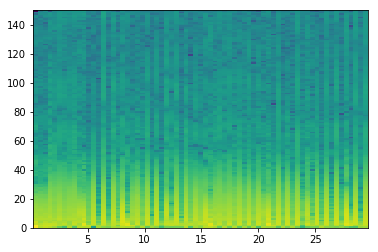

good List
[1, 2, 9, 11, 13, 15, 17, 20, 22, 24, 26, 30, 32, 34, 43, 45, 47, 49, 51, 53, 55, 59, 61, 63, 65, 67]
[1, 7, 2, 2, 2, 2, 3, 2, 2, 2, 4, 2, 2, 9, 2, 2, 2, 2, 2, 2, 4, 2, 2, 2, 2]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


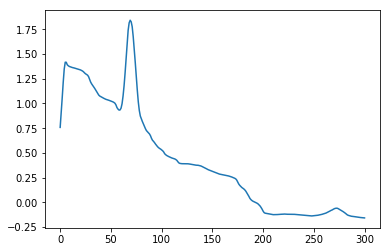

A00078
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

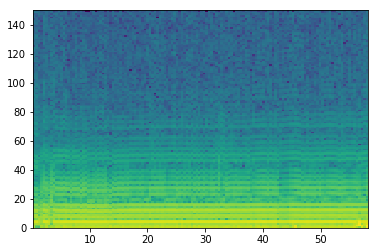

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


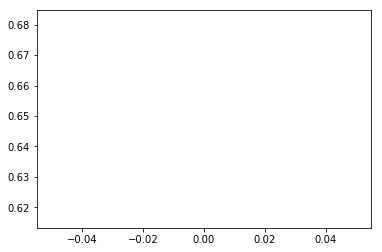

A00082
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


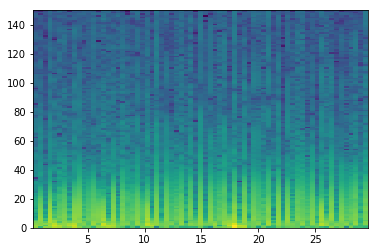

good List
[2, 11, 13, 35, 44, 51, 58, 62, 63, 64]
[9, 2, 22, 9, 7, 7, 4, 1, 1]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


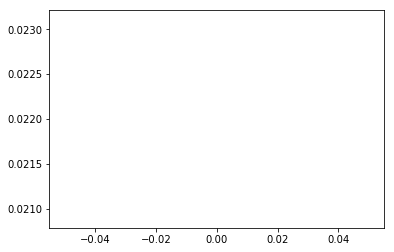

A00083
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

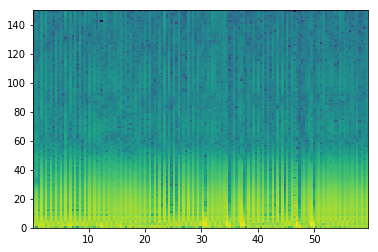

good List
[0, 4, 6, 8, 10, 12, 14, 20, 24, 35, 38, 39, 41, 47, 49, 51, 53, 55, 57, 59, 61, 63, 65, 71, 78, 81, 82, 84, 85, 87, 88, 90, 92, 94, 96, 98, 100, 102, 104, 106, 110, 113, 116, 117, 119, 125, 131, 133, 135, 137]
[4, 2, 2, 2, 2, 2, 6, 4, 11, 3, 1, 2, 6, 2, 2, 2, 2, 2, 2, 2, 2, 2, 6, 7, 3, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 3, 3, 1, 2, 6, 6, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [11], [], [], [], [], [], [], [], [], [], [], [], [], [], [26], [28], [30], [], [], [], [], [], [], [], [], [], [], [], [43], [], [], [], [], []]
[38, 39]
longest
[38, 39]
indexList
[38, 39]
theMin
4800
theMax
5100


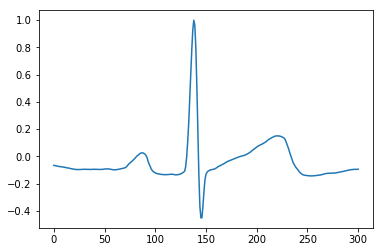

A00088
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


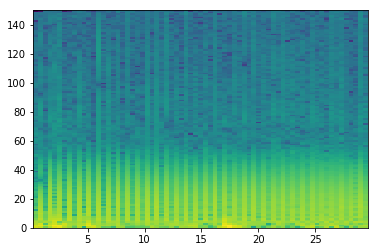

good List
[2, 6, 8, 12, 14, 18, 32, 34, 44, 46, 66]
[4, 2, 4, 2, 4, 14, 2, 10, 2, 20]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


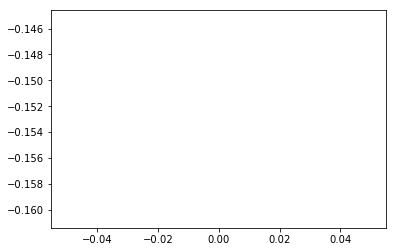

A00092
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


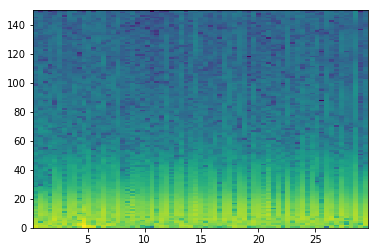

good List
[67]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


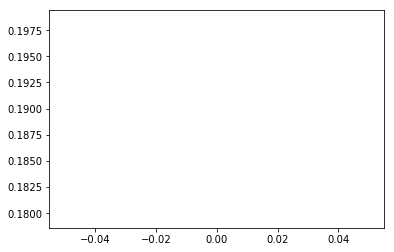

A00096
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

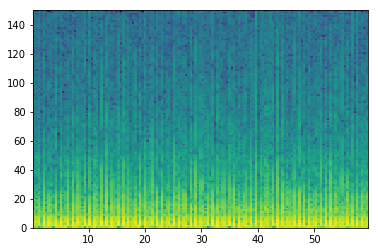

good List
[0, 3, 5, 8, 10, 12, 13, 15, 17, 20, 22, 24, 27, 29, 34, 36, 38, 40, 41, 43, 45, 47, 50, 52, 54, 57, 59, 64, 66, 68, 73, 75, 77, 80, 84, 86, 88, 89, 91, 93, 100, 102, 104, 107, 109, 113, 115, 120, 122, 124, 129, 131, 133]
[3, 2, 3, 2, 2, 1, 2, 2, 3, 2, 2, 3, 2, 5, 2, 2, 2, 1, 2, 2, 2, 3, 2, 2, 3, 2, 5, 2, 2, 5, 2, 2, 3, 4, 2, 2, 1, 2, 2, 7, 2, 2, 3, 2, 4, 2, 5, 2, 2, 5, 2, 2]
the temp 3
[[], [], [], [], [], [6], [], [], [], [], [], [], [], [], [], [], [18], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [37], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[12, 13]
longest
[12, 13]
indexList
[12, 13]
theMin
1500
theMax
1800


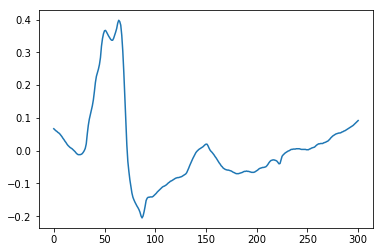

A00100
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


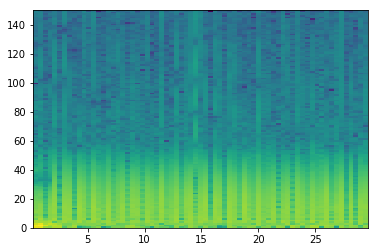

good List
[8, 25, 30, 36, 66]
[17, 5, 6, 30]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


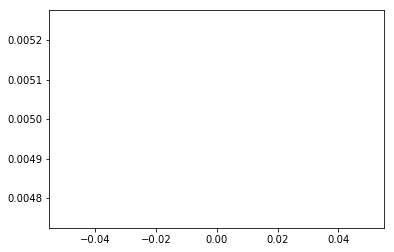

A00103
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

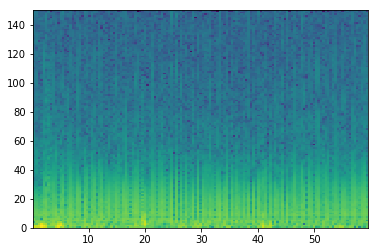

good List
[2, 13, 17, 19, 20, 22, 26, 27, 28, 29, 31, 32, 33, 34, 36, 40, 42, 44, 47, 50, 51, 58, 60, 61, 62, 64, 65, 67, 69, 70, 71, 72, 74, 75, 77, 78, 79, 81, 82, 83, 84, 85, 86, 88, 89, 90, 92, 93, 96, 97, 99, 101, 102, 104, 105, 106, 109, 110, 112, 113, 114, 116, 119, 121, 123, 124, 126, 127, 128, 129, 130, 131, 134, 135, 136, 138]
[11, 4, 2, 1, 2, 4, 1, 1, 1, 2, 1, 1, 1, 2, 4, 2, 2, 3, 3, 1, 7, 2, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 3, 1, 2, 2, 1, 2, 1, 1, 3, 1, 2, 1, 1, 2, 3, 2, 2, 1, 2, 1, 1, 1, 1, 1, 3, 1, 1, 2]
the temp 3
[[], [], [], [4], [], [7, 8, 9], [11, 12, 13], [], [], [], [], [], [20], [], [23, 24], [26], [], [29, 30, 31], [33], [35, 36], [38, 39, 40, 41, 42], [44, 45], [47], [49], [], [52], [54, 55], [57], [59, 60], [], [], [], [65], [67, 68, 69, 70, 71], [73, 74]]
[81, 82, 83, 84, 85, 86]
longest
[81, 82, 83, 84, 85, 86]
indexList
[81, 82, 83, 84, 85, 86]
theMin
10200
theMax
11100


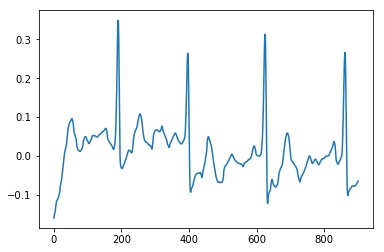

A00108
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

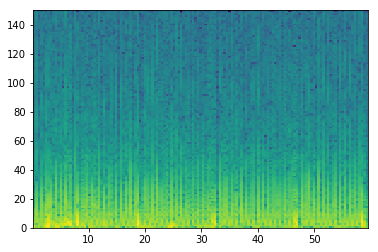

good List
[0, 2, 3, 4, 16, 19, 26, 28, 30, 33, 35, 41, 44, 45, 50, 52, 56, 58, 60, 65, 67, 69, 71, 76, 81, 83, 85, 87, 88, 89, 92, 94, 98, 99, 101, 103, 107, 110, 115, 117, 119, 121, 123, 124, 126, 128, 130, 132, 134, 138]
[2, 1, 1, 12, 3, 7, 2, 2, 3, 2, 6, 3, 1, 5, 2, 4, 2, 2, 5, 2, 2, 2, 5, 5, 2, 2, 2, 1, 1, 3, 2, 4, 1, 2, 2, 4, 3, 5, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 4]
the temp 3
[[], [2, 3], [], [], [], [], [], [], [], [], [13], [], [], [], [], [], [], [], [], [], [], [], [], [], [28, 29], [], [], [33], [], [], [], [], [], [], [], [], [43], [], [], [], [], []]
[2, 3, 4]
longest
[2, 3, 4]
indexList
[2, 3, 4]
theMin
300
theMax
600


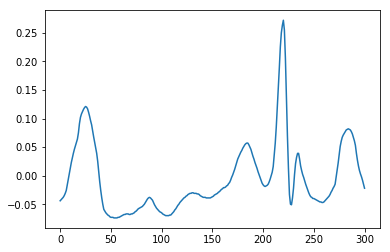

A00110
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


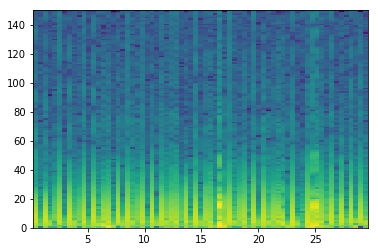

good List
[1, 2, 3, 4, 6, 8, 9, 11, 13, 14, 15, 16, 17, 18, 20, 21, 23, 25, 30, 31, 32, 34, 35, 37, 39, 41, 42, 44, 46, 48, 49, 51, 52, 54, 55, 59, 60, 62, 64, 66, 68]
[1, 1, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 2, 2, 5, 1, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 1, 2, 1, 4, 1, 2, 2, 2, 2]
the temp 3
[[1, 2, 3], [], [6], [], [9, 10, 11, 12, 13], [15], [], [], [19, 20], [22], [], [], [26], [], [], [30], [32], [34], [36], [], [], []]
[13, 14, 15, 16, 17, 18]
longest
[13, 14, 15, 16, 17, 18]
indexList
[13, 14, 15, 16, 17, 18]
theMin
1500
theMax
2400


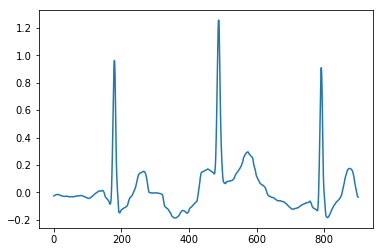

A00114
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


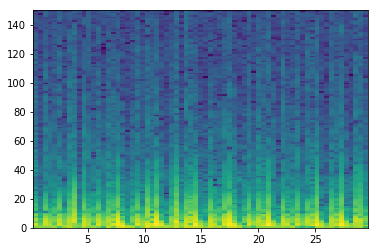

good List
[1, 3, 4, 5, 6, 9, 12, 14, 16, 18, 19, 20, 22, 24, 26, 27, 28, 30, 32, 34, 35, 37, 38, 42, 43, 45, 47, 49, 50, 51, 52, 53, 55, 59, 60, 62, 64, 65, 68]
[2, 1, 1, 1, 3, 3, 2, 2, 2, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 1, 4, 1, 2, 2, 2, 1, 1, 1, 1, 2, 4, 1, 2, 2, 1, 3]
the temp 3
[[], [2, 3, 4], [], [], [], [], [10, 11], [], [], [15, 16], [], [], [20], [22], [24], [], [], [28, 29, 30, 31], [], [34], [], [37]]
[49, 50, 51, 52, 53]
longest
[49, 50, 51, 52, 53]
indexList
[49, 50, 51, 52, 53]
theMin
6300
theMax
6900


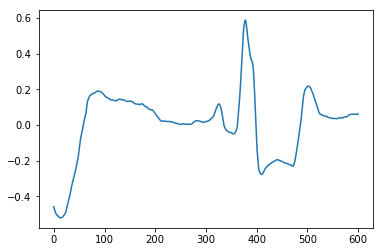

A00115
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


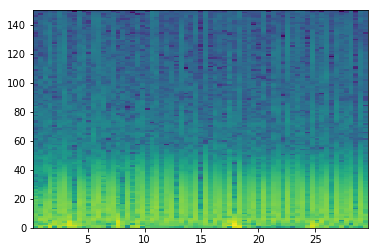

good List
[48]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


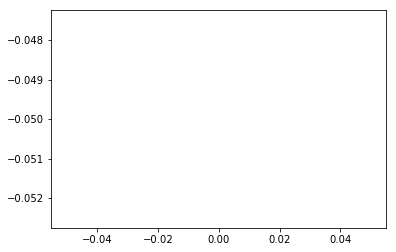

A00119
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


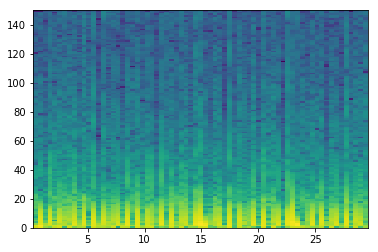

good List
[2, 13, 25, 29, 39, 41, 44, 46, 51, 60, 63]
[11, 12, 4, 10, 2, 3, 2, 5, 9, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


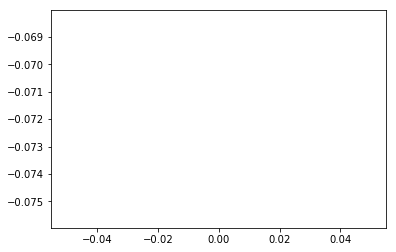

A00120
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

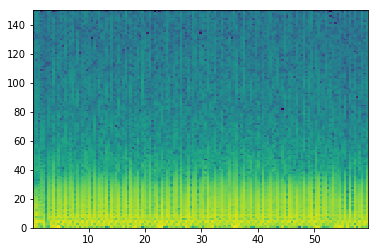

good List
[4, 5, 7, 9, 11, 16, 18, 19, 26, 33, 36, 37, 39, 42, 44, 49, 52, 54, 60, 62, 65, 79, 85, 92, 94, 101, 102, 105, 107, 108, 110, 113, 122, 124, 130, 131, 132, 134, 136, 137]
[1, 2, 2, 2, 5, 2, 1, 7, 7, 3, 1, 2, 3, 2, 5, 3, 2, 6, 2, 3, 14, 6, 7, 2, 7, 1, 3, 2, 1, 2, 3, 9, 2, 6, 1, 1, 2, 2, 1]
the temp 3
[[1], [], [], [], [], [7], [], [], [11], [], [], [], [], [], [], [], [], [], [], [], [], [], [26], [], [29], [], [], [], [], [35, 36], []]
[130, 131, 132]
longest
[130, 131, 132]
indexList
[130, 131, 132]
theMin
16500
theMax
16800


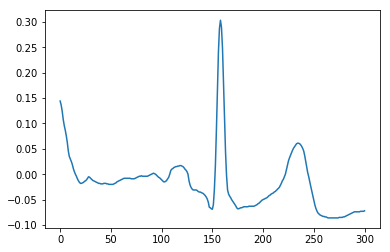

A00121
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


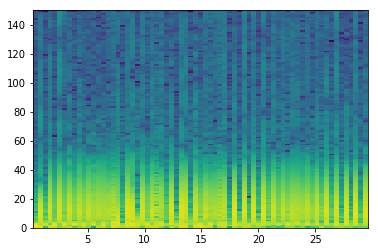

good List
[0, 2, 4, 6, 8, 10, 11, 12, 13, 15, 18, 21, 23, 24, 27, 29, 31, 32, 34, 35, 37, 40, 41, 42, 44, 46, 48, 50, 51, 52, 57, 59, 61, 63, 65, 67]
[2, 2, 2, 2, 2, 1, 1, 1, 2, 3, 3, 2, 1, 3, 2, 2, 1, 2, 1, 2, 3, 1, 1, 2, 2, 2, 2, 1, 1, 5, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [6, 7, 8], [], [], [], [13], [], [], [17], [19], [], [22, 23], [], [], [], [28, 29], [], [], [], [], []]
[10, 11, 12, 13]
longest
[10, 11, 12, 13]
indexList
[10, 11, 12, 13]
theMin
1200
theMax
1500


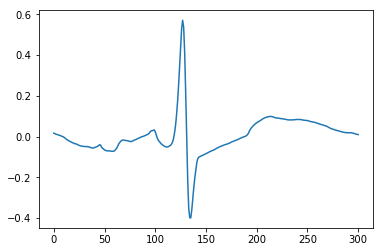

A00123
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


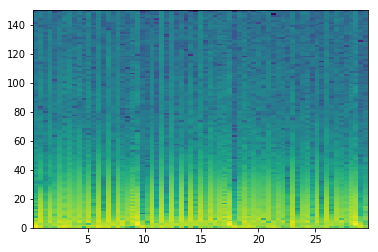

good List
[2, 10, 12, 14, 16, 18, 19, 22, 23, 25, 27, 29, 31, 33, 35, 37, 41, 50, 52, 54, 57, 59, 61, 64, 67, 68]
[8, 2, 2, 2, 2, 1, 3, 1, 2, 2, 2, 2, 2, 2, 2, 4, 9, 2, 2, 3, 2, 2, 3, 3, 1]
the temp 3
[[], [], [], [], [], [6], [8], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[18, 19]
longest
[18, 19]
indexList
[18, 19]
theMin
2400
theMax
2700


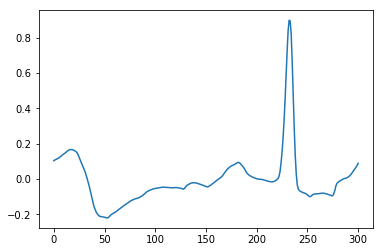

A00126
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


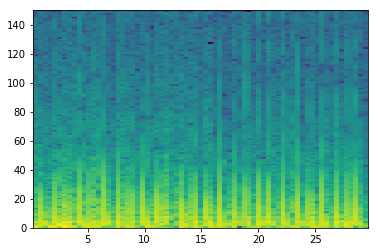

good List
[2, 16, 21, 24, 34, 37, 39, 40, 42, 47, 50, 57, 58, 61, 63, 68]
[14, 5, 3, 10, 3, 2, 1, 2, 5, 3, 7, 1, 3, 2, 5]
the temp 3
[[], [], [], [], [], [], [7], [], [], [], [12], [], []]
[39, 40]
longest
[39, 40]
indexList
[39, 40]
theMin
5100
theMax
5400


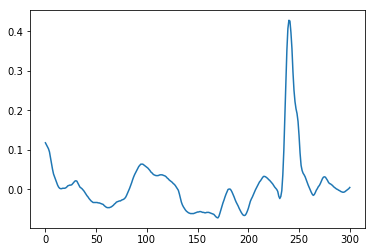

A00131
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


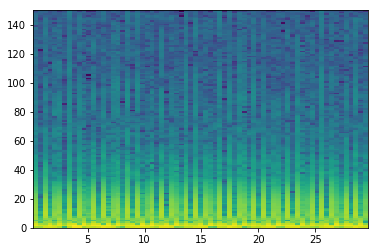

good List
[0, 1, 2, 3, 4, 6, 8, 11, 13, 15, 16, 17, 18, 20, 22, 23, 25, 27, 29, 30, 32, 34, 35, 36, 37, 39, 41, 44, 46, 48, 49, 50, 51, 53, 55, 56, 58, 60, 61, 62, 63, 65, 67, 68]
[1, 1, 1, 1, 2, 2, 3, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 1, 1, 1, 2, 2, 3, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 1, 1, 2, 2, 1]
the temp 3
[[1, 2, 3, 4], [], [], [], [], [10, 11, 12], [], [15], [], [], [19], [], [22, 23, 24], [], [], [], [], [30, 31, 32], [], [35], [], [38, 39, 40], []]
[0, 1, 2, 3, 4]
longest
[0, 1, 2, 3, 4]
indexList
[0, 1, 2, 3, 4]
theMin
0
theMax
600


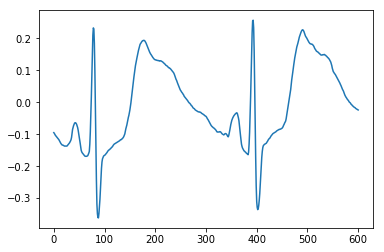

A00133
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


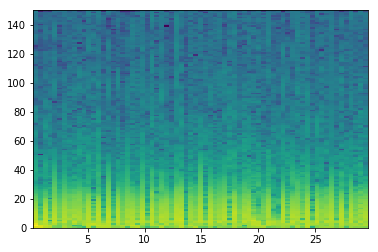

good List
[1, 5, 14, 16, 25, 31, 37, 61]
[4, 9, 2, 9, 6, 6, 24]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


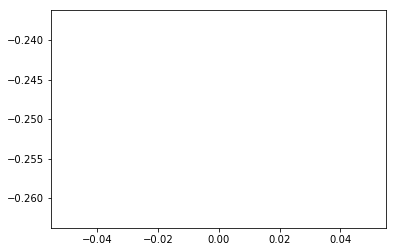

A00136
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


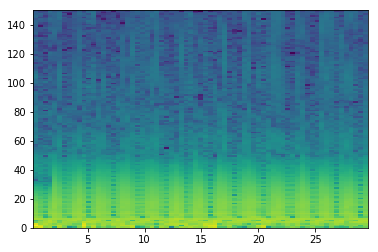

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


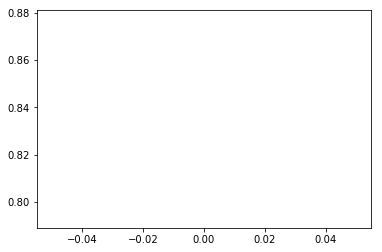

A00138
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

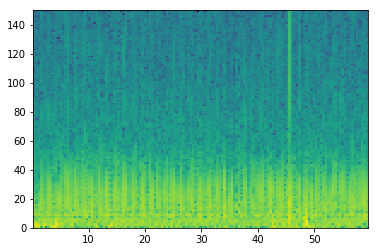

good List
[101]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


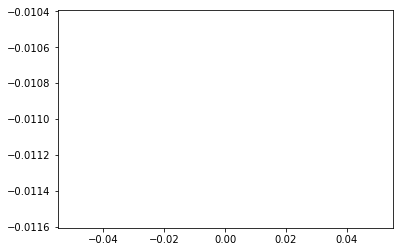

A00145
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

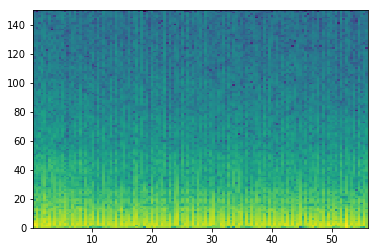

good List
[114, 121]
[7]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


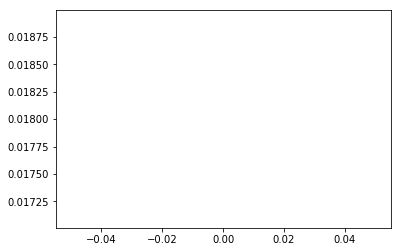

A00155
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


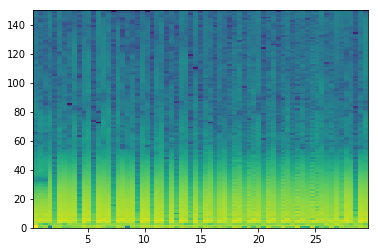

good List
[4, 9, 12, 16, 21, 24, 27, 29, 32, 34, 37, 40, 43, 47, 50, 53, 66]
[5, 3, 4, 5, 3, 3, 2, 3, 2, 3, 3, 3, 4, 3, 3, 13]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


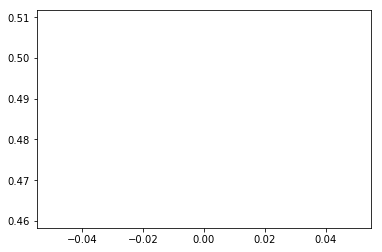

A00158
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


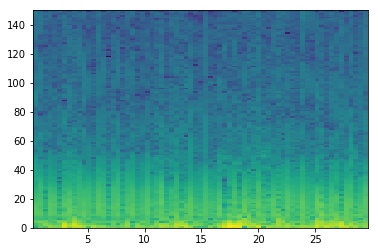

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


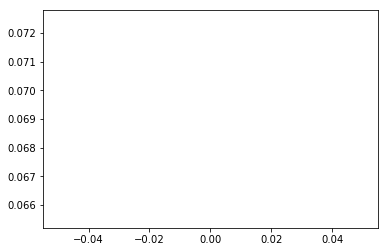

A00159
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


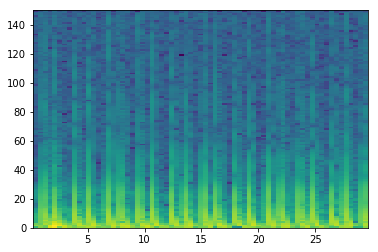

good List
[0, 1, 3, 5, 6, 7, 9, 10, 12, 13, 14, 19, 20, 22, 23, 25, 26, 27, 29, 30, 32, 33, 34, 36, 38, 39, 40, 42, 43, 46, 47, 49, 50, 52, 53, 54, 55, 56, 59, 60, 62, 63, 65, 66, 67]
[1, 2, 2, 1, 1, 2, 1, 2, 1, 1, 5, 1, 2, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1, 1, 2, 1, 3, 1, 2, 1, 2, 1, 1, 1, 1, 3, 1, 2, 1, 2, 1, 1]
the temp 3
[[1], [], [4, 5], [7], [9, 10], [12], [14], [16, 17], [19], [21, 22], [], [25, 26], [28], [30], [32], [34, 35, 36, 37], [39], [41]]
[52, 53, 54, 55, 56]
longest
[52, 53, 54, 55, 56]
indexList
[52, 53, 54, 55, 56]
theMin
6600
theMax
7200


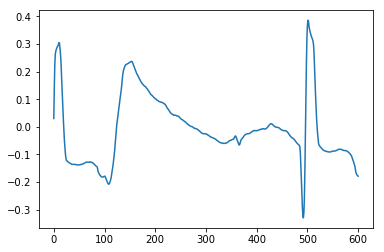

A00161
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

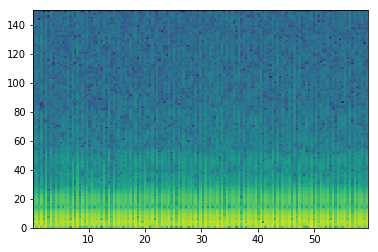

good List
[0, 1, 2, 3, 4, 6, 8, 9, 10, 12, 13, 15, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33, 34, 35, 36, 37, 39, 41, 42, 43, 45, 46, 47, 48, 50, 52, 53, 54, 55, 56, 57, 59, 61, 62, 63, 64, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 83, 84, 86, 87, 88, 89, 90, 91, 93, 95, 97, 98, 100, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 118, 119, 120, 121, 123, 124, 125, 126, 127, 128, 130, 132, 134, 135, 137]
[1, 1, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 2, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 1, 2]
the temp 3
[[1, 2, 3, 4], [], [7, 8], [10], [12, 13], [15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25], [27, 28, 29, 30, 31], [], [34, 35], [37, 38, 39], [], [42, 43, 44, 45, 46], [], [49, 50, 51

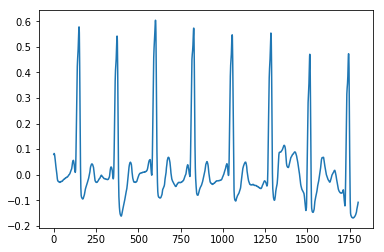

A00162
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


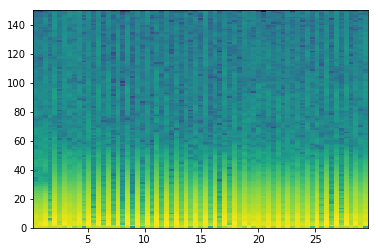

good List
[5, 10, 12, 14, 16, 18, 20, 22, 24, 28, 30, 32, 33, 34, 36, 38, 40, 42, 49, 51, 52, 55, 59, 61, 63, 65, 67]
[5, 2, 2, 2, 2, 2, 2, 2, 4, 2, 2, 1, 1, 2, 2, 2, 2, 7, 2, 1, 3, 4, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [12, 13], [], [], [], [], [], [20], [], [], [], [], []]
[32, 33, 34]
longest
[32, 33, 34]
indexList
[32, 33, 34]
theMin
4200
theMax
4500


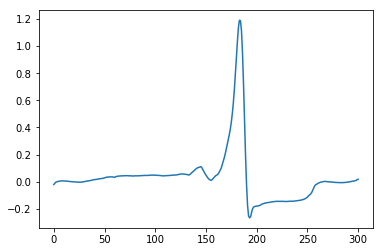

A00170
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


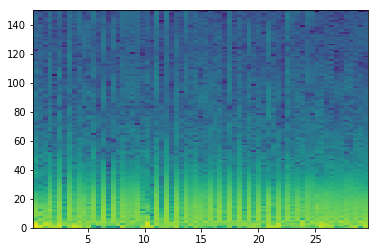

good List
[13, 15, 24, 26, 28, 41, 51]
[2, 9, 2, 2, 13, 10]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


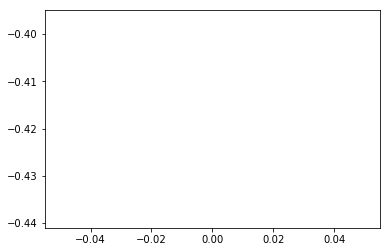

A00176
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


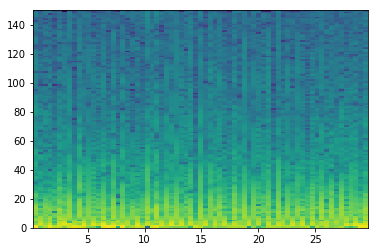

good List
[4, 8, 10, 17, 26, 33, 35, 44, 49, 51, 53, 56, 67]
[4, 2, 7, 9, 7, 2, 9, 5, 2, 2, 3, 11]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


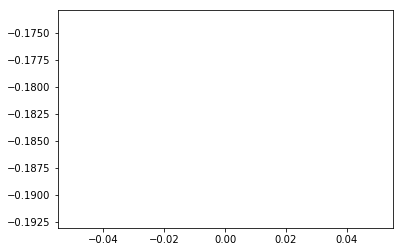

A00181
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


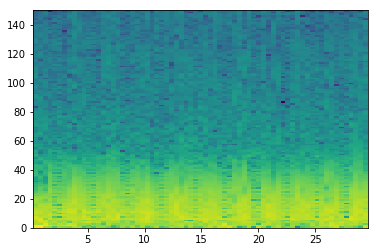

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


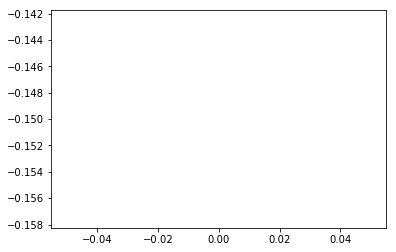

A00186
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


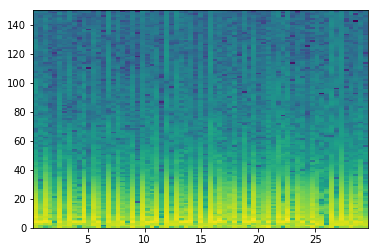

good List
[1, 4, 6, 8, 9, 11, 14, 16, 21, 26, 28, 33, 35, 42, 44, 56]
[3, 2, 2, 1, 2, 3, 2, 5, 5, 2, 5, 2, 7, 2, 12]
the temp 3
[[], [], [], [4], [], [], [], [], [], [], [], [], [], []]
[8, 9]
longest
[8, 9]
indexList
[8, 9]
theMin
900
theMax
1200


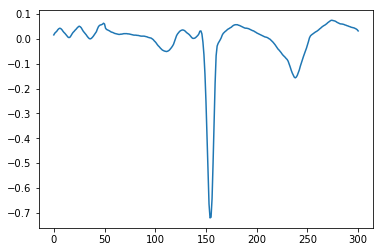

A00187
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


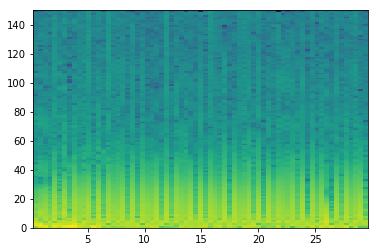

good List
[0, 3, 5, 7, 19, 21, 23, 28, 32, 33, 35, 40, 47, 49, 56, 58, 60, 61, 63, 65]
[3, 2, 2, 12, 2, 2, 5, 4, 1, 2, 5, 7, 2, 7, 2, 2, 1, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [9], [], [], [], [], [], [], [17], []]
[32, 33]
longest
[32, 33]
indexList
[32, 33]
theMin
4200
theMax
4500


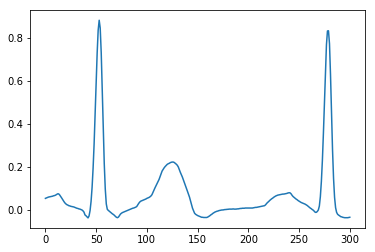

A00189
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


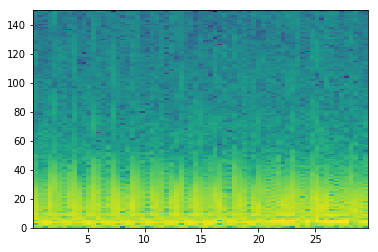

good List
[44]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


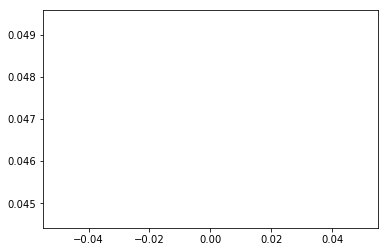

A00195
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333]


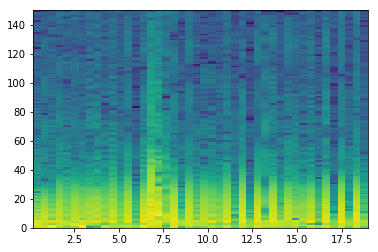

good List
[2, 5, 6, 7, 9, 11, 13, 18, 19, 21, 22, 23, 24, 25, 26, 28, 32, 35, 37, 39, 41, 43]
[3, 1, 1, 2, 2, 2, 5, 1, 2, 1, 1, 1, 1, 1, 2, 4, 3, 2, 2, 2, 2]
the temp 3
[[], [2, 3], [], [], [], [8], [10, 11, 12, 13, 14], [], [], [], [], [], []]
[21, 22, 23, 24, 25, 26]
longest
[21, 22, 23, 24, 25, 26]
indexList
[21, 22, 23, 24, 25, 26]
theMin
2700
theMax
3300


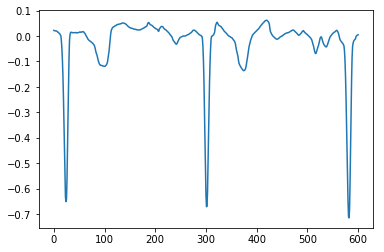

A00198
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


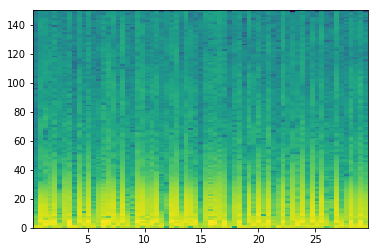

good List
[0, 5, 8, 12, 19, 20, 34, 40, 43, 50, 56, 64]
[5, 3, 4, 7, 1, 14, 6, 3, 7, 6, 8]
the temp 3
[[], [], [], [], [5], [], [], [], [], []]
[19, 20]
longest
[19, 20]
indexList
[19, 20]
theMin
2400
theMax
2700


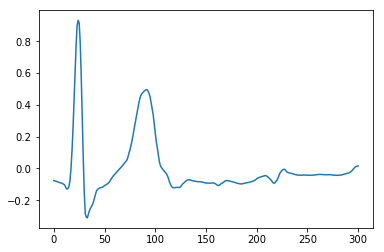

A00203
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


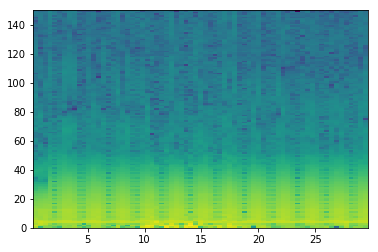

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


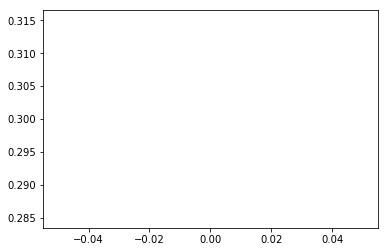

A00204
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


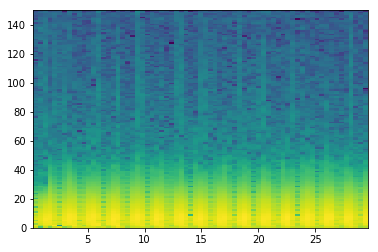

good List
[19]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


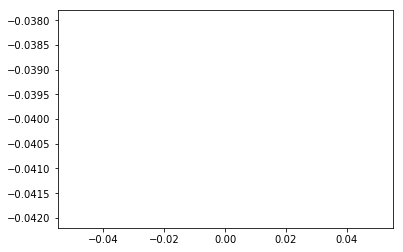

A00209
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


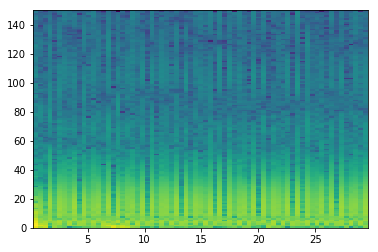

good List
[4, 23, 30, 32, 39, 46, 53, 55, 57, 62, 64]
[19, 7, 2, 7, 7, 7, 2, 2, 5, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


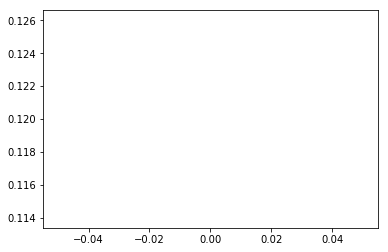

A00211
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


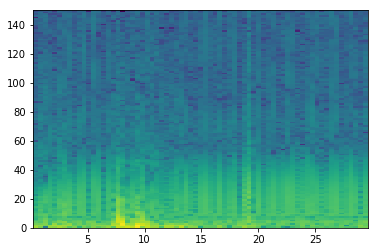

good List
[7, 8, 11, 12, 14, 19, 27, 31, 32, 33, 34, 36, 37, 39, 42, 47, 48, 49, 50, 60, 63, 64, 66, 67]
[1, 3, 1, 2, 5, 8, 4, 1, 1, 1, 2, 1, 2, 3, 5, 1, 1, 1, 10, 3, 1, 2, 1]
the temp 3
[[1], [3], [], [], [], [8, 9, 10], [12], [], [], [16, 17, 18], [], [21]]
[31, 32, 33, 34]
longest
[31, 32, 33, 34]
indexList
[31, 32, 33, 34]
theMin
3900
theMax
4200


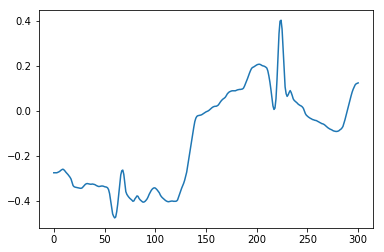

A00212
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


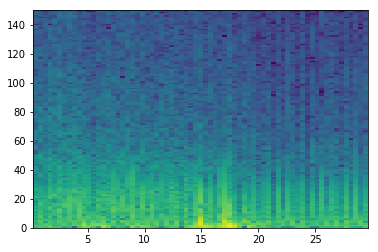

good List
[42, 49, 51, 54, 56, 58, 60, 63, 65, 67]
[7, 2, 3, 2, 2, 2, 3, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


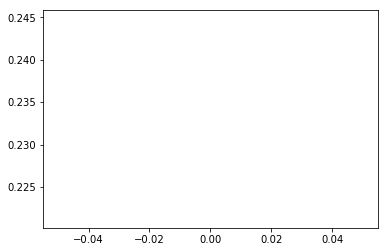

A00213
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


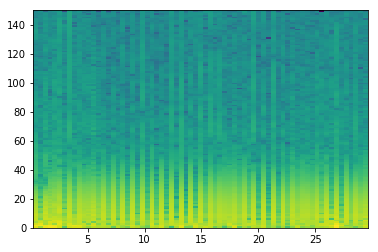

good List
[6, 8, 10, 11, 13, 15, 16, 17, 18, 19, 21, 23, 25, 26, 27, 31, 33, 35, 37, 39, 40, 42, 43, 44, 46, 48, 50, 52, 54, 55, 56, 57, 59, 61, 63, 64, 65, 67]
[2, 2, 1, 2, 2, 1, 1, 1, 1, 2, 2, 2, 1, 1, 4, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 1, 1, 2]
the temp 3
[[], [], [3], [], [6, 7, 8, 9], [], [], [13, 14], [], [], [], [], [20], [22, 23], [], [], [], [], [29, 30, 31], [], [], [35, 36]]
[15, 16, 17, 18, 19]
longest
[15, 16, 17, 18, 19]
indexList
[15, 16, 17, 18, 19]
theMin
1800
theMax
2400


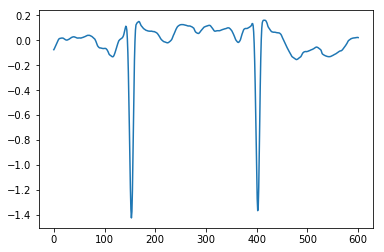

A00215
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

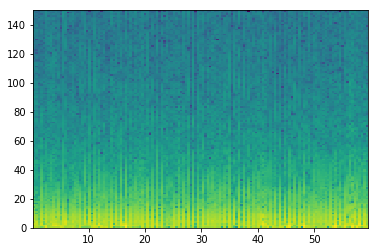

good List
[11, 28, 65, 67, 82, 86, 103]
[17, 37, 2, 15, 4, 17]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


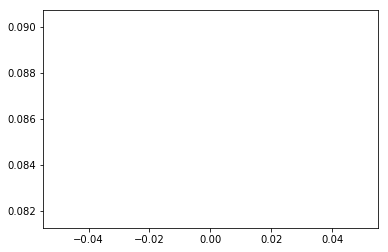

A00218
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


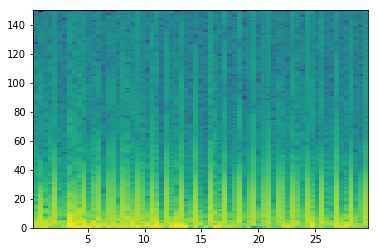

good List
[0, 1, 2, 5, 6, 11, 14, 17, 23, 26, 28, 31, 32, 34, 35, 38, 40, 41, 43, 46, 49, 52, 55, 57, 58, 60, 61, 63, 64, 66, 67]
[1, 1, 3, 1, 5, 3, 3, 6, 3, 2, 3, 1, 2, 1, 3, 2, 1, 2, 3, 3, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[1, 2], [4], [], [], [], [], [], [], [12], [14], [], [17], [], [], [], [], [], [24], [26], [28]]
[0, 1, 2]
longest
[0, 1, 2]
indexList
[0, 1, 2]
theMin
0
theMax
300


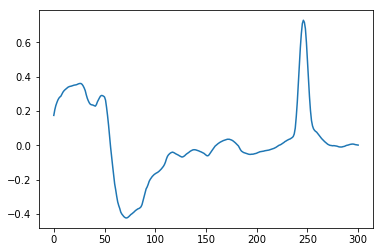

A00220
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


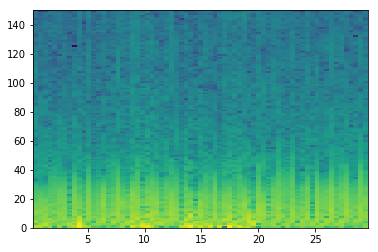

good List
[12]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


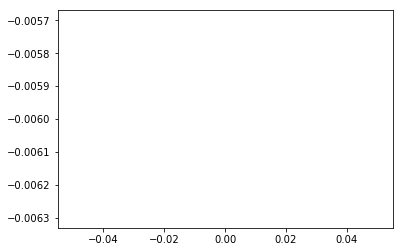

A00243
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


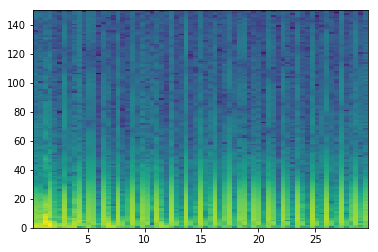

good List
[5, 7, 10, 13, 16, 18, 19, 23, 26, 27, 29, 30, 32, 33, 35, 38, 39, 44, 45, 47, 48, 50, 53, 55, 56, 58, 59, 61, 62, 64, 65]
[2, 3, 3, 3, 2, 1, 4, 3, 1, 2, 1, 2, 1, 2, 3, 1, 5, 1, 2, 1, 2, 3, 2, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [], [], [], [], [6], [], [9], [11], [13], [], [16], [18], [20], [], [], [24], [26], [28]]
[18, 19]
longest
[18, 19]
indexList
[18, 19]
theMin
2400
theMax
2700


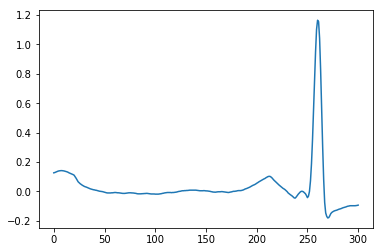

A00246
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


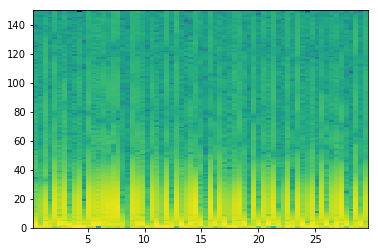

good List
[0, 1, 3, 5, 7, 8, 9, 10, 12, 13, 18, 19, 20, 23, 24, 25, 26, 27, 28, 30, 31, 33, 34, 35, 37, 39, 40, 41, 42, 43, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 58, 59, 60, 61, 63, 64, 65, 67, 68]
[1, 2, 2, 2, 1, 1, 1, 2, 1, 5, 1, 1, 3, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 2, 1]
the temp 3
[[1], [], [], [5, 6, 7], [9], [11, 12], [14, 15, 16, 17, 18], [20], [22, 23], [], [26, 27, 28, 29, 30], [32, 33], [35, 36, 37], [39], [41, 42, 43], [45, 46]]
[23, 24, 25, 26, 27, 28]
longest
[23, 24, 25, 26, 27, 28]
indexList
[23, 24, 25, 26, 27, 28]
theMin
3000
theMax
3600


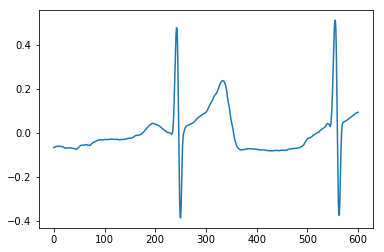

A00251
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

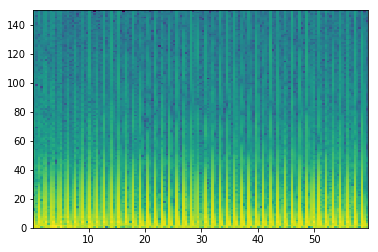

good List
[6, 9, 12, 15, 16, 19, 21, 27, 30, 31, 34, 37, 40, 43, 46, 49, 52, 55, 58, 61, 64, 67, 69, 70, 72, 73, 75, 76, 79, 82, 85, 88, 91, 94, 96, 97, 100, 103, 106, 109, 112, 117, 120, 129, 135, 138]
[3, 3, 3, 1, 3, 2, 6, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 1, 2, 1, 2, 1, 3, 3, 3, 3, 3, 3, 2, 1, 3, 3, 3, 3, 3, 5, 3, 9, 6, 3]
the temp 3
[[], [], [], [4], [], [], [], [9], [], [], [], [], [], [], [], [], [], [], [], [], [23], [25], [27], [], [], [], [], [], [], [35], [], [], [], [], [], [], [], [], []]
[15, 16]
longest
[15, 16]
indexList
[15, 16]
theMin
1800
theMax
2100


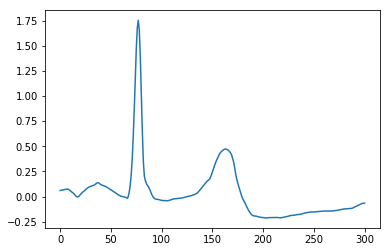

A00252
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


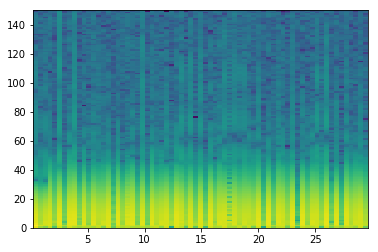

good List
[0, 1, 2, 3, 4, 6, 9, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 23, 25, 26, 27, 28, 31, 33, 35, 36, 37, 38, 40, 42, 44, 45, 47, 48, 49, 51, 52, 54, 55, 56, 57, 59, 61, 62, 63, 65, 66, 67, 68]
[1, 1, 1, 1, 2, 3, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 3, 2, 2, 1, 1, 1, 2, 2, 2, 1, 2, 1, 1, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 2, 1, 1, 1]
the temp 3
[[1, 2, 3, 4], [], [], [8, 9, 10, 11, 12], [14, 15, 16], [], [19, 20, 21], [], [], [25, 26, 27], [], [], [31], [33, 34], [36], [38, 39, 40], [], [43, 44]]
[11, 12, 13, 14, 15, 16]
longest
[11, 12, 13, 14, 15, 16]
indexList
[11, 12, 13, 14, 15, 16]
theMin
1500
theMax
2100


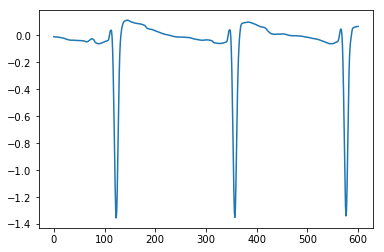

A00255
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667]


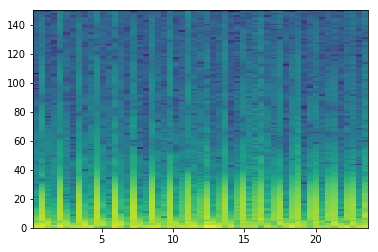

good List
[0, 2, 3, 5, 6, 8, 9, 11, 12, 14, 15, 17, 18, 20, 21, 23, 24, 29, 30, 32, 33, 39, 41, 44, 47, 50, 51, 53]
[2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 5, 1, 2, 1, 6, 2, 3, 3, 3, 1, 2]
the temp 3
[[], [2], [4], [6], [8], [10], [12], [14], [16], [18], [20], [], [], [], [], [26]]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


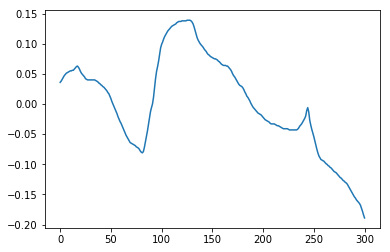

A00259
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667]


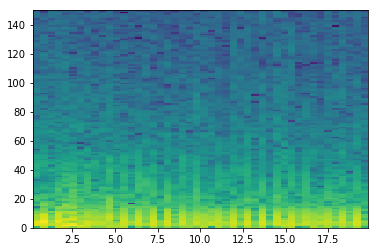

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


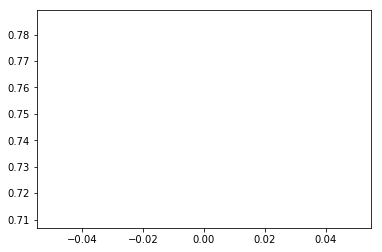

A00260
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

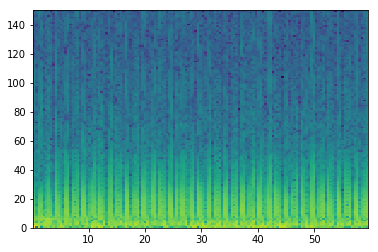

good List
[4, 7, 8, 12, 15, 19, 30, 33, 37, 38, 40, 41, 44, 47, 48, 51, 52, 53, 54, 55, 58, 60, 64, 67, 70, 71, 74, 78, 80, 81, 85, 86, 88, 89, 90, 92, 93, 96, 101, 102, 103, 104, 106, 107, 108, 110, 112, 113, 114, 117, 121, 125, 128, 131, 132, 136]
[3, 1, 4, 3, 4, 11, 3, 4, 1, 2, 1, 3, 3, 1, 3, 1, 1, 1, 1, 3, 2, 4, 3, 3, 1, 3, 4, 2, 1, 4, 1, 2, 1, 1, 2, 1, 3, 5, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 3, 4, 4, 3, 3, 1, 4]
the temp 3
[[], [2], [], [], [], [], [], [9], [11], [], [14], [16, 17, 18, 19], [], [], [], [], [25], [], [], [29], [31], [33, 34], [36], [], [39, 40, 41], [43, 44], [], [47, 48], [], [], [], [], [54]]
[51, 52, 53, 54, 55]
longest
[51, 52, 53, 54, 55]
indexList
[51, 52, 53, 54, 55]
theMin
6600
theMax
6900


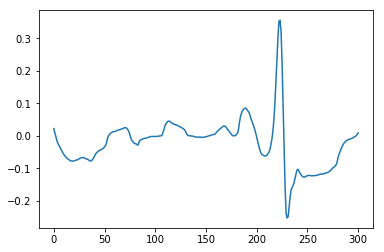

A00268
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

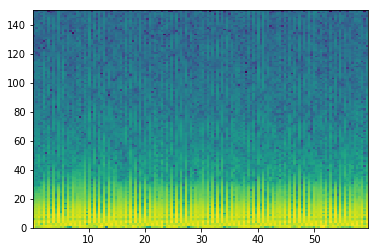

good List
[0, 3, 5, 7, 9, 11, 13, 15, 16, 19, 20, 22, 24, 26, 30, 32, 34, 35, 36, 37, 39, 41, 43, 45, 47, 49, 52, 54, 56, 58, 60, 62, 64, 66, 71, 73, 75, 77, 79, 81, 84, 86, 88, 90, 92, 96, 105, 107, 109, 111, 112, 116, 118, 119, 120, 122, 124, 126, 131, 137]
[3, 2, 2, 2, 2, 2, 2, 1, 3, 1, 2, 2, 2, 4, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 5, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 4, 9, 2, 2, 2, 1, 4, 2, 1, 1, 2, 2, 2, 5, 6]
the temp 3
[[], [], [], [], [], [], [], [8], [10], [], [], [], [], [], [17, 18, 19], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [50], [], [53, 54], [], [], [], []]
[34, 35, 36, 37]
longest
[34, 35, 36, 37]
indexList
[34, 35, 36, 37]
theMin
4200
theMax
4800


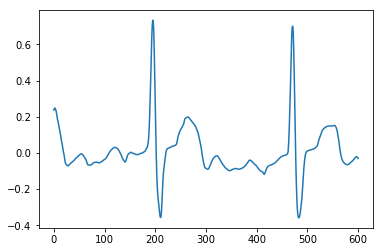

A00270
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


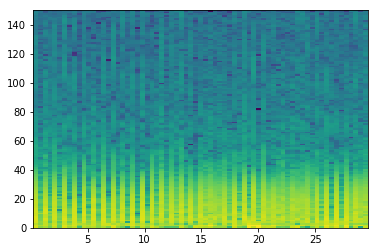

good List
[3, 7, 9, 11, 13, 15, 17, 21, 22, 23, 27, 31, 32, 33, 37, 38, 40, 44, 46, 48, 49, 52, 54, 56, 57, 59, 61, 62, 65]
[4, 2, 2, 2, 2, 2, 4, 1, 1, 4, 4, 1, 1, 4, 1, 2, 4, 2, 2, 1, 3, 2, 2, 1, 2, 2, 1, 3]
the temp 3
[[], [], [], [], [], [], [], [8, 9], [], [12, 13], [15], [], [], [], [20], [], [], [24], [], [27]]
[21, 22, 23]
longest
[21, 22, 23]
indexList
[21, 22, 23]
theMin
2700
theMax
3000


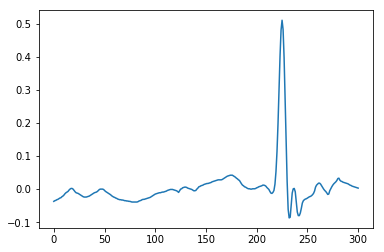

A00278
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


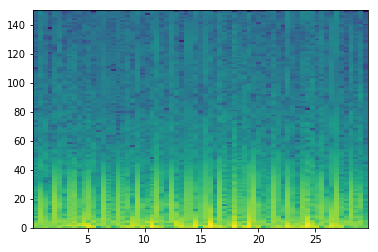

good List
[68]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


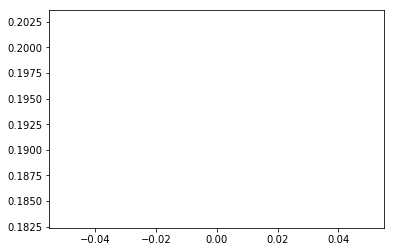

A00285
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

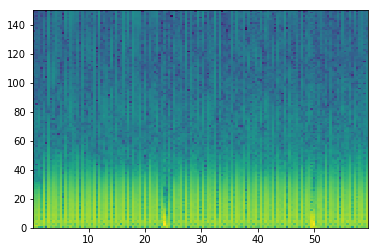

good List
[3, 7, 12, 19, 21, 24, 26, 28, 33, 40, 47, 52, 57, 64, 76, 83, 100, 103, 120]
[4, 5, 7, 2, 3, 2, 2, 5, 7, 7, 5, 5, 7, 12, 7, 17, 3, 17]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


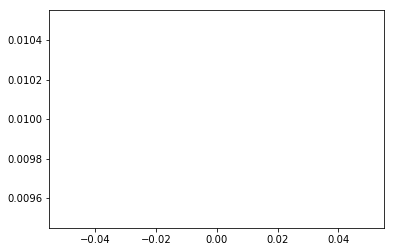

A00286
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


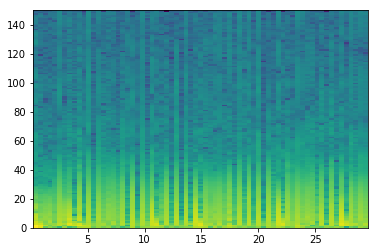

good List
[2, 3, 4, 6, 8, 10, 12, 17, 19, 21, 23, 28, 30, 32, 35, 36, 37, 38, 39, 41, 43, 45, 47, 58, 60, 62, 64]
[1, 1, 2, 2, 2, 2, 5, 2, 2, 2, 5, 2, 2, 3, 1, 1, 1, 1, 2, 2, 2, 2, 11, 2, 2, 2]
the temp 3
[[1, 2], [], [], [], [], [], [], [], [], [], [], [], [15, 16, 17, 18], [], [], [], [], [], [], []]
[35, 36, 37, 38, 39]
longest
[35, 36, 37, 38, 39]
indexList
[35, 36, 37, 38, 39]
theMin
4500
theMax
5100


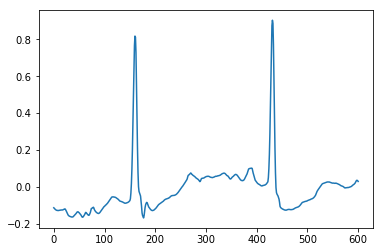

A00288
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


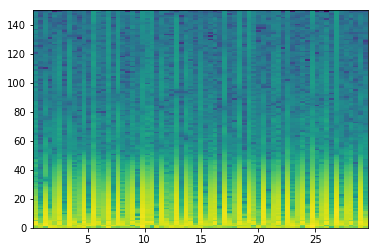

good List
[1, 3, 4, 6, 8, 9, 11, 13, 14, 16, 18, 19, 20, 21, 25, 27, 28, 30, 32, 33, 35, 38, 40, 41, 43, 45, 46, 48, 49, 51, 53, 56, 59, 61, 63, 66, 68]
[2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 4, 2, 1, 2, 2, 1, 2, 3, 2, 1, 2, 2, 1, 2, 1, 2, 2, 3, 3, 2, 2, 3, 2]
the temp 3
[[], [2], [], [5], [], [8], [], [11, 12, 13], [], [16], [], [19], [], [], [23], [], [26], [28], [], [], [], [], [], [], []]
[18, 19, 20, 21]
longest
[18, 19, 20, 21]
indexList
[18, 19, 20, 21]
theMin
2400
theMax
2700


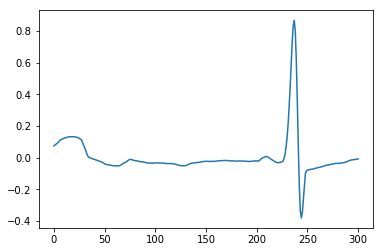

A00291
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


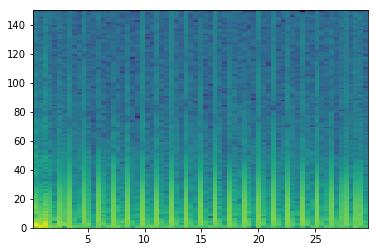

good List
[1, 3, 4, 8, 9, 11, 12, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 29, 30, 32, 33, 35, 36, 38, 39, 40, 41, 42, 44, 45, 47, 48, 50, 51, 53, 54, 56, 57, 59, 60, 62, 63, 64, 65, 66, 67, 68]
[2, 1, 4, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1]
the temp 3
[[], [2], [4], [6], [8], [10], [12], [14], [16], [18], [20], [22], [24, 25, 26, 27], [29], [31], [33], [35], [37], [39]]
[38, 39, 40, 41, 42]
longest
[38, 39, 40, 41, 42]
indexList
[38, 39, 40, 41, 42]
theMin
4800
theMax
5400


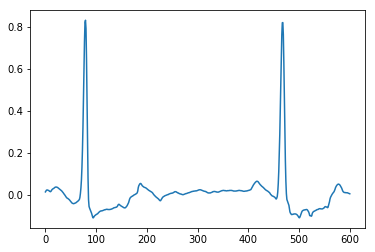

A00293
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


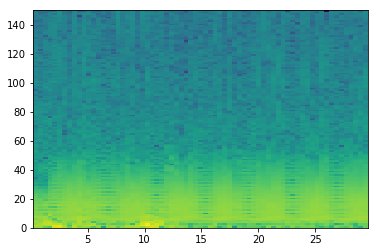

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


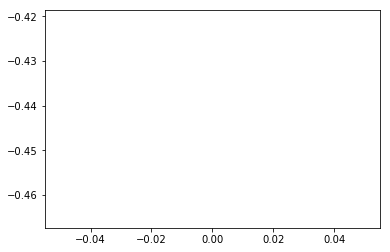

A00296
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


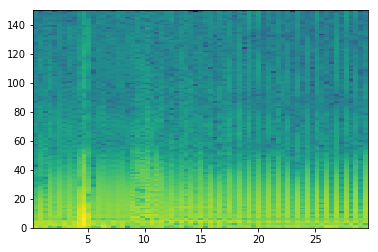

good List
[0, 4, 12, 19, 27, 29, 32, 36, 37, 41, 43, 45, 47, 51, 52, 53, 55, 57, 59, 61, 63, 65, 67]
[4, 8, 7, 8, 2, 3, 4, 1, 4, 2, 2, 2, 4, 1, 1, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [8], [], [], [], [], [14, 15], [], [], [], [], [], []]
[51, 52, 53]
longest
[51, 52, 53]
indexList
[51, 52, 53]
theMin
6600
theMax
6900


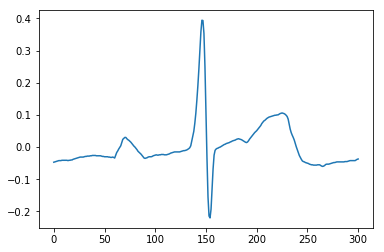

A00298
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


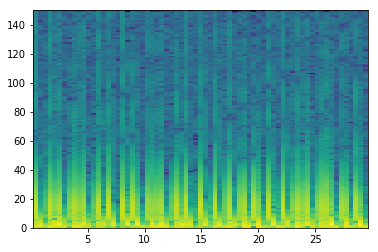

good List
[1, 2, 4, 6, 7, 9, 11, 12, 14, 16, 17, 19, 21, 22, 23, 25, 27, 28, 30, 32, 33, 35, 36, 38, 39, 41, 42, 43, 44, 45, 46, 47, 49, 50, 52, 53, 55, 57, 58, 61, 62, 63, 64, 65, 67, 68]
[1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 2, 1, 3, 1, 1, 1, 1, 2, 1]
the temp 3
[[1], [], [4], [], [7], [], [10], [], [13, 14], [], [17], [], [20], [22], [24], [26, 27, 28, 29, 30, 31], [33], [35], [], [38], [40, 41, 42, 43]]
[41, 42, 43, 44, 45, 46, 47]
longest
[41, 42, 43, 44, 45, 46, 47]
indexList
[41, 42, 43, 44, 45, 46, 47]
theMin
5100
theMax
6000


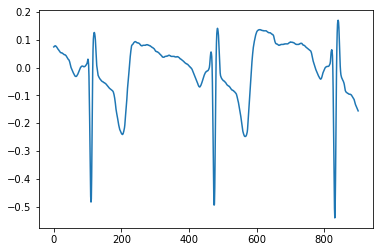

A00300
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

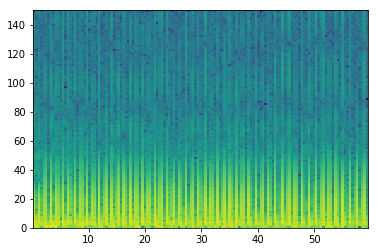

good List
[6, 8, 9, 11, 13, 15, 16, 18, 21, 23, 26, 28, 29, 31, 34, 36, 38, 39, 41, 44, 46, 49, 51, 52, 54, 57, 58, 59, 61, 62, 64, 65, 67, 69, 70, 72, 73, 75, 77, 78, 80, 83, 85, 88, 89, 91, 93, 94, 96, 99, 101, 102, 104, 105, 107, 108, 110, 113, 115, 116, 118, 119, 121, 124, 127, 129, 130, 132, 133, 135, 136, 138]
[2, 1, 2, 2, 2, 1, 2, 3, 2, 3, 2, 1, 2, 3, 2, 2, 1, 2, 3, 2, 3, 2, 1, 2, 3, 1, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 3, 2, 3, 1, 2, 2, 1, 2, 3, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 2, 3, 3, 2, 1, 2, 1, 2, 1, 2]
the temp 3
[[], [2], [], [], [6], [], [], [], [], [12], [], [], [], [17], [], [], [], [], [23], [], [26, 27], [29], [31], [], [34], [36], [], [39], [], [], [], [44], [], [47], [], [], [51], [53], [55], [], [], [59], [61], [], [], [], [66], [68], [70]]
[57, 58, 59]
longest
[57, 58, 59]
indexList
[57, 58, 59]
theMin
7200
theMax
7500


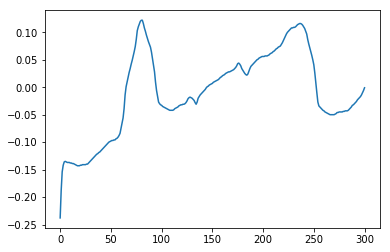

A00308
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


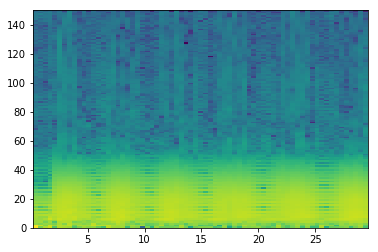

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


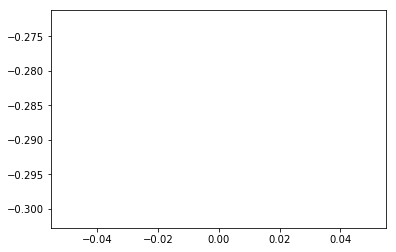

A00310
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


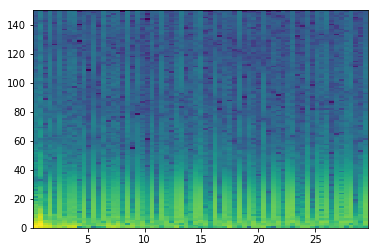

good List
[2, 8, 9, 11, 13, 15, 16, 17, 18, 20, 22, 23, 25, 27, 28, 29, 31, 32, 36, 38, 39, 41, 43, 45, 46, 48, 49, 50, 51, 54, 55, 57, 61, 66, 67]
[6, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 1, 2, 1, 4, 2, 1, 2, 2, 2, 1, 2, 1, 1, 1, 3, 1, 2, 4, 5, 1]
the temp 3
[[], [2], [], [], [6, 7, 8], [], [11], [], [14, 15], [17], [], [20], [], [], [24], [26, 27, 28], [30], [], []]
[15, 16, 17, 18]
longest
[15, 16, 17, 18]
indexList
[15, 16, 17, 18]
theMin
1800
theMax
2400


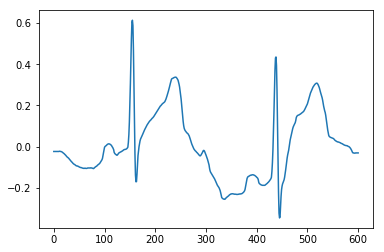

A00317
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667]


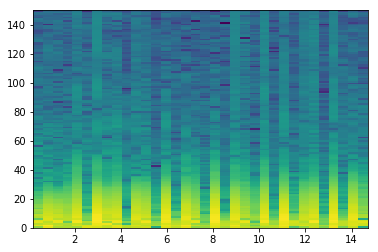

good List
[1, 2, 3, 9, 10, 12, 14, 17, 19, 22, 24, 26, 27, 29, 31, 32, 33]
[1, 1, 6, 1, 2, 2, 3, 2, 3, 2, 2, 1, 2, 2, 1, 1]
the temp 3
[[1, 2], [4], [], [], [], [], [], [], [12], []]
[1, 2, 3]
longest
[1, 2, 3]
indexList
[1, 2, 3]
theMin
0
theMax
300


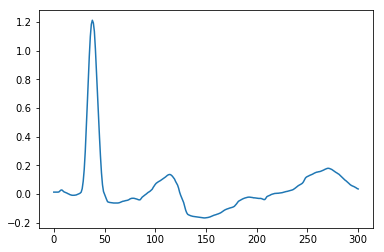

A00324
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


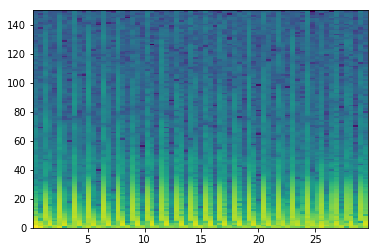

good List
[1, 4, 6, 7, 9, 10, 12, 13, 16, 18, 19, 21, 22, 25, 28, 31, 34, 36, 37, 40, 42, 43, 46, 48, 49, 51, 52, 54, 55, 57, 58, 60, 61, 63, 66, 67]
[3, 2, 1, 2, 1, 2, 1, 3, 2, 1, 2, 1, 3, 3, 3, 3, 2, 1, 3, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 1]
the temp 3
[[], [], [3], [5], [7], [], [10], [12], [], [], [], [], [18], [], [21], [], [24], [26], [28], [30], [32], []]
[6, 7]
longest
[6, 7]
indexList
[6, 7]
theMin
600
theMax
900


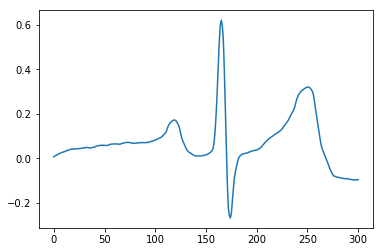

A00325
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

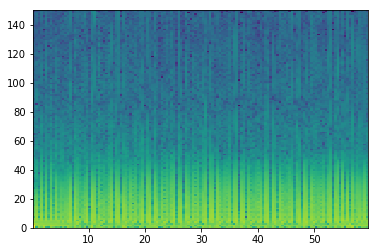

good List
[78, 82, 85, 95, 98, 111, 124]
[4, 3, 10, 3, 13, 13]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


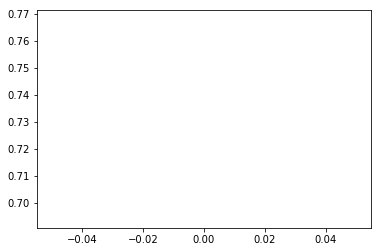

A00326
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


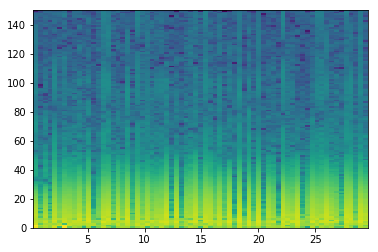

good List
[1, 3, 5, 10, 12, 13, 20, 26, 28, 30, 34, 37, 40, 41, 43, 45, 47, 48, 50, 53, 55, 56, 63, 66]
[2, 2, 5, 2, 1, 7, 6, 2, 2, 4, 3, 3, 1, 2, 2, 2, 1, 2, 3, 2, 1, 7, 3]
the temp 3
[[], [], [], [], [5], [], [], [], [], [], [], [13], [], [], [17], [], [], [21], []]
[12, 13]
longest
[12, 13]
indexList
[12, 13]
theMin
1500
theMax
1800


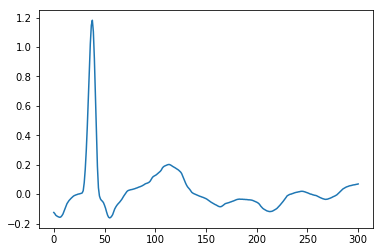

A00327
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


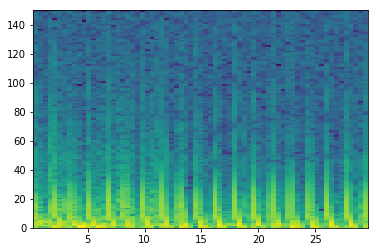

good List
[1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 19, 20, 21, 23, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68]
[1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 3, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[1], [3, 4, 5, 6, 7, 8, 9, 10, 11], [], [14, 15], [], [18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], [30, 31, 32, 33, 34, 35]]
[25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36]
longest
[25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36]
indexList
[25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36]
theMin
3300
theMax
4500


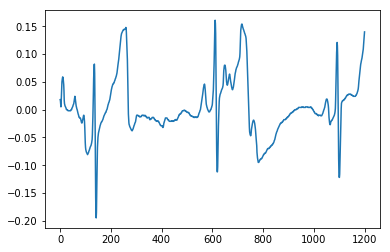

A00329
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


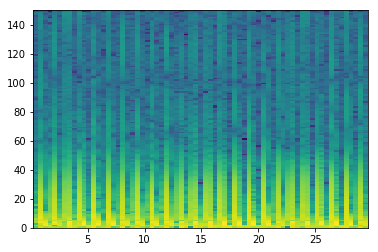

good List
[0, 2, 3, 5, 8, 11, 13, 14, 16, 17, 19, 20, 22, 23, 25, 26, 28, 29, 31, 34, 37, 40, 43, 45, 46, 48, 49, 51, 52, 54, 55, 57, 60, 62, 63, 65, 66, 68]
[2, 1, 2, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 3, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 2]
the temp 3
[[], [2], [], [], [], [7], [9], [11], [13], [15], [17], [], [], [], [], [], [24], [26], [28], [30], [], [], [34], [36]]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


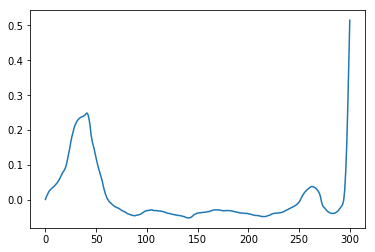

A00335
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


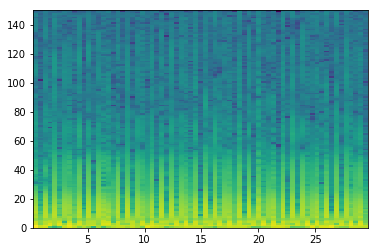

good List
[1, 2, 8, 10, 12, 16, 18, 20, 23, 25, 27, 29, 32, 34, 41, 43, 45, 47, 50, 52, 54, 57, 61, 63, 68]
[1, 6, 2, 2, 4, 2, 2, 3, 2, 2, 2, 3, 2, 7, 2, 2, 2, 3, 2, 2, 3, 4, 2, 5]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


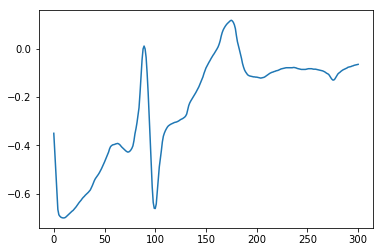

A00337
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

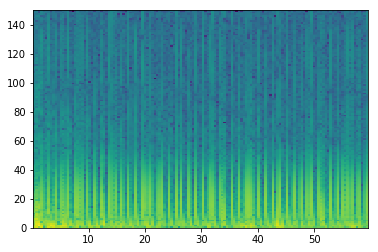

good List
[4, 7, 8, 10, 11, 16, 21, 23, 24, 26, 27, 30, 35, 37, 38, 39, 40, 41, 43, 44, 46, 47, 49, 50, 51, 52, 54, 55, 57, 58, 60, 62, 63, 65, 66, 68, 69, 71, 72, 75, 76, 78, 80, 81, 83, 84, 86, 87, 92, 94, 95, 97, 98, 100, 103, 104, 106, 107, 109, 110, 111, 112, 116, 117, 121, 122, 124, 125, 127, 133, 134, 136, 137]
[3, 1, 2, 1, 5, 5, 2, 1, 2, 1, 3, 5, 2, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 1, 2, 1, 3, 1, 2, 2, 1, 2, 1, 2, 1, 5, 2, 1, 2, 1, 2, 3, 1, 2, 1, 2, 1, 1, 1, 4, 1, 4, 1, 2, 1, 2, 6, 1, 2, 1]
the temp 3
[[], [2], [4], [], [], [8], [10], [], [], [14, 15, 16, 17], [19], [21], [23, 24, 25], [27], [29], [], [32], [34], [36], [38], [40], [], [43], [45], [47], [], [50], [52], [], [55], [57], [59, 60, 61], [63], [65], [67], [], [70]]
[37, 38, 39, 40, 41]
longest
[37, 38, 39, 40, 41]
indexList
[37, 38, 39, 40, 41]
theMin
4800
theMax
5100


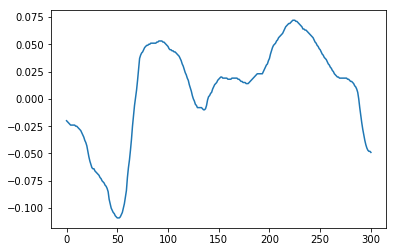

A00340
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


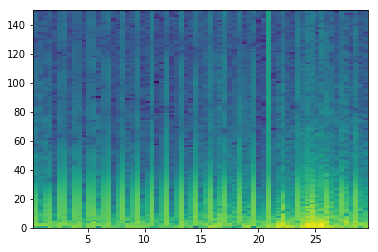

good List
[3, 4, 7, 10, 13, 16, 17, 19, 20, 22, 23, 25, 26, 28, 29, 31, 32, 34, 35, 37, 40, 41, 43, 46, 47, 49, 53]
[1, 3, 3, 3, 3, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 1, 2, 3, 1, 2, 4]
the temp 3
[[1], [], [], [], [6], [8], [10], [12], [14], [16], [18], [], [21], [], [24], []]
[3, 4]
longest
[3, 4]
indexList
[3, 4]
theMin
300
theMax
600


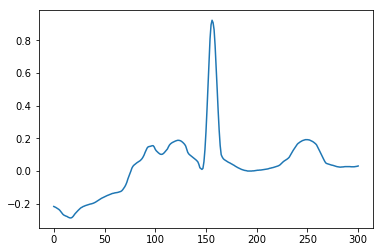

A00342
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


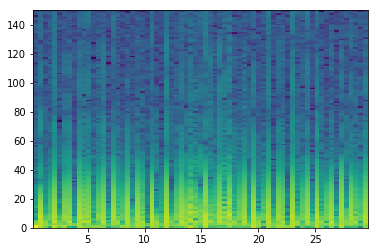

good List
[0, 2, 3, 5, 8, 10, 12, 15, 17, 18, 20, 23, 25, 26, 28, 29, 37, 41, 42, 44, 46, 47, 49, 52, 54, 55, 57, 59, 60, 61, 62, 63, 64, 65, 66, 67]
[2, 1, 2, 3, 2, 2, 3, 2, 1, 2, 3, 2, 1, 2, 1, 8, 4, 1, 2, 2, 1, 2, 3, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[], [2], [], [], [], [], [], [9], [], [], [13], [15], [], [18], [], [21], [], [], [25], []]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


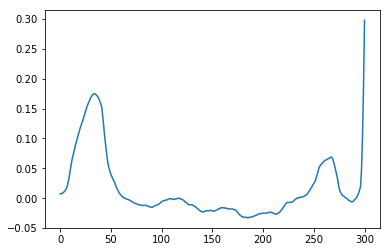

A00343
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


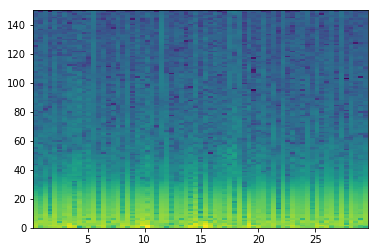

good List
[5, 13, 15, 18, 25, 28, 29, 36, 43, 48, 50, 52, 57, 64, 67]
[8, 2, 3, 7, 3, 1, 7, 7, 5, 2, 2, 5, 7, 3]
the temp 3
[[], [], [], [], [], [6], [], [], [], [], [], [], []]
[28, 29]
longest
[28, 29]
indexList
[28, 29]
theMin
3600
theMax
3900


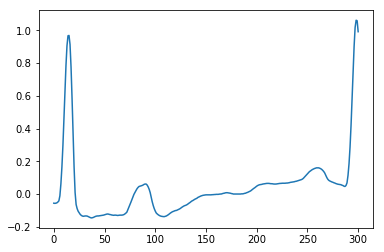

A00344
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333]


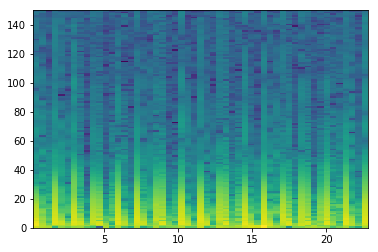

good List
[2, 5, 7, 8, 9, 11, 12, 14, 15, 17, 18, 19, 21, 22, 24, 25, 26, 27, 28, 31, 34, 35, 37, 39, 40, 41, 42, 44, 45, 47, 48, 51]
[3, 2, 1, 1, 2, 1, 2, 1, 2, 1, 1, 2, 1, 2, 1, 1, 1, 1, 3, 3, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 3]
the temp 3
[[], [], [3, 4], [6], [8], [10, 11], [13], [15, 16, 17, 18], [], [21], [], [24, 25, 26], [28], [30]]
[24, 25, 26, 27, 28]
longest
[24, 25, 26, 27, 28]
indexList
[24, 25, 26, 27, 28]
theMin
3000
theMax
3600


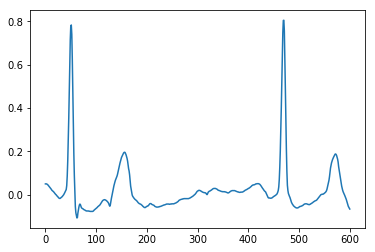

A00345
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


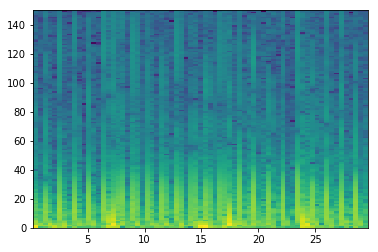

good List
[0, 1, 3, 4, 6, 7, 9, 10, 12, 13, 15, 19, 22, 25, 27, 28, 31, 32, 34, 37, 41, 43, 46, 47, 49, 50, 52, 53, 59, 61, 64, 65, 67, 68]
[1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 4, 3, 3, 2, 1, 3, 1, 2, 3, 4, 2, 3, 1, 2, 1, 2, 1, 6, 2, 3, 1, 2, 1]
the temp 3
[[1], [3], [5], [7], [9], [], [], [], [], [15], [17], [], [], [], [], [23], [25], [27], [], [], [31]]
[0, 1]
longest
[0, 1]
indexList
[0, 1]
theMin
0
theMax
300


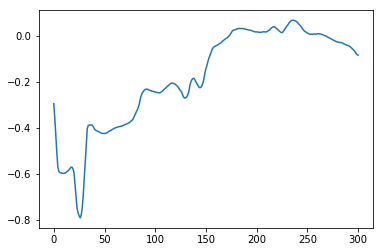

A00348
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


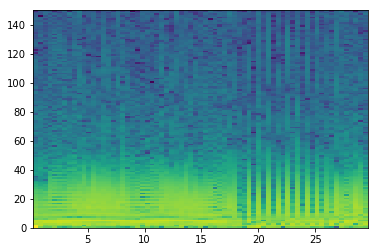

good List
[27, 51, 57, 68]
[24, 6, 11]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


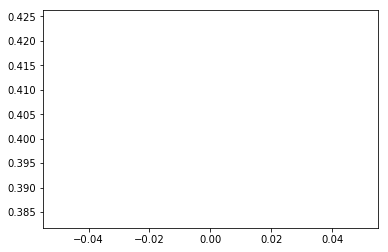

A00353
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

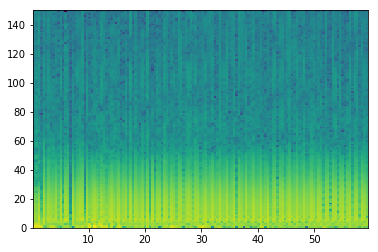

good List
[3, 5, 12, 15, 21, 39, 41, 44, 48, 50, 62, 72, 73, 84, 98, 120, 123, 129, 132]
[2, 7, 3, 6, 18, 2, 3, 4, 2, 12, 10, 1, 11, 14, 22, 3, 6, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [12], [], [], [], [], []]
[72, 73]
longest
[72, 73]
indexList
[72, 73]
theMin
9300
theMax
9600


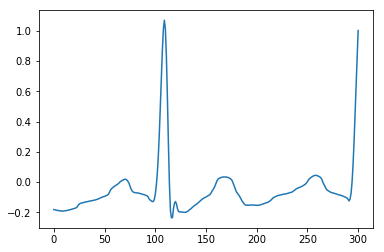

A00362
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


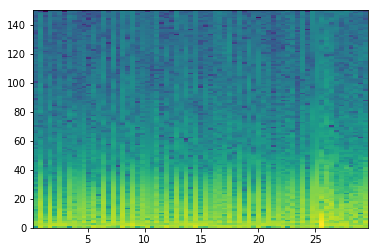

good List
[2, 15, 54]
[13, 39]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


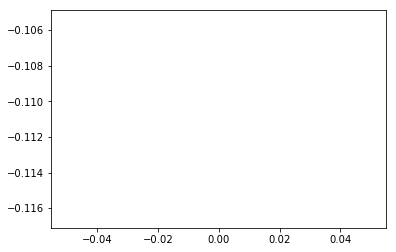

A00373
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

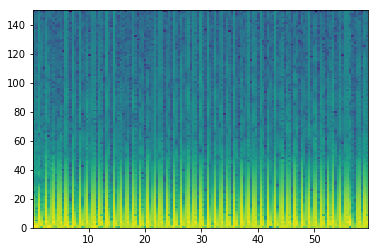

good List
[3, 4, 7, 9, 12, 15, 17, 18, 20, 21, 23, 26, 29, 32, 34, 35, 37, 40, 43, 46, 49, 51, 54, 57, 60, 65, 68, 70, 71, 74, 76, 79, 82, 85, 88, 93, 96, 98, 99, 101, 104, 107, 110, 113, 115, 118, 121, 123, 126, 128, 132, 133, 134, 136]
[1, 3, 2, 3, 3, 2, 1, 2, 1, 2, 3, 3, 3, 2, 1, 2, 3, 3, 3, 3, 2, 3, 3, 3, 5, 3, 2, 1, 3, 2, 3, 3, 3, 3, 5, 3, 2, 1, 2, 3, 3, 3, 3, 2, 3, 3, 2, 3, 2, 4, 1, 1, 2]
the temp 3
[[1], [], [], [], [], [7], [9], [], [], [], [], [15], [], [], [], [], [], [], [], [], [], [], [], [28], [], [], [], [], [], [], [], [], [38], [], [], [], [], [], [], [], [], [], [], [], [51, 52]]
[132, 133, 134]
longest
[132, 133, 134]
indexList
[132, 133, 134]
theMin
16800
theMax
17100


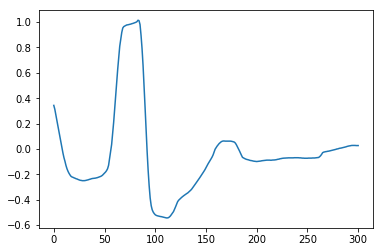

A00379
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

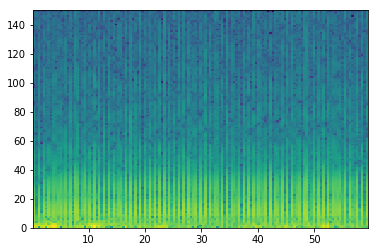

good List
[1, 3, 5, 14, 16, 19, 20, 22, 24, 26, 28, 30, 32, 34, 37, 39, 41, 43, 45, 47, 49, 51, 53, 55, 57, 59, 61, 63, 66, 68, 70, 72, 74, 77, 79, 81, 84, 86, 88, 90, 92, 95, 97, 99, 102, 104, 106, 111, 114, 119, 121, 128, 130, 133, 135, 137]
[2, 2, 9, 2, 3, 1, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 5, 3, 5, 2, 7, 2, 3, 2, 2]
the temp 3
[[], [], [], [], [], [6], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[19, 20]
longest
[19, 20]
indexList
[19, 20]
theMin
2400
theMax
2700


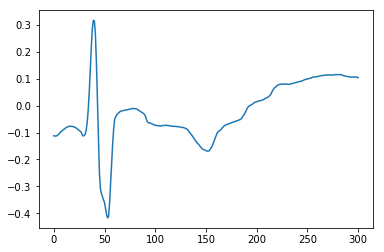

A00384
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


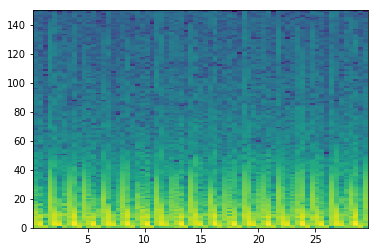

good List
[2, 17, 20, 24, 39, 60]
[15, 3, 4, 15, 21]
the temp 3
[[], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


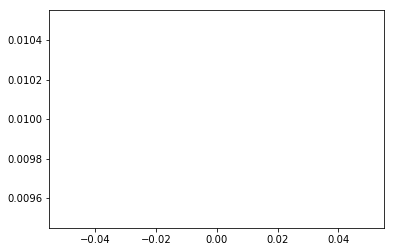

A00385
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


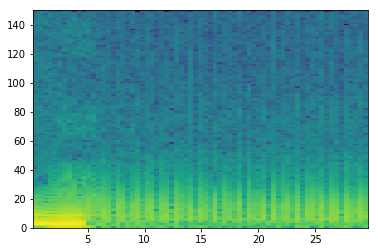

good List
[25, 31, 33, 36, 39, 41, 43, 45, 53, 60, 63]
[6, 2, 3, 3, 2, 2, 2, 8, 7, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


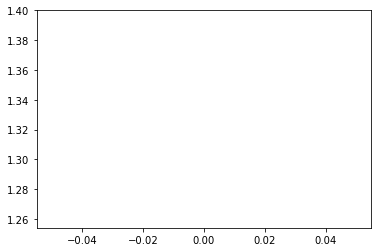

A00389
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

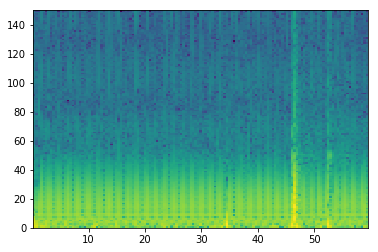

good List
[30, 32, 45, 52, 69, 78, 83, 90, 94, 95, 99]
[2, 13, 7, 17, 9, 5, 7, 4, 1, 4]
the temp 3
[[], [], [], [], [], [], [], [], [9]]
[94, 95]
longest
[94, 95]
indexList
[94, 95]
theMin
12000
theMax
12300


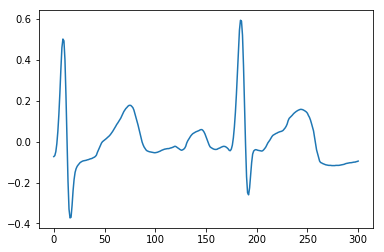

A00394
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333]


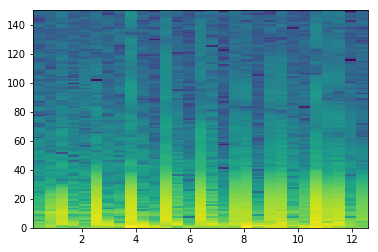

good List
[4, 7, 10, 13, 16, 19, 23, 27, 28]
[3, 3, 3, 3, 3, 4, 4, 1]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


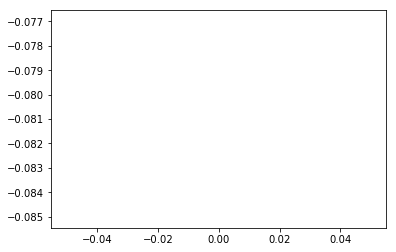

A00396
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


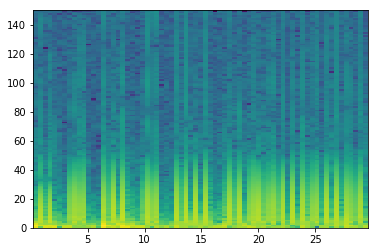

good List
[0, 2, 4, 5, 6, 7, 8, 11, 12, 13, 15, 17, 19, 20, 21, 22, 24, 26, 27, 28, 30, 32, 34, 36, 37, 38, 39, 41, 43, 44, 45, 47, 48, 50, 51, 52, 54, 56, 59, 61, 63, 66, 68]
[2, 2, 1, 1, 1, 1, 3, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 3, 2, 2, 3, 2]
the temp 3
[[], [], [3, 4, 5, 6], [8, 9], [], [], [13, 14, 15], [], [18, 19], [], [], [], [24, 25, 26], [], [29, 30], [32], [34, 35], [], [], [], [], [], []]
[4, 5, 6, 7, 8]
longest
[4, 5, 6, 7, 8]
indexList
[4, 5, 6, 7, 8]
theMin
600
theMax
900


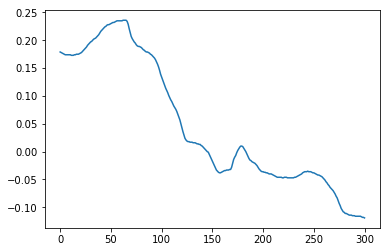

A00399
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


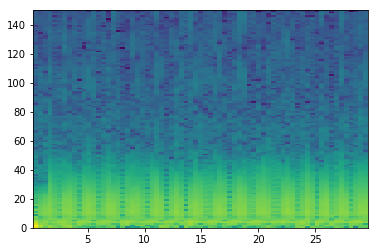

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


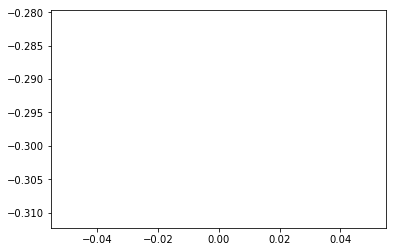

A00400
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


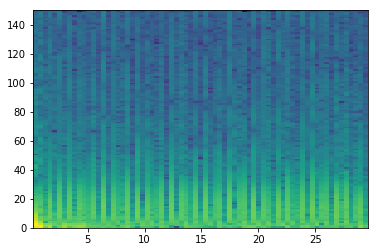

good List
[10, 11, 13, 15, 17, 18, 20, 22, 25, 27, 32, 34, 36, 39, 43, 44, 49, 53, 54, 56, 61, 68]
[1, 2, 2, 2, 1, 2, 2, 3, 2, 5, 2, 2, 3, 4, 1, 5, 4, 1, 2, 5, 7]
the temp 3
[[1], [], [], [5], [], [], [], [], [], [], [], [], [15], [], [18], [], []]
[10, 11]
longest
[10, 11]
indexList
[10, 11]
theMin
1200
theMax
1500


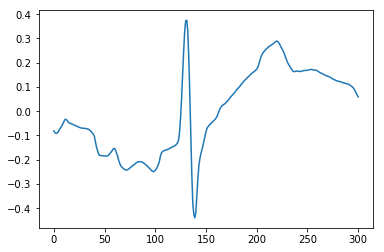

A00402
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

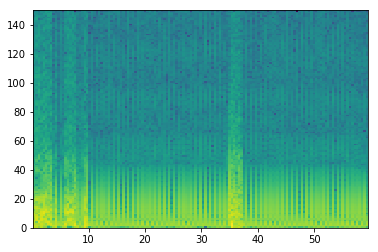

good List
[8, 10, 11, 12, 18, 19, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 51, 52, 53, 54, 55, 57, 59, 60, 61, 63, 64, 65, 66, 67, 68, 70, 71, 72, 74, 76, 77, 78, 79, 80, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 116, 117, 118, 119, 120, 121, 122, 123, 125, 126, 127, 129, 131, 132, 133, 134, 135, 136, 137, 138]
[2, 1, 1, 6, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 2, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 7, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[], [2, 3], [5], [7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17], [19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], [33, 34, 35, 36], [], [39, 40], [42, 43, 44, 45, 46], [48, 49], [], [52, 53, 54, 55], [57, 58, 59, 60, 

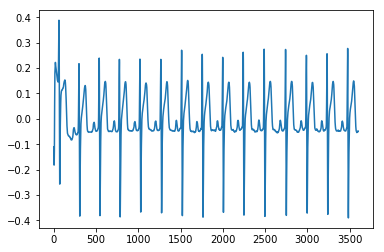

A00406
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

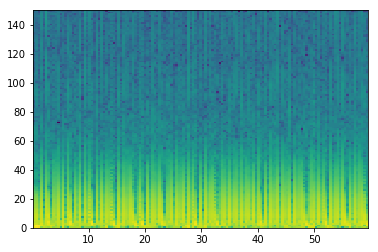

good List
[2, 4, 7, 11, 18, 20, 25, 27, 29, 34, 36, 46, 48, 58, 65, 68, 70, 72, 79, 80, 95, 102, 107, 119, 122, 138]
[2, 3, 4, 7, 2, 5, 2, 2, 5, 2, 10, 2, 10, 7, 3, 2, 2, 7, 1, 15, 7, 5, 12, 3, 16]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [19], [], [], [], [], []]
[79, 80]
longest
[79, 80]
indexList
[79, 80]
theMin
10200
theMax
10500


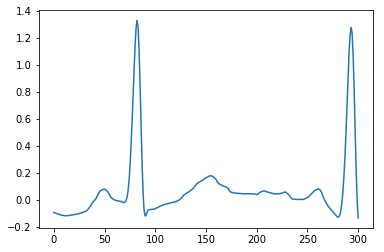

A00412
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


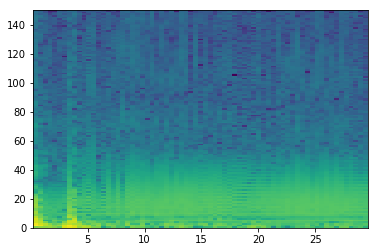

good List
[5, 29, 43, 61, 68]
[24, 14, 18, 7]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


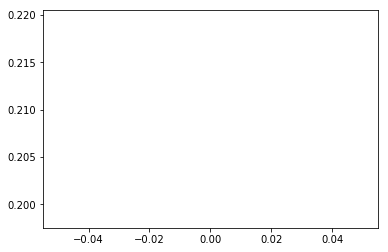

A00413
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

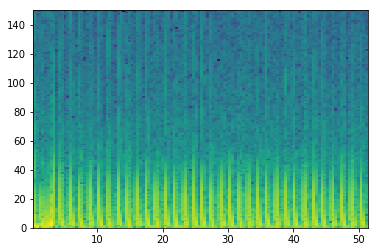

good List
[8, 11, 15, 18, 19, 25, 28, 29, 36, 38, 43, 46, 49, 59, 72, 78, 88, 99, 112, 119]
[3, 4, 3, 1, 6, 3, 1, 7, 2, 5, 3, 3, 10, 13, 6, 10, 11, 13, 7]
the temp 3
[[], [], [], [4], [], [7], [], [], [], [], [], [], [], [], [], [], []]
[18, 19]
longest
[18, 19]
indexList
[18, 19]
theMin
2400
theMax
2700


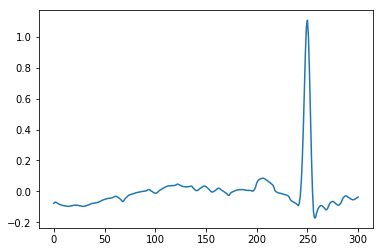

A00427
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


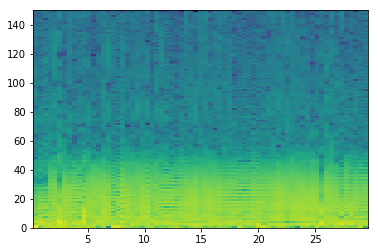

good List
[38]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


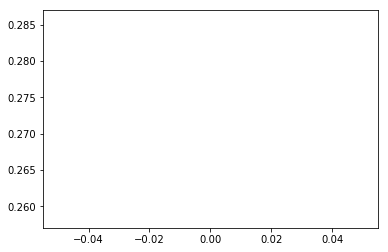

A00428
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


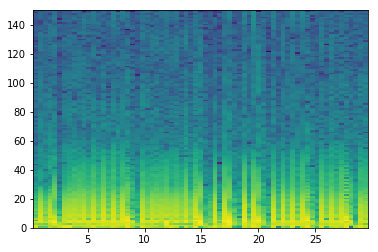

good List
[0, 2, 5, 20, 21, 30, 35, 36, 38, 42, 44, 48, 50, 52, 58, 65, 66]
[2, 3, 15, 1, 9, 5, 1, 2, 4, 2, 4, 2, 2, 6, 7, 1]
the temp 3
[[], [], [], [4], [], [7], [], [], [], [], [], [], []]
[20, 21]
longest
[20, 21]
indexList
[20, 21]
theMin
2400
theMax
2700


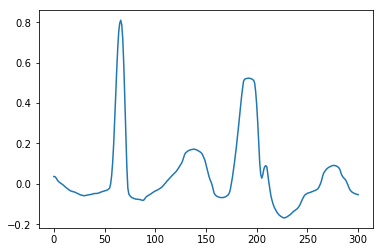

A00430
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


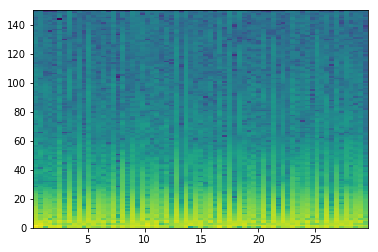

good List
[10, 12, 17, 28, 30, 35, 37, 52, 68]
[2, 5, 11, 2, 5, 2, 15, 16]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


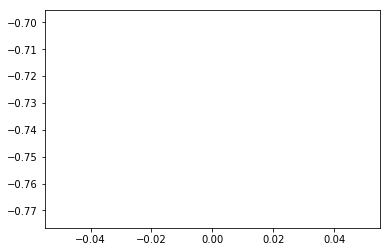

A00431
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


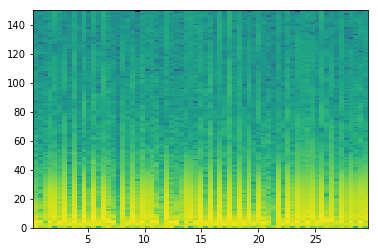

good List
[2, 5, 7, 9, 11, 13, 16, 17, 19, 26, 29, 30, 32, 33, 37, 41, 43, 45, 49, 51, 60, 62, 64, 66]
[3, 2, 2, 2, 2, 3, 1, 2, 7, 3, 1, 2, 1, 4, 4, 2, 2, 4, 2, 9, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [7], [], [], [11], [13], [], [], [], [], [], [], [], [], []]
[16, 17]
longest
[16, 17]
indexList
[16, 17]
theMin
2100
theMax
2400


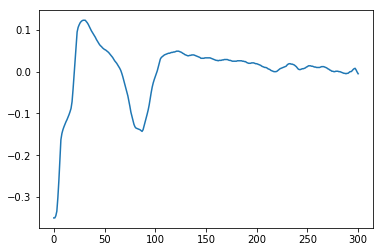

A00434
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


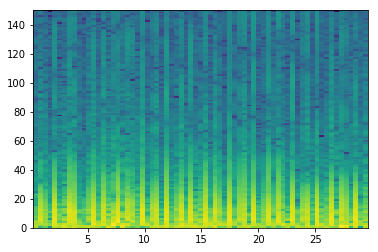

good List
[0, 2, 3, 9, 10, 13, 23, 26, 28, 36, 39, 41, 44, 46, 47, 52, 54, 55, 57, 59, 60, 64, 65, 67]
[2, 1, 6, 1, 3, 10, 3, 2, 8, 3, 2, 3, 2, 1, 5, 2, 1, 2, 2, 1, 4, 1, 2]
the temp 3
[[], [2], [4], [], [], [], [], [], [], [], [], [14], [], [17], [], [20], [22]]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


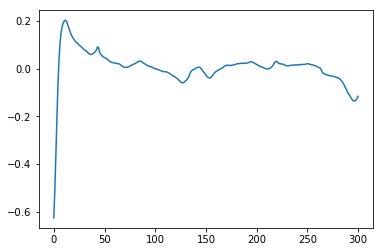

A00443
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


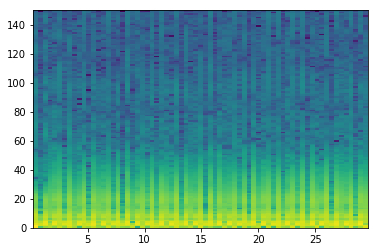

good List
[1, 11, 13, 14, 16, 18, 20, 25, 30, 39, 40, 44, 49, 51, 54, 56, 61, 66]
[10, 2, 1, 2, 2, 2, 5, 5, 9, 1, 4, 5, 2, 3, 2, 5, 5]
the temp 3
[[], [], [3], [], [], [], [], [], [10], [], [], [], [], [], []]
[13, 14]
longest
[13, 14]
indexList
[13, 14]
theMin
1500
theMax
1800


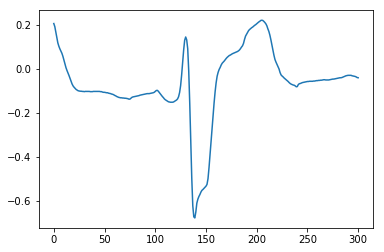

A00444
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


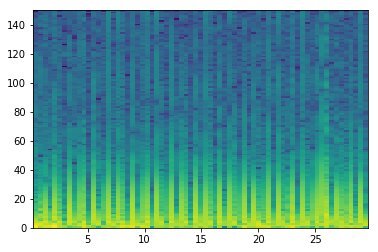

good List
[1, 2, 3, 5, 6, 8, 11, 13, 14, 16, 19, 21, 22, 24, 27, 29, 32, 34, 37, 39, 42, 44, 45, 46, 47, 49, 51, 52, 54, 56, 57, 61, 66, 68]
[1, 1, 2, 1, 2, 3, 2, 1, 2, 3, 2, 1, 2, 3, 2, 3, 2, 3, 2, 3, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 4, 5, 2]
the temp 3
[[1, 2], [4], [], [], [8], [], [], [12], [], [], [], [], [], [], [], [], [22, 23, 24], [], [27], [], [30], [], []]
[44, 45, 46, 47]
longest
[44, 45, 46, 47]
indexList
[44, 45, 46, 47]
theMin
5700
theMax
6000


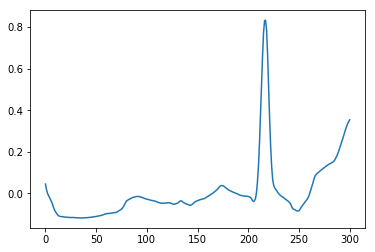

A00451
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


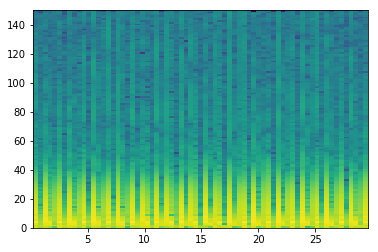

good List
[0, 1, 3, 4, 6, 8, 9, 11, 13, 14, 15, 16, 19, 21, 22, 23, 24, 26, 27, 28, 29, 31, 33, 34, 36, 37, 39, 41, 42, 44, 46, 47, 48, 49, 51, 52, 54, 56, 57, 58, 59, 61, 62, 64, 65, 66, 67, 68]
[1, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 3, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1]
the temp 3
[[1], [3], [], [6], [], [9, 10, 11], [], [14, 15, 16], [18, 19, 20], [], [23], [25], [], [28], [], [31, 32, 33], [35], [], [38, 39, 40], [42]]
[13, 14, 15, 16]
longest
[13, 14, 15, 16]
indexList
[13, 14, 15, 16]
theMin
1500
theMax
2100


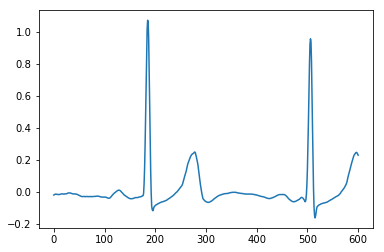

A00453
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

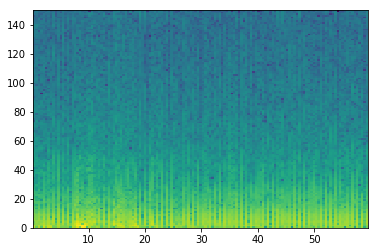

good List
[45, 78, 126]
[33, 48]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


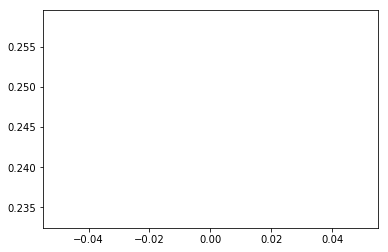

A00461
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

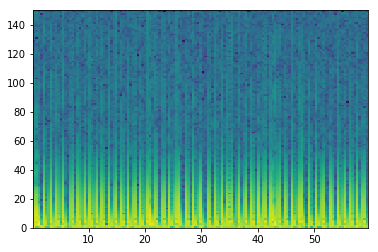

good List
[0, 2, 3, 5, 6, 8, 9, 10, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 40, 41, 42, 43, 44, 45, 46, 47, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 60, 61, 62, 63, 64, 65, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 99, 100, 101, 103, 104, 105, 106, 108, 109, 110, 112, 113, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138]
[2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[], [2], [4], [6, 7, 8], [10, 11, 12, 13], [15, 16, 17], [19, 20, 21, 22, 23, 24, 25, 26, 

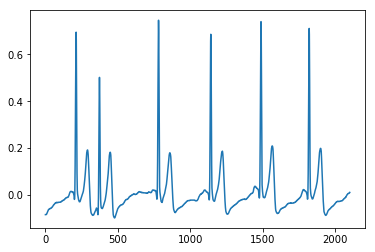

A00466
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


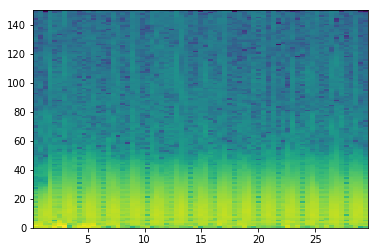

good List
[32, 50, 68]
[18, 18]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


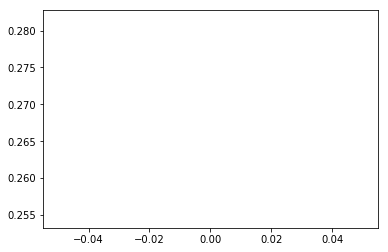

A00468
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


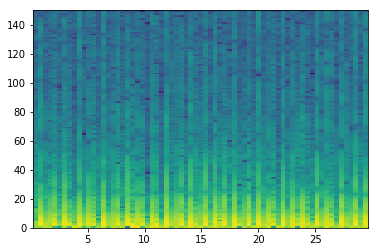

good List
[3, 5, 8, 10, 11, 13, 15, 18, 23, 26, 28, 31, 36, 40, 43, 45, 47, 50, 52, 56, 57, 59, 61, 62, 64, 65, 67]
[2, 3, 2, 1, 2, 2, 3, 5, 3, 2, 3, 5, 4, 3, 2, 2, 3, 2, 4, 1, 2, 2, 1, 2, 1, 2]
the temp 3
[[], [], [], [4], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [20], [], [23], [25]]
[10, 11]
longest
[10, 11]
indexList
[10, 11]
theMin
1200
theMax
1500


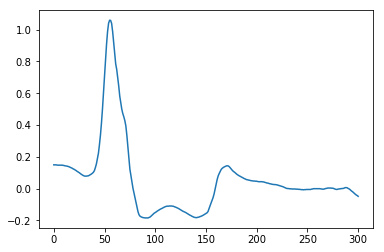

A00470
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

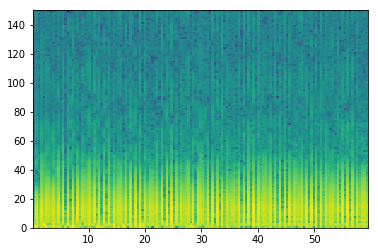

good List
[0, 1, 2, 4, 7, 9, 11, 13, 15, 17, 19, 22, 23, 24, 26, 28, 30, 32, 34, 35, 36, 37, 39, 41, 43, 45, 47, 48, 49, 50, 52, 54, 56, 58, 60, 62, 63, 64, 65, 67, 71, 73, 75, 76, 77, 79, 82, 83, 84, 85, 86, 88, 90, 92, 94, 97, 99, 101, 103, 105, 107, 108, 109, 110, 112, 113, 114, 116, 118, 119, 120, 122, 123, 125, 126, 127, 129, 131, 133, 135, 137, 138]
[1, 1, 2, 3, 2, 2, 2, 2, 2, 2, 3, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 4, 2, 2, 1, 1, 2, 3, 1, 1, 1, 1, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 1]
the temp 3
[[1, 2], [], [], [], [], [], [], [], [], [12, 13], [], [], [], [], [19, 20, 21], [], [], [], [], [27, 28, 29], [], [], [], [], [], [36, 37, 38], [], [], [], [43, 44], [], [47, 48, 49, 50], [], [], [], [], [], [], [], [], [], [61, 62, 63], [65, 66], [], [69, 70], [72], [74, 75], [], [], [], []]
[82, 83, 84, 85, 86]
longest
[82, 83, 84, 85, 86]
indexList
[82, 83, 84, 85, 86]
theMin
1050

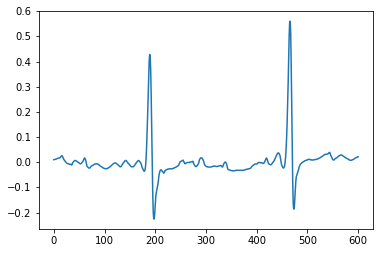

A00477
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

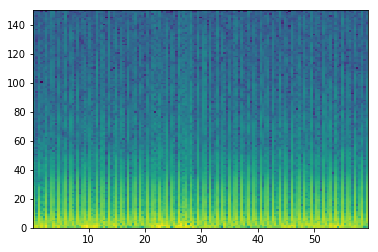

good List
[1, 6, 9, 11, 12, 14, 17, 19, 22, 27, 30, 32, 35, 37, 38, 40, 43, 46, 48, 56, 59, 66, 67, 69, 72, 74, 75, 77, 80, 82, 83, 85, 87, 88, 90, 93, 95, 98, 100, 101, 103, 106, 108, 111, 113, 114, 116, 119, 124, 127, 129, 132, 134, 135, 137]
[5, 3, 2, 1, 2, 3, 2, 3, 5, 3, 2, 3, 2, 1, 2, 3, 3, 2, 8, 3, 7, 1, 2, 3, 2, 1, 2, 3, 2, 1, 2, 2, 1, 2, 3, 2, 3, 2, 1, 2, 3, 2, 3, 2, 1, 2, 3, 5, 3, 2, 3, 2, 1, 2]
the temp 3
[[], [], [], [4], [], [], [], [], [], [], [], [], [14], [], [], [], [], [], [], [22], [], [], [26], [], [], [30], [], [33], [], [], [], [], [39], [], [], [], [], [45], [], [], [], [], [], [], [53]]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


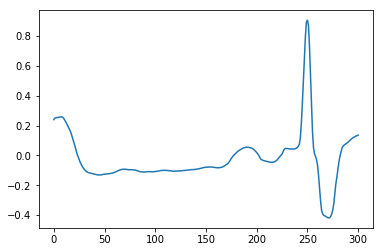

A00482
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


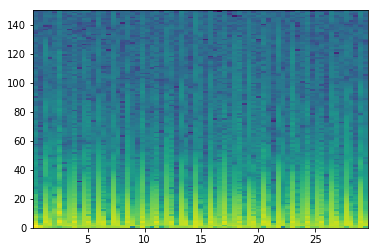

good List
[0, 1, 4, 6, 7, 9, 12, 14, 15, 17, 18, 20, 21, 23, 24, 26, 29, 30, 31, 32, 34, 35, 37, 38, 40, 41, 43, 44, 45, 46, 49, 50, 51, 52, 55, 57, 58, 60, 63, 66]
[1, 3, 2, 1, 2, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 3, 1, 1, 1, 3, 2, 1, 2, 3, 3]
the temp 3
[[1], [], [4], [], [], [8], [10], [12], [14], [], [17, 18, 19], [21], [23], [25], [27, 28, 29], [31, 32, 33], [], [36], [], []]
[29, 30, 31, 32]
longest
[29, 30, 31, 32]
indexList
[29, 30, 31, 32]
theMin
3600
theMax
4200


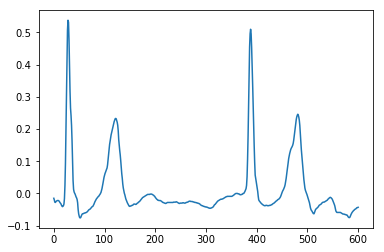

A00484
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

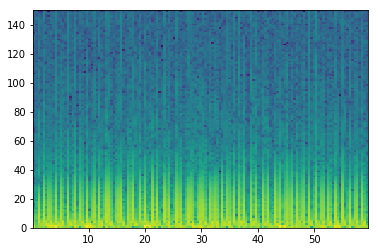

good List
[0, 1, 3, 5, 6, 7, 8, 10, 12, 13, 15, 16, 18, 21, 23, 24, 26, 28, 29, 31, 32, 33, 35, 37, 38, 43, 45, 47, 48, 50, 52, 53, 55, 57, 58, 60, 62, 63, 64, 67, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 84, 86, 88, 89, 93, 94, 98, 99, 101, 103, 104, 106, 108, 110, 111, 113, 115, 116, 118, 119, 121, 122, 124, 127, 129, 130, 132, 133, 134, 135, 137, 138]
[1, 2, 2, 1, 1, 1, 2, 2, 1, 2, 1, 2, 3, 2, 1, 2, 2, 1, 2, 1, 1, 2, 2, 1, 5, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, 3, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 4, 1, 4, 1, 2, 2, 1, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 1, 1, 2, 1]
the temp 3
[[1], [], [4, 5, 6], [], [9], [11], [], [], [15], [], [18], [20, 21], [], [24], [], [], [28], [], [31], [], [34], [], [37, 38], [], [41, 42, 43, 44, 45, 46, 47, 48, 49, 50], [], [], [54], [56], [58], [], [61], [], [], [65], [], [68], [70], [72], [], [], [76], [78, 79, 80]]
[72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82]
longest
[72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82]
indexList


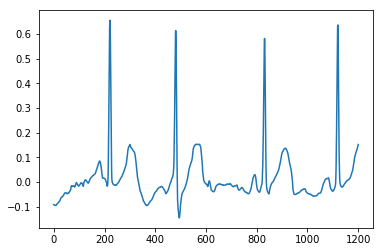

A00485
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


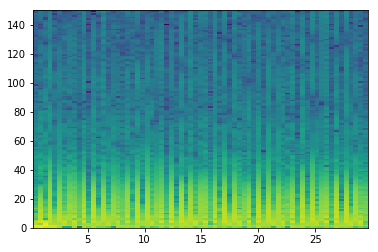

good List
[4, 9, 11, 13, 18, 27, 29, 31, 33, 36, 40, 45, 47, 54, 56, 59, 61, 65]
[5, 2, 2, 5, 9, 2, 2, 2, 3, 4, 5, 2, 7, 2, 3, 2, 4]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


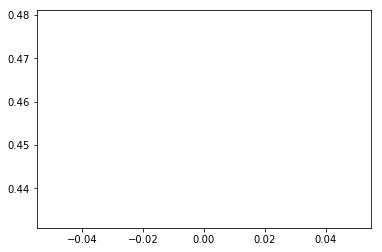

A00497
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


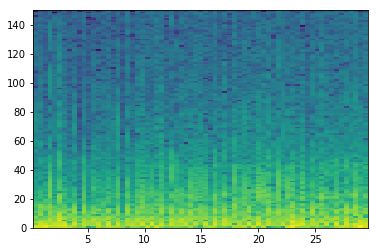

good List
[2, 4, 6, 7, 9, 11, 16, 18, 20, 27, 36, 40, 56]
[2, 2, 1, 2, 2, 5, 2, 2, 7, 9, 4, 16]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], []]
[6, 7]
longest
[6, 7]
indexList
[6, 7]
theMin
600
theMax
900


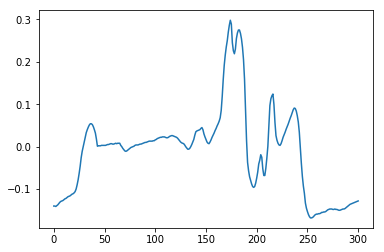

A00498
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


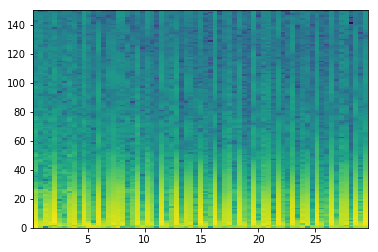

good List
[9, 11, 12, 22, 25, 30, 33, 35, 36, 38, 43, 44, 49, 51, 52, 54, 57, 59, 60, 62, 65]
[2, 1, 10, 3, 5, 3, 2, 1, 2, 5, 1, 5, 2, 1, 2, 3, 2, 1, 2, 3]
the temp 3
[[], [2], [], [], [], [], [8], [], [11], [], [14], [], [], [18], []]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


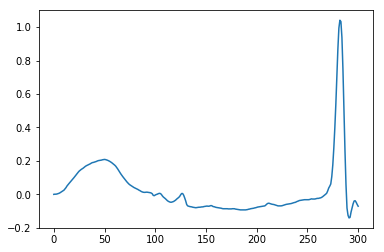

A00502
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


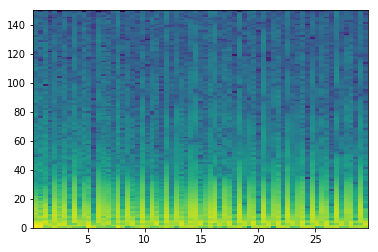

good List
[3, 5, 7, 12, 16, 18, 20, 21, 23, 25, 26, 28, 31, 35, 39, 41, 46, 48, 49, 51, 53, 54, 56, 58, 61, 63, 66, 68]
[2, 2, 5, 4, 2, 2, 1, 2, 2, 1, 2, 3, 4, 4, 2, 5, 2, 1, 2, 2, 1, 2, 2, 3, 2, 3, 2]
the temp 3
[[], [], [], [], [], [], [7], [], [10], [], [], [], [], [], [], [18], [], [21], [], [], [], [], []]
[20, 21]
longest
[20, 21]
indexList
[20, 21]
theMin
2400
theMax
2700


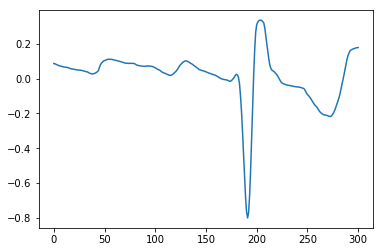

A00503
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


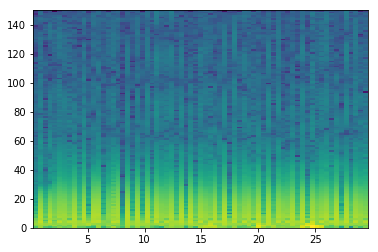

good List
[0, 2, 4, 9, 11, 12, 14, 18, 20, 22, 24, 29, 31, 33, 37, 40, 42, 45, 47, 49, 51, 52, 54, 56, 63, 65]
[2, 2, 5, 2, 1, 2, 4, 2, 2, 2, 5, 2, 2, 4, 3, 2, 3, 2, 2, 2, 1, 2, 2, 7, 2]
the temp 3
[[], [], [], [], [5], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [21], [], [], []]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


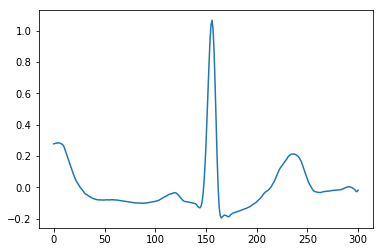

A00511
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


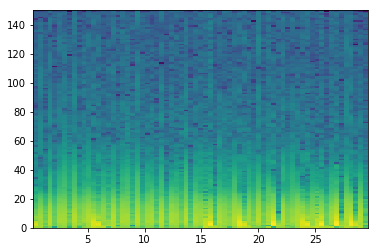

good List
[0, 1, 2, 4, 9, 12, 15, 17, 22, 25, 27, 28, 32, 37, 40, 43, 45, 46, 47, 50, 58, 60, 61, 62, 63, 66, 67, 68]
[1, 1, 2, 5, 3, 3, 2, 5, 3, 2, 1, 4, 5, 3, 3, 2, 1, 1, 3, 8, 2, 1, 1, 1, 3, 1, 1]
the temp 3
[[1, 2], [], [], [], [], [], [], [], [11], [], [], [], [], [17, 18], [], [], [22, 23, 24]]
[60, 61, 62, 63]
longest
[60, 61, 62, 63]
indexList
[60, 61, 62, 63]
theMin
7800
theMax
8100


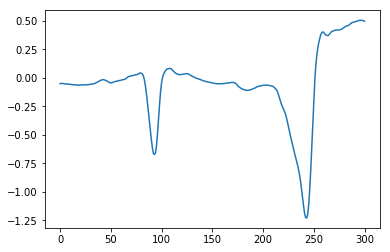

A00521
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


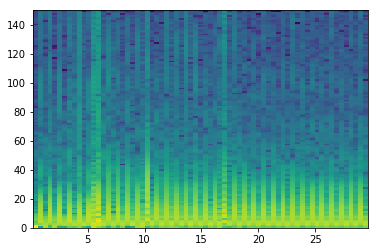

good List
[0, 10, 18, 20, 29, 30, 36, 37, 44, 46, 48, 50, 53, 59, 60, 61, 62, 65, 66]
[10, 8, 2, 9, 1, 6, 1, 7, 2, 2, 2, 3, 6, 1, 1, 1, 3, 1]
the temp 3
[[], [], [], [], [5], [7], [], [], [], [], [], [14, 15, 16]]
[59, 60, 61, 62]
longest
[59, 60, 61, 62]
indexList
[59, 60, 61, 62]
theMin
7500
theMax
7800


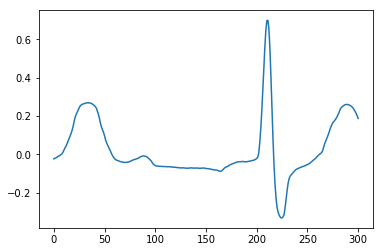

A00522
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


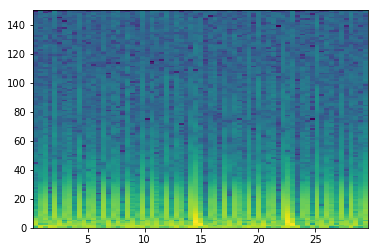

good List
[0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 28, 30, 31, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 59, 60, 61, 62, 64, 65, 66, 67]
[1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1]
the temp 3
[[1], [3, 4, 5, 6, 7], [9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], [21, 22, 23], [], [26], [28, 29, 30, 31, 32, 33, 34, 35, 36], [38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49], [51, 52, 53]]
[45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57]
longest
[45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57]
indexList
[45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57]
theMin
5700
theMax
7200


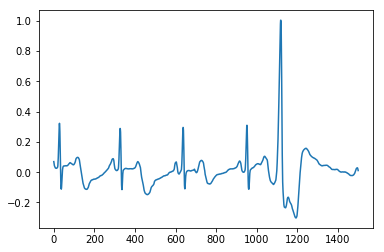

A00523
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


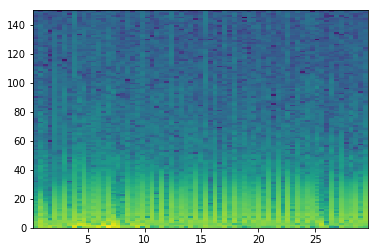

good List
[0, 3, 4, 5, 7, 11, 18, 20, 23, 25, 27, 28, 29, 30, 31, 35, 36, 38, 40, 42, 44, 46, 47, 49, 51, 55, 57, 60, 62, 64, 65, 66, 67]
[3, 1, 1, 2, 4, 7, 2, 3, 2, 2, 1, 1, 1, 1, 4, 1, 2, 2, 2, 2, 2, 1, 2, 2, 4, 2, 3, 2, 2, 1, 1, 1]
the temp 3
[[], [2, 3], [], [], [], [], [], [], [11, 12, 13, 14], [16], [], [], [], [], [22], [], [], [], [], [], []]
[27, 28, 29, 30, 31]
longest
[27, 28, 29, 30, 31]
indexList
[27, 28, 29, 30, 31]
theMin
3300
theMax
3900


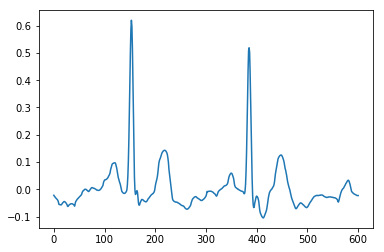

A00529
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


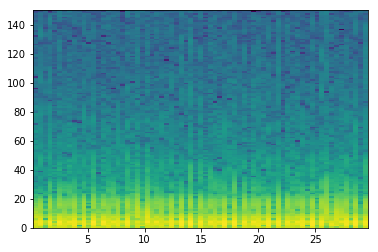

good List
[4, 13, 22, 24, 25, 30, 31, 33, 42, 49, 51, 58, 67]
[9, 9, 2, 1, 5, 1, 2, 9, 7, 2, 7, 9]
the temp 3
[[], [], [], [4], [6], [], [], [], [], []]
[24, 25]
longest
[24, 25]
indexList
[24, 25]
theMin
3000
theMax
3300


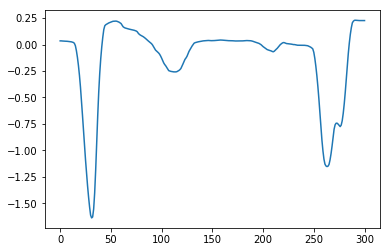

A00530
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


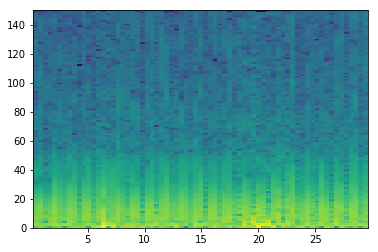

good List
[2, 9]
[7]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


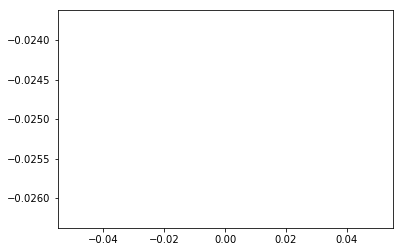

A00533
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


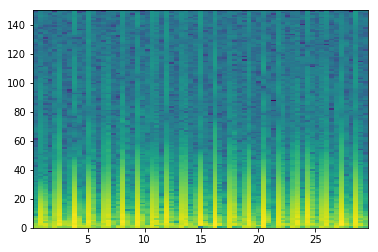

good List
[0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 16, 17, 19, 20, 22, 23, 24, 25, 26, 28, 29, 32, 33, 35, 36, 38, 39, 42, 43, 45, 46, 48, 49, 52, 55, 57, 58, 59, 61, 62, 64, 65, 67, 68]
[1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 3, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 3, 1, 2, 1, 2, 1, 3, 1, 2, 1, 2, 1, 3, 3, 2, 1, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[1, 2, 3, 4], [6, 7, 8, 9, 10, 11, 12], [14], [16], [18, 19, 20, 21], [23], [25], [27], [29], [31], [33], [35], [], [], [39, 40], [42], [44]]
[6, 7, 8, 9, 10, 11, 12, 13]
longest
[6, 7, 8, 9, 10, 11, 12, 13]
indexList
[6, 7, 8, 9, 10, 11, 12, 13]
theMin
600
theMax
1500


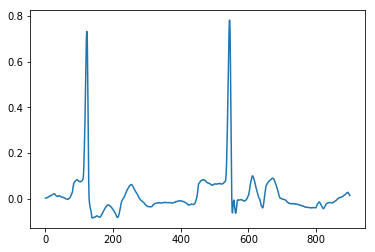

A00535
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333]


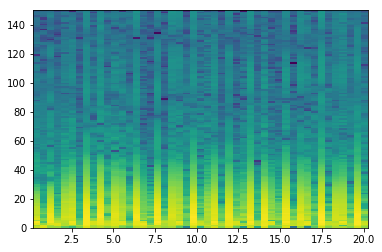

good List
[1, 3, 6, 8, 13, 15, 16, 18, 21, 23, 26, 29, 31, 33, 34, 36, 39, 42]
[2, 3, 2, 5, 2, 1, 2, 3, 2, 3, 3, 2, 2, 1, 2, 3, 3]
the temp 3
[[], [], [], [], [], [6], [], [], [], [], [], [], [14], [], []]
[15, 16]
longest
[15, 16]
indexList
[15, 16]
theMin
1800
theMax
2100


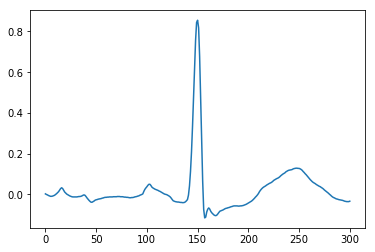

A00536
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


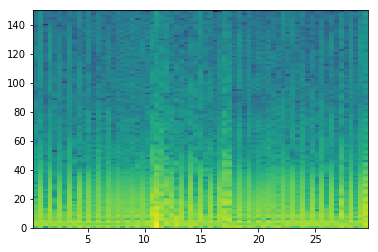

good List
[4, 41, 43, 62]
[37, 2, 19]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


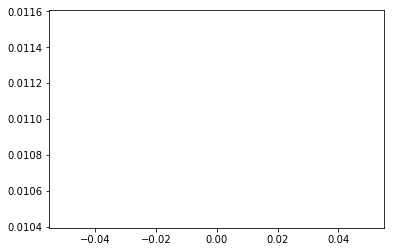

A00539
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

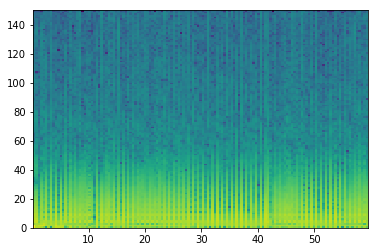

good List
[2, 6, 8, 11, 12, 14, 16, 18, 25, 27, 29, 34, 36, 38, 40, 42, 44, 45, 48, 49, 56, 58, 63, 65, 67, 68, 71, 73, 75, 77, 79, 81, 83, 85, 87, 93, 95, 101, 103, 108, 114, 116, 118, 120, 122, 124, 128, 130, 138]
[4, 2, 3, 1, 2, 2, 2, 7, 2, 2, 5, 2, 2, 2, 2, 2, 1, 3, 1, 7, 2, 5, 2, 2, 1, 3, 2, 2, 2, 2, 2, 2, 2, 2, 6, 2, 6, 2, 5, 6, 2, 2, 2, 2, 2, 4, 2, 8]
the temp 3
[[], [], [], [4], [], [], [], [], [], [], [], [], [], [], [], [17], [19], [], [], [], [], [25], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


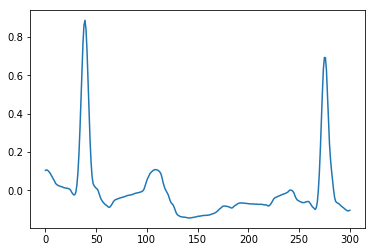

A00544
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667]


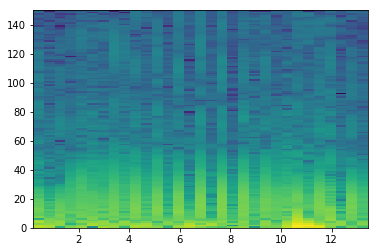

good List
[1, 3, 12, 14, 16, 18, 28, 30]
[2, 9, 2, 2, 2, 10, 2]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


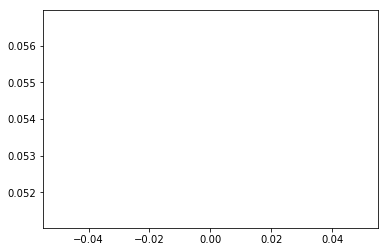

A00545
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


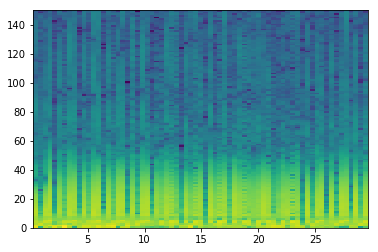

good List
[1, 4, 9, 11, 14, 19, 24, 25, 30, 32, 35, 37, 40, 41, 45, 49, 50, 52, 55, 60]
[3, 5, 2, 3, 5, 5, 1, 5, 2, 3, 2, 3, 1, 4, 4, 1, 2, 3, 5]
the temp 3
[[], [], [], [], [], [], [7], [], [], [], [], [13], [], [16], [], []]
[24, 25]
longest
[24, 25]
indexList
[24, 25]
theMin
3000
theMax
3300


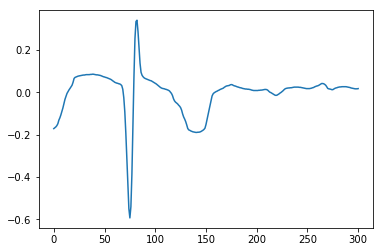

A00549
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


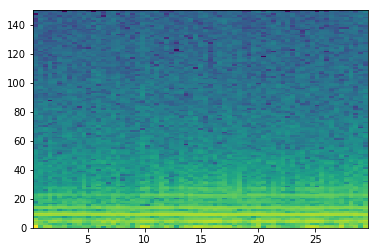

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


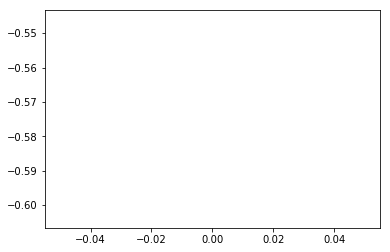

A00554
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


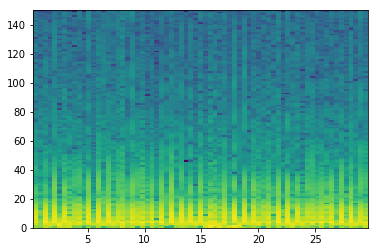

good List
[10, 12, 19, 25, 31, 33, 40, 42, 44, 51, 55]
[2, 7, 6, 6, 2, 7, 2, 2, 7, 4]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


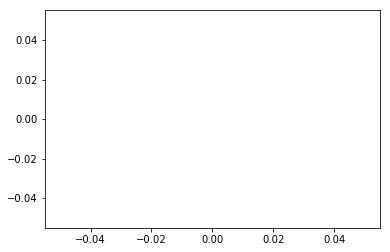

A00556
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


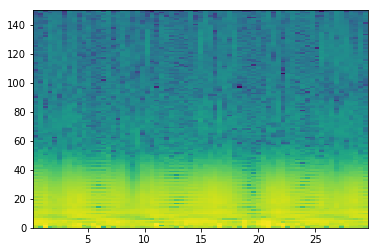

good List
[5, 10, 12, 19, 24, 25, 41, 45]
[5, 2, 7, 5, 1, 16, 4]
the temp 3
[[], [], [], [], [5], []]
[24, 25]
longest
[24, 25]
indexList
[24, 25]
theMin
3000
theMax
3300


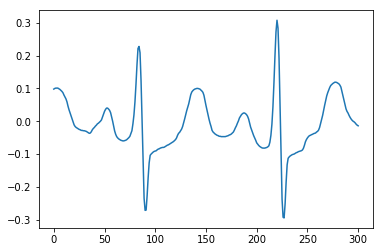

A00557
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333]


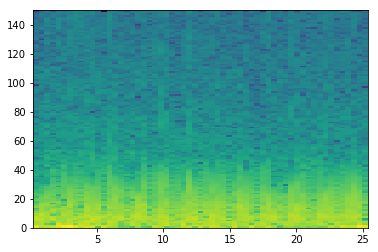

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


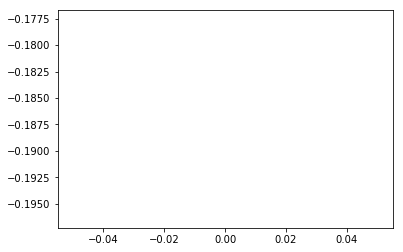

A00559
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


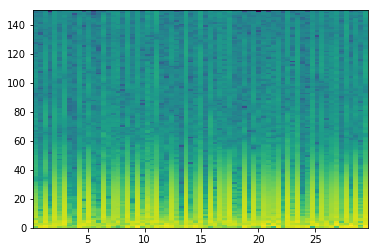

good List
[1, 3, 5, 7, 8, 10, 12, 13, 15, 16, 18, 20, 22, 26, 27, 29, 30, 32, 33, 35, 37, 39, 41, 42, 44, 46, 49, 51, 53, 55, 56, 58, 60, 63, 65, 67]
[2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 4, 1, 2, 1, 2, 1, 2, 2, 2, 2, 1, 2, 2, 3, 2, 2, 2, 1, 2, 2, 3, 2, 2]
the temp 3
[[], [], [], [4], [], [7], [9], [], [], [], [14], [16], [18], [], [], [], [23], [], [], [], [], [], [30], [], [], [], []]
[7, 8]
longest
[7, 8]
indexList
[7, 8]
theMin
900
theMax
1200


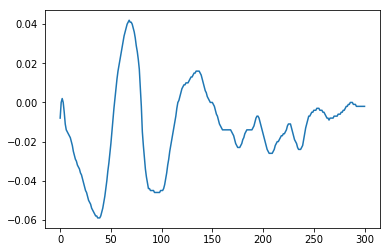

A00561
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


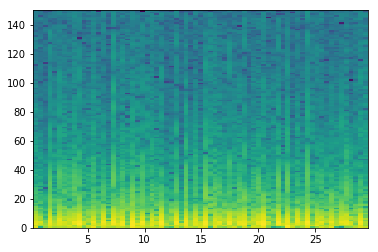

good List
[1, 2, 11, 15, 17, 25, 27, 28, 30, 32, 34, 44, 48, 51, 53, 55, 60, 61, 62, 66]
[1, 9, 4, 2, 8, 2, 1, 2, 2, 2, 10, 4, 3, 2, 2, 5, 1, 1, 4]
the temp 3
[[1], [], [], [], [], [7], [], [], [], [], [], [], [], [], [17, 18]]
[60, 61, 62]
longest
[60, 61, 62]
indexList
[60, 61, 62]
theMin
7800
theMax
8100


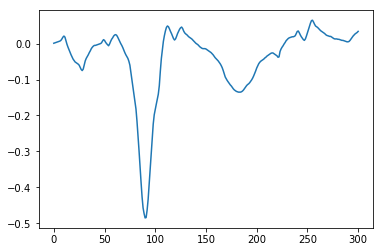

A00562
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

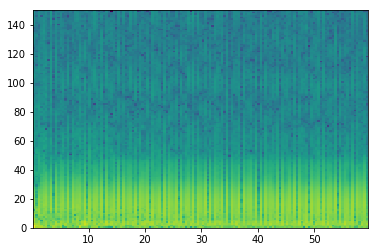

good List
[6, 8, 10, 11, 13, 15, 17, 20, 22, 24, 27, 29, 31, 34, 35, 36, 37, 38, 39, 41, 43, 45, 46, 47, 48, 50, 53, 55, 57, 58, 59, 60, 61, 62, 64, 65, 67, 69, 70, 71, 72, 73, 74, 76, 79, 81, 82, 83, 84, 86, 88, 89, 90, 91, 93, 95, 97, 98, 99, 100, 102, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 119, 121, 122, 123, 124, 126, 127, 128, 130, 131, 133, 135, 136, 137, 138]
[2, 2, 1, 2, 2, 2, 3, 2, 2, 3, 2, 2, 3, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 3, 2, 2, 1, 1, 1, 1, 1, 2, 1, 2, 2, 1, 1, 1, 1, 1, 2, 3, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 2, 1, 1, 1, 2, 1, 1, 2, 1, 2, 2, 1, 1, 1]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], [], [], [14, 15, 16, 17, 18], [], [], [22, 23, 24], [], [], [], [29, 30, 31, 32, 33], [35], [], [38, 39, 40, 41, 42], [], [], [46, 47, 48], [], [51, 52, 53], [], [], [57, 58, 59], [], [62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73], [], [76, 77, 78], [80, 81], [83], []]
[104, 105, 106,

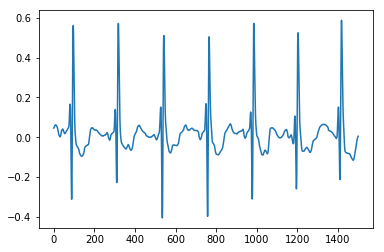

A00565
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


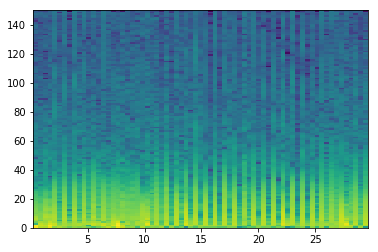

good List
[5, 7, 36, 38, 48, 54, 56]
[2, 29, 2, 10, 6, 2]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


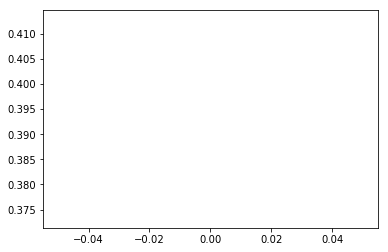

A00570
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


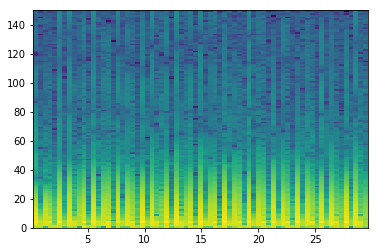

good List
[1, 2, 3, 4, 6, 8, 9, 11, 16, 18, 19, 21, 23, 25, 28, 33, 38, 40, 43, 45, 48, 50, 53, 58, 60, 62, 63, 65, 68]
[1, 1, 1, 2, 2, 1, 2, 5, 2, 1, 2, 2, 2, 3, 5, 5, 2, 3, 2, 3, 2, 3, 5, 2, 2, 1, 2, 3]
the temp 3
[[1, 2, 3], [], [6], [], [], [10], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [26], []]
[1, 2, 3, 4]
longest
[1, 2, 3, 4]
indexList
[1, 2, 3, 4]
theMin
0
theMax
600


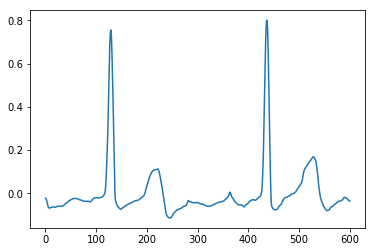

A00572
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667]


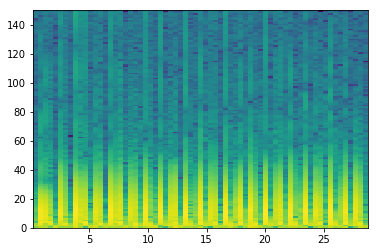

good List
[0, 4, 7, 10, 11, 14, 18, 21, 24, 26, 27, 28, 29, 31, 32, 34, 37, 39, 40, 42, 45, 47, 50, 52, 53, 55, 58, 60, 61, 63, 66]
[4, 3, 3, 1, 3, 4, 3, 3, 2, 1, 1, 1, 2, 1, 2, 3, 2, 1, 2, 3, 2, 3, 2, 1, 2, 3, 2, 1, 2, 3]
the temp 3
[[], [], [], [4], [], [], [], [], [10, 11, 12], [14], [], [], [18], [], [], [], [], [24], [], [], [28], []]
[26, 27, 28, 29]
longest
[26, 27, 28, 29]
indexList
[26, 27, 28, 29]
theMin
3300
theMax
3600


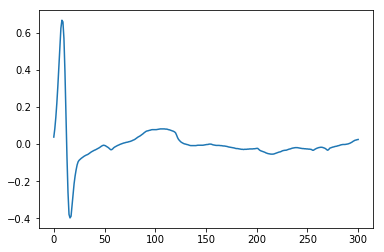

A00577
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


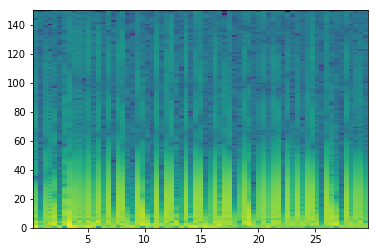

good List
[0, 1, 4, 5, 10, 12, 14, 16, 19, 20, 23, 24, 26, 29, 30, 32, 35, 36, 38, 41, 42, 45, 46, 48, 51, 53, 55, 58, 59, 62, 63, 65, 66, 68]
[1, 3, 1, 5, 2, 2, 2, 3, 1, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 3, 1, 2, 3, 2, 2, 3, 1, 3, 1, 2, 1, 2]
the temp 3
[[1], [3], [], [], [], [], [9], [11], [], [14], [], [17], [], [20], [22], [], [], [], [], [28], [30], [32]]
[0, 1]
longest
[0, 1]
indexList
[0, 1]
theMin
0
theMax
300


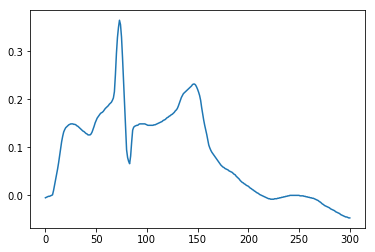

A00584
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


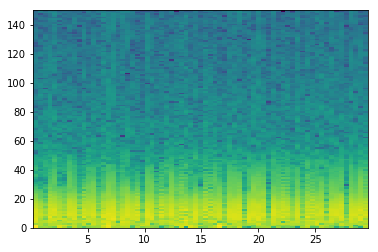

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


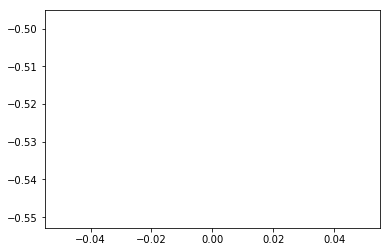

A00593
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


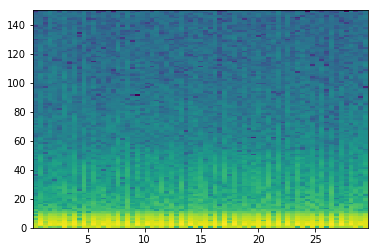

good List
[2, 7, 9, 10, 11, 13, 14, 15, 20, 24, 26, 31, 32, 38, 44, 47, 49, 51, 55, 58, 60, 62, 64]
[5, 2, 1, 1, 2, 1, 1, 5, 4, 2, 5, 1, 6, 6, 3, 2, 2, 4, 3, 2, 2, 2]
the temp 3
[[], [], [3, 4], [6, 7], [], [], [], [12], [], [], [], [], [], [], [], [], []]
[9, 10, 11]
longest
[9, 10, 11]
indexList
[9, 10, 11]
theMin
1200
theMax
1500


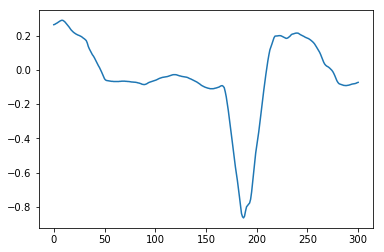

A00603
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


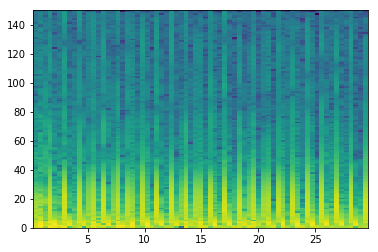

good List
[5, 7, 8, 11, 13, 15, 16, 18, 24, 26, 27, 29, 32, 38, 41, 43, 44, 46, 49, 52, 55, 57, 58, 61, 64, 66, 67]
[2, 1, 3, 2, 2, 1, 2, 6, 2, 1, 2, 3, 6, 3, 2, 1, 2, 3, 3, 3, 2, 1, 3, 3, 2, 1]
the temp 3
[[], [2], [], [], [6], [], [], [10], [], [], [], [], [16], [], [], [], [], [22], [], []]
[7, 8]
longest
[7, 8]
indexList
[7, 8]
theMin
900
theMax
1200


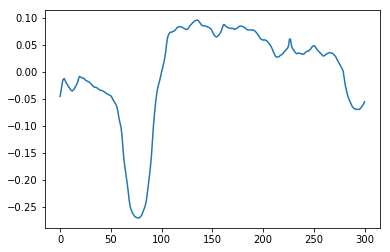

A00605
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


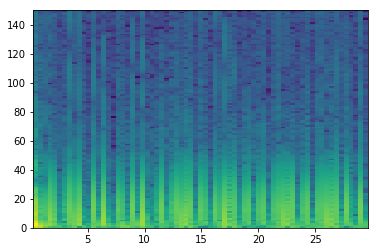

good List
[5, 6, 10, 11, 13, 15, 16, 17, 19, 21, 24, 25, 27, 33, 36, 38, 42, 45, 48, 49, 53, 54, 55, 57, 63, 65, 66, 68]
[1, 4, 1, 2, 2, 1, 1, 2, 2, 3, 1, 2, 6, 3, 2, 4, 3, 3, 1, 4, 1, 1, 2, 6, 2, 1, 2]
the temp 3
[[1], [3], [], [6, 7], [], [], [11], [], [], [], [], [], [], [19], [21, 22], [], [], [26]]
[15, 16, 17]
longest
[15, 16, 17]
indexList
[15, 16, 17]
theMin
1800
theMax
2100


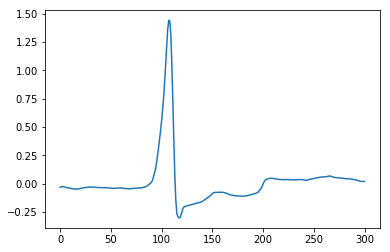

A00608
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


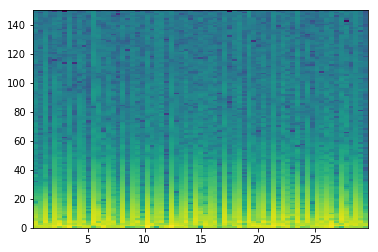

good List
[0, 1, 2, 3, 6, 8, 10, 11, 14, 16, 17, 19, 20, 22, 24, 25, 27, 29, 30, 32, 33, 35, 36, 37, 38, 40, 41, 43, 45, 46, 48, 50, 53, 55, 57, 59, 62, 65, 66, 68]
[1, 1, 1, 3, 2, 2, 1, 3, 2, 1, 2, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 2, 2, 1, 2, 2, 3, 2, 2, 2, 3, 3, 1, 2]
the temp 3
[[1, 2, 3], [], [], [7], [], [10], [12], [], [15], [], [18], [20], [22, 23, 24], [26], [], [29], [], [], [], [], [], [], [], [38]]
[0, 1, 2, 3]
longest
[0, 1, 2, 3]
indexList
[0, 1, 2, 3]
theMin
0
theMax
300


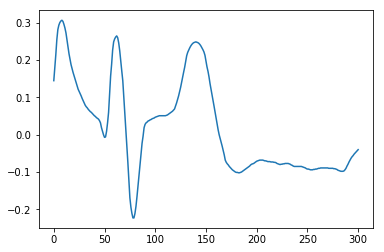

A00612
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


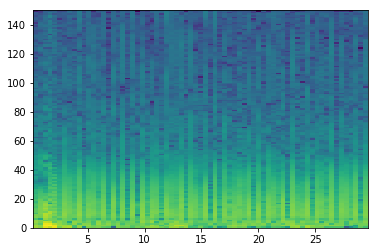

good List
[10, 15, 62]
[5, 47]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


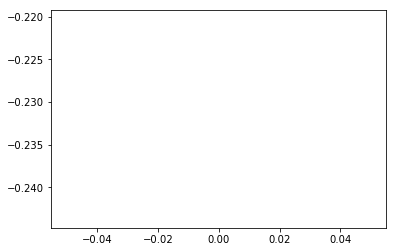

A00623
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


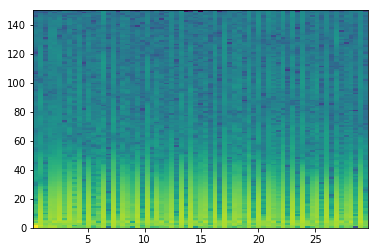

good List
[0, 2, 8, 10, 11, 12, 13, 15, 17, 18, 19, 20, 22, 24, 26, 27, 29, 31, 33, 36, 38, 40, 41, 42, 45, 47, 48, 50, 52, 54, 56, 57, 59, 61, 63, 64, 66, 68]
[2, 6, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 3, 2, 2, 1, 1, 3, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2]
the temp 3
[[], [], [], [4, 5, 6], [], [9, 10, 11], [], [], [15], [], [], [], [], [], [22, 23], [], [26], [], [], [], [31], [], [], [35], []]
[10, 11, 12, 13]
longest
[10, 11, 12, 13]
indexList
[10, 11, 12, 13]
theMin
1200
theMax
1500


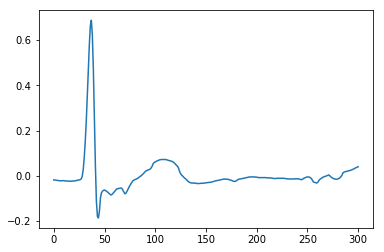

A00626
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

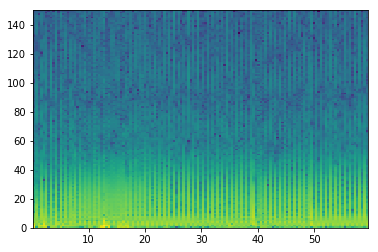

good List
[0, 6, 8, 10, 12, 22, 23, 24, 28, 30, 34, 36, 41, 51, 55, 58, 59, 61, 63, 69, 71, 73, 75, 77, 81, 83, 87, 89, 92, 95, 97, 99, 101, 103, 105, 107, 109, 111, 116, 118, 120, 122, 124, 128, 136, 138]
[6, 2, 2, 2, 10, 1, 1, 4, 2, 4, 2, 5, 10, 4, 3, 1, 2, 2, 6, 2, 2, 2, 2, 4, 2, 4, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 5, 2, 2, 2, 2, 4, 8, 2]
the temp 3
[[], [], [], [], [], [6, 7], [], [], [], [], [], [], [], [16], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[22, 23, 24]
longest
[22, 23, 24]
indexList
[22, 23, 24]
theMin
2700
theMax
3000


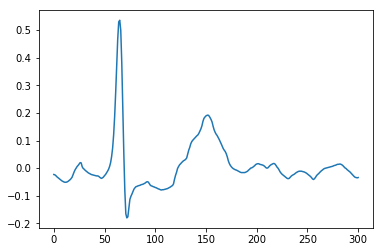

A00634
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

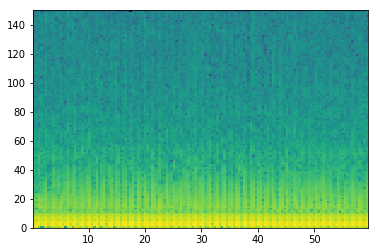

good List
[13, 39, 89, 95, 103]
[26, 50, 6, 8]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


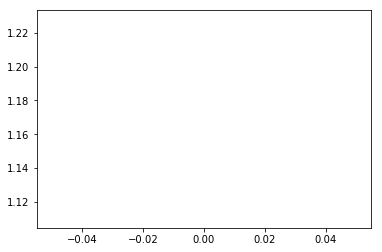

A00638
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


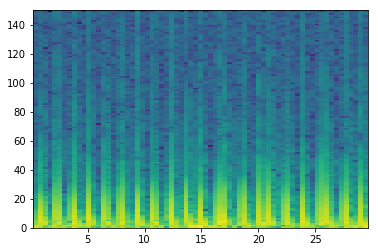

good List
[0, 2, 3, 6, 7, 9, 10, 12, 13, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 29, 30, 32, 33, 35, 36, 37, 38, 40, 41, 42, 43, 44, 45, 47, 48, 50, 51, 53, 54, 56, 57, 58, 61, 62, 63, 64, 65, 66, 68]
[2, 1, 3, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 3, 1, 1, 1, 1, 1, 2]
the temp 3
[[], [2], [4], [6], [8], [10, 11, 12, 13, 14], [16, 17, 18, 19, 20], [22], [24], [26, 27, 28], [30, 31, 32, 33, 34], [36], [38], [40], [42, 43], [45, 46, 47, 48, 49]]
[15, 16, 17, 18, 19, 20]
longest
[15, 16, 17, 18, 19, 20]
indexList
[15, 16, 17, 18, 19, 20]
theMin
1800
theMax
2400


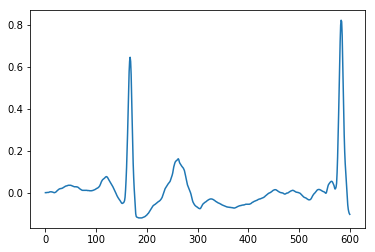

A00640
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

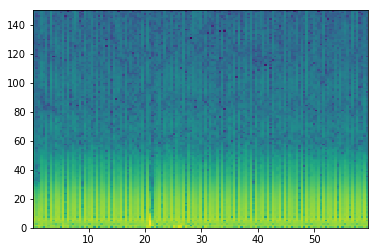

good List
[1, 2, 6, 8, 11, 13, 18, 20, 27, 30, 32, 34, 37, 39, 44, 46, 49, 53, 58, 60, 62, 63, 65, 67, 68, 70, 74, 75, 77, 79, 84, 91, 93, 96, 98, 103, 105, 110, 112, 114, 117, 119, 121, 126, 128, 131, 133, 138]
[1, 4, 2, 3, 2, 5, 2, 7, 3, 2, 2, 3, 2, 5, 2, 3, 4, 5, 2, 2, 1, 2, 2, 1, 2, 4, 1, 2, 2, 5, 7, 2, 3, 2, 5, 2, 5, 2, 2, 3, 2, 2, 5, 2, 3, 2, 5]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [21], [], [24], [], [27], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


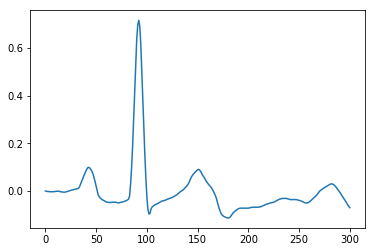

A00646
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


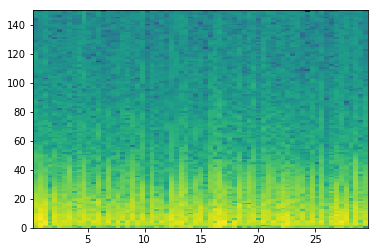

good List
[23, 26, 32, 55, 60]
[3, 6, 23, 5]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


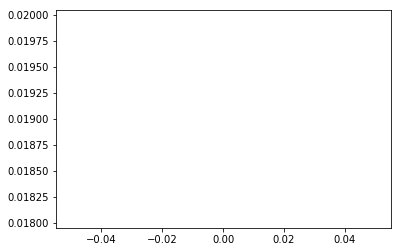

A00649
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

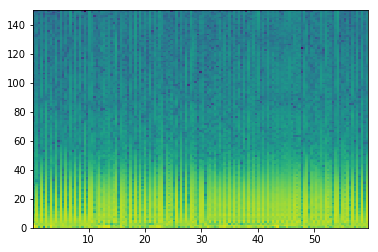

good List
[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 35, 39, 41, 43, 45, 47, 49, 54, 60, 62, 64, 68, 71, 76, 82, 86, 88, 94, 96, 111, 114, 124, 127, 131, 133, 135, 137]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 13, 4, 2, 2, 2, 2, 2, 5, 6, 2, 2, 4, 3, 5, 6, 4, 2, 6, 2, 15, 3, 10, 3, 4, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


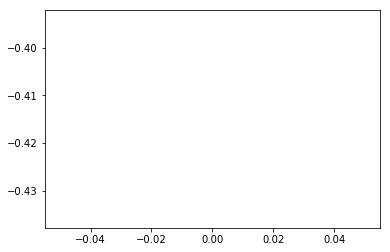

A00650
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


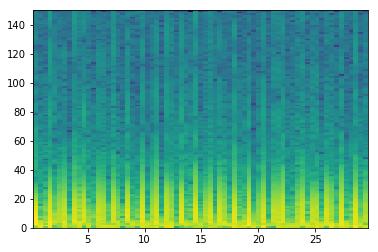

good List
[1, 4, 7, 12, 15, 18, 20, 21, 23, 24, 26, 29, 35, 37, 40, 42, 43, 45, 46, 48, 49, 52, 53, 56, 59, 62, 64, 65, 67, 68]
[3, 3, 5, 3, 3, 2, 1, 2, 1, 2, 3, 6, 2, 3, 2, 1, 2, 1, 2, 1, 3, 1, 3, 3, 3, 2, 1, 2, 1]
the temp 3
[[], [], [], [], [], [], [7], [9], [], [], [], [], [], [16], [18], [20], [22], [], [], [], [27]]
[20, 21]
longest
[20, 21]
indexList
[20, 21]
theMin
2400
theMax
2700


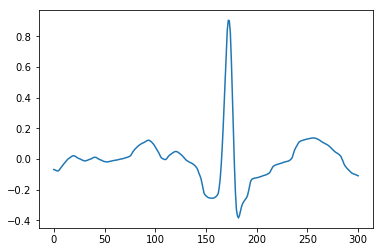

A00653
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


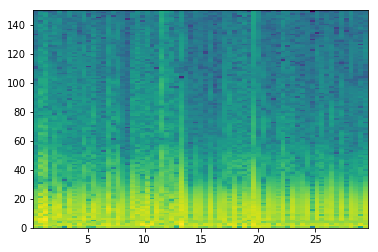

good List
[18, 19, 32, 34, 35, 57, 62, 65]
[1, 13, 2, 1, 22, 5, 3]
the temp 3
[[1], [], [4], [], []]
[18, 19]
longest
[18, 19]
indexList
[18, 19]
theMin
2400
theMax
2700


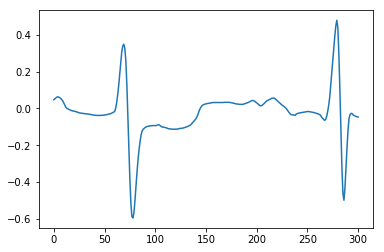

A00656
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


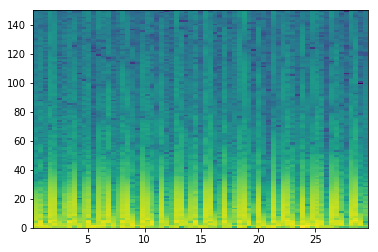

good List
[2, 5, 9, 12, 21, 28, 34, 37, 38, 40, 45, 48, 54, 56, 60, 63, 64, 68]
[3, 4, 3, 9, 7, 6, 3, 1, 2, 5, 3, 6, 2, 4, 3, 1, 4]
the temp 3
[[], [], [], [], [], [], [], [8], [], [], [], [], [], [], [16]]
[37, 38]
longest
[37, 38]
indexList
[37, 38]
theMin
4800
theMax
5100


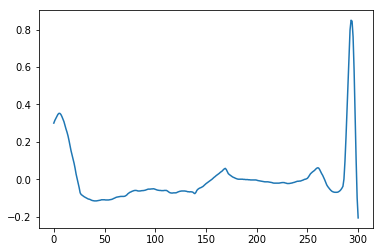

A00657
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


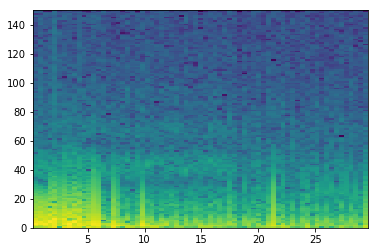

good List
[59]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


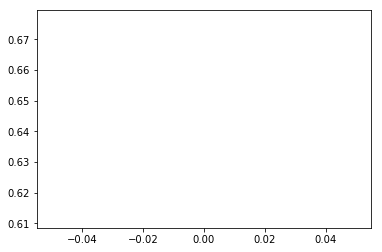

A00659
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


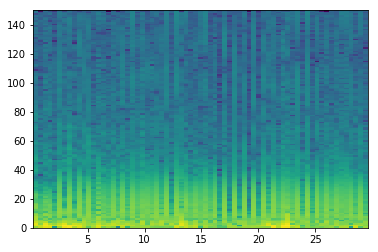

good List
[34, 36, 38, 40, 42, 44, 46, 57]
[2, 2, 2, 2, 2, 2, 11]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


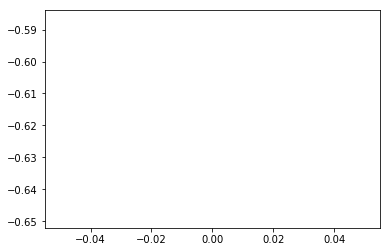

A00660
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667]


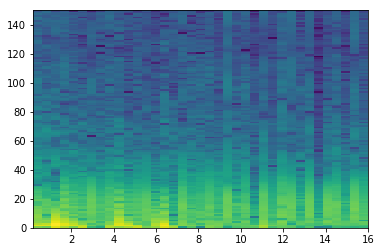

good List
[26, 31]
[5]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


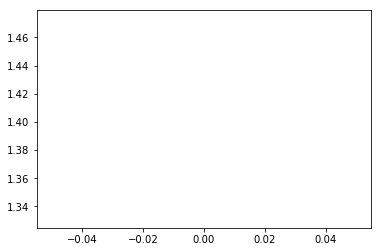

A00664
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


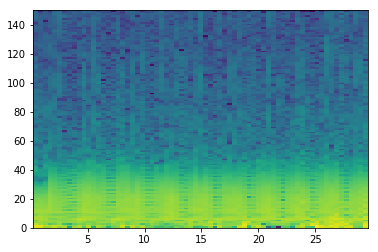

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


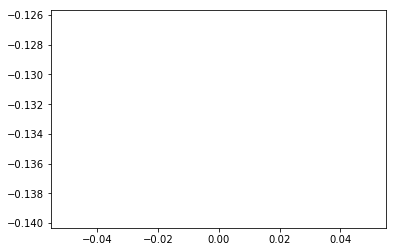

A00673
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76      ]


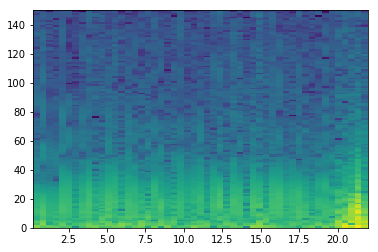

good List
[0, 6, 8, 10, 13, 16, 20, 26, 27, 29, 32, 38, 39, 42]
[6, 2, 2, 3, 3, 4, 6, 1, 2, 3, 6, 1, 3]
the temp 3
[[], [], [], [], [], [], [], [8], [], [], [12]]
[26, 27]
longest
[26, 27]
indexList
[26, 27]
theMin
3300
theMax
3600


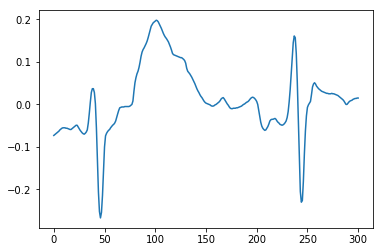

A00675
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2       ]


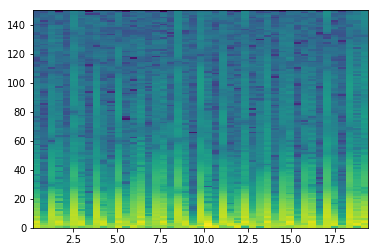

good List
[0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15, 17, 18, 21, 24, 26, 27, 29, 30, 32, 33, 35, 36, 37, 38, 40, 41]
[1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 2, 1, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1]
the temp 3
[[1], [3, 4, 5, 6, 7, 8, 9], [11], [], [14], [], [], [18], [20], [22], [24, 25, 26]]
[3, 4, 5, 6, 7, 8, 9, 10]
longest
[3, 4, 5, 6, 7, 8, 9, 10]
indexList
[3, 4, 5, 6, 7, 8, 9, 10]
theMin
300
theMax
1200


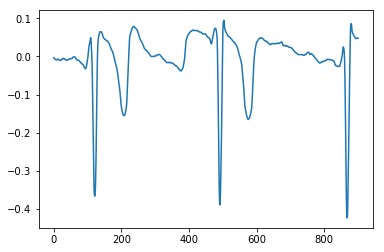

A00679
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


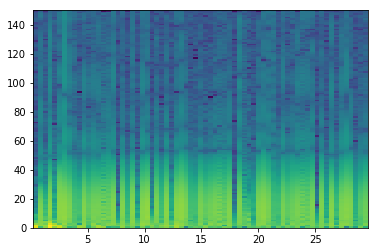

good List
[0, 2, 4, 8, 9, 17, 19, 21, 24, 26, 28, 32, 33, 35, 36, 41, 43, 44, 45, 50, 52, 58, 60, 62, 66, 67, 68]
[2, 2, 4, 1, 8, 2, 2, 3, 2, 2, 4, 1, 2, 1, 5, 2, 1, 1, 5, 2, 6, 2, 2, 4, 1, 1]
the temp 3
[[], [], [], [4], [], [], [], [], [], [], [12], [14], [], [17, 18], [], [], [], [], []]
[43, 44, 45]
longest
[43, 44, 45]
indexList
[43, 44, 45]
theMin
5400
theMax
5700


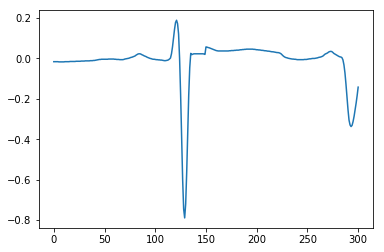

A00684
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


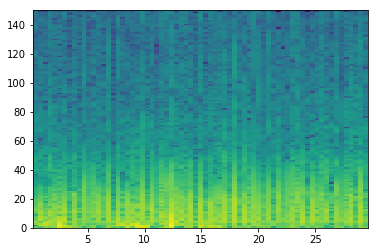

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


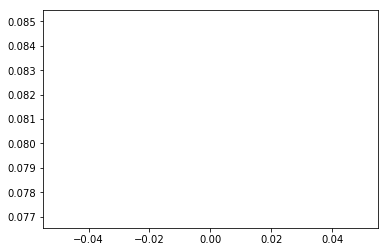

A00687
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


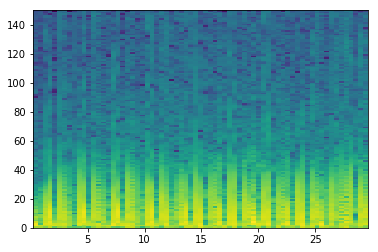

good List
[0, 1, 4, 11]
[1, 3, 7]
the temp 3
[[1], []]
[0, 1]
longest
[0, 1]
indexList
[0, 1]
theMin
0
theMax
300


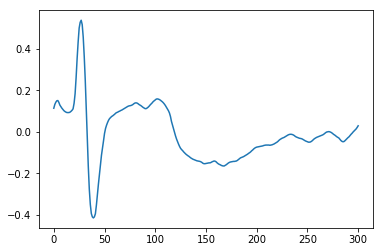

A00688
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


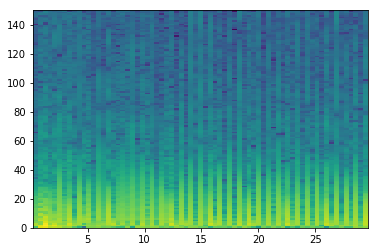

good List
[12, 21, 25, 29, 31, 35, 39, 41, 43, 47, 55, 59, 63, 67]
[9, 4, 4, 2, 4, 4, 2, 2, 4, 8, 4, 4, 4]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


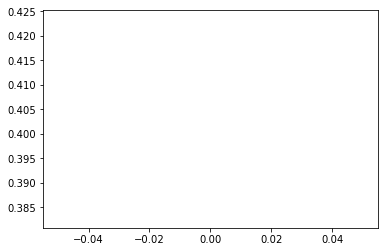

A00693
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


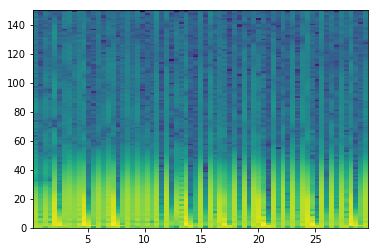

good List
[1, 2, 3, 5, 11, 12, 14, 17, 18, 20, 22, 24, 26, 28, 32, 33, 35, 37, 38, 39, 40, 42, 44, 47, 48, 50, 52, 54, 57, 58, 60, 62, 64, 66, 67]
[1, 1, 2, 6, 1, 2, 3, 1, 2, 2, 2, 2, 2, 4, 1, 2, 2, 1, 1, 1, 2, 2, 3, 1, 2, 2, 2, 3, 1, 2, 2, 2, 2, 1]
the temp 3
[[1, 2], [], [5], [], [8], [], [], [], [], [], [15], [], [18, 19, 20], [], [], [24], [], [], [], [29], [], [], []]
[37, 38, 39, 40]
longest
[37, 38, 39, 40]
indexList
[37, 38, 39, 40]
theMin
4800
theMax
5100


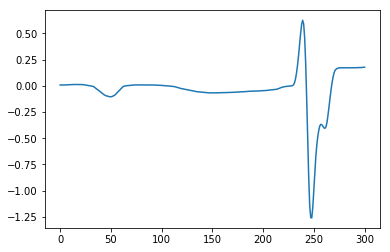

A00696
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


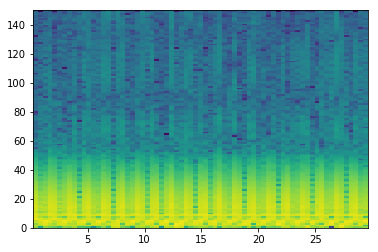

good List
[7, 12, 19, 25, 26, 30, 35, 36, 39, 42, 52, 54, 57, 64, 65, 67]
[5, 7, 6, 1, 4, 5, 1, 3, 3, 10, 2, 3, 7, 1, 2]
the temp 3
[[], [], [], [4], [], [7], [], [], [], [], [], [14]]
[25, 26]
longest
[25, 26]
indexList
[25, 26]
theMin
3300
theMax
3600


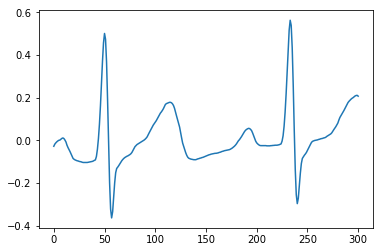

A00697
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


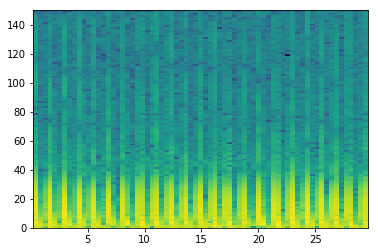

good List
[1, 2, 4, 5, 7, 8, 10, 11, 13, 14, 16, 17, 19, 20, 21, 22, 23, 24, 26, 27, 29, 30, 32, 33, 35, 36, 37, 38, 41, 42, 43, 44, 45, 47, 48, 49, 51, 52, 54, 55, 57, 58, 60, 61, 63, 64, 65, 66, 67]
[1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 3, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1]
the temp 3
[[1], [3], [5], [7], [9], [11], [13, 14, 15, 16, 17], [19], [21], [23], [25, 26, 27], [29, 30, 31, 32], [34, 35], [37], [39], [41], [43]]
[19, 20, 21, 22, 23, 24]
longest
[19, 20, 21, 22, 23, 24]
indexList
[19, 20, 21, 22, 23, 24]
theMin
2400
theMax
3000


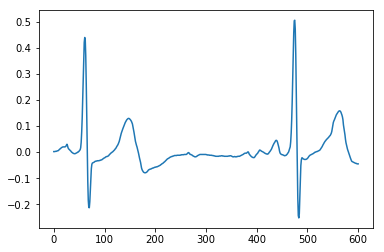

A00698
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333]


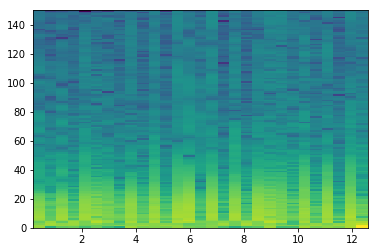

good List
[26]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


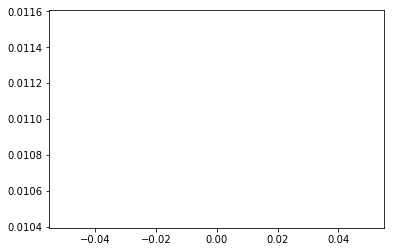

A00699
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


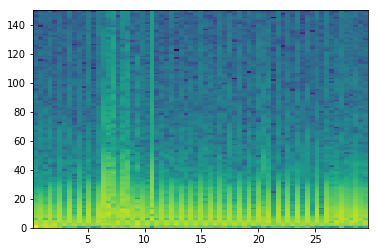

good List
[1, 2, 4, 6, 8, 10, 12, 23, 25, 29, 33, 37, 39, 41, 43, 45, 49, 51, 53, 57, 59, 67, 68]
[1, 2, 2, 2, 2, 2, 11, 2, 4, 4, 4, 2, 2, 2, 2, 4, 2, 2, 4, 2, 8, 1]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


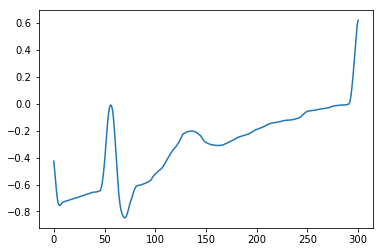

A00702
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


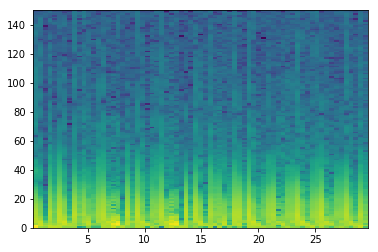

good List
[1, 2, 4, 7, 9, 11, 12, 15, 18, 20, 23, 27, 28, 30, 31, 32, 35, 37, 40, 43, 46, 47, 52, 53, 56, 57, 61, 62, 63, 65, 66, 68]
[1, 2, 3, 2, 2, 1, 3, 3, 2, 3, 4, 1, 2, 1, 1, 3, 2, 3, 3, 3, 1, 5, 1, 3, 1, 4, 1, 1, 2, 1, 2]
the temp 3
[[1], [], [], [], [6], [], [], [], [], [12], [14, 15], [], [], [], [], [21], [23], [25], [27, 28], [30]]
[30, 31, 32]
longest
[30, 31, 32]
indexList
[30, 31, 32]
theMin
3900
theMax
4200


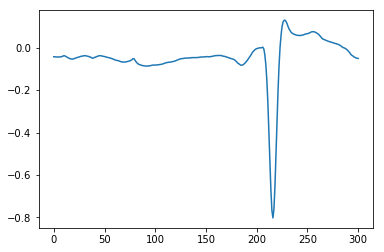

A00709
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


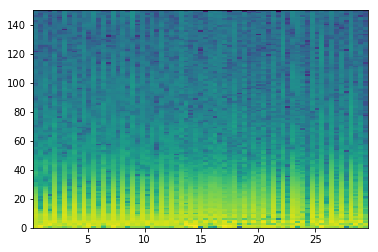

good List
[25, 32, 40, 44, 48, 52, 56, 60, 62]
[7, 8, 4, 4, 4, 4, 4, 2]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


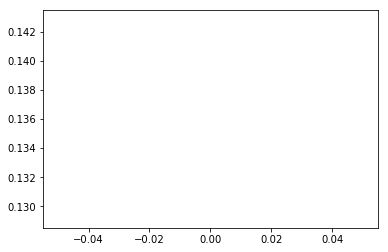

A00712
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

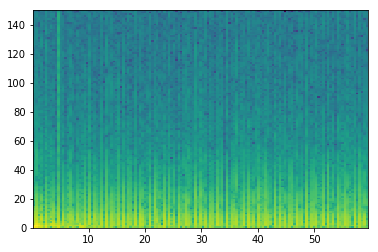

good List
[4, 9, 11, 13, 17, 19, 20, 22, 24, 25, 26, 27, 29, 31, 33, 34, 36, 38, 40, 41, 43, 44, 45, 46, 49, 52, 53, 55, 57, 59, 61, 66, 68, 70, 72, 74, 75, 79, 81, 90, 94, 95, 97, 98, 99, 101, 105, 107, 108, 110, 111, 112, 114, 116, 118, 119, 121, 123, 125, 132, 134, 136, 138]
[5, 2, 2, 4, 2, 1, 2, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 1, 1, 1, 3, 3, 1, 2, 2, 2, 2, 5, 2, 2, 2, 2, 1, 4, 2, 9, 4, 1, 2, 1, 1, 2, 4, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 7, 2, 2, 2]
the temp 3
[[], [], [], [], [], [6], [], [9, 10, 11], [], [], [15], [], [], [19], [21, 22, 23], [], [26], [], [], [], [], [], [], [], [], [36], [], [], [], [41], [43, 44], [], [], [48], [50, 51], [], [], [55], [], [], [], [], [], []]
[24, 25, 26, 27]
longest
[24, 25, 26, 27]
indexList
[24, 25, 26, 27]
theMin
3000
theMax
3300


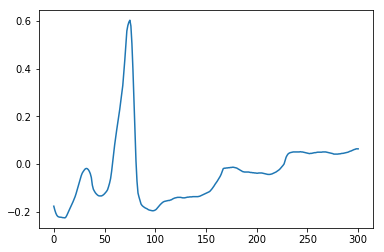

A00716
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

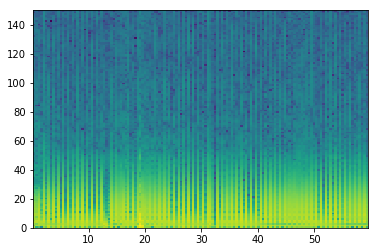

good List
[7, 9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 30, 31, 33, 35, 40, 42, 55, 57, 59, 61, 63, 65, 67, 69, 71, 75, 77, 79, 89, 91, 93, 95, 97, 99, 101, 103, 105, 106, 107, 108, 114, 118, 119, 120, 124, 126, 128, 130, 132, 136, 138]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 5, 2, 13, 2, 2, 2, 2, 2, 2, 2, 2, 4, 2, 2, 10, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 6, 4, 1, 1, 4, 2, 2, 2, 2, 4, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [12, 13], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [39, 40, 41], [], [44, 45], [], [], [], [], [], []]
[105, 106, 107, 108]
longest
[105, 106, 107, 108]
indexList
[105, 106, 107, 108]
theMin
13500
theMax
13800


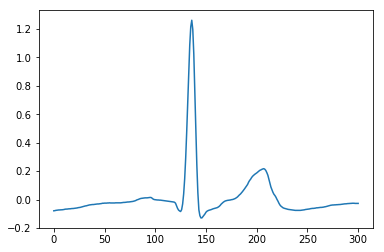

A00718
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


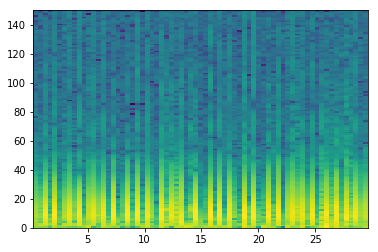

good List
[0, 1, 2, 3, 5, 6, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 31, 33, 34, 35, 36, 37, 39, 40, 41, 42, 44, 46, 47, 48, 49, 51, 52, 56, 57, 58, 61, 63, 66, 67, 68]
[1, 1, 1, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 4, 1, 1, 3, 2, 3, 1, 1]
the temp 3
[[1, 2, 3], [5], [], [8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22], [24, 25], [], [28, 29, 30, 31], [33, 34, 35], [], [38, 39, 40], [42], [44, 45], [], []]
[10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
longest
[10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
indexList
[10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
theMin
1200
theMax
3300


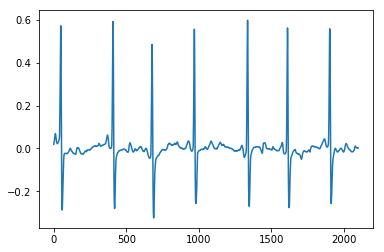

A00719
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

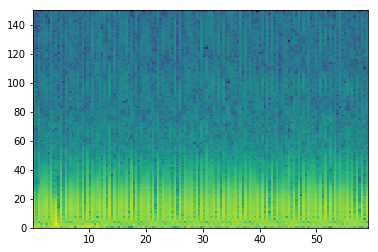

good List
[1, 3, 4, 10, 12, 23, 32, 34, 41, 43, 46, 59, 63, 68, 77, 81, 95, 97, 103, 123, 132, 134, 136]
[2, 1, 6, 2, 11, 9, 2, 7, 2, 3, 13, 4, 5, 9, 4, 14, 2, 6, 20, 9, 2, 2]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[3, 4]
longest
[3, 4]
indexList
[3, 4]
theMin
300
theMax
600


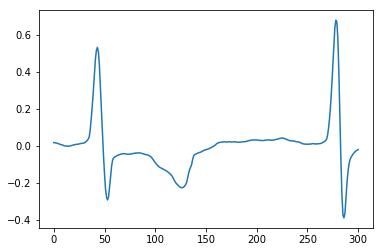

A00723
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


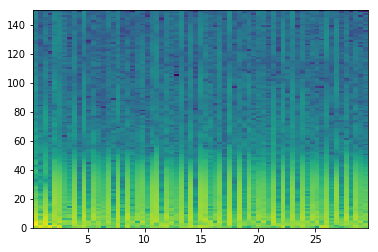

good List
[3, 6, 7, 9, 11, 14, 16, 18, 21, 23, 26, 28, 29, 31, 33, 37, 39, 41, 43, 45, 46, 50, 54, 56, 57, 59, 61, 63, 65, 67, 68]
[3, 1, 2, 2, 3, 2, 2, 3, 2, 3, 2, 1, 2, 2, 4, 2, 2, 2, 2, 1, 4, 4, 2, 1, 2, 2, 2, 2, 2, 1]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [12], [], [], [], [], [], [], [20], [], [], [24], [], [], [], []]
[6, 7]
longest
[6, 7]
indexList
[6, 7]
theMin
600
theMax
900


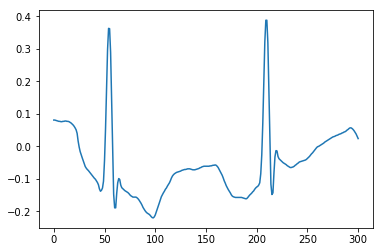

A00724
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

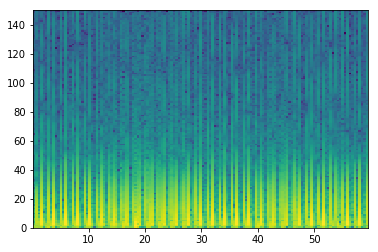

good List
[0, 2, 5, 7, 9, 10, 12, 14, 15, 17, 19, 20, 22, 24, 25, 27, 29, 30, 35, 40, 50, 55, 65, 66, 68, 70, 71, 73, 75, 78, 80, 81, 85, 86, 90, 91, 93, 96, 101, 106, 107, 109, 111, 112, 114, 117, 119, 121, 122, 124, 125, 126, 127, 129, 131, 132, 133, 134, 136]
[2, 3, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 5, 5, 10, 5, 10, 1, 2, 2, 1, 2, 2, 3, 2, 1, 4, 1, 4, 1, 2, 3, 5, 5, 1, 2, 2, 1, 2, 3, 2, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2]
the temp 3
[[], [], [], [], [5], [], [8], [], [11], [], [14], [], [17], [], [], [], [], [23], [], [26], [], [], [], [31], [33], [35], [], [], [], [40], [], [43], [], [], [], [48], [50, 51, 52], [], [55, 56, 57]]
[124, 125, 126, 127]
longest
[124, 125, 126, 127]
indexList
[124, 125, 126, 127]
theMin
15900
theMax
16200


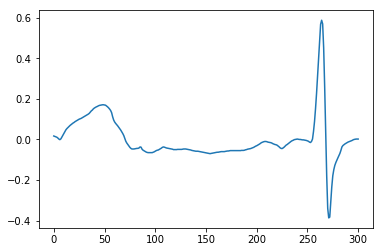

A00732
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


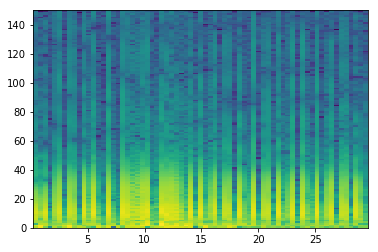

good List
[3, 6, 9, 11, 13, 14, 16, 17, 24, 33, 35, 38, 41, 43, 44, 46, 49, 51, 52, 54, 57, 59, 62, 65, 68]
[3, 3, 2, 2, 1, 2, 1, 7, 9, 2, 3, 3, 2, 1, 2, 3, 2, 1, 2, 3, 2, 3, 3, 3]
the temp 3
[[], [], [], [], [5], [7], [], [], [], [], [], [14], [], [], [18], [], [], [], [], []]
[13, 14]
longest
[13, 14]
indexList
[13, 14]
theMin
1500
theMax
1800


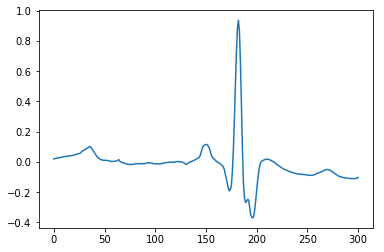

A00734
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


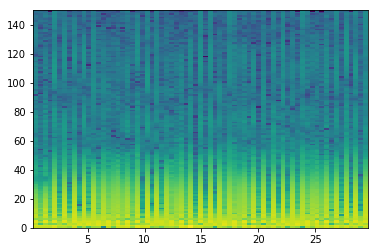

good List
[1, 3, 5, 7, 9, 12, 13, 18, 20, 22, 24, 26, 27, 28, 31, 33, 35, 37, 46, 48, 52, 54, 59, 61, 63, 65, 67]
[2, 2, 2, 2, 3, 1, 5, 2, 2, 2, 2, 1, 1, 3, 2, 2, 2, 9, 2, 4, 2, 5, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [6], [], [], [], [], [12, 13], [], [], [], [], [], [], [], [], [], [], [], []]
[26, 27, 28]
longest
[26, 27, 28]
indexList
[26, 27, 28]
theMin
3300
theMax
3600


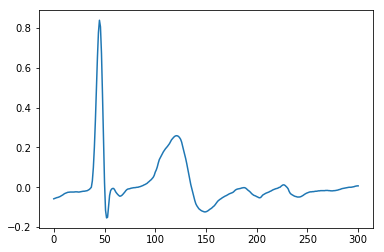

A00737
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


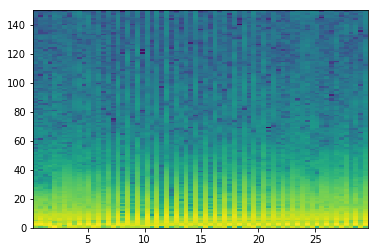

good List
[16, 20, 32]
[4, 12]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


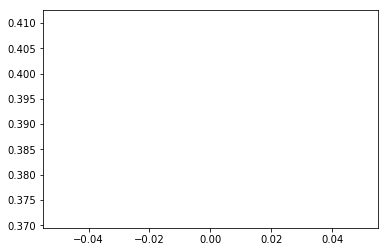

A00740
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


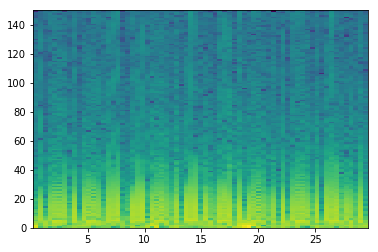

good List
[0, 2, 6, 7, 9, 13, 14, 18, 19, 22, 28, 30, 33, 34, 36, 37, 43, 48, 50, 52, 53, 57, 59, 66, 68]
[2, 4, 1, 2, 4, 1, 4, 1, 3, 6, 2, 3, 1, 2, 1, 6, 5, 2, 2, 1, 4, 2, 7, 2]
the temp 3
[[], [], [3], [], [6], [8], [], [], [], [13], [15], [], [], [], [20], [], [], []]
[6, 7]
longest
[6, 7]
indexList
[6, 7]
theMin
600
theMax
900


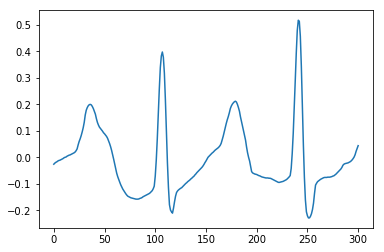

A00741
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


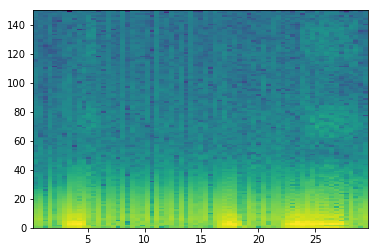

good List
[2, 4, 5, 6, 8, 14, 17, 19, 22, 24, 26, 29, 31, 32, 36, 37, 40, 41, 42, 43, 44, 53, 54]
[2, 1, 1, 2, 6, 3, 2, 3, 2, 2, 3, 2, 1, 4, 1, 3, 1, 1, 1, 1, 9, 1]
the temp 3
[[], [2, 3], [], [], [], [], [], [], [], [], [13], [15], [17, 18, 19, 20]]
[40, 41, 42, 43, 44]
longest
[40, 41, 42, 43, 44]
indexList
[40, 41, 42, 43, 44]
theMin
5100
theMax
5700


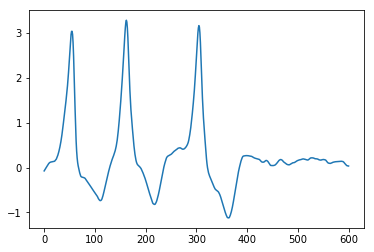

A00742
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


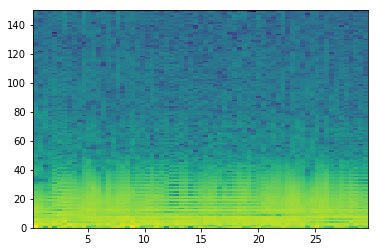

good List
[15, 33]
[18]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


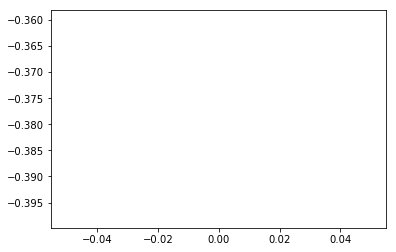

A00744
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


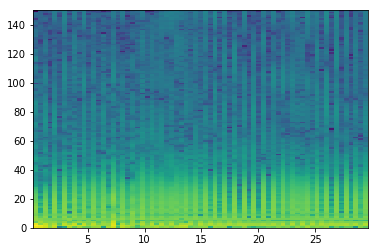

good List
[1, 3, 5, 11, 13, 36, 40, 44, 46, 61, 63, 65]
[2, 2, 6, 2, 23, 4, 4, 2, 15, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


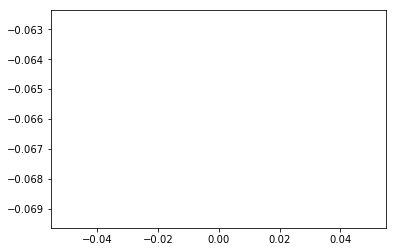

A00745
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


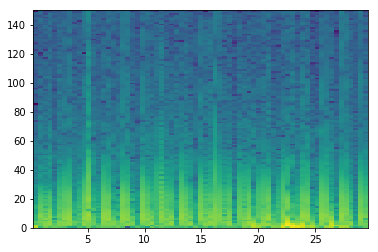

good List
[0, 4, 8, 13, 21, 33, 41, 62, 65, 66]
[4, 4, 5, 8, 12, 8, 21, 3, 1]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


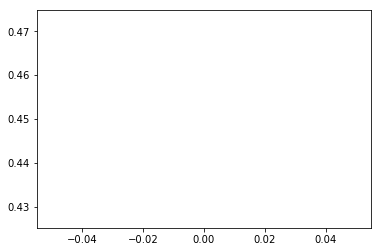

A00746
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


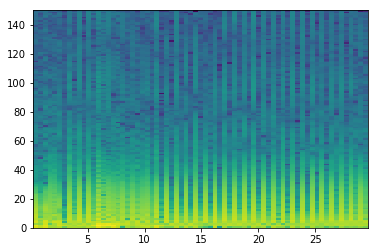

good List
[6, 10, 24, 26, 28, 30, 32, 36, 38, 40, 42, 44, 46, 48, 50, 52, 54, 56, 58, 60]
[4, 14, 2, 2, 2, 2, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


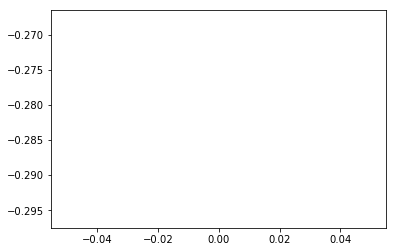

A00754
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


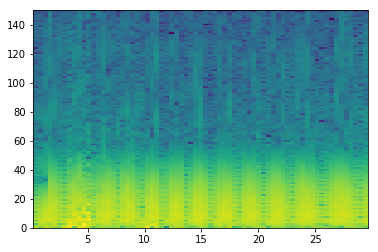

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


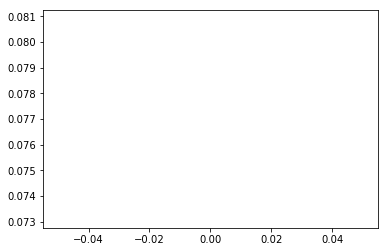

A00759
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88      ]


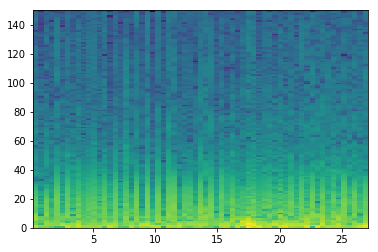

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


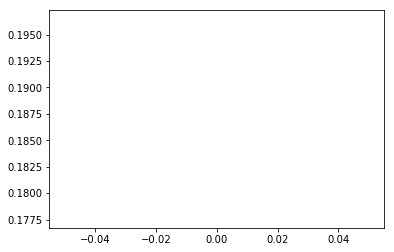

A00766
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


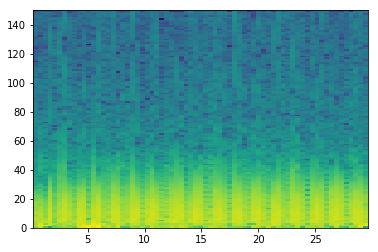

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


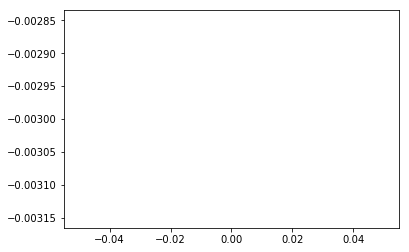

A00767
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

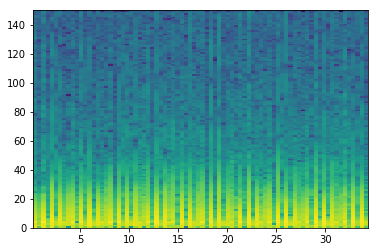

good List
[1, 3, 6, 7, 8, 10, 12, 14, 15, 16, 17, 18, 19, 23, 28, 30, 31, 34, 36, 41, 43, 45, 46, 50, 52, 53, 55, 57, 60, 61, 63, 64, 66, 68, 70, 71, 72, 75, 77, 79]
[2, 3, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 4, 5, 2, 1, 3, 2, 5, 2, 2, 1, 4, 2, 1, 2, 2, 3, 1, 2, 1, 2, 2, 2, 1, 1, 3, 2, 2]
the temp 3
[[], [], [3, 4], [], [], [8, 9, 10, 11, 12], [], [], [16], [], [], [], [], [22], [], [25], [], [], [29], [31], [], [], [35, 36], [], []]
[14, 15, 16, 17, 18, 19]
longest
[14, 15, 16, 17, 18, 19]
indexList
[14, 15, 16, 17, 18, 19]
theMin
1800
theMax
2400


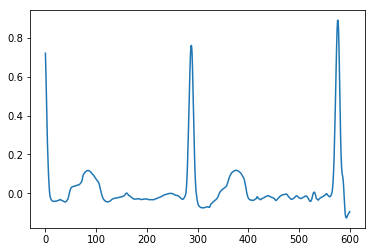

A00768
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


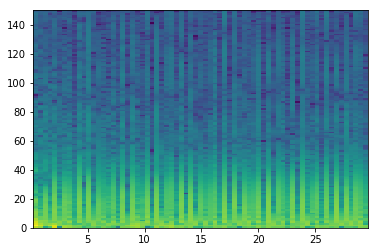

good List
[19, 24, 29, 38, 40, 47, 49, 52, 54, 59]
[5, 5, 9, 2, 7, 2, 3, 2, 5]
the temp 3
[[], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


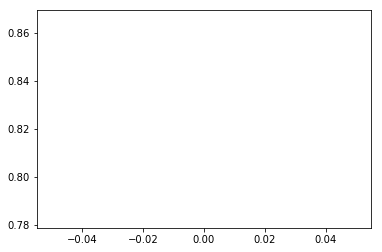

A00769
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


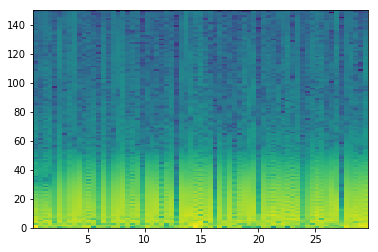

good List
[1, 4, 13, 15, 22, 29, 37, 46]
[3, 9, 2, 7, 7, 8, 9]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


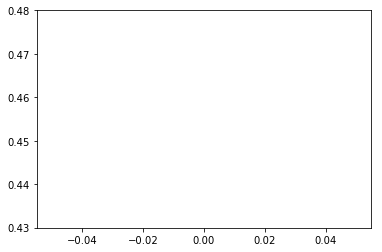

A00770
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


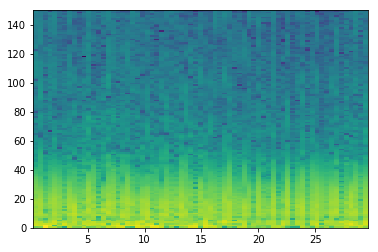

good List
[50]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


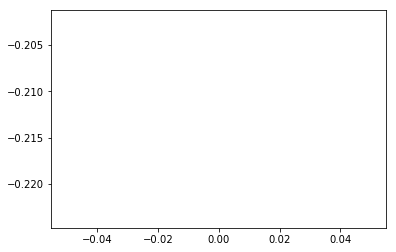

A00773
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


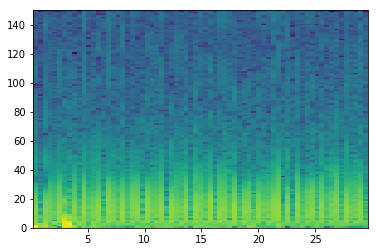

good List
[1, 4, 19, 37, 38, 42, 44, 45, 47, 48, 55, 63, 68]
[3, 15, 18, 1, 4, 2, 1, 2, 1, 7, 8, 5]
the temp 3
[[], [], [], [4], [], [7], [9], [], []]
[37, 38]
longest
[37, 38]
indexList
[37, 38]
theMin
4800
theMax
5100


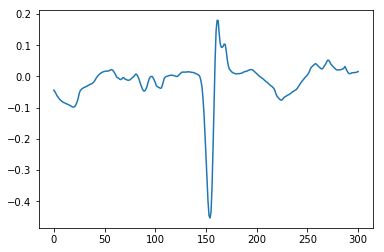

A00782
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


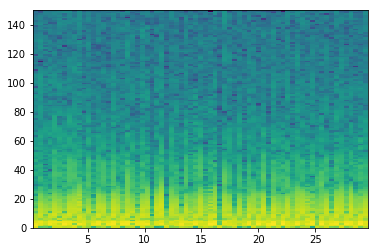

good List
[1, 2, 3, 8, 10, 12, 13, 15, 17, 21, 23, 24, 25, 27, 29, 30, 32, 35, 38, 39, 40, 41, 43, 44, 45, 46, 48, 50, 53, 55, 56, 57, 58, 59, 60, 61, 64, 66, 68]
[1, 1, 5, 2, 2, 1, 2, 2, 4, 2, 1, 1, 2, 2, 1, 2, 3, 3, 1, 1, 1, 2, 1, 1, 1, 2, 2, 3, 2, 1, 1, 1, 1, 1, 1, 3, 2, 2]
the temp 3
[[1, 2], [], [], [6], [], [], [], [11, 12], [], [15], [], [], [19, 20, 21], [23, 24, 25], [], [], [], [30, 31, 32, 33, 34, 35], [], []]
[55, 56, 57, 58, 59, 60, 61]
longest
[55, 56, 57, 58, 59, 60, 61]
indexList
[55, 56, 57, 58, 59, 60, 61]
theMin
6900
theMax
7800


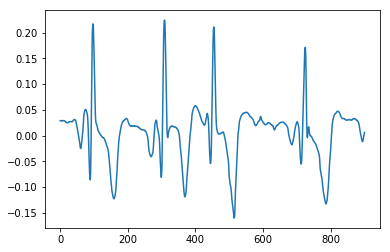

A00785
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


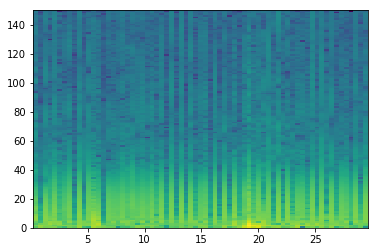

good List
[1, 8, 14, 15, 23, 27, 29, 31, 33, 34, 36, 38, 40, 42, 56, 62, 63, 65]
[7, 6, 1, 8, 4, 2, 2, 2, 1, 2, 2, 2, 2, 14, 6, 1, 2]
the temp 3
[[], [], [3], [], [], [], [], [9], [], [], [], [], [], [16]]
[14, 15]
longest
[14, 15]
indexList
[14, 15]
theMin
1800
theMax
2100


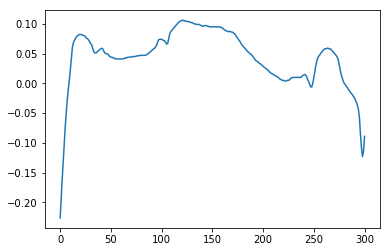

A00786
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


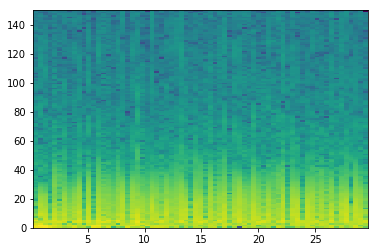

good List
[7, 19, 55]
[12, 36]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


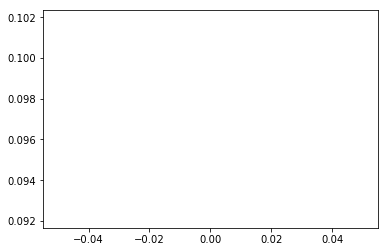

A00787
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


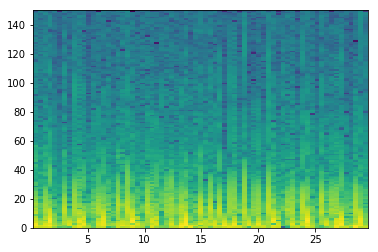

good List
[4, 5, 7, 12, 16, 21, 29, 32, 39, 42, 44, 47, 54, 58, 64, 65]
[1, 2, 5, 4, 5, 8, 3, 7, 3, 2, 3, 7, 4, 6, 1]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], []]
[4, 5]
longest
[4, 5]
indexList
[4, 5]
theMin
600
theMax
900


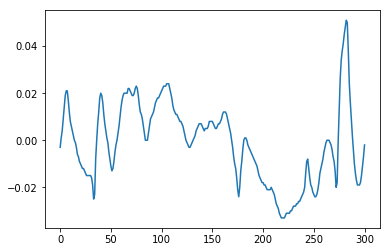

A00788
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

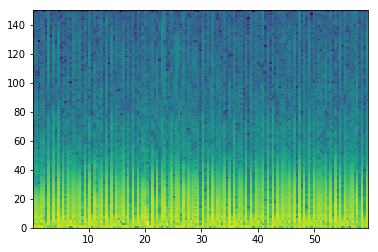

good List
[2, 5, 7, 11, 22, 24, 29, 31, 38, 40, 42, 48, 52, 55, 69, 80, 82, 87, 89, 91, 96, 100, 102, 107, 109, 111, 120, 126, 128, 135, 137]
[3, 2, 4, 11, 2, 5, 2, 7, 2, 2, 6, 4, 3, 14, 11, 2, 5, 2, 2, 5, 4, 2, 5, 2, 2, 9, 6, 2, 7, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


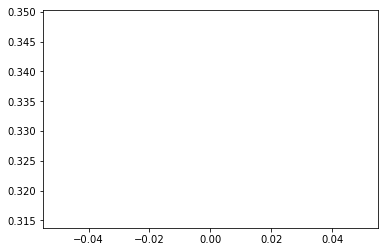

A00789
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

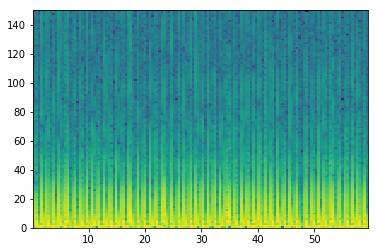

good List
[2, 4, 7, 9, 11, 12, 15, 18, 21, 26, 28, 31, 33, 36, 37, 38, 41, 42, 44, 47, 49, 52, 55, 56, 58, 59, 61, 64, 66, 69, 71, 73, 76, 78, 84, 85, 90, 92, 95, 97, 100, 102, 105, 107, 108, 110, 111, 114, 117, 119, 122, 125, 126, 128, 131, 133, 136, 138]
[2, 3, 2, 2, 1, 3, 3, 3, 5, 2, 3, 2, 3, 1, 1, 3, 1, 2, 3, 2, 3, 3, 1, 2, 1, 2, 3, 2, 3, 2, 2, 3, 2, 6, 1, 5, 2, 3, 2, 3, 2, 3, 2, 1, 2, 1, 3, 3, 2, 3, 3, 1, 2, 3, 2, 3, 2]
the temp 3
[[], [], [], [], [5], [], [], [], [], [], [], [], [14, 15], [17], [], [], [], [], [23], [25], [], [], [], [], [], [], [], [], [35], [], [], [], [], [], [], [], [44], [46], [], [], [], [], [52], [], [], [], []]
[36, 37, 38]
longest
[36, 37, 38]
indexList
[36, 37, 38]
theMin
4500
theMax
4800


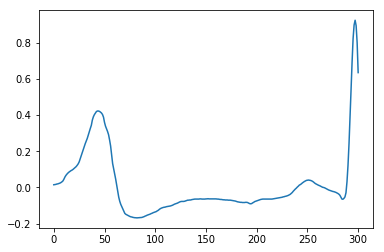

A00793
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


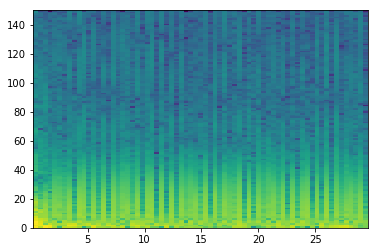

good List
[13, 15, 22, 25, 29, 38, 43, 45, 59, 61, 65, 68]
[2, 7, 3, 4, 9, 5, 2, 14, 2, 4, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


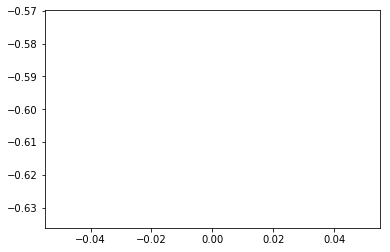

A00807
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


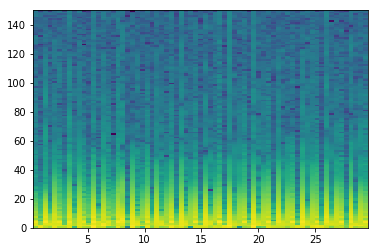

good List
[0, 1, 3, 4, 5, 6, 8, 9, 10, 11, 13, 14, 16, 19, 22, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 51, 52, 54, 56, 57, 59, 60, 61, 62, 63, 64, 66, 67, 68]
[1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 2, 3, 3, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1]
the temp 3
[[1], [3, 4, 5], [7, 8, 9], [11], [], [], [], [16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], [30, 31, 32], [], [35, 36, 37, 38, 39, 40], [], [43], [45, 46, 47, 48, 49]]
[24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37]
longest
[24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37]
indexList
[24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37]
theMin
3000
theMax
4800


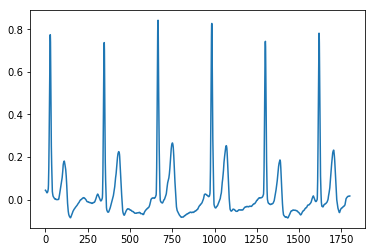

A00811
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


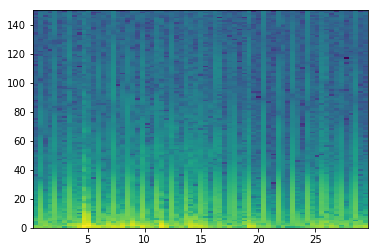

good List
[0, 2, 5, 12, 15, 21, 39, 42, 43, 45, 46, 48, 49, 51, 52, 54, 55, 57, 58, 61, 62, 64, 65, 67, 68]
[2, 3, 7, 3, 6, 18, 3, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 3, 1, 2, 1, 2, 1]
the temp 3
[[], [], [], [], [], [], [], [8], [10], [12], [14], [16], [18], [20], [22]]
[42, 43]
longest
[42, 43]
indexList
[42, 43]
theMin
5400
theMax
5700


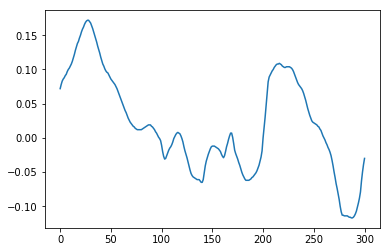

A00817
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

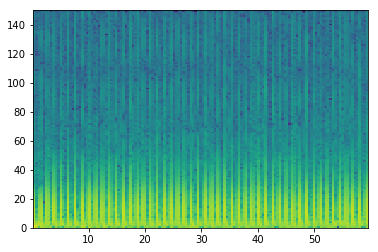

good List
[1, 4, 7, 9, 10, 13, 15, 16, 18, 19, 21, 22, 24, 25, 27, 30, 33, 36, 38, 39, 42, 47, 53, 55, 56, 58, 59, 61, 64, 67, 69, 70, 73, 75, 77, 78, 83, 84, 86, 87, 89, 94, 97, 98, 101, 103, 106, 109, 111, 112, 114, 115, 117, 118, 120, 123, 126, 133, 134, 136, 137]
[3, 3, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 3, 3, 2, 1, 3, 5, 6, 2, 1, 2, 1, 2, 3, 3, 2, 1, 3, 2, 2, 1, 5, 1, 2, 1, 2, 5, 3, 1, 3, 2, 3, 3, 2, 1, 2, 1, 2, 1, 2, 3, 3, 7, 1, 2, 1]
the temp 3
[[], [], [], [4], [], [7], [9], [11], [13], [], [], [], [], [19], [], [], [], [24], [26], [], [], [], [31], [], [], [35], [37], [39], [], [], [43], [], [], [], [], [49], [51], [53], [], [], [], [58]]
[9, 10]
longest
[9, 10]
indexList
[9, 10]
theMin
1200
theMax
1500


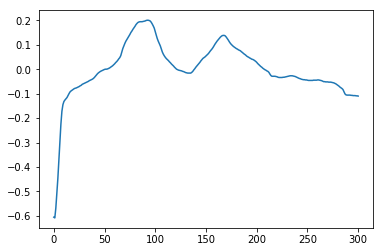

A00819
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333]


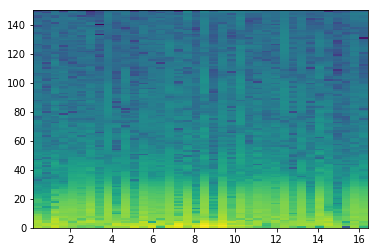

good List
[20, 29, 34, 35]
[9, 5, 1]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


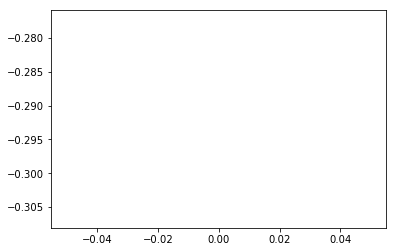

A00820
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667]


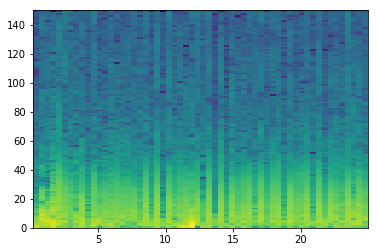

good List
[0, 9, 22, 33]
[9, 13, 11]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


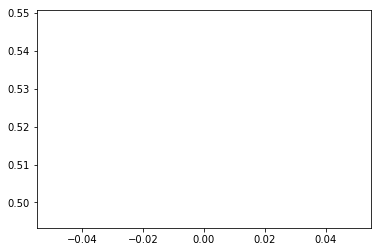

A00826
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


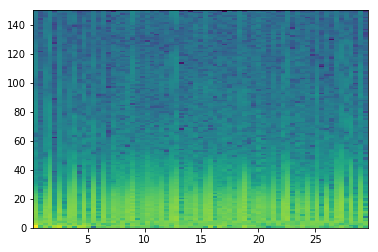

good List
[1, 4, 6, 9, 13, 14, 15, 22, 30, 31, 35, 36, 38, 44, 45, 47, 48, 50, 53, 56, 57, 59, 66, 68]
[3, 2, 3, 4, 1, 1, 7, 8, 1, 4, 1, 2, 6, 1, 2, 1, 2, 3, 3, 1, 2, 7, 2]
the temp 3
[[], [], [], [], [5, 6], [], [9], [11], [], [14], [16], [], [], [20], [], []]
[13, 14, 15]
longest
[13, 14, 15]
indexList
[13, 14, 15]
theMin
1500
theMax
1800


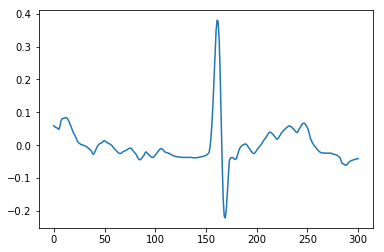

A00835
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


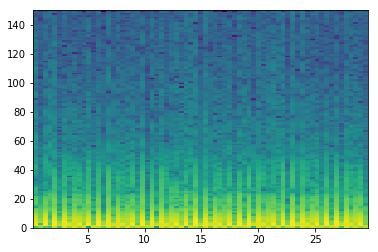

good List
[1, 5, 9, 10, 12, 23, 34, 38, 41, 47, 52, 59, 61, 63, 68]
[4, 4, 1, 2, 11, 11, 4, 3, 6, 5, 7, 2, 2, 5]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], [], [], []]
[9, 10]
longest
[9, 10]
indexList
[9, 10]
theMin
1200
theMax
1500


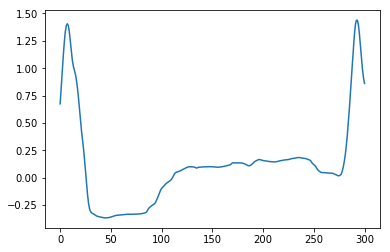

A00840
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


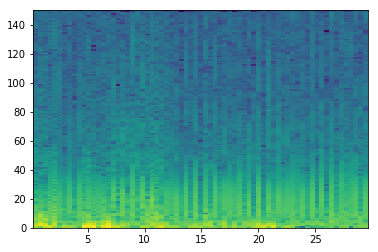

good List
[5, 6, 7, 8, 9, 12, 28, 30, 31, 32, 33, 34, 36, 37, 38, 40, 41, 42, 43, 45, 47, 49, 53, 54, 55, 56, 58, 60, 62, 65, 67, 68]
[1, 1, 1, 1, 3, 16, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 2, 2, 2, 4, 1, 1, 1, 2, 2, 2, 3, 2, 1]
the temp 3
[[1, 2, 3, 4], [], [], [8, 9, 10, 11], [13, 14], [16, 17, 18], [], [], [], [23, 24, 25], [], [], [], []]
[5, 6, 7, 8, 9]
longest
[5, 6, 7, 8, 9]
indexList
[5, 6, 7, 8, 9]
theMin
600
theMax
1200


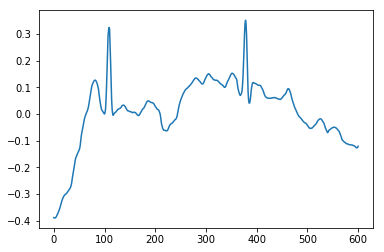

A00844
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333]


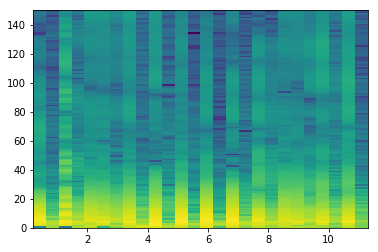

good List
[1, 8, 10, 12, 14, 16, 25]
[7, 2, 2, 2, 2, 9]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


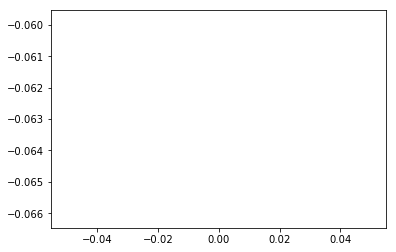

A00848
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


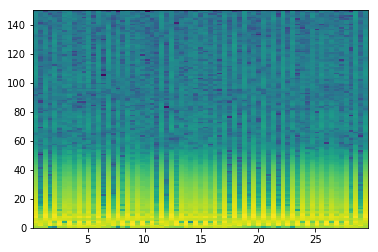

good List
[1, 3, 5, 6, 8, 10, 12, 14, 16, 18, 20, 21, 22, 23, 25, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 40, 42, 44, 46, 48, 50, 52, 54, 56, 58, 60, 61, 62, 63, 64, 65, 67]
[2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2]
the temp 3
[[], [], [3], [], [], [], [], [], [], [11, 12, 13], [], [], [17, 18, 19, 20, 21], [23, 24], [], [], [], [], [], [], [], [], [], [], [36, 37, 38, 39, 40]]
[29, 30, 31, 32, 33, 34]
longest
[29, 30, 31, 32, 33, 34]
indexList
[29, 30, 31, 32, 33, 34]
theMin
3600
theMax
4200


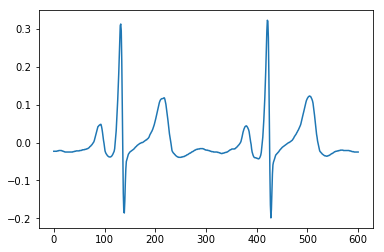

A00849
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

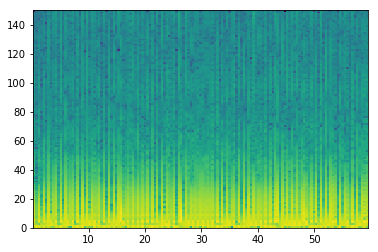

good List
[1, 3, 5, 7, 8, 10, 12, 14, 15, 17, 19, 21, 23, 26, 28, 30, 32, 34, 37, 40, 42, 44, 46, 48, 50, 52, 54, 57, 59, 62, 69, 70, 75, 77, 84, 86, 88, 90, 95, 97, 99, 102, 106, 110, 114, 116, 118, 120, 122, 126, 129, 131, 133]
[2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 7, 1, 5, 2, 7, 2, 2, 2, 5, 2, 2, 3, 4, 4, 4, 2, 2, 2, 2, 4, 3, 2, 2]
the temp 3
[[], [], [], [4], [], [], [8], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [31], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[7, 8]
longest
[7, 8]
indexList
[7, 8]
theMin
900
theMax
1200


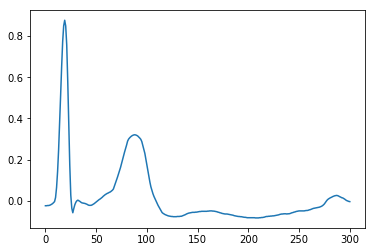

A00850
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


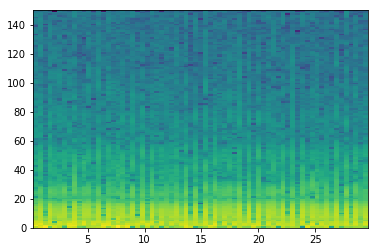

good List
[23, 32, 34, 36, 43, 45, 47, 54, 56, 61]
[9, 2, 2, 7, 2, 2, 7, 2, 5]
the temp 3
[[], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


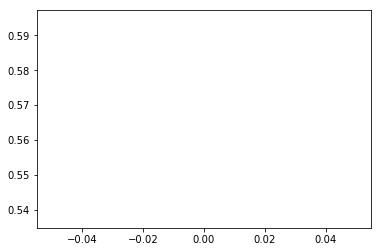

A00851
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

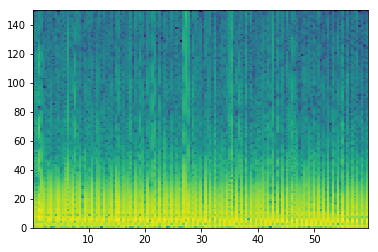

good List
[8, 41, 87, 89, 102, 104, 110, 121, 123, 129, 135, 137]
[33, 46, 2, 13, 2, 6, 11, 2, 6, 6, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


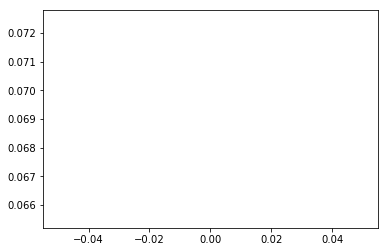

A00855
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


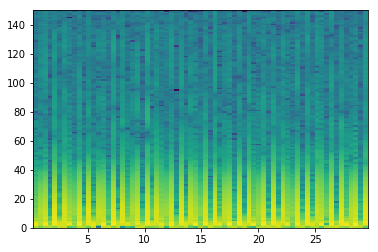

good List
[0, 1, 3, 5, 7, 8, 9, 10, 12, 13, 14, 15, 17, 19, 20, 22, 24, 27, 29, 31, 32, 33, 34, 36, 38, 39, 41, 43, 45, 46, 47, 48, 50, 52, 53, 55, 57, 60, 62, 64, 65, 67]
[1, 2, 2, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 2, 2, 3, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 3, 2, 2, 1, 2]
the temp 3
[[1], [], [], [5, 6, 7], [9, 10, 11], [], [14], [], [], [], [], [20, 21, 22], [], [25], [], [], [29, 30, 31], [], [34], [], [], [], [], [40]]
[7, 8, 9, 10]
longest
[7, 8, 9, 10]
indexList
[7, 8, 9, 10]
theMin
900
theMax
1200


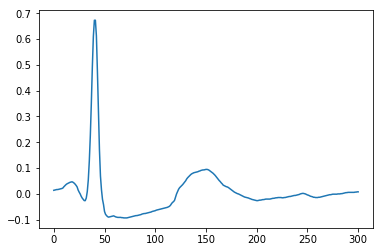

A00868
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


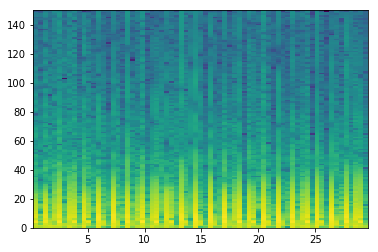

good List
[15, 18, 23, 35, 37, 43, 49, 51, 52, 57, 60, 68]
[3, 5, 12, 2, 6, 6, 2, 1, 5, 3, 8]
the temp 3
[[], [], [], [], [], [], [], [8], [], []]
[51, 52]
longest
[51, 52]
indexList
[51, 52]
theMin
6600
theMax
6900


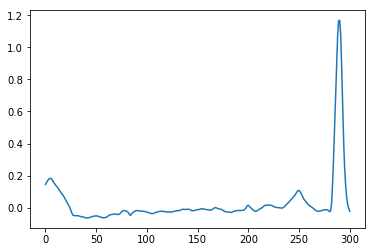

A00872
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


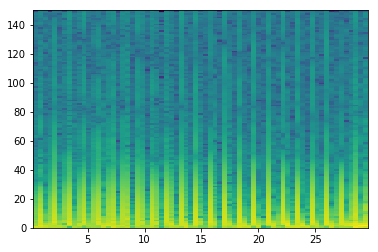

good List
[0, 2, 3, 5, 6, 8, 9, 11, 14, 17, 20, 23, 25, 26, 28, 29, 31, 32, 34, 35, 38, 40, 41, 43, 44, 46, 47, 49, 50, 52, 53, 55, 56, 58, 59, 61, 62, 63, 64, 65, 67]
[2, 1, 2, 1, 2, 1, 2, 3, 3, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2]
the temp 3
[[], [2], [4], [6], [], [], [], [], [], [13], [15], [17], [19], [], [22], [24], [26], [28], [30], [32], [34], [36, 37, 38, 39]]
[61, 62, 63, 64, 65]
longest
[61, 62, 63, 64, 65]
indexList
[61, 62, 63, 64, 65]
theMin
7800
theMax
8400


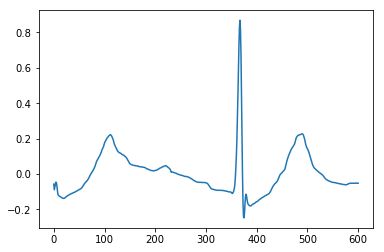

A00875
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


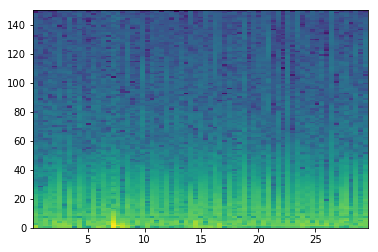

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


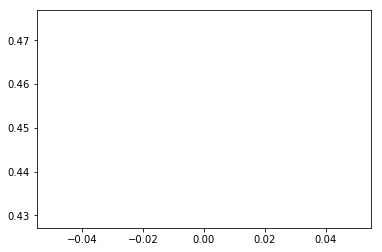

A00878
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


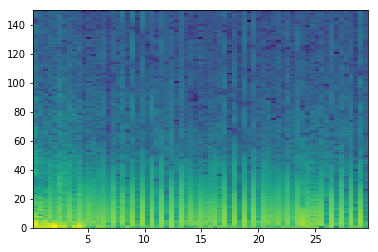

good List
[15, 21, 23, 29, 31, 32, 33, 34, 35, 40, 42, 44, 49, 51, 66, 68]
[6, 2, 6, 2, 1, 1, 1, 1, 5, 2, 2, 5, 2, 15, 2]
the temp 3
[[], [], [], [], [5, 6, 7, 8], [], [], [], [], [], []]
[31, 32, 33, 34, 35]
longest
[31, 32, 33, 34, 35]
indexList
[31, 32, 33, 34, 35]
theMin
3900
theMax
4500


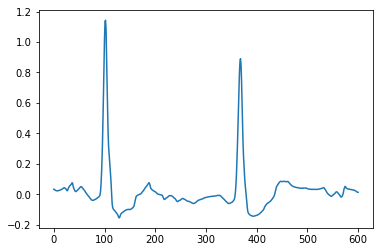

A00882
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

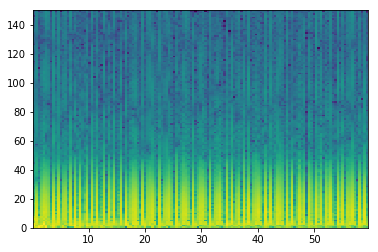

good List
[2, 6, 7, 9, 11, 12, 14, 16, 18, 20, 21, 23, 25, 27, 28, 30, 32, 34, 35, 37, 39, 43, 44, 45, 46, 47, 48, 51, 53, 57, 58, 60, 65, 67, 68, 71, 72, 74, 78, 79, 81, 83, 84, 86, 88, 90, 94, 95, 97, 99, 104, 106, 108, 109, 113, 116, 120, 122, 124, 125, 129, 134, 135, 136, 138]
[4, 1, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 2, 4, 1, 1, 1, 1, 1, 3, 2, 4, 1, 2, 5, 2, 1, 3, 1, 2, 4, 1, 2, 2, 1, 2, 2, 2, 4, 1, 2, 2, 5, 2, 2, 1, 4, 3, 4, 2, 2, 1, 4, 5, 1, 1, 2]
the temp 3
[[], [2], [], [5], [], [], [], [10], [], [], [14], [], [], [18], [], [], [22, 23, 24, 25, 26], [], [], [30], [], [], [34], [36], [], [39], [], [42], [], [], [], [47], [], [], [], [], [53], [], [], [], [], [59], [], [62, 63]]
[43, 44, 45, 46, 47, 48]
longest
[43, 44, 45, 46, 47, 48]
indexList
[43, 44, 45, 46, 47, 48]
theMin
5400
theMax
6000


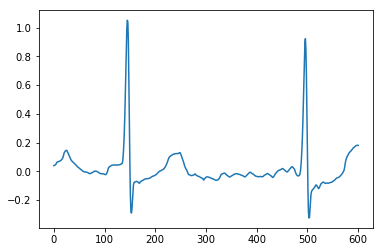

A00886
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


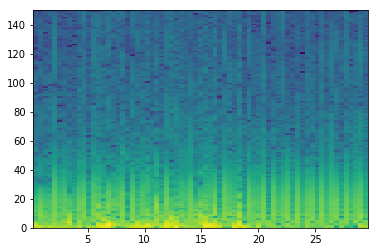

good List
[55]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


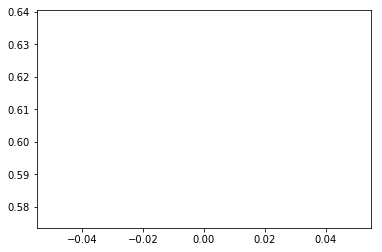

A00887
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

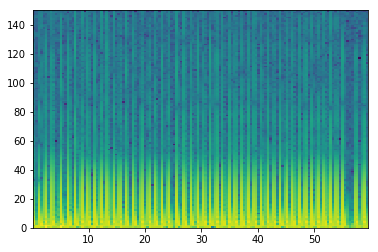

good List
[1, 3, 4, 6, 9, 10, 12, 13, 16, 18, 21, 24, 26, 27, 29, 32, 34, 35, 37, 39, 40, 42, 43, 46, 47, 49, 51, 52, 54, 55, 57, 58, 61, 64, 66, 67, 69, 72, 74, 77, 79, 80, 82, 85, 87, 88, 90, 93, 95, 96, 98, 101, 103, 104, 106, 109, 111, 114, 116, 117, 119, 122, 124, 127, 129, 130, 131, 132, 135, 138]
[2, 1, 2, 3, 1, 2, 1, 3, 2, 3, 3, 2, 1, 2, 3, 2, 1, 2, 2, 1, 2, 1, 3, 1, 2, 2, 1, 2, 1, 2, 1, 3, 3, 2, 1, 2, 3, 2, 3, 2, 1, 2, 3, 2, 1, 2, 3, 2, 1, 2, 3, 2, 1, 2, 3, 2, 3, 2, 1, 2, 3, 2, 3, 2, 1, 1, 1, 3, 3]
the temp 3
[[], [2], [], [5], [7], [], [], [], [], [13], [], [], [17], [], [20], [22], [24], [], [27], [29], [31], [], [], [35], [], [], [], [], [41], [], [], [45], [], [], [49], [], [], [53], [], [], [], [], [59], [], [], [], [], [65, 66, 67], []]
[129, 130, 131, 132]
longest
[129, 130, 131, 132]
indexList
[129, 130, 131, 132]
theMin
16500
theMax
16800


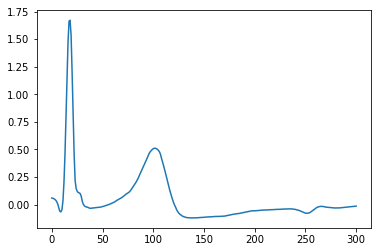

A00889
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


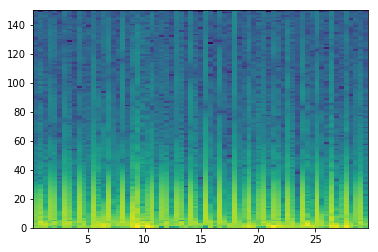

good List
[0, 2, 5, 8, 10, 11, 16, 17, 19, 25, 28, 31, 34, 37, 39, 40, 42, 43, 45, 48, 51, 54, 57, 59, 60, 62, 63, 65, 66, 68]
[2, 3, 3, 2, 1, 5, 1, 2, 6, 3, 3, 3, 3, 2, 1, 2, 1, 2, 3, 3, 3, 3, 2, 1, 2, 1, 2, 1, 2]
the temp 3
[[], [], [], [], [5], [7], [], [], [], [], [], [], [15], [17], [], [], [], [], [], [24], [26], [28]]
[10, 11]
longest
[10, 11]
indexList
[10, 11]
theMin
1200
theMax
1500


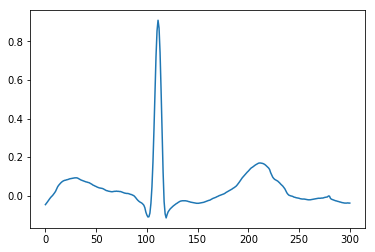

A00892
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

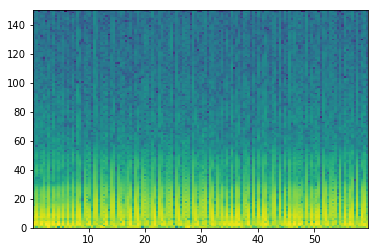

good List
[13, 17, 20, 24, 27, 31, 34, 41, 44, 48, 51, 58, 65, 72, 77, 81, 83, 86, 90, 92, 97, 103, 112, 119, 126, 133, 135]
[4, 3, 4, 3, 4, 3, 7, 3, 4, 3, 7, 7, 7, 5, 4, 2, 3, 4, 2, 5, 6, 9, 7, 7, 7, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


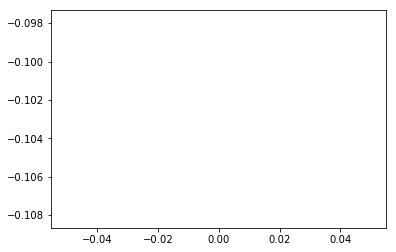

A00894
[ 0.42666667  0.85333333  1.28        1.70666667  2.13333333
  2.56        2.98666667  3.41333333  3.84        4.26666667
  4.69333333  5.12        5.54666667  5.97333333  6.4         6.82666667
  7.25333333  7.68        8.10666667  8.53333333  8.96      ]


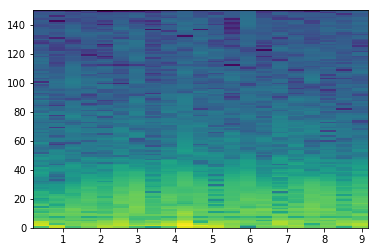

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


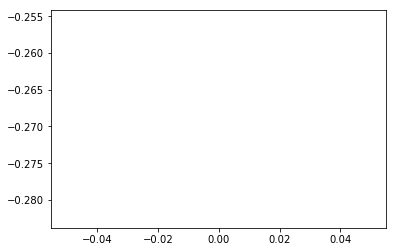

A00898
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


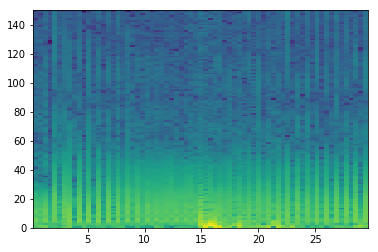

good List
[3, 10, 12, 14, 18, 30, 47, 57, 59]
[7, 2, 2, 4, 12, 17, 10, 2]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


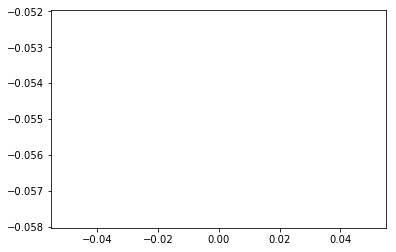

A00903
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


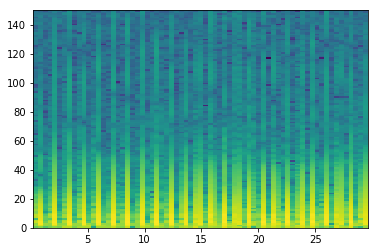

good List
[0, 2, 3, 5, 6, 8, 9, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 29, 30, 32, 35, 37, 38, 40, 43, 46, 48, 50, 51, 53, 54, 56, 58, 59, 61, 64, 66, 67]
[2, 1, 2, 1, 2, 1, 2, 3, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 2, 3, 3, 2, 2, 1, 2, 1, 2, 2, 1, 2, 3, 2, 1]
the temp 3
[[], [2], [4], [6], [], [9], [11], [13], [15], [17], [19], [], [], [23], [], [], [], [], [29], [31], [], [34], [], []]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


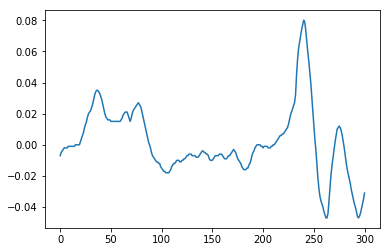

A00904
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667]


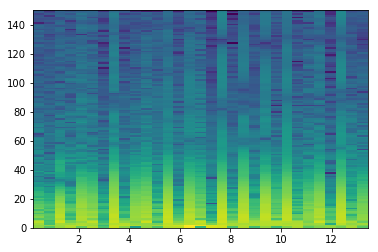

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


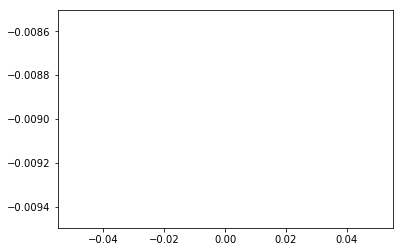

A00906
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


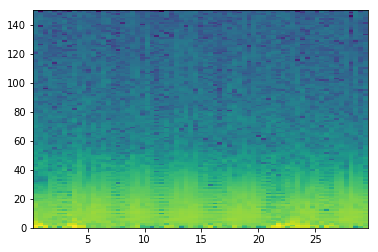

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


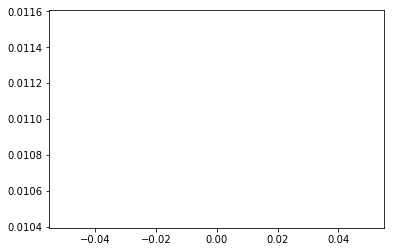

A00908
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


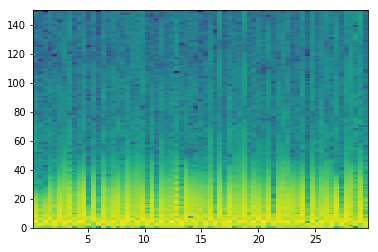

good List
[2, 4, 8, 9, 11, 13, 15, 23, 25, 27, 30, 31, 32, 33, 35, 37, 39, 44, 49, 53, 54, 56, 61, 63]
[2, 4, 1, 2, 2, 2, 8, 2, 2, 3, 1, 1, 1, 2, 2, 2, 5, 5, 4, 1, 2, 5, 2]
the temp 3
[[], [], [3], [], [], [], [], [], [], [11, 12, 13], [], [], [], [], [], [20], [], []]
[30, 31, 32, 33]
longest
[30, 31, 32, 33]
indexList
[30, 31, 32, 33]
theMin
3900
theMax
4200


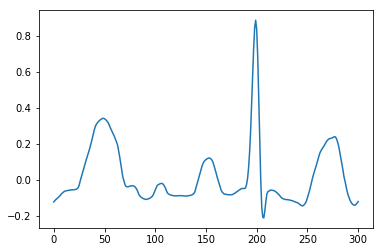

A00913
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


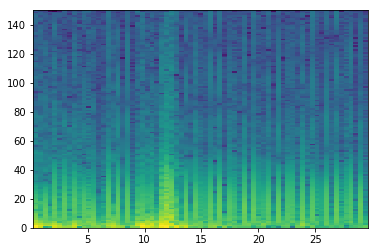

good List
[13, 18, 20, 35, 39, 42, 44, 47, 49, 51, 54, 58, 59, 61, 63, 66, 68]
[5, 2, 15, 4, 3, 2, 3, 2, 2, 3, 4, 1, 2, 2, 3, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [12], [], [], []]
[58, 59]
longest
[58, 59]
indexList
[58, 59]
theMin
7500
theMax
7800


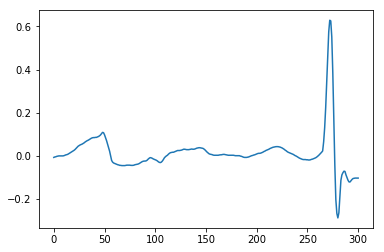

A00914
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


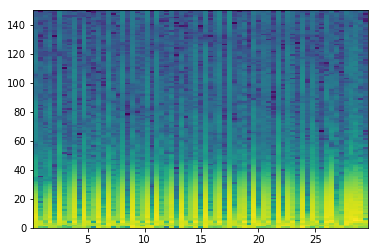

good List
[1, 2, 4, 6, 7, 9, 11, 12, 14, 17, 19, 22, 24, 27, 29, 31, 32, 34, 36, 37, 39, 41, 44, 46, 47, 48, 49, 51, 54, 56, 59, 63]
[1, 2, 2, 1, 2, 2, 1, 2, 3, 2, 3, 2, 3, 2, 2, 1, 2, 2, 1, 2, 2, 3, 2, 1, 1, 1, 2, 3, 2, 3, 4]
the temp 3
[[1], [], [4], [], [7], [], [], [], [], [], [], [], [16], [], [19], [], [], [], [24, 25, 26], [], [], [], []]
[46, 47, 48, 49]
longest
[46, 47, 48, 49]
indexList
[46, 47, 48, 49]
theMin
6000
theMax
6300


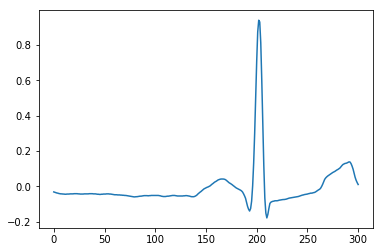

A00916
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

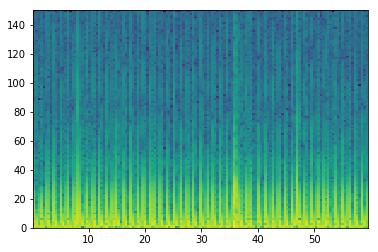

good List
[1, 2, 4, 7, 10, 12, 13, 15, 21, 23, 24, 26, 29, 31, 32, 36, 39, 42, 44, 45, 47, 51, 54, 57, 59, 60, 62, 63, 65, 68, 70, 71, 73, 76, 79, 81, 82, 87, 91, 92, 94, 95, 97, 98, 100, 103, 106, 108, 111, 114, 116, 117, 119, 126, 127, 129, 130, 132, 135]
[1, 2, 3, 3, 2, 1, 2, 6, 2, 1, 2, 3, 2, 1, 4, 3, 3, 2, 1, 2, 4, 3, 3, 2, 1, 2, 1, 2, 3, 2, 1, 2, 3, 3, 2, 1, 5, 4, 1, 2, 1, 2, 1, 2, 3, 3, 2, 3, 3, 2, 1, 2, 7, 1, 2, 1, 2, 3]
the temp 3
[[1], [], [], [], [6], [], [], [10], [], [], [14], [], [], [], [19], [], [], [], [], [25], [27], [], [], [31], [], [], [], [36], [], [39], [41], [43], [], [], [], [], [], [], [51], [], [54], [56], []]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


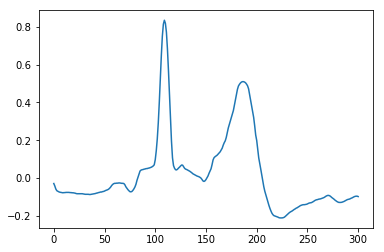

A00917
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


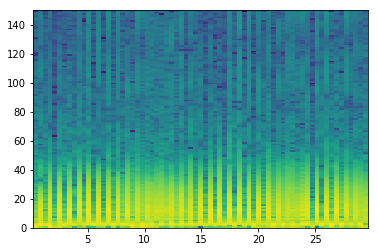

good List
[2, 4, 12, 14, 16, 18, 29, 31, 33, 37, 39, 45, 57]
[2, 8, 2, 2, 2, 11, 2, 2, 4, 2, 6, 12]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


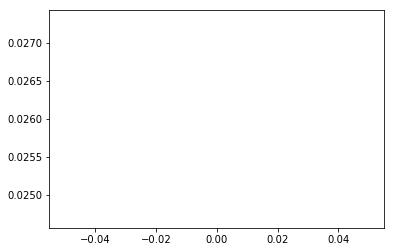

A00919
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

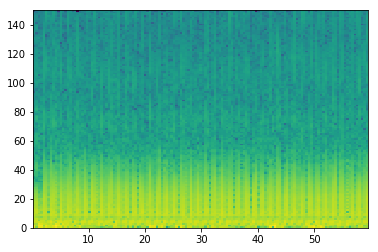

good List
[5, 43, 129, 133]
[38, 86, 4]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


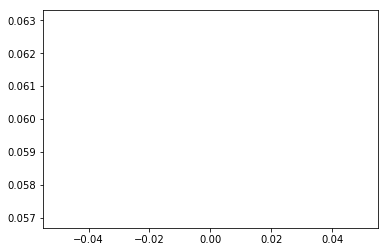

A00923
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


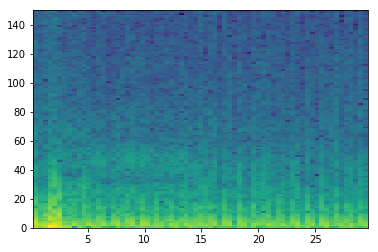

good List
[41, 66]
[25]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


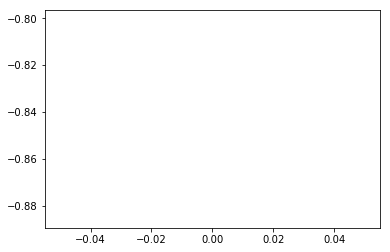

A00924
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


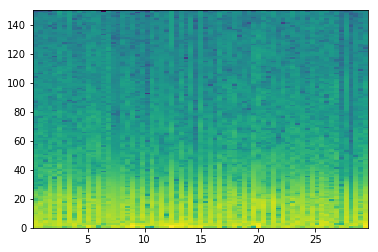

good List
[65]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


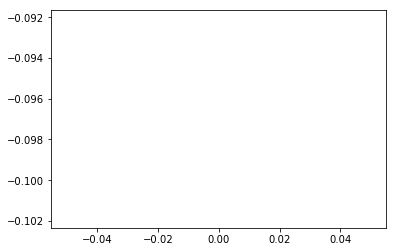

A00927
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


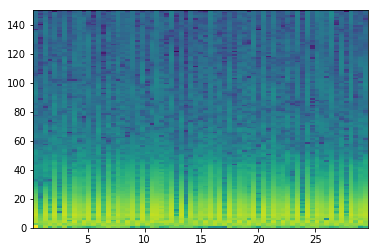

good List
[29, 55, 62, 66]
[26, 7, 4]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


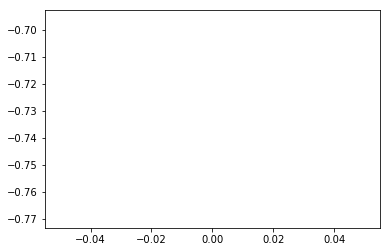

A00930
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


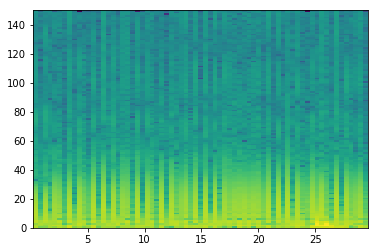

good List
[1, 6, 8, 11, 13, 15, 17, 20, 22, 25, 27, 30, 32, 34, 36, 45, 47, 49, 51, 53, 55, 56, 60, 61, 63, 66, 68]
[5, 2, 3, 2, 2, 2, 3, 2, 3, 2, 3, 2, 2, 2, 9, 2, 2, 2, 2, 2, 1, 4, 1, 2, 3, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [21], [23], [], []]
[55, 56]
longest
[55, 56]
indexList
[55, 56]
theMin
6900
theMax
7200


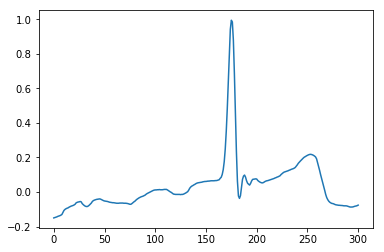

A00931
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


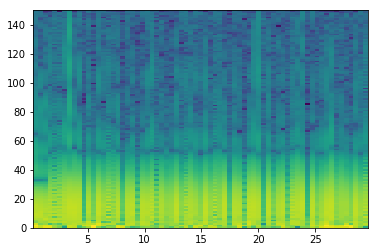

good List
[10, 11, 12, 18, 19, 21, 22, 25, 26, 27, 28, 30, 34, 36, 40, 42, 43, 47, 49, 50, 52, 56, 58, 62, 64, 65, 66, 67]
[1, 1, 6, 1, 2, 1, 3, 1, 1, 1, 2, 4, 2, 4, 2, 1, 4, 2, 1, 2, 4, 2, 4, 2, 1, 1, 1]
the temp 3
[[1, 2], [4], [6], [8, 9, 10], [], [], [], [], [16], [], [19], [], [], [], []]
[25, 26, 27, 28]
longest
[25, 26, 27, 28]
indexList
[25, 26, 27, 28]
theMin
3300
theMax
3600


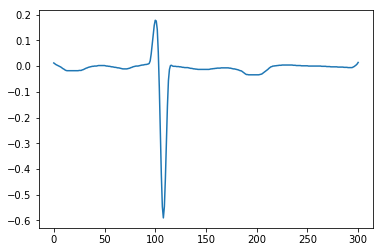

A00935
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


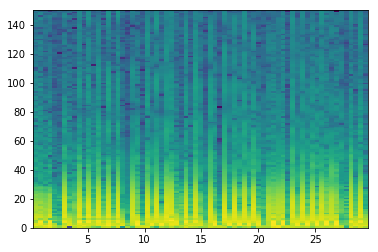

good List
[4, 5, 8, 10, 14, 16, 19, 22, 26, 30, 32, 35, 38, 40, 47, 52, 68]
[1, 3, 2, 4, 2, 3, 3, 4, 4, 2, 3, 3, 2, 7, 5, 16]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[4, 5]
longest
[4, 5]
indexList
[4, 5]
theMin
600
theMax
900


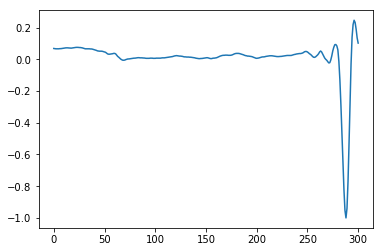

A00944
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


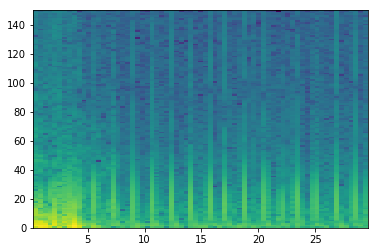

good List
[14, 17, 18, 19, 21, 22, 23, 26, 27, 29, 30, 31, 33, 34, 35, 37, 38, 40, 41, 42, 44, 46, 48, 49, 50, 52, 53, 55, 56, 59, 60, 61, 63, 64, 65, 67, 68]
[3, 1, 1, 2, 1, 1, 3, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 2, 2, 1, 1, 2, 1, 2, 1, 3, 1, 1, 2, 1, 1, 2, 1]
the temp 3
[[], [2, 3], [5, 6], [8], [10, 11], [13, 14], [16], [18, 19], [], [], [23, 24], [26], [28], [30, 31], [33, 34]]
[17, 18, 19]
longest
[17, 18, 19]
indexList
[17, 18, 19]
theMin
2100
theMax
2400


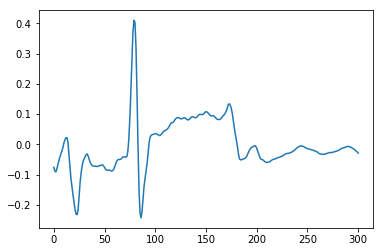

A00956
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


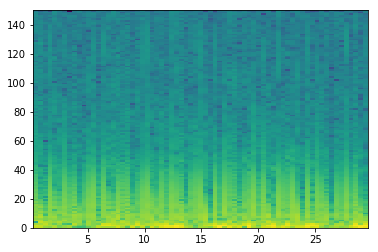

good List
[2, 4, 5, 7, 9, 10, 13, 20, 22, 25, 27, 31, 36, 38, 42, 48, 51, 55, 57, 61, 62, 63, 65, 68]
[2, 1, 2, 2, 1, 3, 7, 2, 3, 2, 4, 5, 2, 4, 6, 3, 4, 2, 4, 1, 1, 2, 3]
the temp 3
[[], [2], [], [5], [], [], [], [], [], [], [], [], [], [], [], [], [], [20, 21], []]
[61, 62, 63]
longest
[61, 62, 63]
indexList
[61, 62, 63]
theMin
7800
theMax
8100


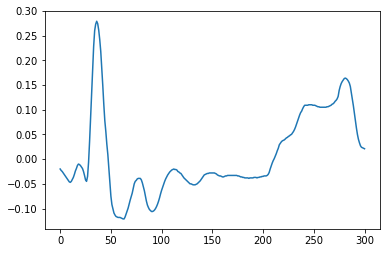

A00957
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


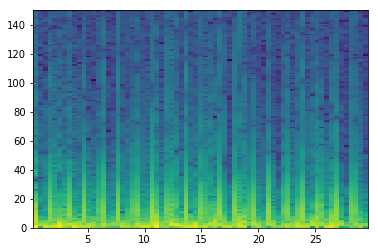

good List
[1, 2, 8, 9, 11, 12, 15, 16, 18, 19, 23, 26, 30, 32, 33, 40, 46, 47, 49, 50, 53, 56, 63, 64, 67, 68]
[1, 6, 1, 2, 1, 3, 1, 2, 1, 4, 3, 4, 2, 1, 7, 6, 1, 2, 1, 3, 3, 7, 1, 3, 1]
the temp 3
[[1], [3], [5], [7], [9], [], [], [], [14], [], [17], [19], [], [], [23]]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


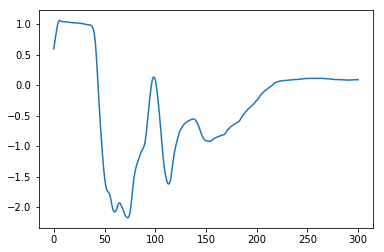

A00958
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

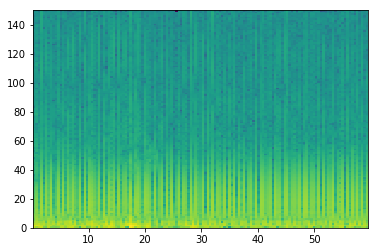

good List
[2, 4, 6, 8, 9, 11, 13, 18, 20, 22, 25, 26, 28, 30, 34, 36, 39, 41, 45, 52, 54, 56, 58, 59, 61, 62, 63, 64, 66, 68, 69, 71, 73, 75, 78, 80, 82, 84, 86, 88, 89, 91, 93, 96, 97, 99, 103, 106, 107, 109, 111, 114, 115, 117, 119, 121, 122, 123, 125, 129, 131, 135, 137]
[2, 2, 2, 1, 2, 2, 5, 2, 2, 3, 1, 2, 2, 4, 2, 3, 2, 4, 7, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 1, 2, 2, 3, 1, 2, 4, 3, 1, 2, 2, 3, 1, 2, 2, 2, 1, 1, 2, 4, 2, 4, 2]
the temp 3
[[], [], [], [4], [], [], [], [], [], [11], [], [], [], [], [], [], [], [], [], [], [23], [25, 26, 27], [], [30], [], [], [], [], [], [], [], [], [40], [], [], [44], [], [], [48], [], [], [52], [], [], [56, 57], [], [], [], []]
[61, 62, 63, 64]
longest
[61, 62, 63, 64]
indexList
[61, 62, 63, 64]
theMin
7800
theMax
8100


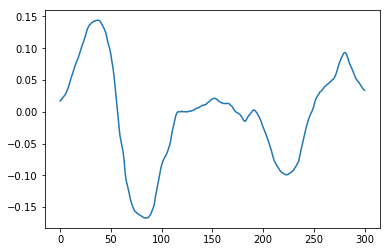

A00959
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

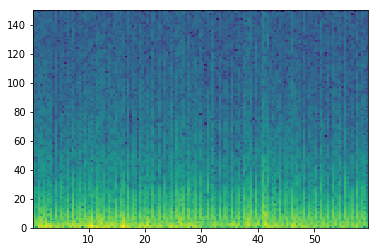

good List
[1, 8, 10, 12, 13, 15, 17, 18, 20, 22, 23, 25, 30, 35, 36, 38, 40, 43, 45, 46, 48, 50, 51, 53, 54, 55, 56, 58, 60, 63, 65, 66, 68, 70, 71, 73, 75, 76, 78, 79, 80, 81, 83, 84, 85, 86, 91, 93, 94, 99, 101, 103, 105, 106, 108, 110, 111, 113, 114, 115, 116, 118, 120, 121, 123, 124, 126, 128, 130, 131, 132, 133, 135, 138]
[7, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 5, 5, 1, 2, 2, 3, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 2, 3, 2, 1, 2, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 5, 2, 1, 5, 2, 2, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 2, 1, 2, 1, 2, 2, 2, 1, 1, 1, 2, 3]
the temp 3
[[], [], [], [4], [], [7], [], [10], [], [], [14], [], [], [], [19], [], [22], [24, 25, 26], [], [], [], [31], [], [34], [], [37], [39, 40, 41], [43, 44, 45], [], [48], [], [], [], [53], [], [56], [58, 59, 60], [], [63], [65], [], [], [69, 70, 71], []]
[53, 54, 55, 56]
longest
[53, 54, 55, 56]
indexList
[53, 54, 55, 56]
theMin
6900
theMax
7200


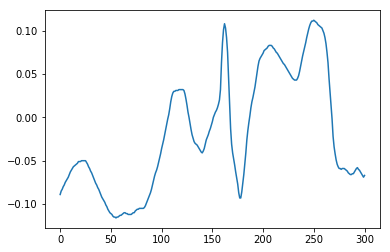

A00962
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


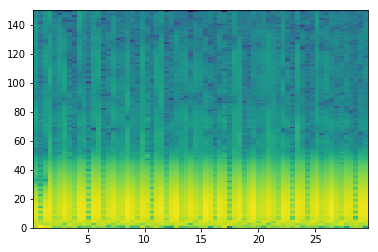

good List
[1, 4, 8, 11, 14, 24, 27, 37, 40, 43, 46, 52, 56, 59, 66]
[3, 4, 3, 3, 10, 3, 10, 3, 3, 3, 6, 4, 3, 7]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


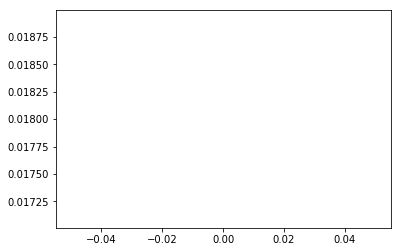

A00968
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

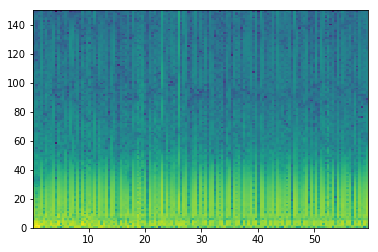

good List
[9, 14, 19, 21, 26, 31, 34, 35, 40, 47, 54, 64, 65, 72, 75, 79, 82, 86, 93, 104, 107, 114, 116, 118, 125, 132, 134]
[5, 5, 2, 5, 5, 3, 1, 5, 7, 7, 10, 1, 7, 3, 4, 3, 4, 7, 11, 3, 7, 2, 2, 7, 7, 2]
the temp 3
[[], [], [], [], [], [], [7], [], [], [], [12], [], [], [], [], [], [], [], [], [], [], [], [], []]
[34, 35]
longest
[34, 35]
indexList
[34, 35]
theMin
4200
theMax
4500


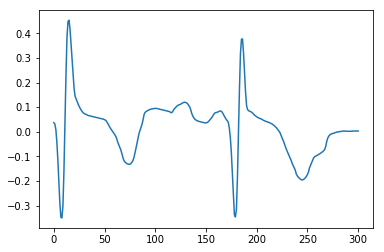

A00971
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


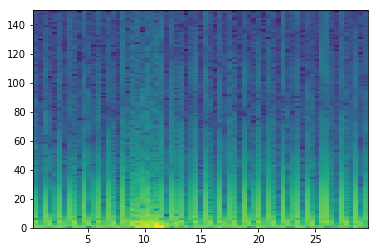

good List
[1, 4, 6, 7, 9, 12, 14, 17, 27, 31, 34, 37, 39, 42, 45, 47, 50, 52, 55, 57, 58, 62, 65, 67]
[3, 2, 1, 2, 3, 2, 3, 10, 4, 3, 3, 2, 3, 3, 2, 3, 2, 3, 2, 1, 4, 3, 2]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [20], [], []]
[6, 7]
longest
[6, 7]
indexList
[6, 7]
theMin
600
theMax
900


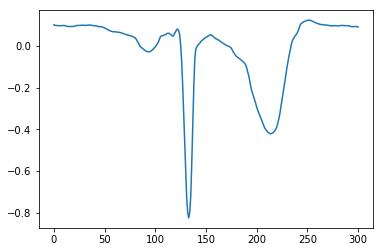

A00975
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


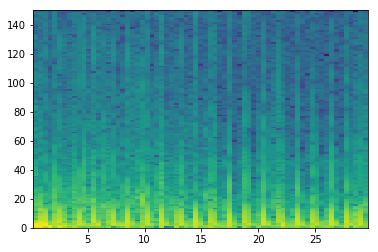

good List
[3, 6, 9, 27, 28, 29, 32, 34, 38, 39, 41, 42, 45, 46, 48, 49, 52, 53, 55, 56, 59, 60, 62, 63, 65]
[3, 3, 18, 1, 1, 3, 2, 4, 1, 2, 1, 3, 1, 2, 1, 3, 1, 2, 1, 3, 1, 2, 1, 2]
the temp 3
[[], [], [], [4, 5], [], [], [9], [11], [13], [15], [17], [19], [21], [23]]
[27, 28, 29]
longest
[27, 28, 29]
indexList
[27, 28, 29]
theMin
3300
theMax
3600


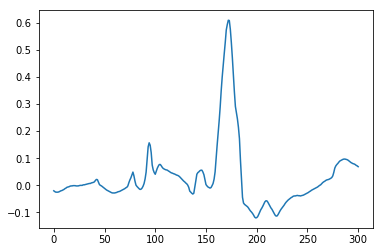

A00977
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


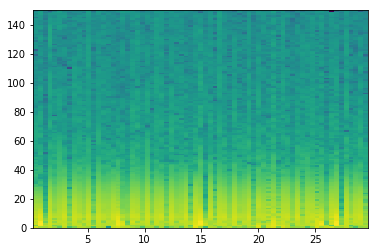

good List
[0, 2, 7, 9, 10, 12, 14, 17, 18, 19, 22, 24, 26, 27, 29, 30, 31, 32, 35, 36, 37, 40, 45, 48, 50, 51, 52, 53, 60, 63, 65, 66, 68]
[2, 5, 2, 1, 2, 2, 3, 1, 1, 3, 2, 2, 1, 2, 1, 1, 1, 3, 1, 1, 3, 5, 3, 2, 1, 1, 1, 7, 3, 2, 1, 2]
the temp 3
[[], [], [], [4], [], [], [8, 9], [], [], [13], [15, 16, 17], [19, 20], [], [], [], [25, 26, 27], [], [], [31]]
[29, 30, 31, 32]
longest
[29, 30, 31, 32]
indexList
[29, 30, 31, 32]
theMin
3600
theMax
4200


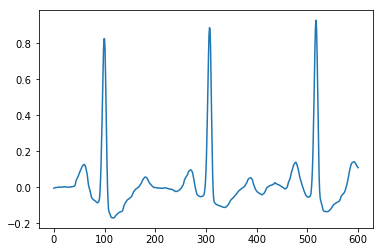

A00979
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


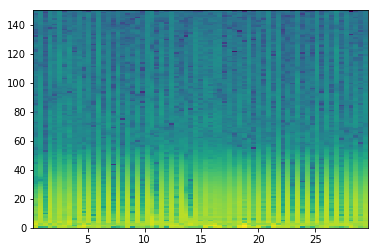

good List
[0, 2, 6, 8, 10, 12, 14, 16, 18, 20, 22, 29, 32, 41, 43, 45, 47, 49, 51, 53, 55, 57, 59, 61, 63, 65]
[2, 4, 2, 2, 2, 2, 2, 2, 2, 2, 7, 3, 9, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


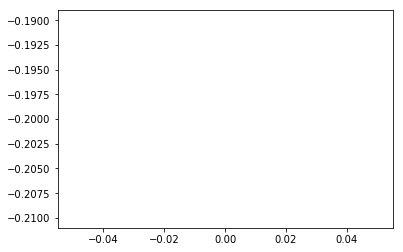

A00983
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


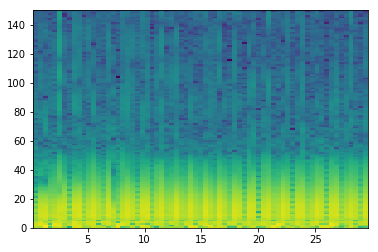

good List
[7, 24, 31, 33, 39, 42, 53, 54]
[17, 7, 2, 6, 3, 11, 1]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


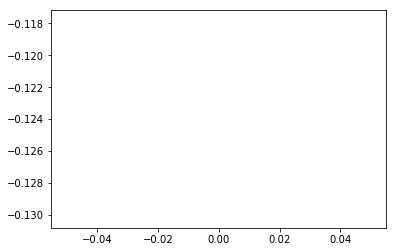

A00989
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


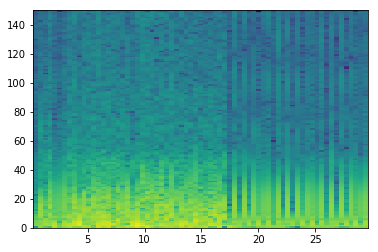

good List
[0, 40, 42, 44, 47, 49, 51, 53, 55, 56, 57, 58, 60, 62, 64, 65, 66, 67, 68]
[40, 2, 2, 3, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 1, 1, 1, 1]
the temp 3
[[], [], [], [], [], [], [], [], [9, 10, 11], [], []]
[55, 56, 57, 58]
longest
[55, 56, 57, 58]
indexList
[55, 56, 57, 58]
theMin
6900
theMax
7500


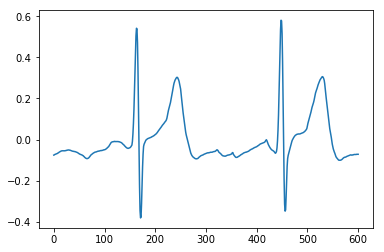

A00991
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667]


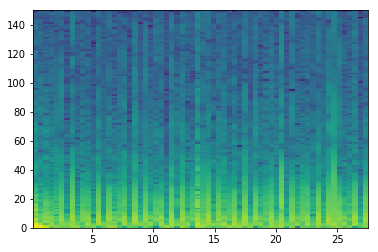

good List
[6, 11, 13, 18, 20, 25, 29, 30, 34, 37, 41, 48, 50, 55, 62]
[5, 2, 5, 2, 5, 4, 1, 4, 3, 4, 7, 2, 5, 7]
the temp 3
[[], [], [], [], [], [], [7], [], [], [], [], [], []]
[29, 30]
longest
[29, 30]
indexList
[29, 30]
theMin
3600
theMax
3900


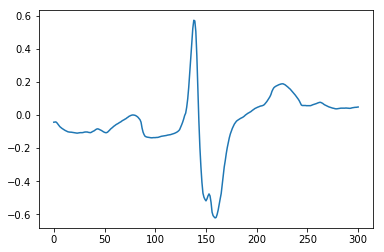

A00993
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


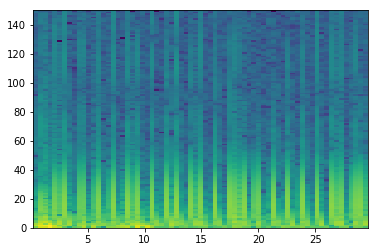

good List
[0, 3, 8, 11, 12, 14, 15, 17, 18, 20, 22, 23, 25, 26, 28, 30, 31, 33, 35, 36, 38, 39, 44, 45, 47, 48, 50, 51, 53, 54, 56, 57, 59, 60, 64, 65, 68]
[3, 5, 3, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 2, 1, 2, 1, 5, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 4, 1, 3]
the temp 3
[[], [], [], [4], [6], [8], [], [11], [13], [], [16], [], [19], [21], [23], [25], [27], [29], [31], [33], [35]]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


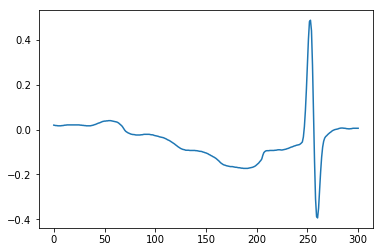

A00997
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


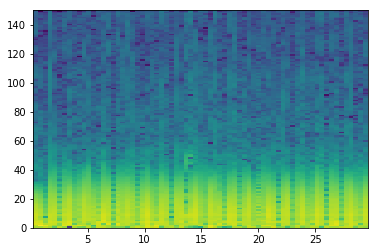

good List
[9, 16]
[7]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


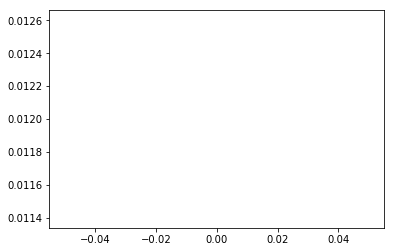

A01025
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


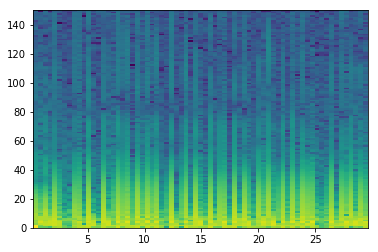

good List
[3, 5, 6, 7, 10, 12, 13, 16, 20, 22, 24, 26, 27, 29, 30, 32, 35, 37, 40, 42, 45, 49, 50, 52, 54, 58, 59, 60, 62]
[2, 1, 1, 3, 2, 1, 3, 4, 2, 2, 2, 1, 2, 1, 2, 3, 2, 3, 2, 3, 4, 1, 2, 2, 4, 1, 1, 2]
the temp 3
[[], [2, 3], [], [6], [], [], [], [], [12], [14], [], [], [], [], [], [], [22], [], [], [26, 27]]
[5, 6, 7]
longest
[5, 6, 7]
indexList
[5, 6, 7]
theMin
600
theMax
900


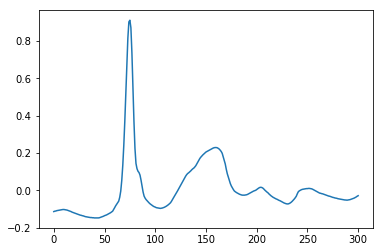

A01027
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


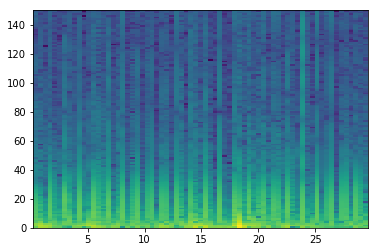

good List
[4, 8, 10, 11, 16, 19, 22, 25, 28, 31, 37, 39, 40, 56, 57, 59, 60, 62, 66, 68]
[4, 2, 1, 5, 3, 3, 3, 3, 3, 6, 2, 1, 16, 1, 2, 1, 2, 4, 2]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], [12], [14], [16], [], []]
[10, 11]
longest
[10, 11]
indexList
[10, 11]
theMin
1200
theMax
1500


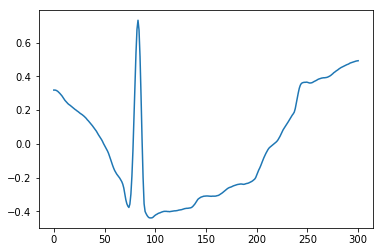

A01030
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


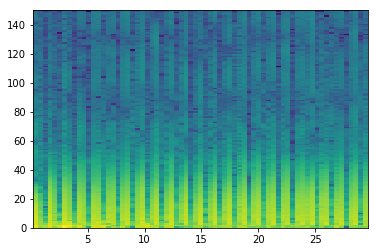

good List
[2, 5, 8, 11, 17, 23, 26, 32, 33, 35, 38, 41, 44, 50, 53, 57, 58, 64]
[3, 3, 3, 6, 6, 3, 6, 1, 2, 3, 3, 3, 6, 3, 4, 1, 6]
the temp 3
[[], [], [], [], [], [], [], [8], [], [], [], [], [], [], [16]]
[32, 33]
longest
[32, 33]
indexList
[32, 33]
theMin
4200
theMax
4500


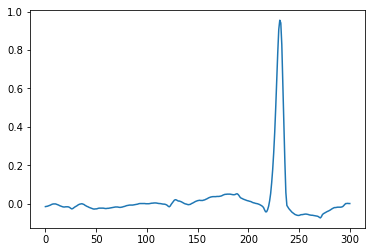

A01031
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


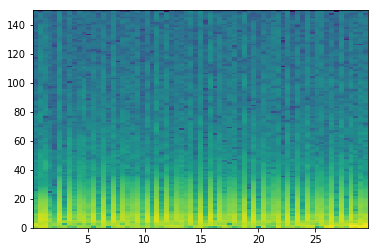

good List
[0, 3, 4, 6, 8, 11, 15, 20, 22, 24, 26, 28, 29, 33, 35, 37, 40, 41, 42, 44, 46, 49, 51, 53, 55, 57, 58, 59, 60, 62, 64]
[3, 1, 2, 2, 3, 4, 5, 2, 2, 2, 2, 1, 4, 2, 2, 3, 1, 1, 2, 2, 3, 2, 2, 2, 2, 1, 1, 1, 2, 2]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [12], [], [], [], [17, 18], [], [], [], [], [], [], [26, 27, 28], []]
[57, 58, 59, 60]
longest
[57, 58, 59, 60]
indexList
[57, 58, 59, 60]
theMin
7200
theMax
7800


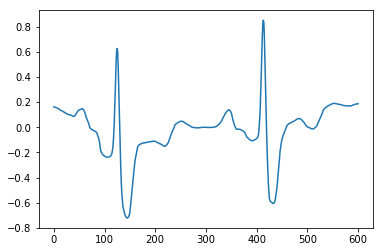

A01036
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


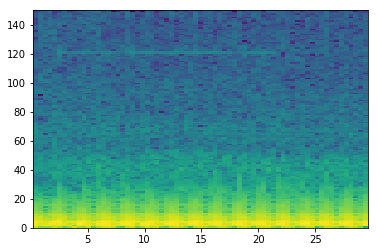

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


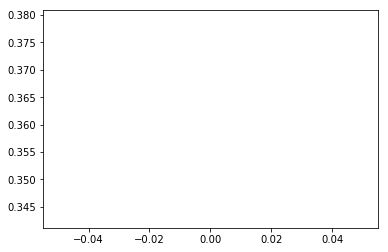

A01037
[ 0.42666667  0.85333333  1.28        1.70666667  2.13333333
  2.56        2.98666667  3.41333333  3.84        4.26666667
  4.69333333  5.12        5.54666667  5.97333333  6.4         6.82666667
  7.25333333  7.68        8.10666667  8.53333333  8.96
  9.38666667]


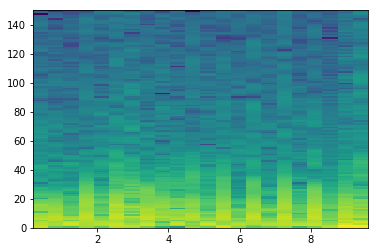

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


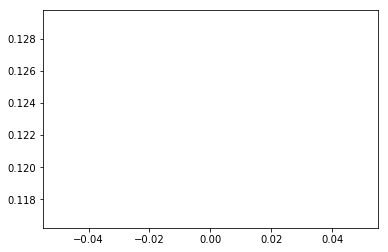

A01040
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333]


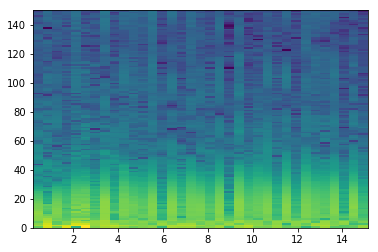

good List
[16, 32]
[16]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


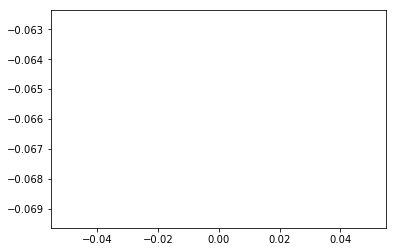

A01043
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

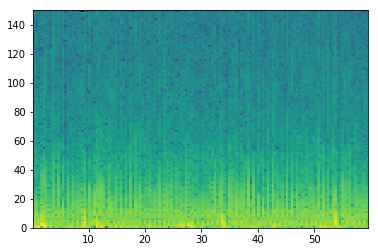

good List
[2, 13, 15, 17, 22, 24, 49, 51, 53, 59, 69, 71, 79, 80, 85, 87, 88, 90, 92, 96, 98, 102, 104, 112, 121, 127, 132, 136, 137, 138]
[11, 2, 2, 5, 2, 25, 2, 2, 6, 10, 2, 8, 1, 5, 2, 1, 2, 2, 4, 2, 4, 2, 8, 9, 6, 5, 4, 1, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [13], [], [16], [], [], [], [], [], [], [], [], [], []]
[79, 80]
longest
[79, 80]
indexList
[79, 80]
theMin
10200
theMax
10500


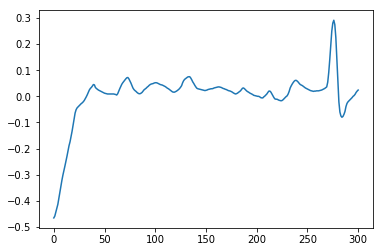

A01049
[ 0.42666667  0.85333333  1.28        1.70666667  2.13333333
  2.56        2.98666667  3.41333333  3.84        4.26666667
  4.69333333  5.12        5.54666667  5.97333333  6.4         6.82666667
  7.25333333  7.68        8.10666667  8.53333333  8.96      ]


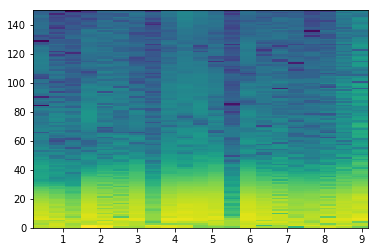

good List
[2, 7, 12, 17]
[5, 5, 5]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


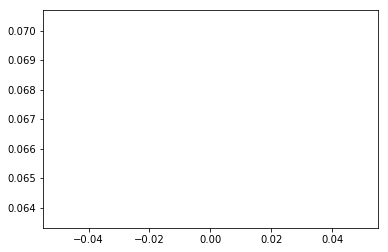

A01057
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

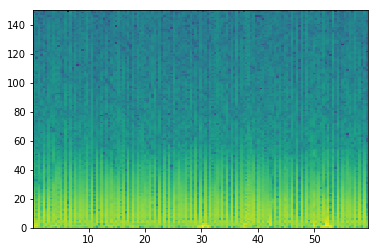

good List
[3, 5, 25, 27, 29, 38, 40, 42, 51, 53, 66, 68, 70, 72, 83, 85, 108, 110, 112, 125, 127, 138]
[2, 20, 2, 2, 9, 2, 2, 9, 2, 13, 2, 2, 2, 11, 2, 23, 2, 2, 13, 2, 11]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


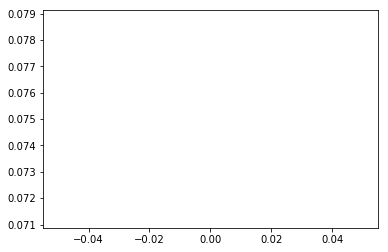

A01065
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


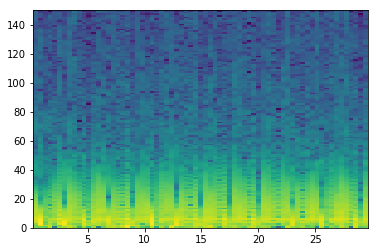

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


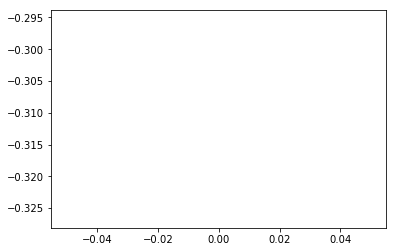

A01068
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

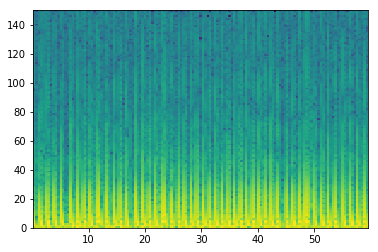

good List
[1, 5, 7, 10, 13, 14, 16, 17, 20, 22, 25, 28, 29, 32, 34, 37, 40, 41, 44, 47, 49, 52, 56, 58, 59, 61, 64, 69, 72, 74, 77, 79, 82, 84, 87, 89, 90, 92, 95, 97, 100, 102, 103, 104, 106, 109, 111, 118, 121, 123, 124, 126, 127, 130, 133, 135, 136, 138]
[4, 2, 3, 3, 1, 2, 1, 3, 2, 3, 3, 1, 3, 2, 3, 3, 1, 3, 3, 2, 3, 4, 2, 1, 2, 3, 5, 3, 2, 3, 2, 3, 2, 3, 2, 1, 2, 3, 2, 3, 2, 1, 1, 2, 3, 2, 7, 3, 2, 1, 2, 1, 3, 3, 2, 1, 2]
the temp 3
[[], [], [], [], [5], [7], [], [], [], [12], [], [], [], [17], [], [], [], [], [], [24], [], [], [], [], [], [], [], [], [], [], [36], [], [], [], [], [42, 43], [], [], [], [], [], [50], [52], [], [], [56]]
[102, 103, 104]
longest
[102, 103, 104]
indexList
[102, 103, 104]
theMin
12900
theMax
13200


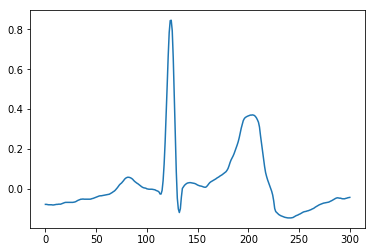

A01071
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

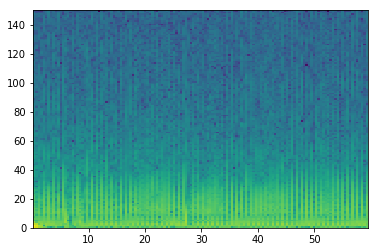

good List
[7, 9, 11, 13, 14, 15, 17, 21, 25, 27, 29, 31, 33, 35, 37, 39, 41, 45, 46, 50, 52, 54, 55, 57, 64, 65, 69, 70, 71, 72, 73, 76, 77, 79, 81, 83, 85, 87, 88, 89, 91, 95, 98, 100, 102, 104, 106, 108, 109, 110, 112, 114, 116, 118, 123, 125, 127, 129, 131, 135, 137]
[2, 2, 2, 1, 1, 2, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 4, 1, 4, 2, 2, 1, 2, 7, 1, 4, 1, 1, 1, 1, 3, 1, 2, 2, 2, 2, 2, 1, 1, 2, 4, 3, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 5, 2, 2, 2, 2, 4, 2]
the temp 3
[[], [], [], [4, 5], [], [], [], [], [], [], [], [], [], [], [], [18], [], [], [22], [], [25], [27, 28, 29, 30], [32], [], [], [], [], [38, 39], [], [], [], [], [], [], [], [48, 49], [], [], [], [], [], [], [], [], [], []]
[69, 70, 71, 72, 73]
longest
[69, 70, 71, 72, 73]
indexList
[69, 70, 71, 72, 73]
theMin
8700
theMax
9300


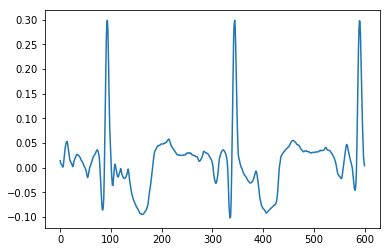

A01072
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

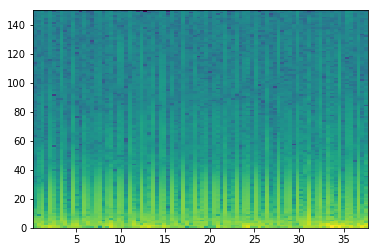

good List
[0, 1, 3, 5, 6, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 21, 23, 24, 26, 27, 29, 30, 32, 35, 37, 38, 39, 40, 41, 43, 44, 45, 46, 47, 48, 49, 51, 52, 54, 55, 57, 58, 59, 60, 62, 63, 65, 66, 68, 70, 73, 74, 76, 79, 81, 84, 86]
[1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 3, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 2, 3, 1, 2, 3, 2, 3, 2]
the temp 3
[[1], [], [4], [6], [8, 9, 10, 11, 12, 13, 14], [], [17], [19], [21], [], [], [25, 26, 27, 28], [30, 31, 32, 33, 34, 35], [37], [39], [41, 42, 43], [45], [47], [], [], [51], [], [], [], []]
[11, 12, 13, 14, 15, 16, 17, 18]
longest
[11, 12, 13, 14, 15, 16, 17, 18]
indexList
[11, 12, 13, 14, 15, 16, 17, 18]
theMin
1500
theMax
2400


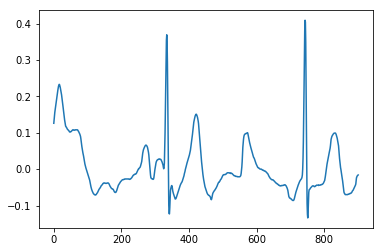

A01073
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


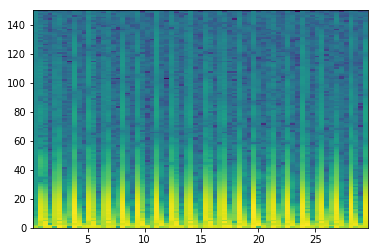

good List
[0, 3, 6, 7, 9, 10, 13, 14, 16, 17, 19, 20, 22, 23, 24, 26, 27, 30, 33, 34, 37, 40, 41, 43, 44, 46, 47, 48, 50, 51, 53, 54, 57, 58, 60, 61, 63, 64, 66, 67]
[3, 3, 1, 2, 1, 3, 1, 2, 1, 2, 1, 2, 1, 1, 2, 1, 3, 3, 1, 3, 3, 1, 2, 1, 2, 1, 1, 2, 1, 2, 1, 3, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [], [3], [5], [7], [9], [11], [13, 14], [16], [], [19], [], [22], [24], [26, 27], [29], [31], [33], [35], [37]]
[22, 23, 24]
longest
[22, 23, 24]
indexList
[22, 23, 24]
theMin
2700
theMax
3000


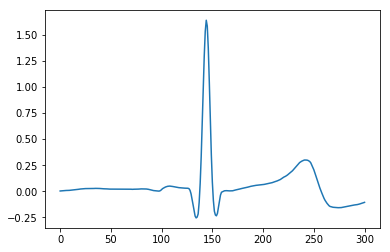

A01078
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

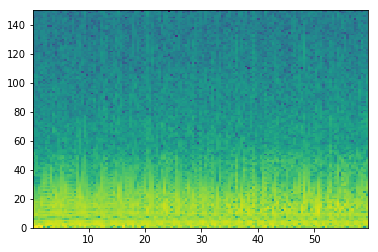

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


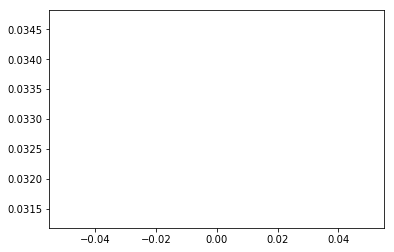

A01081
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

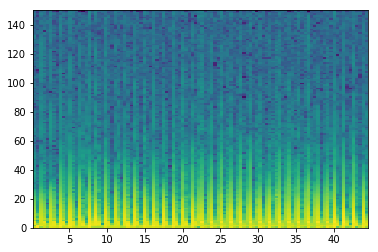

good List
[0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 12, 13, 14, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 47, 48, 50, 51, 53, 54, 56, 59, 60, 62, 63, 65, 66, 68, 69, 71, 72, 73, 74, 77, 78, 80, 81, 82, 83, 84, 86, 87, 88, 89, 90, 92, 94, 95, 97, 98, 100, 101, 102, 103]
[1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 3, 1, 2, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1]
the temp 3
[[1, 2, 3, 4, 5, 6, 7], [9], [11, 12], [14, 15, 16, 17, 18], [20, 21], [23, 24, 25, 26, 27, 28], [30, 31, 32, 33, 34, 35, 36], [38], [40], [42], [44], [], [47], [49], [51], [53], [55, 56, 57], [59], [61, 62, 63, 64], [66, 67, 68, 69], [], [72], [74]]
[0, 1, 2, 3, 4, 5, 6, 7]
longest
[0, 1, 2, 3, 4, 5, 6, 7]
indexList
[0, 1, 2, 3, 4, 5, 6, 7]
theMin
0
theMax
900


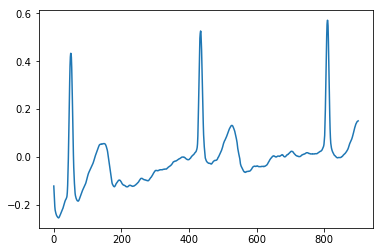

A01084
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

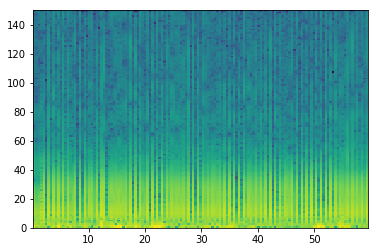

good List
[5, 7, 9, 11, 13, 18, 20, 22, 25, 27, 30, 39, 41, 43, 46, 48, 50, 52, 54, 63, 65, 67, 78, 80, 82, 84, 86, 97, 99, 101, 106, 108, 110, 112, 114, 116, 118, 120, 122, 124]
[2, 2, 2, 2, 5, 2, 2, 3, 2, 3, 9, 2, 2, 3, 2, 2, 2, 2, 9, 2, 2, 11, 2, 2, 2, 2, 11, 2, 2, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


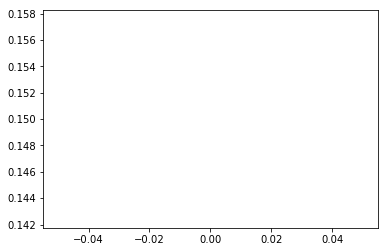

A01088
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


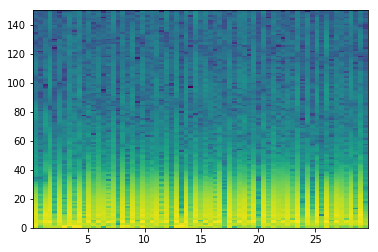

good List
[1, 4, 6, 10, 17, 19, 21, 23, 25, 28, 30, 32, 34, 36, 39, 41, 46, 53, 55, 57, 59, 61, 68]
[3, 2, 4, 7, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 5, 7, 2, 2, 2, 2, 7]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


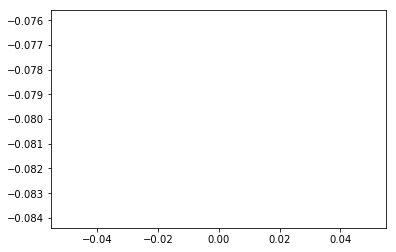

A01091
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


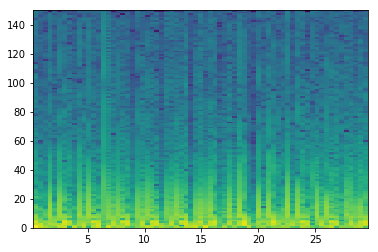

good List
[1, 2, 4, 8, 20, 26, 32, 35, 38, 44, 45, 47, 53]
[1, 2, 4, 12, 6, 6, 3, 3, 6, 1, 2, 6]
the temp 3
[[1], [], [], [], [], [], [], [], [10], []]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


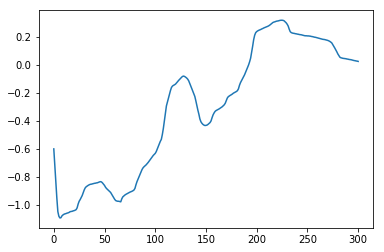

A01093
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


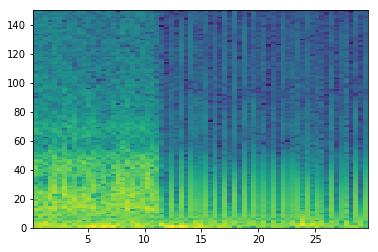

good List
[27, 29, 31, 36, 38, 40, 42, 44, 46, 47, 48, 50, 52, 55, 57, 60, 62, 65, 67]
[2, 2, 5, 2, 2, 2, 2, 2, 1, 1, 2, 2, 3, 2, 3, 2, 3, 2]
the temp 3
[[], [], [], [], [], [], [], [], [9, 10], [], [], [], [], [], [], []]
[46, 47, 48]
longest
[46, 47, 48]
indexList
[46, 47, 48]
theMin
6000
theMax
6300


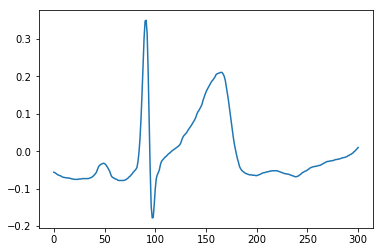

A01094
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


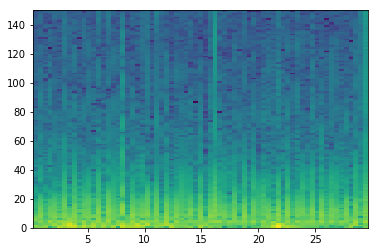

good List
[0, 11, 12, 24, 26, 33, 35, 44, 46, 48, 49, 53, 56, 60]
[11, 1, 12, 2, 7, 2, 9, 2, 2, 1, 4, 3, 4]
the temp 3
[[], [2], [], [], [], [], [], [], [10], [], []]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


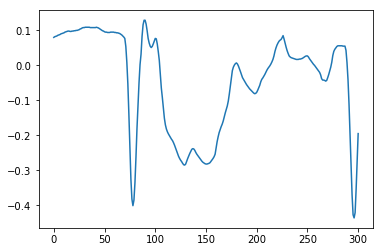

A01095
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

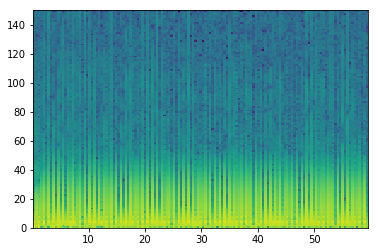

good List
[0, 1, 2, 3, 5, 7, 9, 11, 13, 15, 17, 18, 20, 22, 24, 26, 27, 28, 29, 31, 33, 35, 37, 39, 40, 41, 42, 43, 44, 46, 48, 50, 52, 54, 55, 57, 59, 61, 63, 65, 67, 68, 69, 70, 72, 74, 75, 76, 78, 79, 80, 82, 85, 87, 89, 91, 93, 95, 97, 99, 101, 103, 104, 106, 107, 108, 110, 111, 112, 114, 116, 118, 119, 121, 123, 124, 125, 126, 127, 129, 131, 134, 136, 137, 138]
[1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 1, 1, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 1, 1, 1, 2, 2, 3, 2, 1, 1]
the temp 3
[[1, 2, 3], [], [], [], [], [], [], [11], [], [], [], [16, 17, 18], [], [], [], [], [24, 25, 26, 27, 28], [], [], [], [], [34], [], [], [], [], [], [41, 42, 43], [], [46, 47], [49, 50], [], [], [], [], [], [], [], [], [], [], [62], [64, 65], [67, 68], [], [], [72], [], [75, 76, 77, 78], [], [], []]
[39, 40, 41, 42, 43, 44]
longest
[39, 40, 41, 42, 43, 44]
indexList

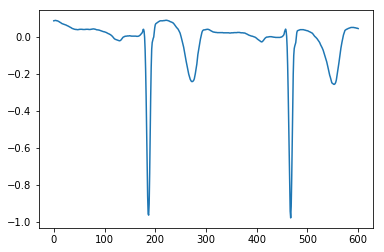

A01099
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


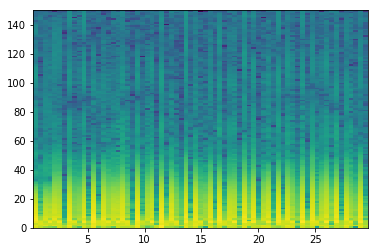

good List
[1, 2, 3, 6, 8, 9, 11, 13, 15, 20, 22, 25, 27, 29, 30, 32, 34, 35, 37, 39, 42, 44, 46, 47, 49, 51, 53, 54, 56, 58, 59, 61, 63, 66, 68]
[1, 1, 3, 2, 1, 2, 2, 2, 5, 2, 3, 2, 2, 1, 2, 2, 1, 2, 2, 3, 2, 2, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2, 3, 2]
the temp 3
[[1, 2], [], [5], [], [], [], [], [], [], [], [14], [], [17], [], [], [], [], [23], [], [], [27], [], [30], [], [], []]
[1, 2, 3]
longest
[1, 2, 3]
indexList
[1, 2, 3]
theMin
0
theMax
300


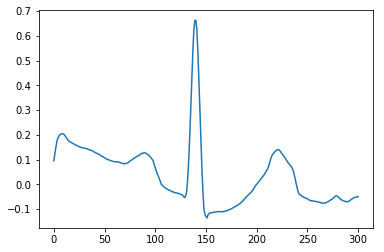

A01100
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

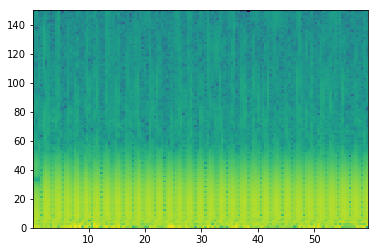

good List
[12, 28, 58, 75, 80, 85, 107, 136]
[16, 30, 17, 5, 5, 22, 29]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


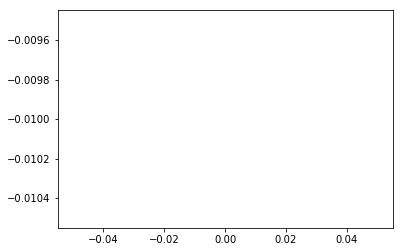

A01103
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


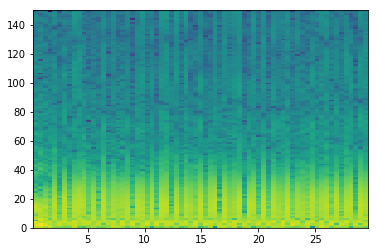

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


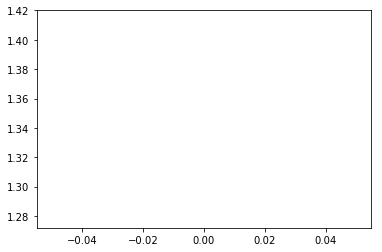

A01107
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


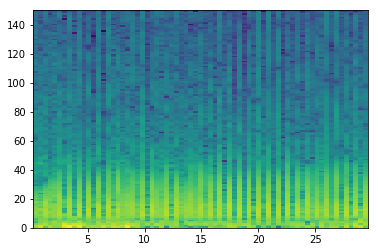

good List
[10, 51]
[41]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


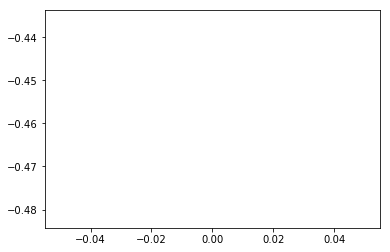

A01115
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


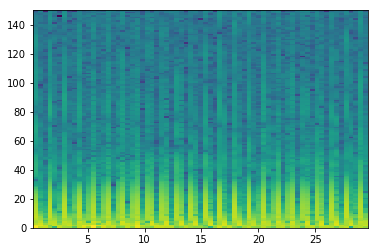

good List
[1, 2, 4, 5, 7, 8, 10, 11, 12, 13, 14, 16, 17, 19, 20, 22, 25, 26, 27, 28, 30, 31, 33, 34, 36, 37, 39, 40, 42, 43, 45, 46, 48, 49, 51, 52, 53, 54, 55, 56, 57, 60, 61, 63, 65, 66, 68]
[1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 2, 1, 2, 3, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 3, 1, 2, 2, 1, 2]
the temp 3
[[1], [3], [5], [7, 8, 9, 10], [12], [14], [], [17, 18, 19], [21], [23], [25], [27], [29], [31], [33], [35, 36, 37, 38, 39, 40], [42], [], [45]]
[51, 52, 53, 54, 55, 56, 57]
longest
[51, 52, 53, 54, 55, 56, 57]
indexList
[51, 52, 53, 54, 55, 56, 57]
theMin
6600
theMax
7200


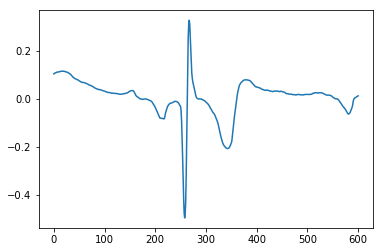

A01124
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


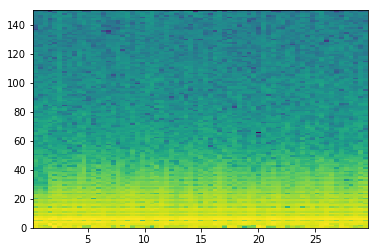

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


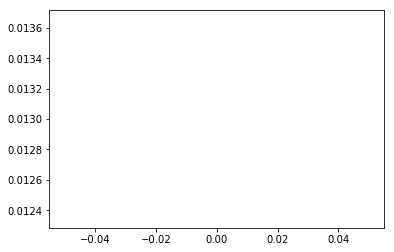

A01130
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


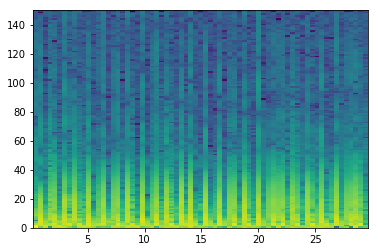

good List
[2, 5, 7, 9, 10, 12, 13, 15, 16, 18, 20, 21, 23, 24, 26, 29, 31, 33, 34, 36, 37, 39, 40, 42, 44, 45, 47, 48, 52, 55, 57, 58, 60, 61, 63, 68]
[3, 2, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 3, 2, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 4, 3, 2, 1, 2, 1, 2, 5]
the temp 3
[[], [], [], [4], [6], [8], [], [11], [13], [], [], [], [18], [20], [22], [], [25], [27], [], [], [31], [33], []]
[9, 10]
longest
[9, 10]
indexList
[9, 10]
theMin
1200
theMax
1500


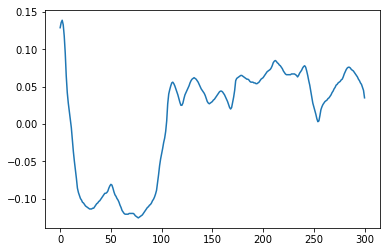

A01131
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


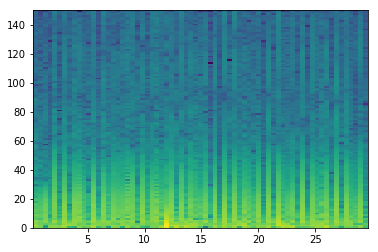

good List
[2, 3, 13, 36, 38, 40, 47, 56, 61]
[1, 10, 23, 2, 2, 7, 9, 5]
the temp 3
[[1], [], [], [], [], [], []]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


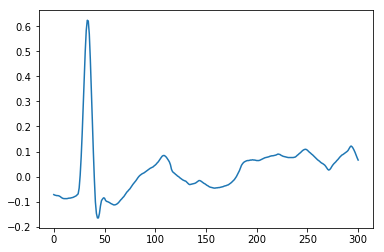

A01133
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


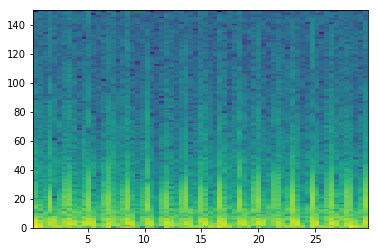

good List
[2, 4, 5, 8, 9, 12, 13, 14, 17, 18, 20, 21, 24, 25, 26, 28, 29, 30, 32, 33, 36, 37, 40, 41, 43, 44, 45, 47, 48, 49, 51, 52, 55, 56, 57, 58, 59, 62, 63, 66, 67]
[2, 1, 3, 1, 3, 1, 1, 3, 1, 2, 1, 3, 1, 1, 2, 1, 1, 2, 1, 3, 1, 3, 1, 2, 1, 1, 2, 1, 1, 2, 1, 3, 1, 1, 1, 1, 3, 1, 3, 1]
the temp 3
[[], [2], [4], [6, 7], [9], [11], [13, 14], [16, 17], [19], [21], [23], [25, 26], [28, 29], [31], [33, 34, 35, 36], [38]]
[55, 56, 57, 58, 59]
longest
[55, 56, 57, 58, 59]
indexList
[55, 56, 57, 58, 59]
theMin
6900
theMax
7500


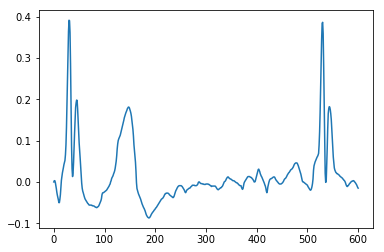

A01134
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


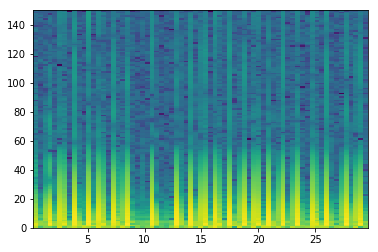

good List
[0, 1, 2, 4, 7, 9, 10, 12, 15, 17, 18, 20, 21, 22, 23, 25, 26, 27, 28, 30, 31, 33, 34, 36, 38, 39, 41, 42, 44, 47, 49, 50, 52, 53, 55, 56, 58, 59, 61, 62, 63, 65, 66, 68]
[1, 1, 2, 3, 2, 1, 2, 3, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1, 2, 1, 2]
the temp 3
[[1, 2], [], [], [6], [], [], [10], [12, 13, 14], [16, 17, 18], [20], [22], [], [25], [27], [], [], [31], [33], [35], [37], [39, 40], [42]]
[20, 21, 22, 23]
longest
[20, 21, 22, 23]
indexList
[20, 21, 22, 23]
theMin
2400
theMax
3000


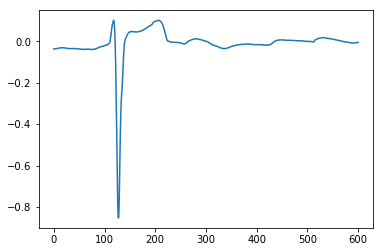

A01136
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


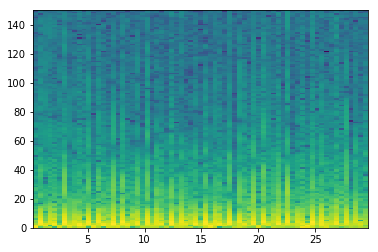

good List
[2, 7, 8, 10, 12, 15, 17, 19, 20, 22, 24, 27, 29, 31, 34, 36, 37, 38, 39, 41, 48, 51, 53, 56, 60, 61, 63, 65, 67]
[5, 1, 2, 2, 3, 2, 2, 1, 2, 2, 3, 2, 2, 3, 2, 1, 1, 1, 2, 7, 3, 2, 3, 4, 1, 2, 2, 2]
the temp 3
[[], [2], [], [], [], [], [8], [], [], [], [], [], [], [16, 17, 18], [], [], [], [], [], [25], [], []]
[36, 37, 38, 39]
longest
[36, 37, 38, 39]
indexList
[36, 37, 38, 39]
theMin
4500
theMax
5100


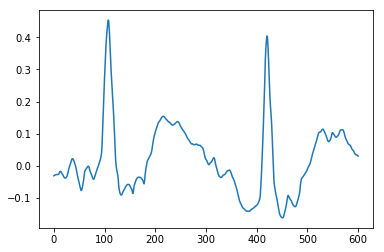

A01145
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


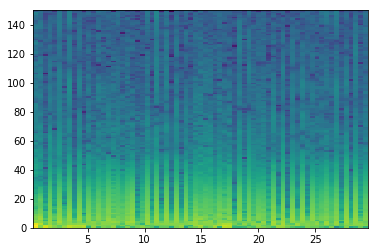

good List
[2, 4, 6, 8, 10, 12, 21, 22, 24, 26, 28, 30, 32, 37, 41, 43, 48, 50, 52, 54, 58, 59, 61, 63, 65, 67]
[2, 2, 2, 2, 2, 9, 1, 2, 2, 2, 2, 2, 5, 4, 2, 5, 2, 2, 2, 4, 1, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [7], [], [], [], [], [], [], [], [], [], [], [], [], [21], [], [], []]
[21, 22]
longest
[21, 22]
indexList
[21, 22]
theMin
2700
theMax
3000


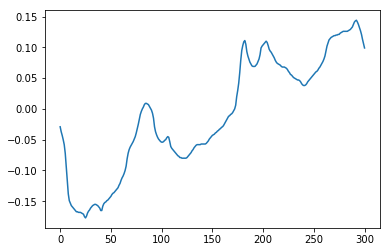

A01152
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


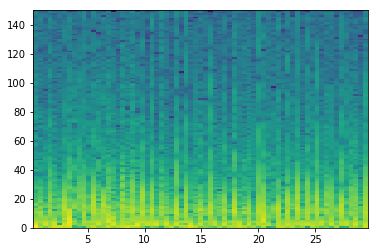

good List
[4, 5, 23, 25, 28, 32, 35, 40, 49, 51, 57, 59, 67]
[1, 18, 2, 3, 4, 3, 5, 9, 2, 6, 2, 8]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], []]
[4, 5]
longest
[4, 5]
indexList
[4, 5]
theMin
600
theMax
900


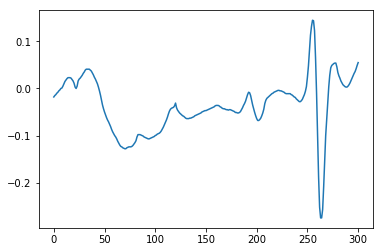

A01154
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


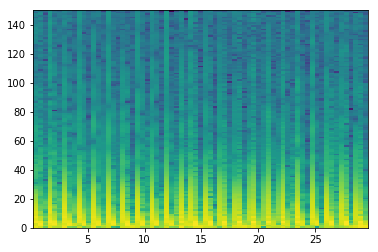

good List
[5, 7, 11, 14, 16, 17, 20, 25, 26, 29, 31, 34, 37, 40, 43, 44, 46, 47, 49, 50, 52, 53, 56, 58, 59, 65, 68]
[2, 4, 3, 2, 1, 3, 5, 1, 3, 2, 3, 3, 3, 3, 1, 2, 1, 2, 1, 2, 1, 3, 2, 1, 6, 3]
the temp 3
[[], [], [], [], [5], [], [8], [], [], [], [], [], [15], [17], [19], [21], [], [24], []]
[16, 17]
longest
[16, 17]
indexList
[16, 17]
theMin
2100
theMax
2400


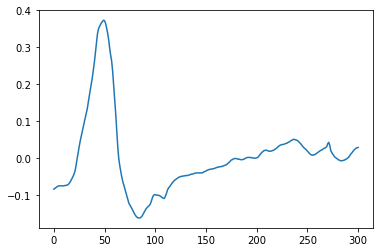

A01156
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64      ]


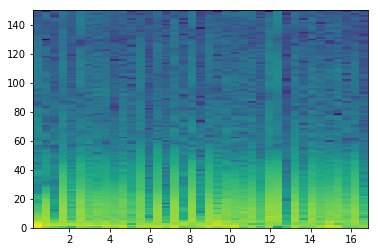

good List
[2, 9, 13, 15, 19, 24, 26, 29, 31, 38]
[7, 4, 2, 4, 5, 2, 3, 2, 7]
the temp 3
[[], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


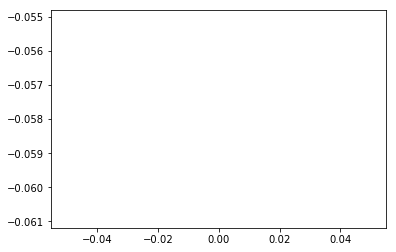

A01158
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


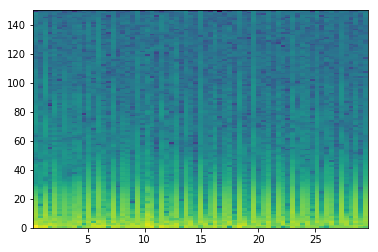

good List
[1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15, 16, 17, 19, 20, 22, 24, 25, 27, 28, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 43, 44, 46, 47, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 64, 65, 66, 67, 68]
[2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 2, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1]
the temp 3
[[], [2, 3, 4, 5, 6], [8, 9], [11, 12, 13], [15], [], [18], [20], [22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], [34], [36], [38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50]]
[49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62]
longest
[49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62]
indexList
[49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62]
theMin
6300
theMax
7800


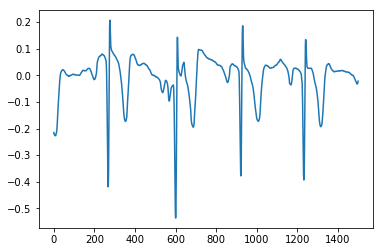

A01164
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667]


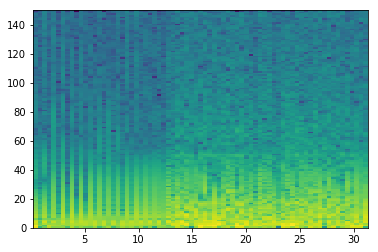

good List
[1, 3, 5, 7, 9, 11, 13, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28]
[2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


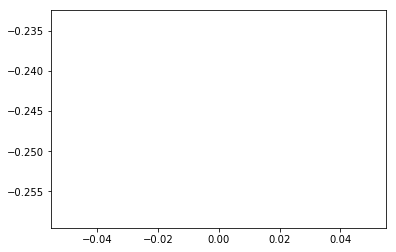

A01167
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


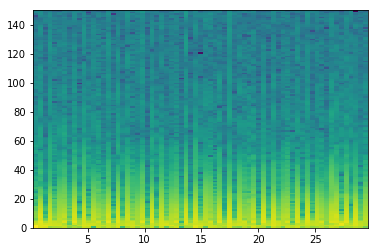

good List
[2, 5, 7, 9, 12, 14, 16, 21, 23, 25, 27, 30, 32, 34, 35, 37, 39, 41, 44, 46, 48, 50, 53, 54, 55, 57, 58, 60, 63, 65, 67, 68]
[3, 2, 2, 3, 2, 2, 5, 2, 2, 2, 3, 2, 2, 1, 2, 2, 2, 3, 2, 2, 2, 3, 1, 1, 2, 1, 2, 3, 2, 2, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [14], [], [], [], [], [], [], [], [23, 24], [26], [], [], []]
[53, 54, 55]
longest
[53, 54, 55]
indexList
[53, 54, 55]
theMin
6900
theMax
7200


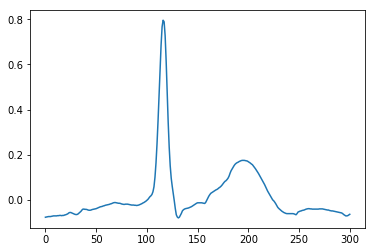

A01173
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

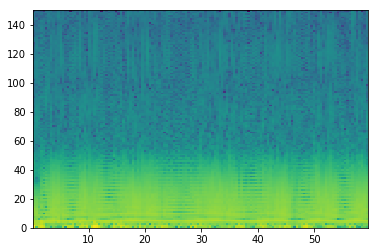

good List
[30, 31, 77, 100, 115]
[1, 46, 23, 15]
the temp 3
[[1], [], []]
[30, 31]
longest
[30, 31]
indexList
[30, 31]
theMin
3900
theMax
4200


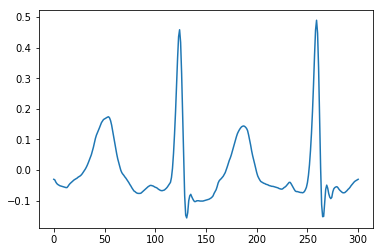

A01175
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


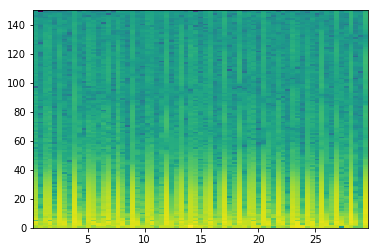

good List
[0, 1, 2, 4, 6, 7, 9, 10, 12, 13, 14, 15, 16, 18, 19, 20, 21, 22, 25, 26, 28, 29, 31, 34, 35, 37, 38, 40, 41, 43, 46, 48, 49, 51, 52, 54, 55, 57, 58, 60, 61, 63, 64, 66, 67, 68]
[1, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 1, 1, 3, 1, 2, 1, 2, 3, 1, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1]
the temp 3
[[1, 2], [], [5], [7], [9, 10, 11, 12], [14, 15, 16, 17], [19], [21], [], [24], [26], [28], [], [], [32], [34], [36], [38], [40], [42]]
[12, 13, 14, 15, 16]
longest
[12, 13, 14, 15, 16]
indexList
[12, 13, 14, 15, 16]
theMin
1500
theMax
2100


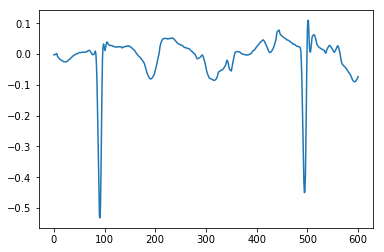

A01177
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

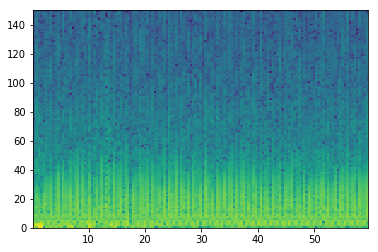

good List
[40, 93, 125]
[53, 32]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


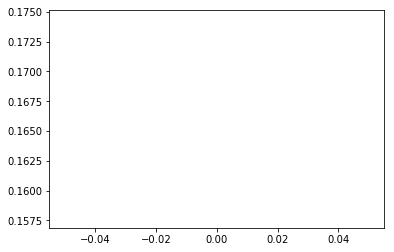

A01178
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


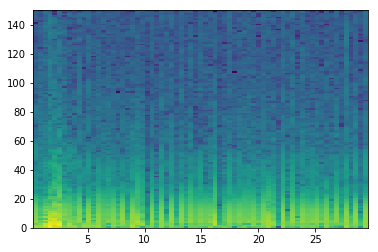

good List
[9, 10, 12, 13, 14, 16, 17, 18, 19, 23, 25, 27, 29, 31, 33, 35, 38, 39, 41, 43, 47, 48, 50, 52, 54, 58, 59, 60, 61, 63, 65, 67]
[1, 2, 1, 1, 2, 1, 1, 1, 4, 2, 2, 2, 2, 2, 2, 3, 1, 2, 2, 4, 1, 2, 2, 2, 4, 1, 1, 1, 2, 2, 2]
the temp 3
[[1], [3, 4], [6, 7, 8], [], [], [], [], [], [], [], [17], [], [], [21], [], [], [], [26, 27, 28], [], []]
[16, 17, 18, 19]
longest
[16, 17, 18, 19]
indexList
[16, 17, 18, 19]
theMin
2100
theMax
2400


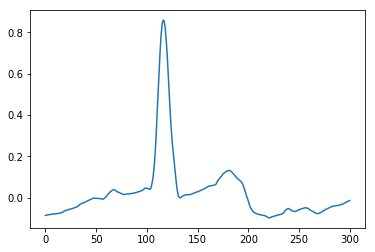

A01180
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


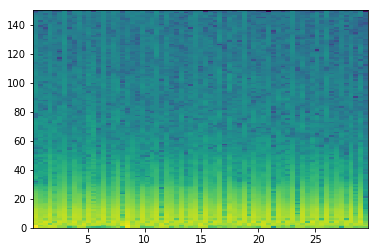

good List
[9, 13, 15, 18, 29, 31, 36, 39, 42, 44, 49, 54, 56, 63, 64, 66, 68]
[4, 2, 3, 11, 2, 5, 3, 3, 2, 5, 5, 2, 7, 1, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [14], []]
[63, 64]
longest
[63, 64]
indexList
[63, 64]
theMin
8100
theMax
8400


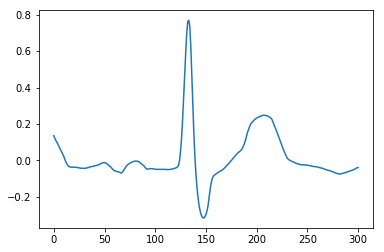

A01182
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


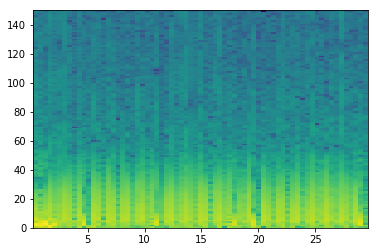

good List
[20, 26]
[6]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


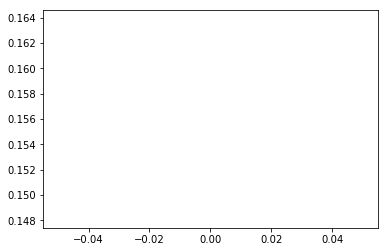

A01183
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


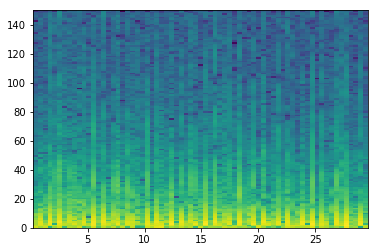

good List
[0, 11, 13, 15, 16, 18, 22, 24, 27, 29, 31, 34, 36, 38, 43, 46, 48, 49, 51, 53, 54, 56, 58, 60, 61, 65, 66, 68]
[11, 2, 2, 1, 2, 4, 2, 3, 2, 2, 3, 2, 2, 5, 3, 2, 1, 2, 2, 1, 2, 2, 2, 1, 4, 1, 2]
the temp 3
[[], [], [], [4], [], [], [], [], [], [], [], [], [], [], [], [17], [], [20], [], [], [24], [26]]
[15, 16]
longest
[15, 16]
indexList
[15, 16]
theMin
1800
theMax
2100


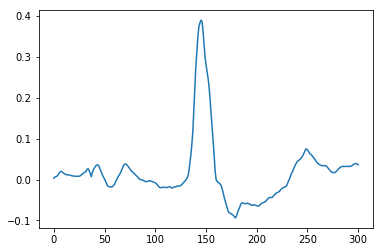

A01186
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


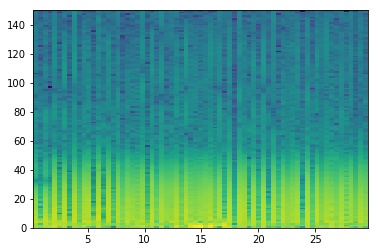

good List
[7, 23, 41, 46]
[16, 18, 5]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


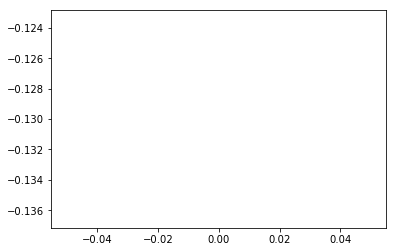

A01187
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


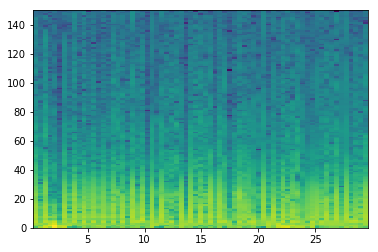

good List
[5, 23, 31, 40, 65]
[18, 8, 9, 25]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


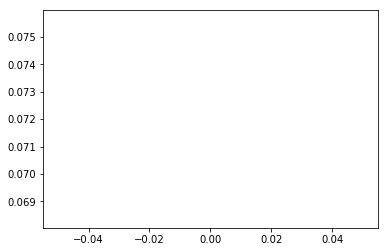

A01188
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


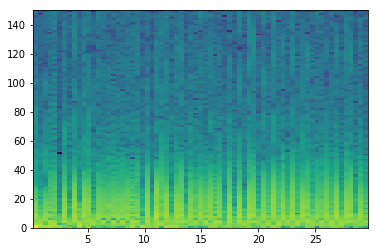

good List
[5, 7, 13, 19, 22, 24, 28, 31, 35, 37, 39, 41, 43, 46, 48, 50, 66, 68]
[2, 6, 6, 3, 2, 4, 3, 4, 2, 2, 2, 2, 3, 2, 2, 16, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


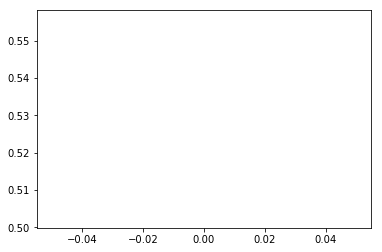

A01191
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


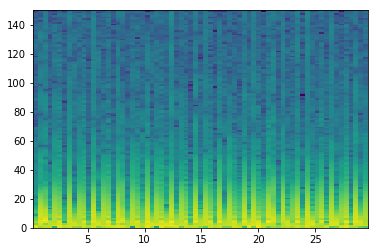

good List
[0, 3, 6, 8, 9, 11, 13, 14, 15, 16, 18, 19, 22, 24, 27, 29, 31, 32, 34, 35, 36, 37, 39, 41, 42, 44, 46, 47, 50, 52, 53, 55, 57, 58, 60, 62, 63, 65, 67, 68]
[3, 3, 2, 1, 2, 2, 1, 1, 1, 2, 1, 3, 2, 3, 2, 2, 1, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 3, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1]
the temp 3
[[], [], [], [4], [], [7, 8, 9], [11], [], [], [], [], [17], [19, 20, 21], [], [24], [], [27], [], [30], [], [33], [], [36], []]
[13, 14, 15, 16]
longest
[13, 14, 15, 16]
indexList
[13, 14, 15, 16]
theMin
1500
theMax
2100


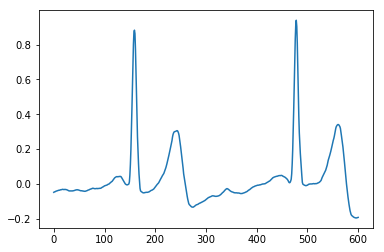

A01193
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


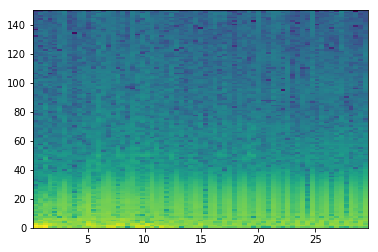

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


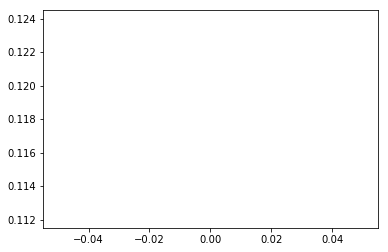

A01201
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


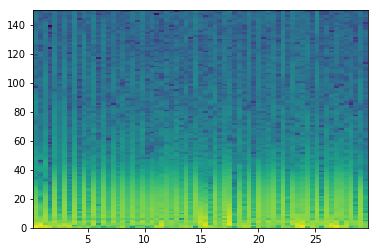

good List
[3, 5, 7, 9, 11, 13, 15, 17, 19, 21, 23, 24, 25, 26, 34, 36, 38, 41, 43, 45, 46, 47, 50, 52, 54, 57, 59, 66, 68]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 8, 2, 2, 3, 2, 2, 1, 1, 3, 2, 2, 3, 2, 7, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [11, 12, 13], [], [], [], [], [], [20, 21], [], [], [], [], [], []]
[23, 24, 25, 26]
longest
[23, 24, 25, 26]
indexList
[23, 24, 25, 26]
theMin
3000
theMax
3300


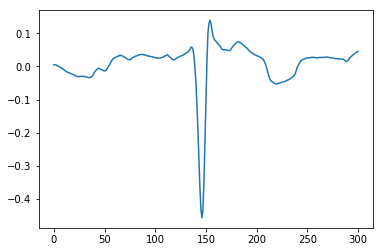

A01203
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


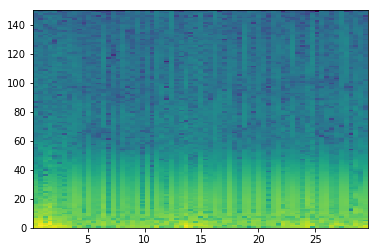

good List
[10, 12, 15, 17, 19, 21, 22, 24, 39, 41, 42, 48, 58, 62, 65]
[2, 3, 2, 2, 2, 1, 2, 15, 2, 1, 6, 10, 4, 3]
the temp 3
[[], [], [], [], [], [6], [], [], [10], [], [], []]
[21, 22]
longest
[21, 22]
indexList
[21, 22]
theMin
2700
theMax
3000


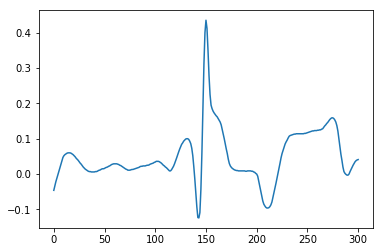

A01209
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


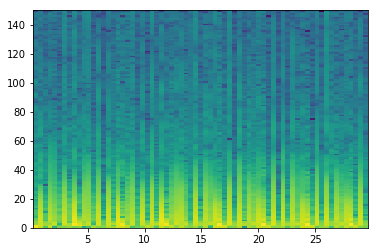

good List
[5, 12, 14, 16, 21, 23, 25, 32, 34, 39, 41, 43, 48, 50, 52, 54, 57, 59, 68]
[7, 2, 2, 5, 2, 2, 7, 2, 5, 2, 2, 5, 2, 2, 2, 3, 2, 9]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


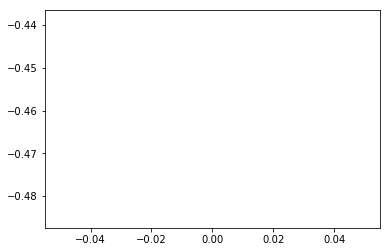

A01213
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

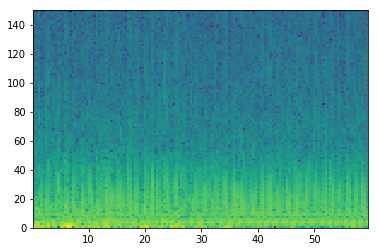

good List
[4, 79, 100, 113, 114, 119, 131]
[75, 21, 13, 1, 5, 12]
the temp 3
[[], [], [], [4], []]
[113, 114]
longest
[113, 114]
indexList
[113, 114]
theMin
14400
theMax
14700


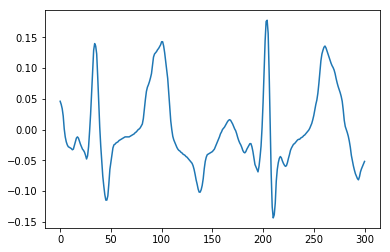

A01216
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667]


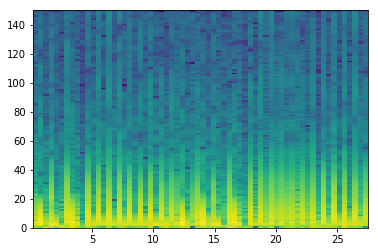

good List
[5, 9, 13, 36, 40, 54, 58, 60]
[4, 4, 23, 4, 14, 4, 2]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


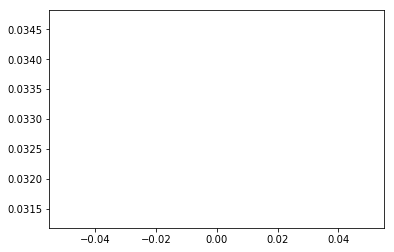

A01218
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


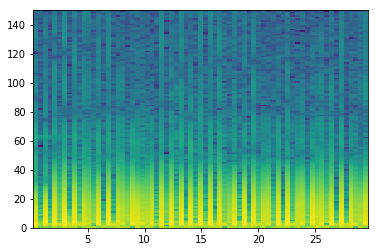

good List
[1, 3, 5, 7, 9, 12, 14, 16, 19, 23, 25, 27, 31, 33, 35, 37, 40, 42, 44, 46, 49, 51, 53, 54, 56, 60, 62, 64, 65, 66, 67]
[2, 2, 2, 2, 3, 2, 2, 3, 4, 2, 2, 4, 2, 2, 2, 3, 2, 2, 2, 3, 2, 2, 1, 2, 4, 2, 2, 1, 1, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [23], [], [], []]
[53, 54]
longest
[53, 54]
indexList
[53, 54]
theMin
6900
theMax
7200


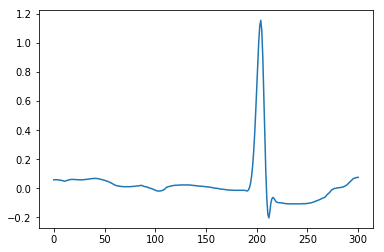

A01219
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


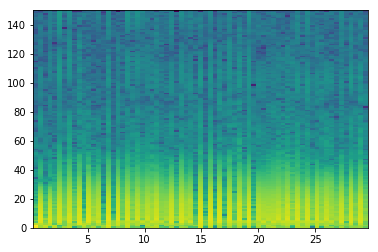

good List
[1, 2, 4, 6, 8, 14, 16, 18, 26, 27, 28, 29, 31, 33, 35, 37, 39, 43, 45, 47, 57, 58, 62, 64, 68]
[1, 2, 2, 2, 6, 2, 2, 8, 1, 1, 1, 2, 2, 2, 2, 2, 4, 2, 2, 10, 1, 4, 2, 4]
the temp 3
[[1], [], [], [], [], [], [], [9, 10, 11], [], [], [], [], [], [], [], [], [21], [], []]
[26, 27, 28, 29]
longest
[26, 27, 28, 29]
indexList
[26, 27, 28, 29]
theMin
3300
theMax
3600


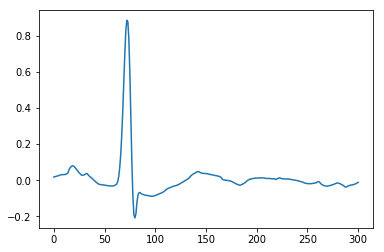

A01220
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


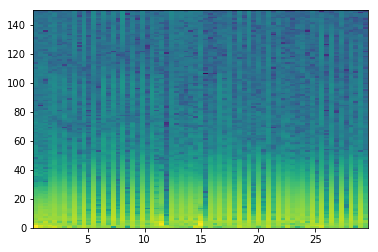

good List
[1, 2, 5, 7, 9, 11, 13, 17, 19, 21, 23, 27, 29, 30, 35, 36, 37, 41, 43, 45, 47, 49, 50, 51, 54, 55, 56, 58, 60, 62, 63, 64, 66, 68]
[1, 3, 2, 2, 2, 2, 4, 2, 2, 2, 4, 2, 1, 5, 1, 1, 4, 2, 2, 2, 2, 1, 1, 3, 1, 1, 2, 2, 2, 1, 1, 2, 2]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [13], [15, 16], [], [], [], [], [22, 23], [25, 26], [], [], [30, 31], []]
[35, 36, 37]
longest
[35, 36, 37]
indexList
[35, 36, 37]
theMin
4500
theMax
4800


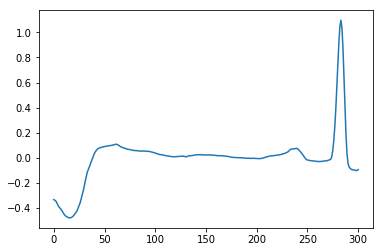

A01224
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


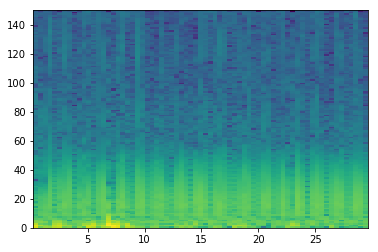

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


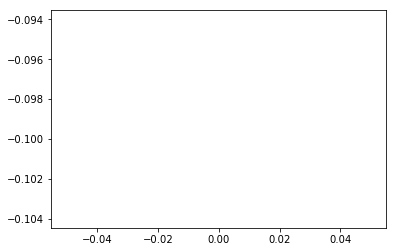

A01226
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


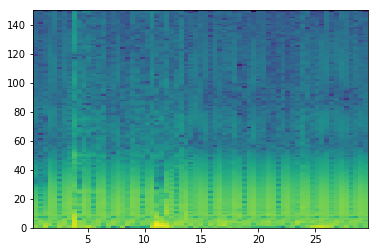

good List
[0, 36, 42]
[36, 6]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


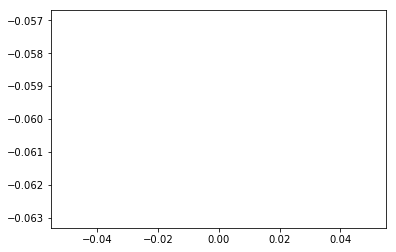

A01235
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8       ]


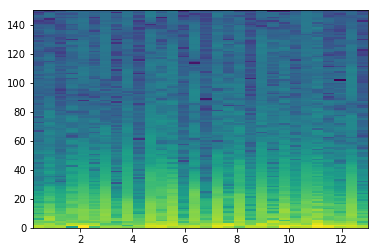

good List
[2, 7, 9, 13, 15, 19, 29]
[5, 2, 4, 2, 4, 10]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


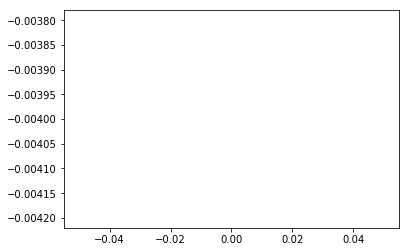

A01236
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

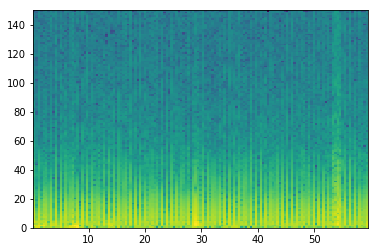

good List
[1, 3, 4, 6, 8, 10, 12, 15, 19, 21, 23, 26, 28, 30, 32, 34, 37, 39, 41, 43, 45, 46, 50, 51, 52, 54, 56, 59, 60, 63, 65, 66, 69, 71, 74, 75, 76, 77, 78, 80, 82, 84, 87, 89, 91, 93, 95, 97, 98, 99, 100, 102, 104, 105, 106, 108, 109, 110, 113, 115, 117, 119, 120, 130, 132, 134]
[2, 1, 2, 2, 2, 2, 3, 4, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 2, 2, 1, 4, 1, 1, 2, 2, 3, 1, 3, 2, 1, 3, 2, 3, 1, 1, 1, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 1, 1, 3, 2, 2, 2, 1, 10, 2, 2]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [21], [23, 24], [], [], [28], [], [31], [], [], [35, 36, 37, 38], [], [], [], [], [], [], [], [], [48, 49, 50], [], [53, 54], [56, 57], [], [], [], [62], [], []]
[74, 75, 76, 77, 78]
longest
[74, 75, 76, 77, 78]
indexList
[74, 75, 76, 77, 78]
theMin
9600
theMax
9900


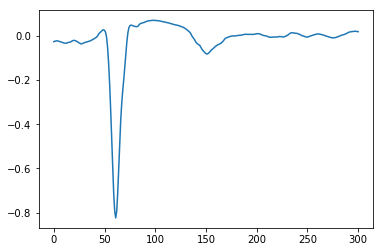

A01237
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

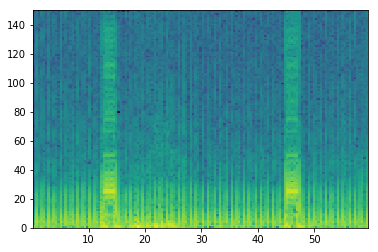

good List
[0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15, 17, 19, 20, 22, 24, 25, 27, 36, 37, 39, 40, 41, 42, 44, 45, 46, 61, 63, 64, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 81, 82, 83, 84, 86, 87, 88, 89, 90, 91, 93, 95, 96, 97, 98, 100, 101, 103, 111, 112, 113, 115, 118, 120, 122, 123, 125, 127, 130, 132, 134, 135, 137]
[1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 2, 9, 1, 2, 1, 1, 1, 2, 1, 1, 15, 2, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 2, 8, 1, 1, 2, 3, 2, 2, 1, 2, 2, 3, 2, 2, 1, 2]
the temp 3
[[1, 2, 3, 4, 5], [7, 8, 9], [11, 12, 13], [], [16], [], [19], [], [22], [24, 25, 26], [28, 29], [], [32], [], [35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45], [47, 48, 49], [51, 52, 53, 54, 55], [], [58, 59, 60], [62], [], [65, 66], [], [], [], [71], [], [], [], [], [77]]
[68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
longest
[68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
indexList
[68, 69, 70, 71, 72, 73, 74, 7

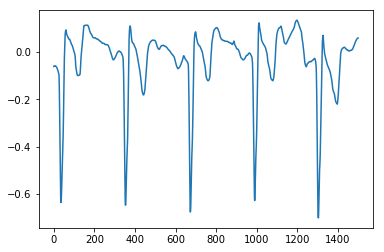

A01241
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


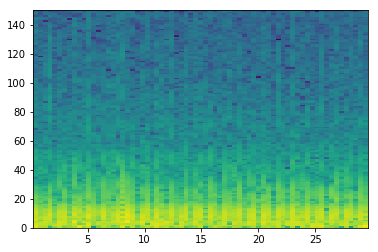

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


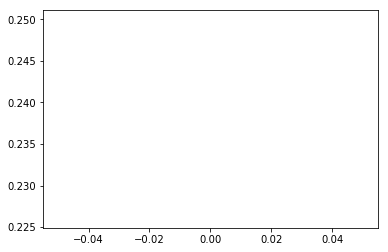

A01245
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


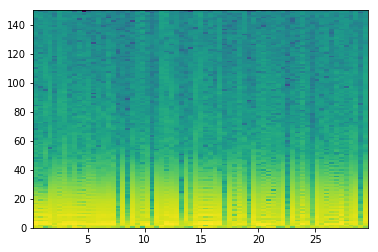

good List
[17, 19, 24, 30, 37, 52, 57, 67]
[2, 5, 6, 7, 15, 5, 10]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


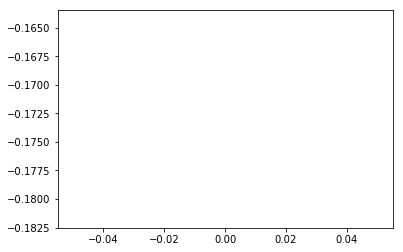

A01250
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

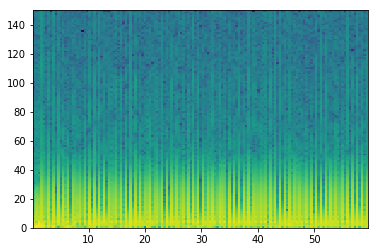

good List
[1, 2, 5, 7, 8, 9, 11, 13, 15, 16, 18, 19, 20, 22, 24, 26, 28, 29, 30, 31, 33, 35, 37, 39, 41, 43, 44, 45, 46, 47, 48, 49, 50, 52, 54, 55, 56, 58, 60, 61, 63, 65, 67, 69, 71, 72, 74, 75, 76, 78, 80, 82, 83, 84, 86, 87, 88, 90, 91, 92, 93, 94, 95, 96, 97, 99, 101, 103, 104, 105, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 118, 120, 122, 123, 124, 125, 127, 129, 130, 131, 133, 135, 137, 138]
[1, 3, 2, 1, 1, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 2, 1]
the temp 3
[[1], [], [4, 5], [], [], [9], [11, 12], [], [], [], [17, 18, 19], [], [], [], [], [], [26, 27, 28, 29, 30, 31, 32], [], [35, 36], [], [39], [], [], [], [], [45], [47, 48], [], [], [52, 53], [55, 56], [58, 59, 60, 61, 62, 63, 64], [], [], [68, 69], [71, 72, 73, 74, 75, 76, 77, 78, 79], [], [], [83, 

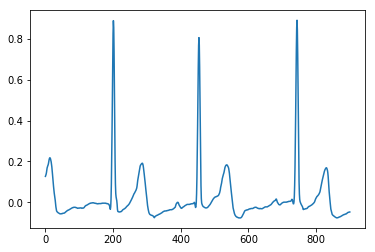

A01251
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


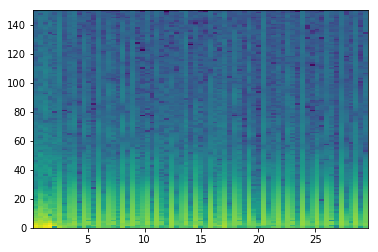

good List
[6, 7, 9, 11, 12, 14, 17, 19, 22, 24, 27, 29, 30, 32, 34, 35, 36, 40, 43, 45, 46, 48, 49, 51, 54, 56, 57, 59, 60, 61, 62, 64, 65, 67, 68]
[1, 2, 2, 1, 2, 3, 2, 3, 2, 3, 2, 1, 2, 2, 1, 1, 4, 3, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 1, 1, 2, 1, 2, 1]
the temp 3
[[1], [], [4], [], [], [], [], [], [], [12], [], [15, 16], [], [], [20], [22], [], [], [26], [28, 29, 30], [32]]
[59, 60, 61, 62]
longest
[59, 60, 61, 62]
indexList
[59, 60, 61, 62]
theMin
7500
theMax
7800


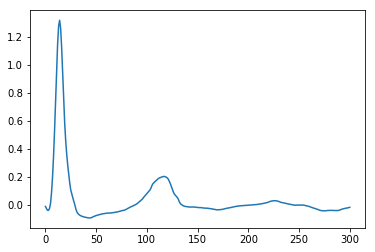

A01252
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


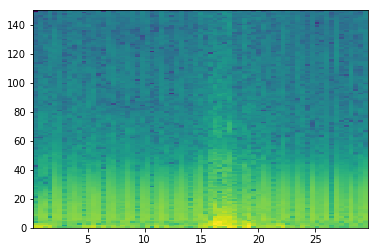

good List
[56, 61]
[5]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


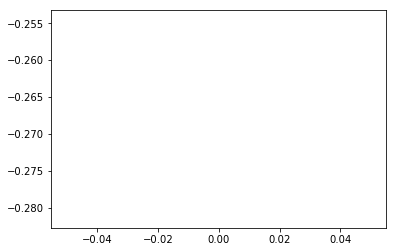

A01263
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

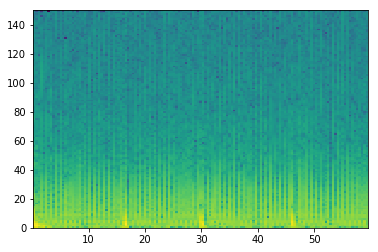

good List
[4, 6, 8, 10, 12, 14, 15, 16, 20, 22, 24, 26, 28, 29, 30, 32, 34, 37, 39, 40, 41, 43, 45, 49, 51, 53, 55, 57, 59, 60, 61, 67, 71, 72, 75, 76, 78, 80, 82, 84, 87, 91, 93, 95, 97, 99, 101, 102, 103, 105, 111, 114, 116, 118, 120, 121, 123, 125, 127, 129, 131, 136]
[2, 2, 2, 2, 2, 1, 1, 4, 2, 2, 2, 2, 1, 1, 2, 2, 3, 2, 1, 1, 2, 2, 4, 2, 2, 2, 2, 2, 1, 1, 6, 4, 1, 3, 1, 2, 2, 2, 2, 3, 4, 2, 2, 2, 2, 2, 1, 1, 2, 6, 3, 2, 2, 2, 1, 2, 2, 2, 2, 2, 5]
the temp 3
[[], [], [], [], [], [6, 7], [], [], [], [], [13, 14], [], [], [], [19, 20], [], [], [], [], [], [], [], [29, 30], [], [33], [35], [], [], [], [], [], [], [], [], [], [], [47, 48], [], [], [], [], [], [55], [], [], [], [], []]
[14, 15, 16]
longest
[14, 15, 16]
indexList
[14, 15, 16]
theMin
1800
theMax
2100


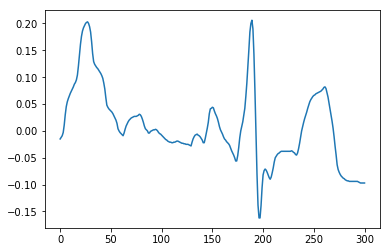

A01274
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

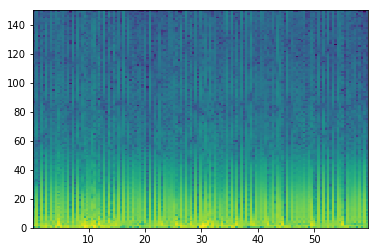

good List
[0, 2, 6, 8, 15, 17, 28, 30, 34, 38, 40, 47, 49, 62, 66, 68, 81, 83, 85, 87, 91, 104, 106, 117, 119, 121, 123, 125, 129, 134, 136, 138]
[2, 4, 2, 7, 2, 11, 2, 4, 4, 2, 7, 2, 13, 4, 2, 13, 2, 2, 2, 4, 13, 2, 11, 2, 2, 2, 2, 4, 5, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


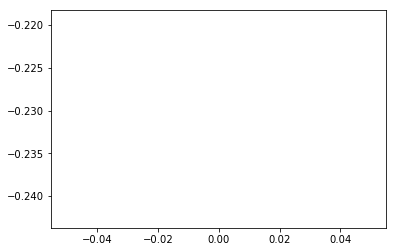

A01279
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

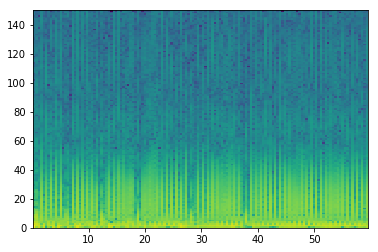

good List
[2, 4, 6, 8, 12, 13, 15, 17, 19, 21, 23, 27, 29, 30, 32, 34, 36, 38, 39, 42, 44, 45, 46, 47, 52, 54, 58, 60, 62, 64, 66, 67, 69, 71, 73, 75, 76, 77, 78, 84, 86, 87, 89, 91, 93, 95, 97, 99, 101, 103, 105, 107, 108, 116, 118, 120, 124, 126, 127, 131, 133, 135, 137]
[2, 2, 2, 4, 1, 2, 2, 2, 2, 2, 4, 2, 1, 2, 2, 2, 2, 1, 3, 2, 1, 1, 1, 5, 2, 4, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 6, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 8, 2, 2, 4, 2, 1, 4, 2, 2, 2]
the temp 3
[[], [], [], [], [5], [], [], [], [], [], [], [13], [], [], [], [18], [], [21, 22, 23], [], [], [], [], [], [], [31], [], [], [], [36, 37, 38], [], [41], [], [], [], [], [], [], [], [], [], [52], [], [], [], [], [58], [], [], []]
[44, 45, 46, 47]
longest
[44, 45, 46, 47]
indexList
[44, 45, 46, 47]
theMin
5700
theMax
6000


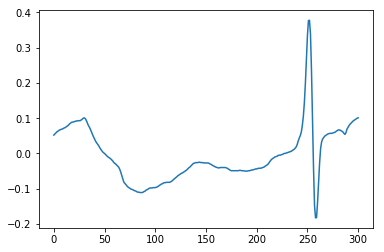

A01280
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


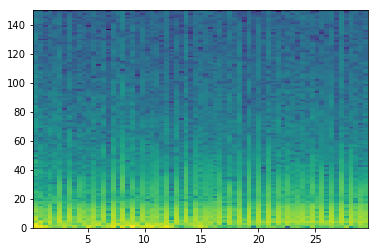

good List
[15, 26, 28, 30, 32, 39, 43, 47, 62]
[11, 2, 2, 2, 7, 4, 4, 15]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


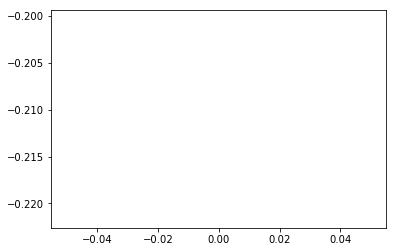

A01281
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


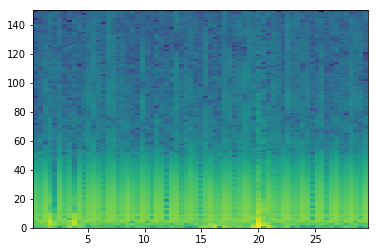

good List
[4, 8, 27, 30, 60]
[4, 19, 3, 30]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


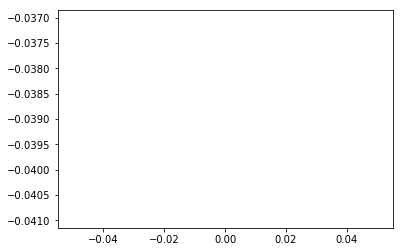

A01286
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


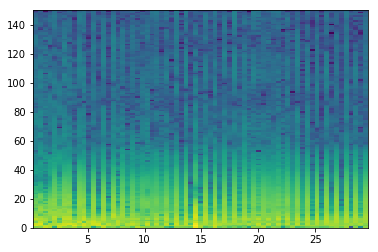

good List
[8, 11, 13, 15, 21, 28, 30, 32, 34, 36, 38, 40, 53, 55, 57, 59, 61, 63, 65, 67]
[3, 2, 2, 6, 7, 2, 2, 2, 2, 2, 2, 13, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


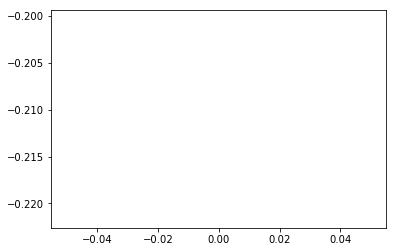

A01288
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


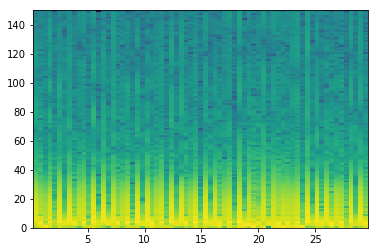

good List
[2, 4, 6, 8, 9, 11, 13, 15, 17, 18, 20, 22, 27, 29, 32, 34, 36, 39, 41, 43, 53, 55, 57, 59, 64, 66, 68]
[2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 5, 2, 3, 2, 2, 3, 2, 2, 10, 2, 2, 2, 5, 2, 2]
the temp 3
[[], [], [], [4], [], [], [], [9], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[8, 9]
longest
[8, 9]
indexList
[8, 9]
theMin
900
theMax
1200


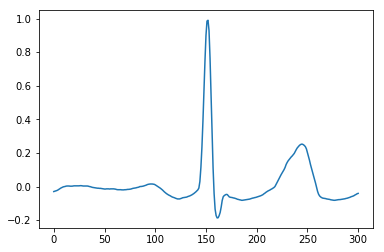

A01291
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6       ]


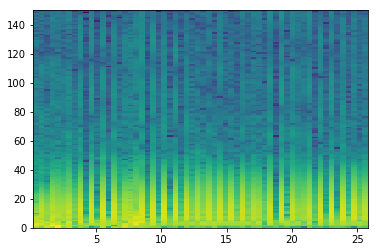

good List
[2, 7, 9, 11, 13, 20, 22, 24, 26, 34, 35, 36, 38, 43, 48, 50, 52, 54, 56, 57, 58]
[5, 2, 2, 2, 7, 2, 2, 2, 8, 1, 1, 2, 5, 5, 2, 2, 2, 2, 1, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [10, 11], [], [], [], [], [], []]
[34, 35, 36]
longest
[34, 35, 36]
indexList
[34, 35, 36]
theMin
4200
theMax
4500


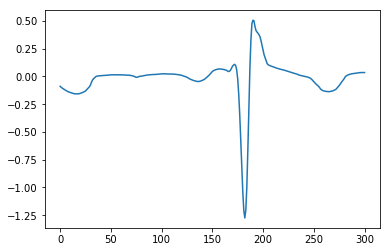

A01292
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


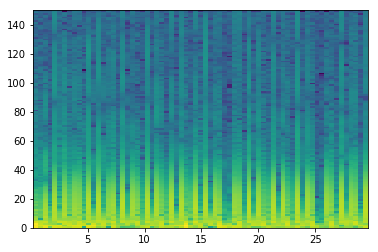

good List
[3, 10, 12, 17, 19, 22, 24, 26, 27, 29, 32, 36, 37, 39, 40, 43, 45, 48, 50, 52, 53, 55, 58, 59, 62, 64, 67]
[7, 2, 5, 2, 3, 2, 2, 1, 2, 3, 4, 1, 2, 1, 3, 2, 3, 2, 2, 1, 2, 3, 1, 3, 2, 3]
the temp 3
[[], [], [], [], [], [], [], [8], [], [], [12], [14], [], [], [], [], [20], [], [23], [], []]
[26, 27]
longest
[26, 27]
indexList
[26, 27]
theMin
3300
theMax
3600


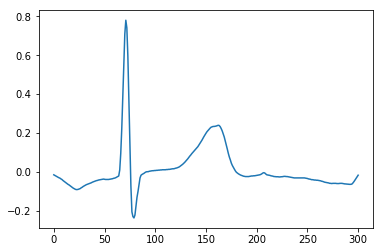

A01294
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


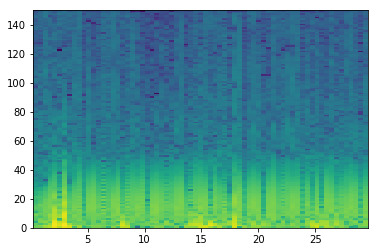

good List
[24, 43]
[19]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


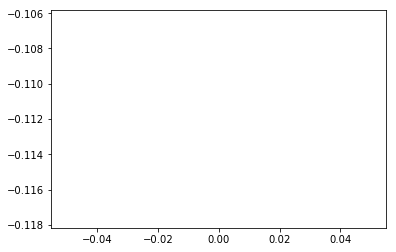

A01295
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


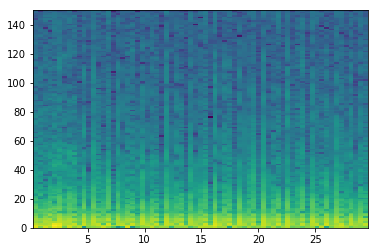

good List
[9, 11, 14, 16, 18, 23, 25, 26, 28, 31, 33, 34, 36, 41, 42, 43, 44, 46, 48, 51, 53, 56, 58, 59, 61, 66]
[2, 3, 2, 2, 5, 2, 1, 2, 3, 2, 1, 2, 5, 1, 1, 1, 2, 2, 3, 2, 3, 2, 1, 2, 5]
the temp 3
[[], [], [], [], [], [], [7], [], [], [11], [], [14, 15, 16], [], [], [], [], [], [23], []]
[41, 42, 43, 44]
longest
[41, 42, 43, 44]
indexList
[41, 42, 43, 44]
theMin
5100
theMax
5700


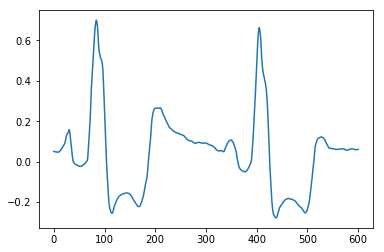

A01298
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


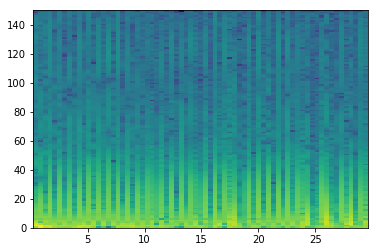

good List
[4, 6, 8, 10, 22, 27, 29, 31, 34, 36, 42, 43, 45, 49, 51, 57, 58, 61, 62, 64, 66]
[2, 2, 2, 12, 5, 2, 2, 3, 2, 6, 1, 2, 4, 2, 6, 1, 3, 1, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [11], [], [], [], [16], [18], []]
[42, 43]
longest
[42, 43]
indexList
[42, 43]
theMin
5400
theMax
5700


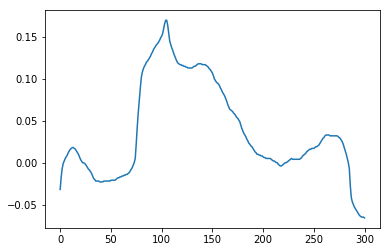

A01300
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

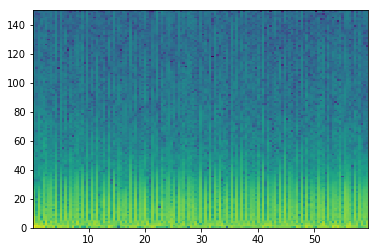

good List
[10, 12, 14, 21, 23, 27, 28, 30, 32, 34, 38, 39, 41, 43, 44, 48, 52, 54, 58, 59, 60, 68, 72, 74, 81, 85, 87, 92, 94, 96, 99, 100, 103, 105, 107, 108, 110, 112, 114, 117, 121, 123, 128, 130, 132]
[2, 2, 7, 2, 4, 1, 2, 2, 2, 4, 1, 2, 2, 1, 4, 4, 2, 4, 1, 1, 8, 4, 2, 7, 4, 2, 5, 2, 2, 3, 1, 3, 2, 2, 1, 2, 2, 2, 3, 4, 2, 5, 2, 2]
the temp 3
[[], [], [], [], [], [6], [], [], [], [11], [], [14], [], [], [], [19, 20], [], [], [], [], [], [], [], [], [], [31], [], [], [35], [], [], [], [], [], [], [], []]
[58, 59, 60]
longest
[58, 59, 60]
indexList
[58, 59, 60]
theMin
7500
theMax
7800


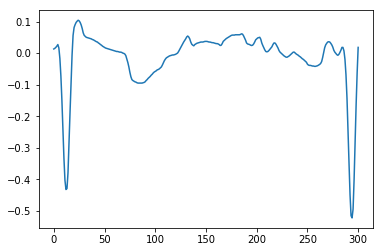

A01304
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

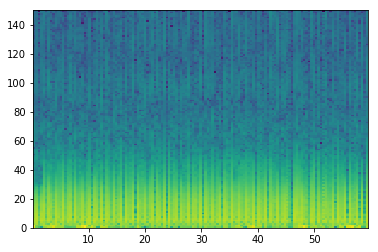

good List
[2, 5, 18, 21, 24, 47, 55, 60, 70, 78, 102, 107, 137]
[3, 13, 3, 3, 23, 8, 5, 10, 8, 24, 5, 30]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


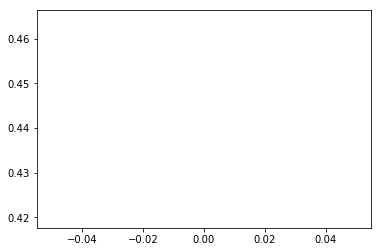

A01308
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


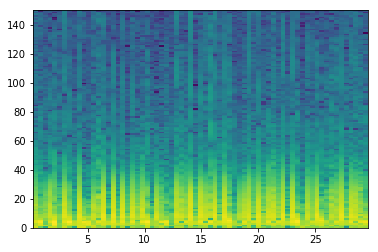

good List
[2, 5, 8, 10, 11, 17, 19, 24, 28, 33, 42, 47, 55]
[3, 3, 2, 1, 6, 2, 5, 4, 5, 9, 5, 8]
the temp 3
[[], [], [], [4], [], [], [], [], [], [], []]
[10, 11]
longest
[10, 11]
indexList
[10, 11]
theMin
1200
theMax
1500


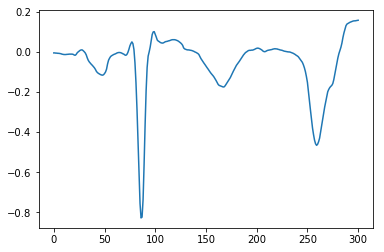

A01310
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667]


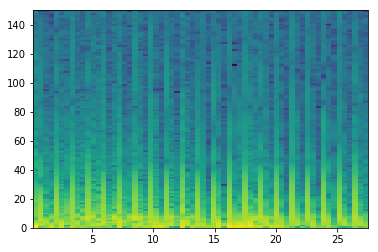

good List
[8, 12, 14, 17, 21, 24, 27, 30, 33, 35, 36, 38, 45, 47, 48, 50, 51, 54, 56, 57, 59, 60, 62, 63]
[4, 2, 3, 4, 3, 3, 3, 3, 2, 1, 2, 7, 2, 1, 2, 1, 3, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [10], [], [], [14], [16], [], [19], [21]]
[35, 36]
longest
[35, 36]
indexList
[35, 36]
theMin
4500
theMax
4800


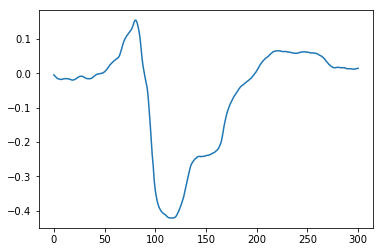

A01316
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


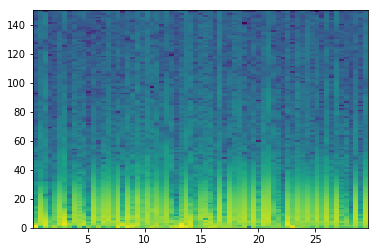

good List
[0, 3, 4, 7, 8, 9, 10, 11, 12, 13, 16, 18, 22, 29, 30, 37, 39, 40, 41, 43, 44, 45, 46, 50, 51, 52, 53, 55, 56, 57, 59, 61, 62, 63, 64, 65, 67]
[3, 1, 3, 1, 1, 1, 1, 1, 1, 3, 2, 4, 7, 1, 7, 2, 1, 1, 2, 1, 1, 1, 4, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 2]
the temp 3
[[], [2], [4, 5, 6, 7, 8, 9], [], [], [], [14], [], [17, 18], [20, 21, 22], [24, 25, 26], [28, 29], [], [32, 33, 34, 35]]
[7, 8, 9, 10, 11, 12, 13]
longest
[7, 8, 9, 10, 11, 12, 13]
indexList
[7, 8, 9, 10, 11, 12, 13]
theMin
900
theMax
1500


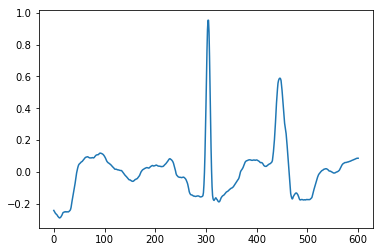

A01317
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


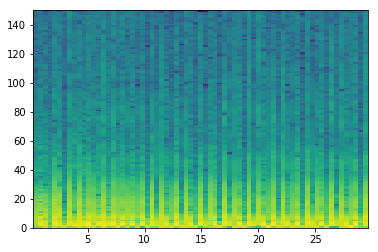

good List
[0, 3, 6, 12, 15, 17, 19, 21, 23, 28, 30, 33, 35, 38, 40, 43, 45, 50, 52, 53, 55, 60, 62, 67]
[3, 3, 6, 3, 2, 2, 2, 2, 5, 2, 3, 2, 3, 2, 3, 2, 5, 2, 1, 2, 5, 2, 5]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [19], [], [], []]
[52, 53]
longest
[52, 53]
indexList
[52, 53]
theMin
6600
theMax
6900


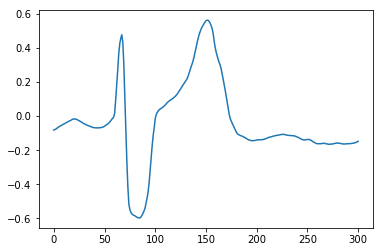

A01318
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

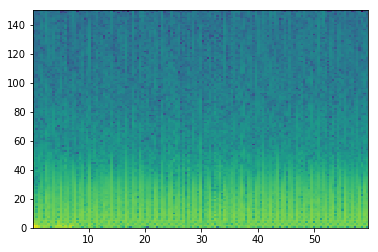

good List
[52]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


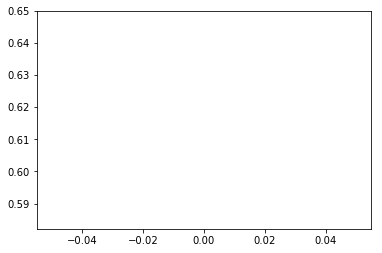

A01322
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


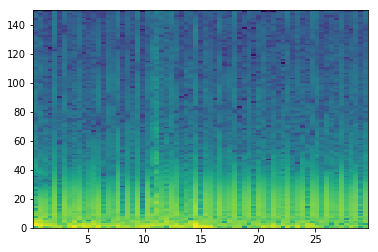

good List
[5, 7, 10, 22, 30, 42, 45]
[2, 3, 12, 8, 12, 3]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


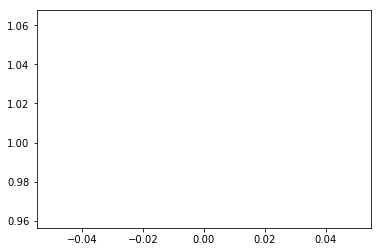

A01327
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


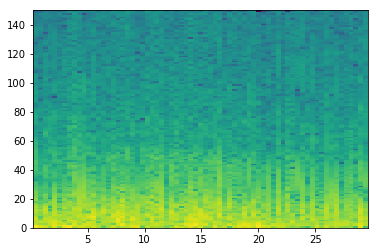

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


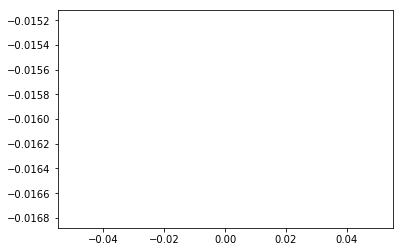

A01332
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


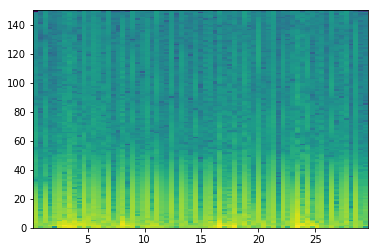

good List
[1, 3, 4, 16, 19, 21, 22, 26, 27, 29, 31, 32, 34, 35, 36, 37, 39, 47, 50, 52, 60, 62, 65, 67, 68]
[2, 1, 12, 3, 2, 1, 4, 1, 2, 2, 1, 2, 1, 1, 1, 2, 8, 3, 2, 8, 2, 3, 2, 1]
the temp 3
[[], [2], [], [], [6], [8], [], [11], [13, 14, 15], [], [], [], [], [], [], []]
[34, 35, 36, 37]
longest
[34, 35, 36, 37]
indexList
[34, 35, 36, 37]
theMin
4200
theMax
4800


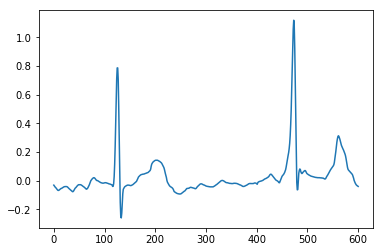

A01333
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


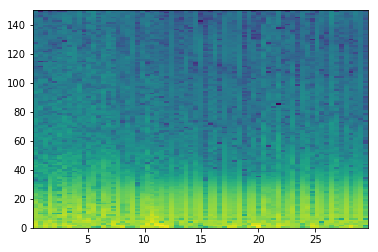

good List
[34, 35, 43, 68]
[1, 8, 25]
the temp 3
[[1], []]
[34, 35]
longest
[34, 35]
indexList
[34, 35]
theMin
4200
theMax
4500


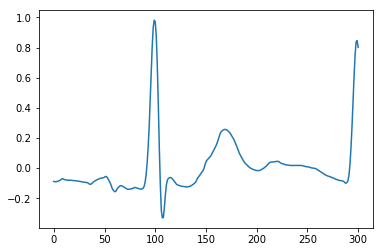

A01334
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

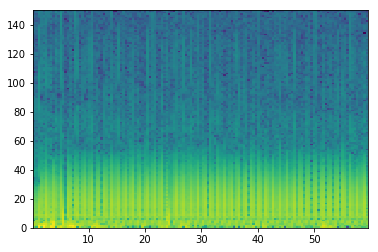

good List
[0, 1, 8, 10, 13, 16, 19, 22, 25, 28, 29, 30, 31, 33, 39, 42, 48, 51, 54, 56, 63, 72, 83, 86, 89, 92, 95, 98, 104, 109, 112, 115, 121, 124, 127, 134, 135]
[1, 7, 2, 3, 3, 3, 3, 3, 3, 1, 1, 1, 2, 6, 3, 6, 3, 3, 2, 7, 9, 11, 3, 3, 3, 3, 3, 6, 5, 3, 3, 6, 3, 3, 7, 1]
the temp 3
[[1], [], [], [], [], [], [], [], [10, 11, 12], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[28, 29, 30, 31]
longest
[28, 29, 30, 31]
indexList
[28, 29, 30, 31]
theMin
3600
theMax
3900


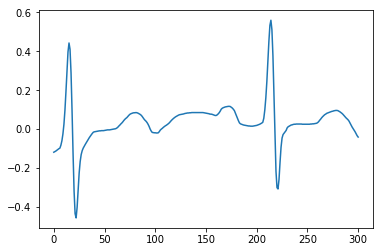

A01338
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


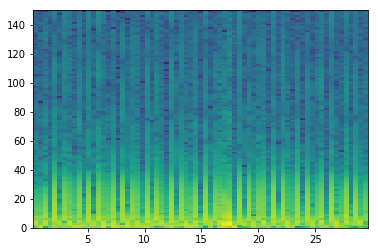

good List
[0, 1, 3, 5, 8, 10, 12, 15, 17, 19, 22, 24, 27, 32, 34, 36, 41, 42, 43, 45, 48, 50, 53, 55, 57, 58, 60, 62, 63, 65, 67, 68]
[1, 2, 2, 3, 2, 2, 3, 2, 2, 3, 2, 3, 5, 2, 2, 5, 1, 1, 2, 3, 2, 3, 2, 2, 1, 2, 2, 1, 2, 2, 1]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [17, 18], [], [], [], [], [], [25], [], [28], []]
[41, 42, 43]
longest
[41, 42, 43]
indexList
[41, 42, 43]
theMin
5100
theMax
5400


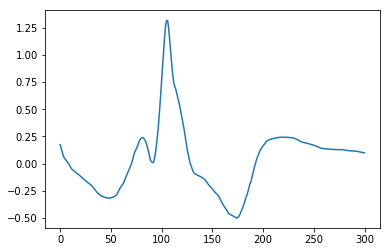

A01340
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


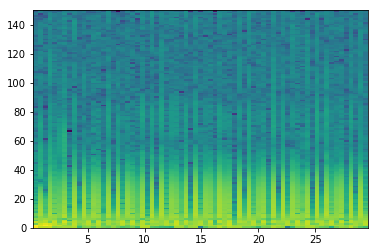

good List
[0, 2, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 61, 62, 63, 64, 65, 66, 67, 68]
[2, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[], [], [3], [5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], [20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55]]
[23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59]
longest
[23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59]
indexList
[23, 24, 2

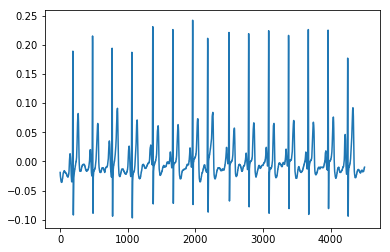

A01343
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


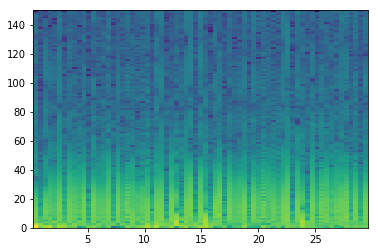

good List
[1, 2, 6, 11, 13, 16, 18, 24, 27, 33, 36, 39, 41, 42, 44, 65, 67]
[1, 4, 5, 2, 3, 2, 6, 3, 6, 3, 3, 2, 1, 2, 21, 2]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [13], [], []]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


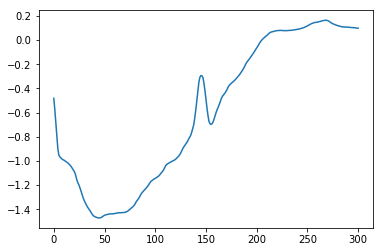

A01345
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


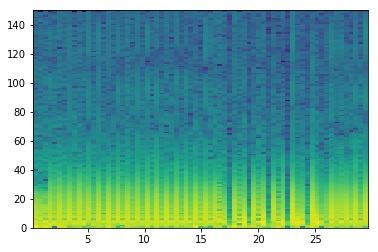

good List
[44, 48, 52, 56, 59, 60, 64]
[4, 4, 4, 3, 1, 4]
the temp 3
[[], [], [], [], [5]]
[59, 60]
longest
[59, 60]
indexList
[59, 60]
theMin
7500
theMax
7800


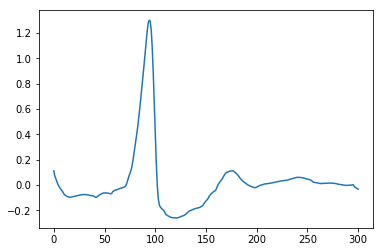

A01350
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

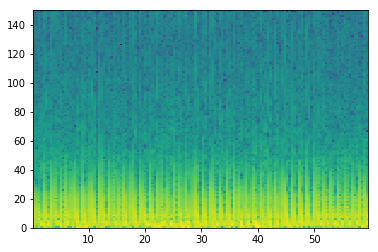

good List
[26, 36, 72]
[10, 36]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


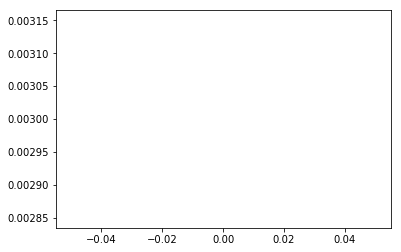

A01352
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


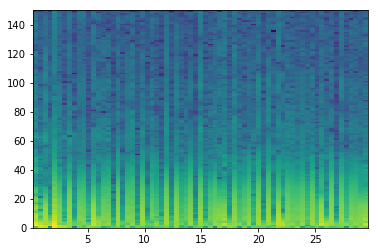

good List
[8, 11, 16, 18, 21, 23, 26, 28, 31, 33, 35, 36, 40, 42, 45, 47, 58, 62, 64, 66, 67]
[3, 5, 2, 3, 2, 3, 2, 3, 2, 2, 1, 4, 2, 3, 2, 11, 4, 2, 2, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [11], [], [], [], [], [], [], []]
[35, 36]
longest
[35, 36]
indexList
[35, 36]
theMin
4500
theMax
4800


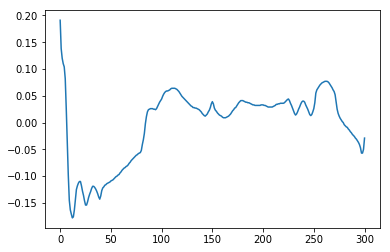

A01354
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


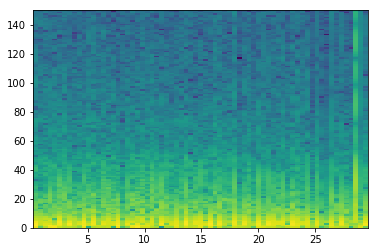

good List
[42, 59, 60]
[17, 1]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


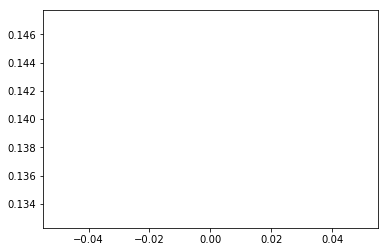

A01356
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


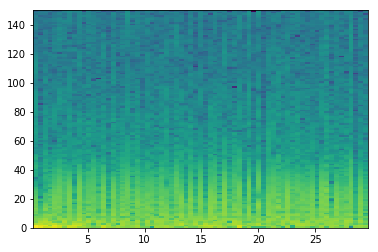

good List
[1, 3, 17, 22, 28, 45, 47, 58, 66, 68]
[2, 14, 5, 6, 17, 2, 11, 8, 2]
the temp 3
[[], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


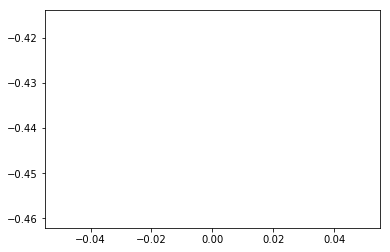

A01357
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


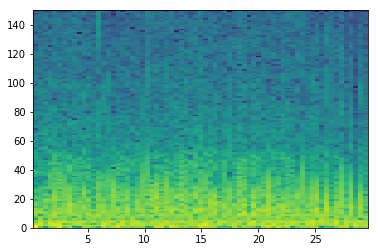

good List
[64]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


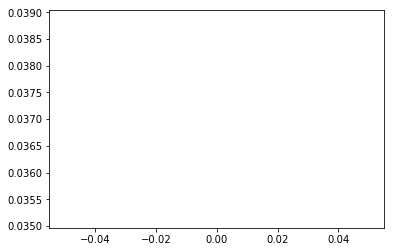

A01365
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333]


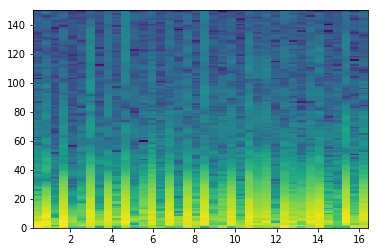

good List
[2, 4, 7, 9, 11, 12, 14, 16, 18, 27, 30, 33, 34]
[2, 3, 2, 2, 1, 2, 2, 2, 9, 3, 3, 1]
the temp 3
[[], [], [], [], [5], [], [], [], [], []]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


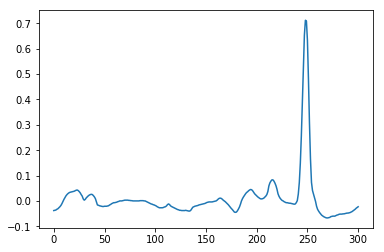

A01366
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


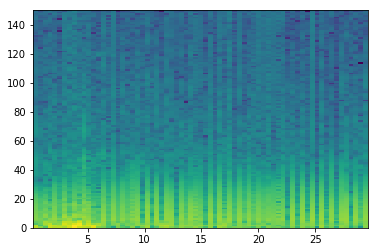

good List
[17, 37, 41, 49, 58, 62, 65]
[20, 4, 8, 9, 4, 3]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


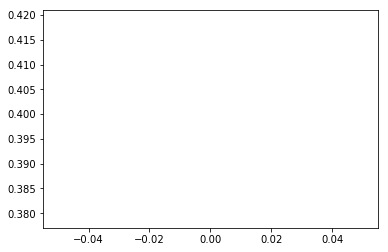

A01373
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

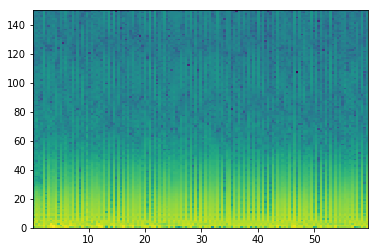

good List
[0, 17, 23, 32, 34, 36, 49, 66, 68, 70, 82, 88, 90, 92, 96, 98, 109, 111, 116, 118, 120, 122, 124, 126, 128, 135, 137]
[17, 6, 9, 2, 2, 13, 17, 2, 2, 12, 6, 2, 2, 4, 2, 11, 2, 5, 2, 2, 2, 2, 2, 2, 7, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


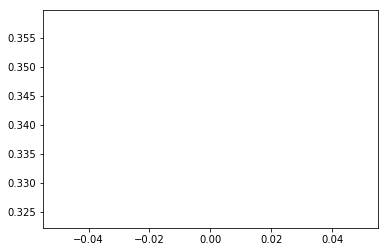

A01375
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

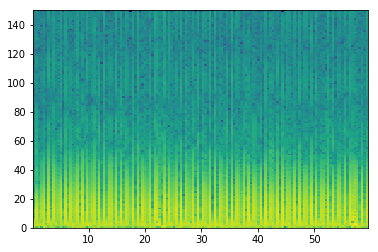

good List
[0, 2, 3, 5, 7, 9, 12, 14, 16, 17, 19, 21, 23, 26, 28, 30, 33, 39, 40, 42, 44, 45, 46, 49, 55, 57, 58, 60, 62, 69, 72, 74, 76, 79, 81, 83, 86, 90, 92, 93, 95, 97, 100, 102, 105, 107, 109, 111, 112, 113, 114, 116, 118, 123, 125, 126, 128, 130, 135, 137]
[2, 1, 2, 2, 2, 3, 2, 2, 1, 2, 2, 2, 3, 2, 2, 3, 6, 1, 2, 2, 1, 1, 3, 6, 2, 1, 2, 2, 7, 3, 2, 2, 3, 2, 2, 3, 4, 2, 1, 2, 2, 3, 2, 3, 2, 2, 2, 1, 1, 1, 2, 2, 5, 2, 1, 2, 2, 5, 2]
the temp 3
[[], [2], [], [], [], [], [], [9], [], [], [], [], [], [], [], [18], [], [21, 22], [], [], [26], [], [], [], [], [], [], [], [], [], [], [], [39], [], [], [], [], [], [], [], [48, 49, 50], [], [], [], [55], [], [], []]
[111, 112, 113, 114]
longest
[111, 112, 113, 114]
indexList
[111, 112, 113, 114]
theMin
14100
theMax
14700


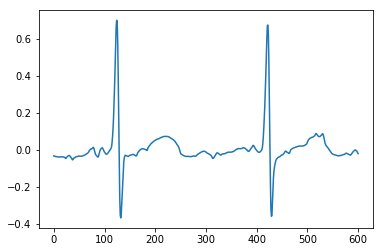

A01394
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


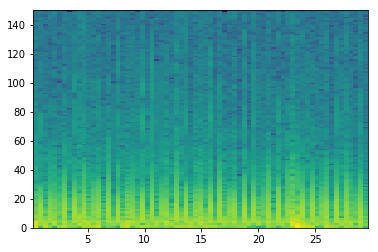

good List
[5, 11, 12, 14, 16, 18, 20, 25, 28, 32, 37, 40, 42, 44, 46, 47, 49, 51, 59, 61, 65, 66, 68]
[6, 1, 2, 2, 2, 2, 5, 3, 4, 5, 3, 2, 2, 2, 1, 2, 2, 8, 2, 4, 1, 2]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [], [], [], [15], [], [], [], [], [21]]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


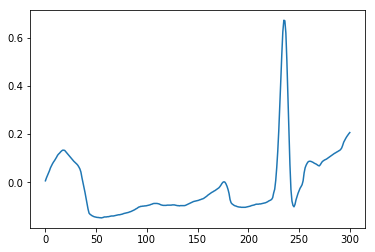

A01400
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


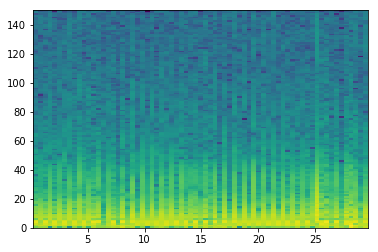

good List
[1, 2, 3, 4, 5, 7, 8, 11, 12, 14, 15, 17, 19, 21, 23, 27, 31, 32, 33, 34, 36, 37, 38, 40, 42, 43, 44, 46, 48, 50, 52, 53, 54, 57, 61, 63, 67]
[1, 1, 1, 1, 2, 1, 3, 1, 2, 1, 2, 2, 2, 2, 4, 4, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1, 1, 3, 4, 2, 4]
the temp 3
[[1, 2, 3, 4], [6], [8], [10], [], [], [], [], [], [17, 18, 19], [21, 22], [], [25, 26], [], [], [], [31, 32], [], [], []]
[1, 2, 3, 4, 5]
longest
[1, 2, 3, 4, 5]
indexList
[1, 2, 3, 4, 5]
theMin
0
theMax
600


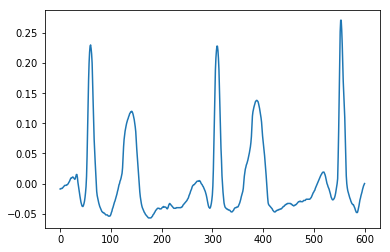

A01407
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


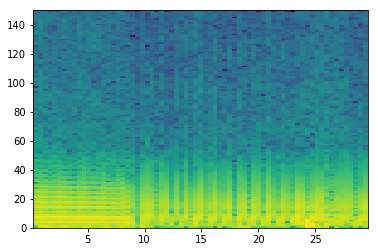

good List
[21, 25, 30, 32, 38, 39, 41, 42, 47, 49, 52, 55, 66]
[4, 5, 2, 6, 1, 2, 1, 5, 2, 3, 3, 11]
the temp 3
[[], [], [], [], [5], [7], [], [], [], []]
[38, 39]
longest
[38, 39]
indexList
[38, 39]
theMin
4800
theMax
5100


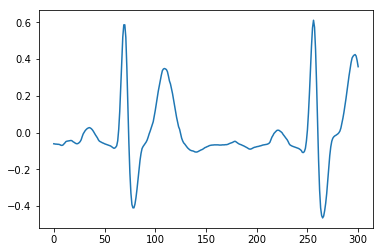

A01410
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


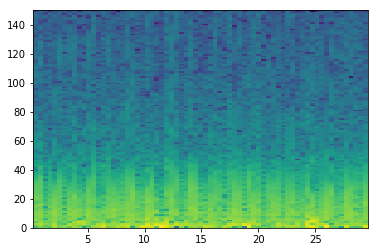

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


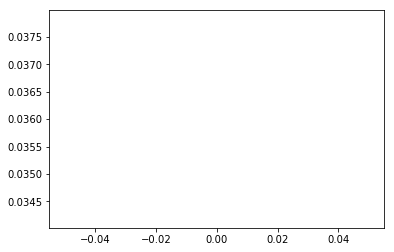

A01412
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


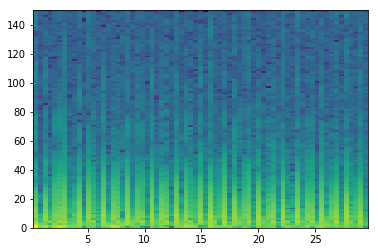

good List
[1, 2, 3, 4, 7, 8, 10, 12, 13, 15, 17, 18, 20, 21, 22, 23, 25, 26, 27, 28, 30, 31, 32, 33, 35, 36, 37, 38, 40, 42, 43, 44, 45, 47, 50, 52, 53, 54, 55, 58, 60, 61, 62, 63, 65, 66, 68]
[1, 1, 1, 3, 1, 2, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 3, 2, 1, 1, 1, 3, 2, 1, 1, 1, 2, 1, 2]
the temp 3
[[1, 2, 3], [5], [], [8], [], [11], [13, 14, 15], [17, 18, 19], [21, 22, 23], [25, 26, 27], [], [30, 31, 32], [], [], [36, 37, 38], [], [41, 42, 43], [45]]
[1, 2, 3, 4]
longest
[1, 2, 3, 4]
indexList
[1, 2, 3, 4]
theMin
0
theMax
600


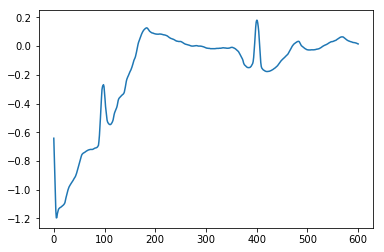

A01413
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


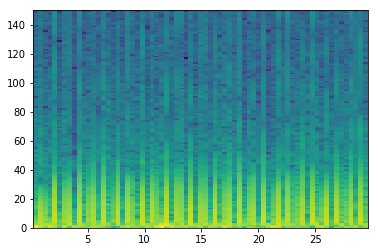

good List
[5, 7, 8, 10, 16, 18, 21, 23, 28, 31, 33, 35, 36, 41, 43, 46, 48, 56, 59, 61]
[2, 1, 2, 6, 2, 3, 2, 5, 3, 2, 2, 1, 5, 2, 3, 2, 8, 3, 2]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [12], [], [], [], [], [], []]
[7, 8]
longest
[7, 8]
indexList
[7, 8]
theMin
900
theMax
1200


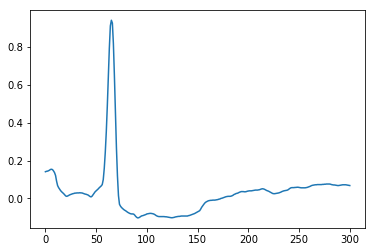

A01414
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

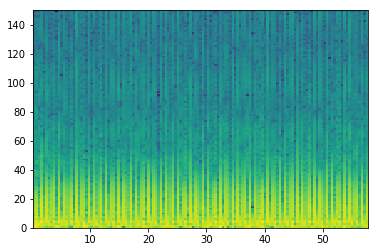

good List
[11, 13, 14, 16, 23, 30, 33, 38, 47, 50, 52, 54, 57, 64, 67, 69, 74, 79, 88, 98, 105, 112, 114, 117, 124, 133]
[2, 1, 2, 7, 7, 3, 5, 9, 3, 2, 2, 3, 7, 3, 2, 5, 5, 9, 10, 7, 7, 2, 3, 7, 9]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[13, 14]
longest
[13, 14]
indexList
[13, 14]
theMin
1500
theMax
1800


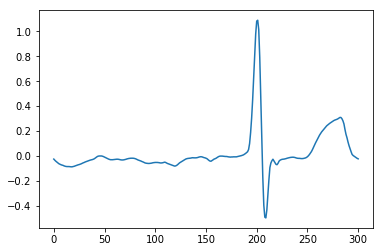

A01418
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


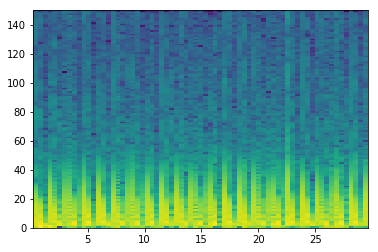

good List
[9, 12, 22, 25, 54, 57, 67]
[3, 10, 3, 29, 3, 10]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


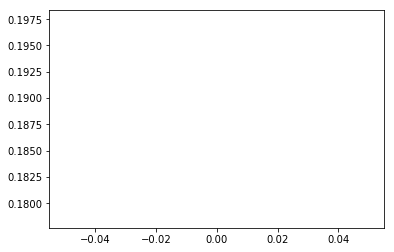

A01419
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

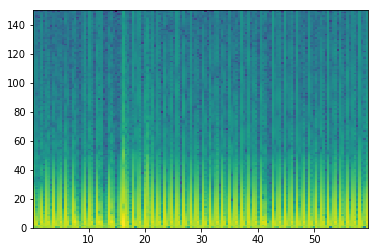

good List
[2, 4, 7, 12, 15, 18, 19, 20, 22, 25, 29, 30, 33, 34, 35, 45, 50, 53, 55, 56, 58, 61, 63, 64, 66, 69, 72, 77, 80, 83, 85, 88, 90, 93, 97, 98, 100, 103, 105, 108, 113, 115, 116, 118, 121, 123, 124, 126, 129, 131, 134, 137]
[2, 3, 5, 3, 3, 1, 1, 2, 3, 4, 1, 3, 1, 1, 10, 5, 3, 2, 1, 2, 3, 2, 1, 2, 3, 3, 5, 3, 3, 2, 3, 2, 3, 4, 1, 2, 3, 2, 3, 5, 2, 1, 2, 3, 2, 1, 2, 3, 2, 3, 3]
the temp 3
[[], [], [], [], [], [6, 7], [], [], [11], [13, 14], [], [], [], [19], [], [], [23], [], [], [], [], [], [], [], [], [], [], [35], [], [], [], [], [], [42], [], [], [46], [], [], [], []]
[18, 19, 20]
longest
[18, 19, 20]
indexList
[18, 19, 20]
theMin
2400
theMax
2700


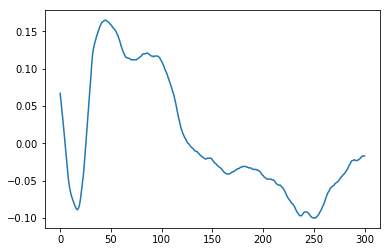

A01424
[ 0.42666667  0.85333333  1.28        1.70666667  2.13333333
  2.56        2.98666667  3.41333333  3.84        4.26666667
  4.69333333  5.12        5.54666667  5.97333333  6.4         6.82666667
  7.25333333  7.68        8.10666667  8.53333333  8.96
  9.38666667]


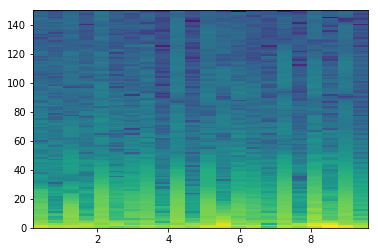

good List
[17]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


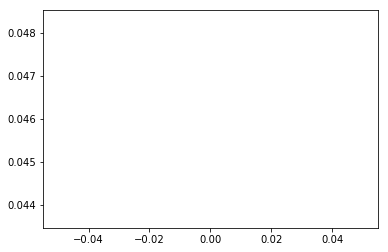

A01436
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


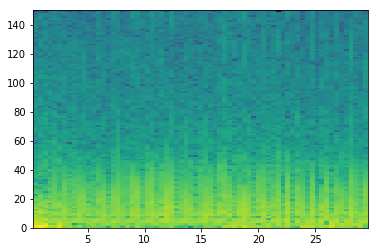

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


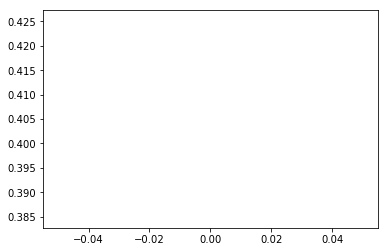

A01438
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


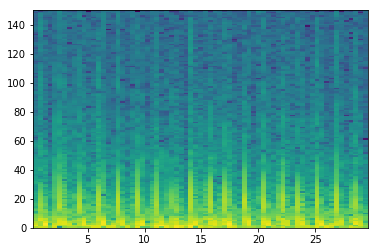

good List
[0, 3, 7, 8, 11, 12, 14, 15, 16, 18, 19, 20, 23, 24, 28, 29, 30, 31, 35, 38, 41, 42, 44, 45, 46, 48, 49, 53, 54, 55, 56, 57, 60, 61, 63, 64, 65, 68]
[3, 4, 1, 3, 1, 2, 1, 1, 2, 1, 1, 3, 1, 4, 1, 1, 1, 4, 3, 3, 1, 2, 1, 1, 2, 1, 4, 1, 1, 1, 1, 3, 1, 2, 1, 1, 3]
the temp 3
[[], [], [3], [5], [7, 8], [10, 11], [13], [15, 16, 17], [], [], [21], [23, 24], [26], [28, 29, 30, 31], [33], [35, 36]]
[53, 54, 55, 56, 57]
longest
[53, 54, 55, 56, 57]
indexList
[53, 54, 55, 56, 57]
theMin
6900
theMax
7200


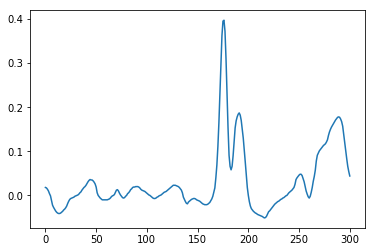

A01452
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


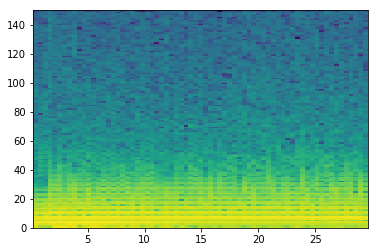

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


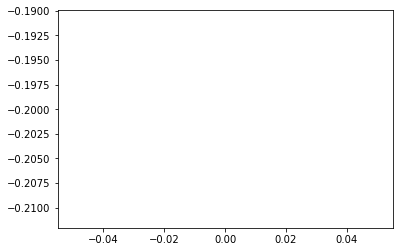

A01454
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


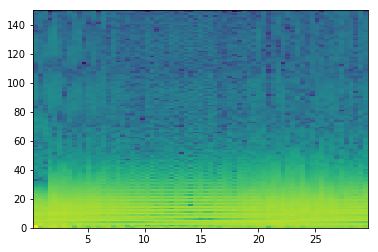

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


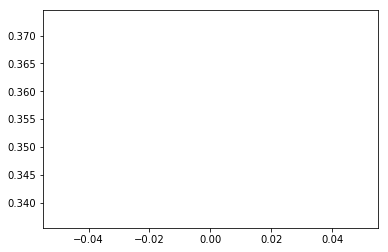

A01458
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

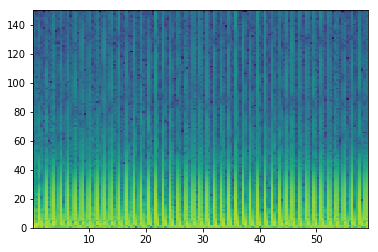

good List
[4, 6, 7, 10, 12, 15, 16, 18, 21, 30, 34, 36, 37, 40, 43, 46, 49, 52, 54, 55, 58, 61, 67, 70, 73, 76, 79, 81, 82, 85, 88, 90, 91, 94, 97, 100, 103, 108, 111, 114, 117, 120, 123, 126, 129, 130, 132, 133]
[2, 1, 3, 2, 3, 1, 2, 3, 9, 4, 2, 1, 3, 3, 3, 3, 3, 2, 1, 3, 3, 6, 3, 3, 3, 3, 2, 1, 3, 3, 2, 1, 3, 3, 3, 3, 5, 3, 3, 3, 3, 3, 3, 3, 1, 2, 1]
the temp 3
[[], [2], [], [], [6], [], [], [], [], [12], [], [], [], [], [], [19], [], [], [], [], [], [], [], [28], [], [], [32], [], [], [], [], [], [], [], [], [], [], [], [45]]
[6, 7]
longest
[6, 7]
indexList
[6, 7]
theMin
600
theMax
900


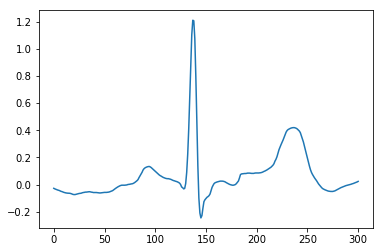

A01459
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

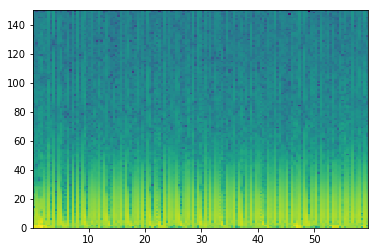

good List
[4, 9, 15, 19, 22, 34, 46, 49, 53, 67, 70, 74, 79, 96, 101, 106, 111, 118, 125, 126]
[5, 6, 4, 3, 12, 12, 3, 4, 14, 3, 4, 5, 17, 5, 5, 5, 7, 7, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


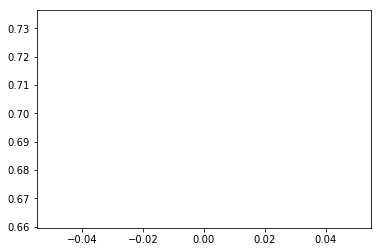

A01460
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


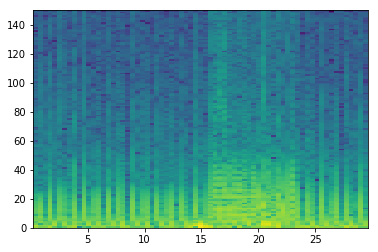

good List
[0, 1, 2, 4, 6, 7, 9, 11, 14, 16, 19, 21, 22, 24, 26, 27, 29, 31, 32, 58, 61, 63, 65, 66, 68]
[1, 1, 2, 2, 1, 2, 2, 3, 2, 3, 2, 1, 2, 2, 1, 2, 2, 1, 26, 3, 2, 2, 1, 2]
the temp 3
[[1, 2], [], [5], [], [], [], [], [], [12], [], [15], [], [18], [], [], [], [23]]
[0, 1, 2]
longest
[0, 1, 2]
indexList
[0, 1, 2]
theMin
0
theMax
300


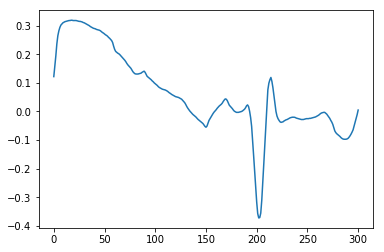

A01461
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


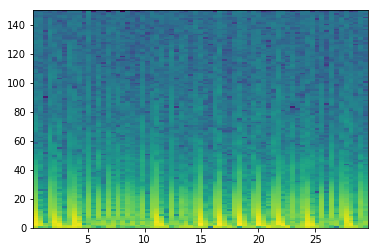

good List
[2, 6, 8, 9, 10, 12, 14, 16, 18, 19, 20, 21, 23, 26, 27, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 43, 44, 46, 47, 48, 51, 52, 54, 55, 56, 58, 60, 62, 65, 66, 68]
[4, 2, 1, 1, 2, 2, 2, 2, 1, 1, 1, 2, 3, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 3, 1, 2, 1, 1, 2, 2, 2, 3, 1, 2]
the temp 3
[[], [], [3, 4], [], [], [], [9, 10, 11], [], [14], [16, 17, 18, 19], [21, 22], [24, 25], [27], [29, 30], [32], [34, 35], [], [], [], [40]]
[29, 30, 31, 32, 33]
longest
[29, 30, 31, 32, 33]
indexList
[29, 30, 31, 32, 33]
theMin
3600
theMax
4200


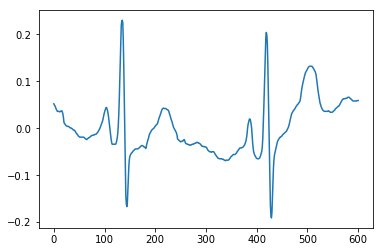

A01466
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

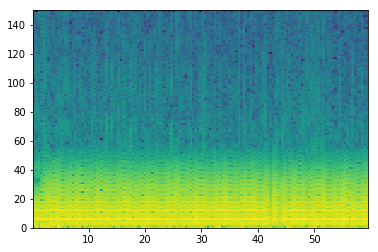

good List
[102]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


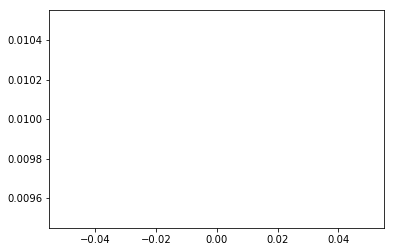

A01469
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

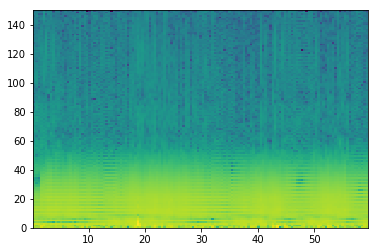

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


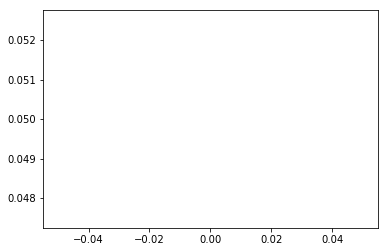

A01471
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


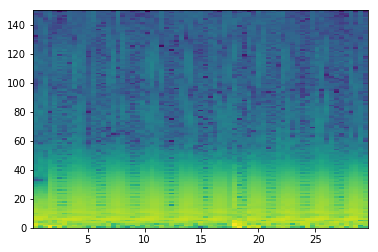

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


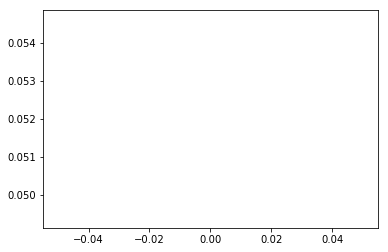

A01473
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


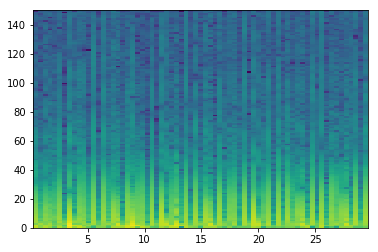

good List
[1, 6, 11, 13, 15, 18, 23, 25, 28, 30, 32, 34, 37, 42, 44, 47, 49, 51, 53, 56, 58, 60, 63, 65, 67]
[5, 5, 2, 2, 3, 5, 2, 3, 2, 2, 2, 3, 5, 2, 3, 2, 2, 2, 3, 2, 2, 3, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


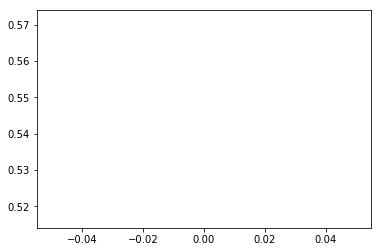

A01474
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


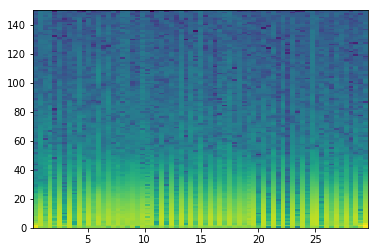

good List
[0, 4, 6, 27, 31, 37, 46, 48, 50, 52, 54, 65]
[4, 2, 21, 4, 6, 9, 2, 2, 2, 2, 11]
the temp 3
[[], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


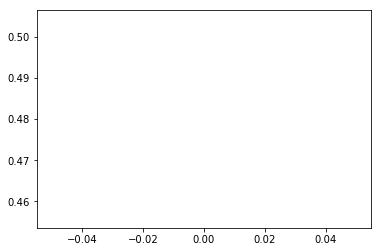

A01475
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


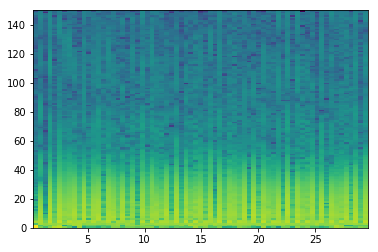

good List
[0, 2, 4, 9, 11, 14, 16, 17, 19, 21, 23, 27, 28, 30, 32, 39, 44, 46, 48, 50, 51, 53, 58, 60, 64, 65, 67]
[2, 2, 5, 2, 3, 2, 1, 2, 2, 2, 4, 1, 2, 2, 7, 5, 2, 2, 2, 1, 2, 5, 2, 4, 1, 2]
the temp 3
[[], [], [], [], [], [], [7], [], [], [], [12], [], [], [], [], [], [], [20], [], [], [], [25]]
[16, 17]
longest
[16, 17]
indexList
[16, 17]
theMin
2100
theMax
2400


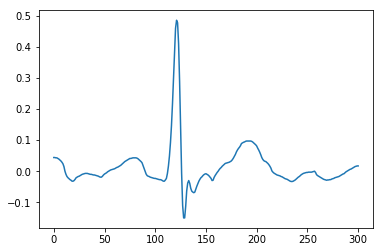

A01476
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333]


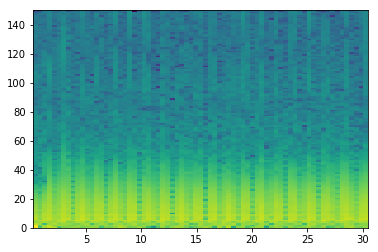

good List
[4, 8, 36, 39, 46, 50, 57]
[4, 28, 3, 7, 4, 7]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


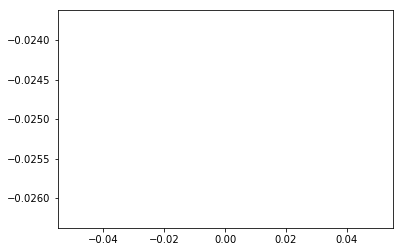

A01477
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


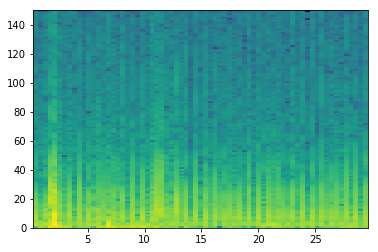

good List
[32]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


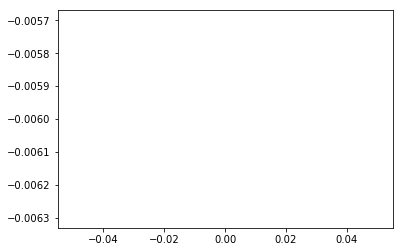

A01478
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


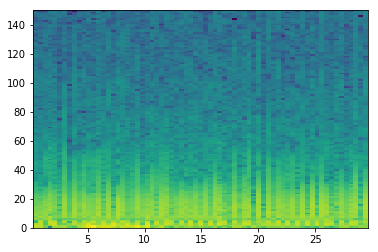

good List
[1, 7, 16, 29, 47, 49, 63]
[6, 9, 13, 18, 2, 14]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


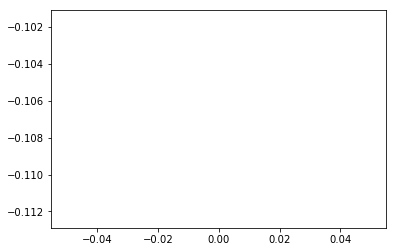

A01484
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333]


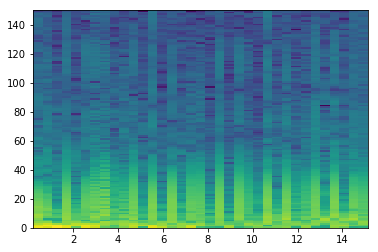

good List
[2, 8, 9, 11, 13, 18, 20, 22, 23, 25, 27, 28]
[6, 1, 2, 2, 5, 2, 2, 1, 2, 2, 1]
the temp 3
[[], [2], [], [], [], [], [8], []]
[8, 9]
longest
[8, 9]
indexList
[8, 9]
theMin
900
theMax
1200


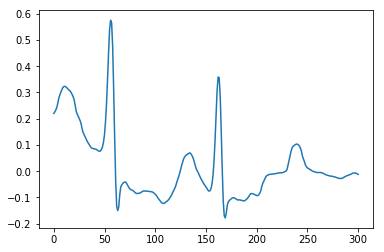

A01487
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

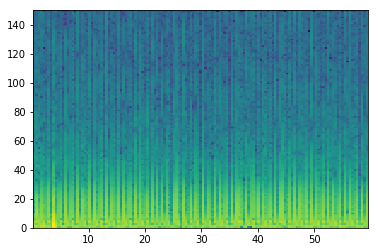

good List
[5, 7, 9, 12, 17, 19, 24, 26, 29, 31, 34, 36, 41, 43, 46, 48, 52, 54, 57, 61, 64, 66, 69, 74, 81, 83, 87, 92, 94, 97, 99, 101, 109, 114, 116, 119, 128, 135]
[2, 2, 3, 5, 2, 5, 2, 3, 2, 3, 2, 5, 2, 3, 2, 4, 2, 3, 4, 3, 2, 3, 5, 7, 2, 4, 5, 2, 3, 2, 2, 8, 5, 2, 3, 9, 7]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


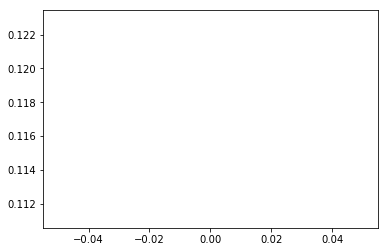

A01494
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


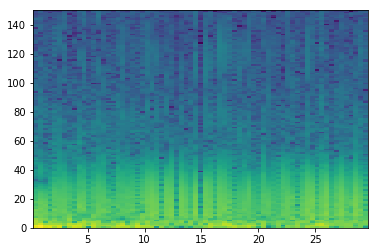

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


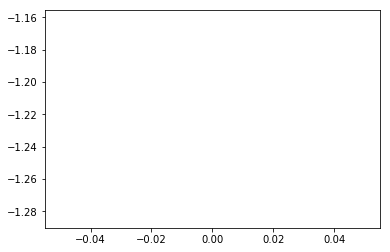

A01498
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


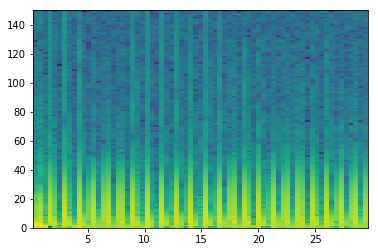

good List
[0, 2, 5, 7, 8, 10, 11, 12, 13, 14, 16, 17, 18, 19, 21, 22, 24, 25, 27, 28, 30, 31, 33, 34, 36, 37, 39, 40, 42, 44, 45, 47, 48, 50, 53, 56, 58, 59, 61, 62, 64, 65, 67, 68]
[2, 3, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [], [], [4], [6, 7, 8, 9], [11, 12, 13], [15], [17], [19], [21], [23], [25], [27], [], [30], [32], [], [], [], [37], [39], [41]]
[10, 11, 12, 13, 14]
longest
[10, 11, 12, 13, 14]
indexList
[10, 11, 12, 13, 14]
theMin
1200
theMax
1800


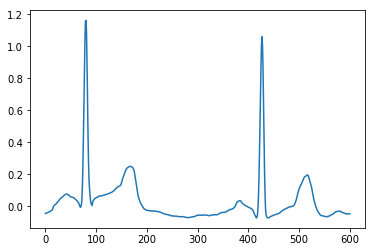

A01505
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


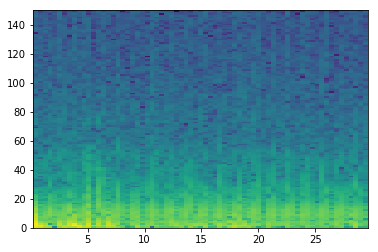

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


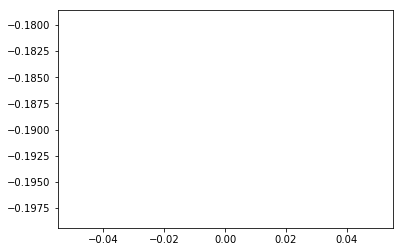

A01510
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


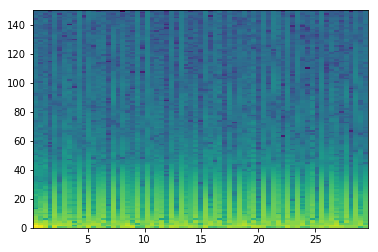

good List
[3, 4, 5, 8, 10, 15, 17, 19, 20, 22, 24, 25, 26, 27, 29, 32, 34, 39, 40, 41, 43, 46, 51, 53, 54, 55, 56, 58, 63, 65, 68]
[1, 1, 3, 2, 5, 2, 2, 1, 2, 2, 1, 1, 1, 2, 3, 2, 5, 1, 1, 2, 3, 5, 2, 1, 1, 1, 2, 5, 2, 3]
the temp 3
[[1, 2], [], [], [], [], [8], [], [11, 12, 13], [], [], [], [18, 19], [], [], [], [24, 25, 26], [], [], []]
[24, 25, 26, 27]
longest
[24, 25, 26, 27]
indexList
[24, 25, 26, 27]
theMin
3000
theMax
3300


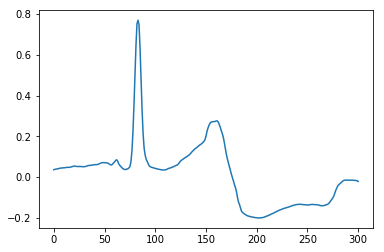

A01515
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

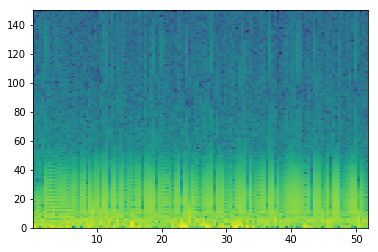

good List
[60, 88, 89, 112]
[28, 1, 23]
the temp 3
[[], [2]]
[88, 89]
longest
[88, 89]
indexList
[88, 89]
theMin
11100
theMax
11400


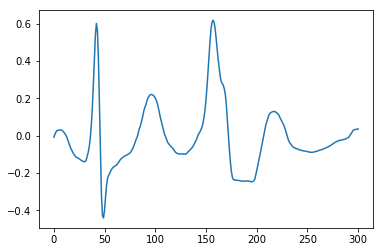

A01516
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


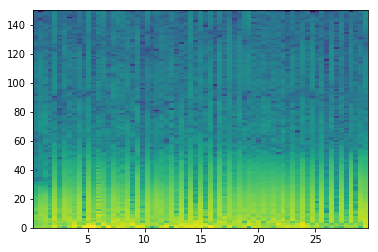

good List
[0, 3, 5, 15, 22, 24, 37, 52, 56, 60, 62, 64, 66]
[3, 2, 10, 7, 2, 13, 15, 4, 4, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


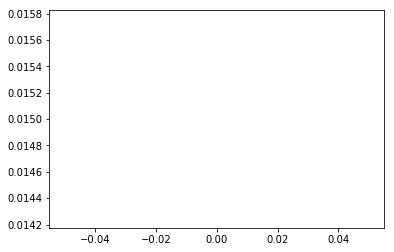

A01517
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


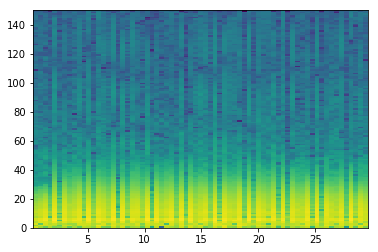

good List
[52, 57, 59, 64]
[5, 2, 5]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


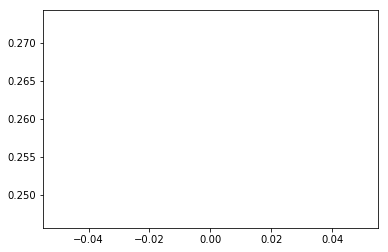

A01518
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


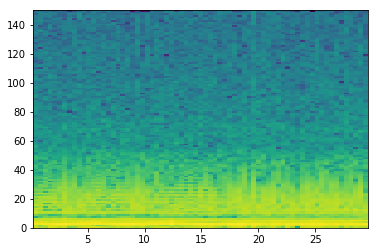

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


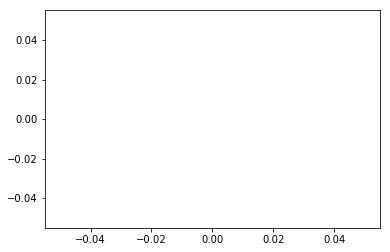

A01525
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


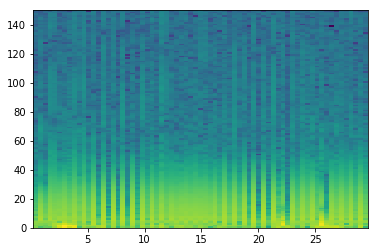

good List
[0, 2, 5, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 30, 31, 32, 35, 36, 37, 38, 40, 42, 44, 46, 48, 52, 53, 54, 58, 60, 64, 66]
[2, 3, 6, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 3, 1, 1, 1, 2, 2, 2, 2, 2, 4, 1, 1, 4, 2, 4, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [13, 14, 15], [17, 18, 19], [], [], [], [], [], [26, 27], [], [], []]
[29, 30, 31, 32]
longest
[29, 30, 31, 32]
indexList
[29, 30, 31, 32]
theMin
3600
theMax
4200


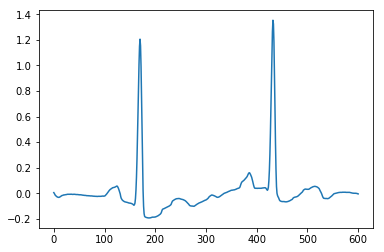

A01526
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


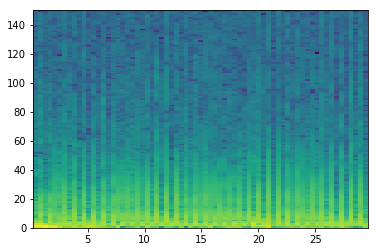

good List
[0, 2, 7, 9, 11, 13, 15, 17, 18, 24, 28, 34, 36, 38, 39, 40, 47, 49, 51, 53, 60, 62, 64, 66, 68]
[2, 5, 2, 2, 2, 2, 2, 1, 6, 4, 6, 2, 2, 1, 1, 7, 2, 2, 2, 7, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [8], [], [], [], [], [14, 15], [], [], [], [], [], [], [], []]
[38, 39, 40]
longest
[38, 39, 40]
indexList
[38, 39, 40]
theMin
4800
theMax
5100


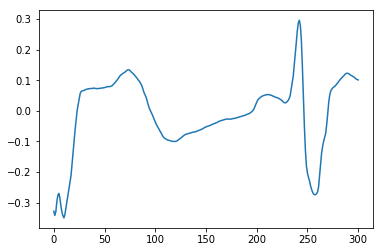

A01527
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


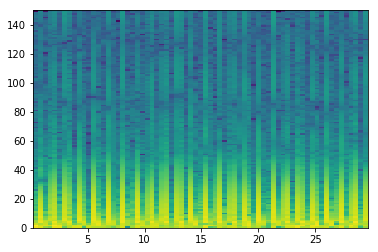

good List
[0, 2, 5, 6, 8, 10, 11, 14, 16, 17, 19, 20, 22, 23, 25, 28, 31, 33, 34, 36, 37, 39, 42, 45, 47, 48, 50, 51, 53, 56, 59, 61, 62, 64, 67, 68]
[2, 3, 1, 2, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 3, 3, 2, 1, 2, 1, 2, 3, 3, 2, 1, 2, 1, 2, 3, 3, 2, 1, 2, 3, 1]
the temp 3
[[], [], [3], [], [6], [], [9], [11], [13], [], [], [], [18], [20], [], [], [], [25], [27], [], [], [], [32], []]
[5, 6]
longest
[5, 6]
indexList
[5, 6]
theMin
600
theMax
900


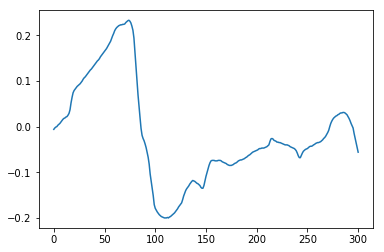

A01530
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


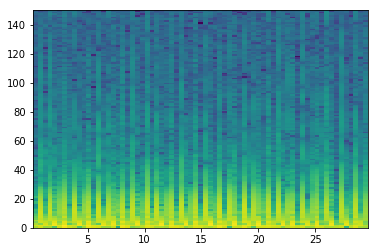

good List
[0, 4, 5, 7, 8, 9, 10, 12, 14, 16, 17, 19, 21, 22, 24, 26, 27, 29, 31, 32, 34, 36, 37, 39, 40, 42, 44, 45, 46, 47, 49, 52, 53, 54, 56, 57, 59, 61, 62, 64, 65, 67, 68]
[4, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 1, 1, 2, 3, 1, 1, 2, 1, 2, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [2], [4, 5, 6], [], [], [10], [], [13], [], [16], [], [19], [], [22], [24], [], [27, 28, 29], [], [32, 33], [35], [], [38], [40]]
[7, 8, 9, 10]
longest
[7, 8, 9, 10]
indexList
[7, 8, 9, 10]
theMin
900
theMax
1200


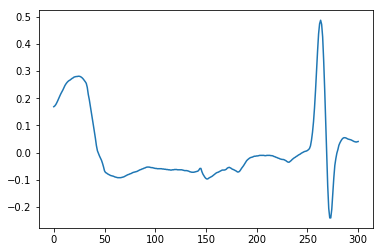

A01531
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


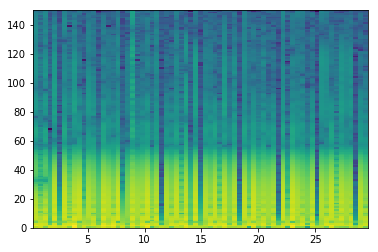

good List
[5, 18, 26, 34, 42, 50, 58, 66]
[13, 8, 8, 8, 8, 8, 8]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


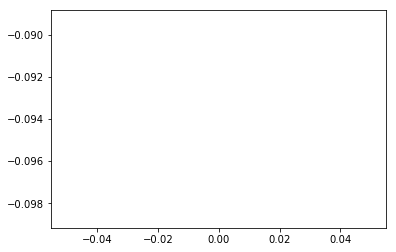

A01532
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


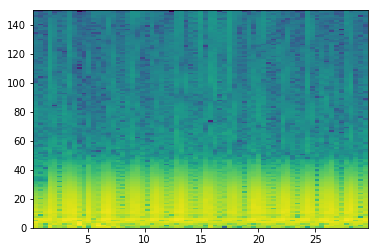

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


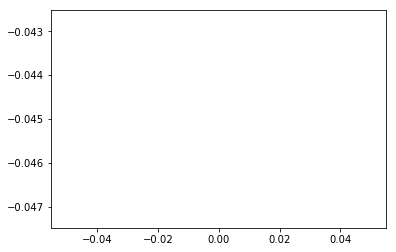

A01536
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


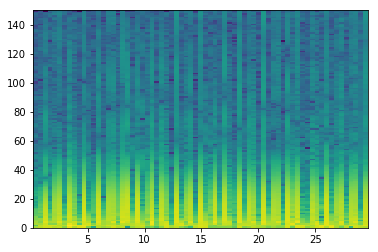

good List
[0, 1, 3, 4, 6, 9, 11, 12, 14, 17, 23, 25, 28, 30, 31, 33, 35, 36, 38, 40, 41, 43, 46, 48, 49, 50, 51, 53, 55, 56, 59, 61, 64, 67]
[1, 2, 1, 2, 3, 2, 1, 2, 3, 6, 2, 3, 2, 1, 2, 2, 1, 2, 2, 1, 2, 3, 2, 1, 1, 1, 2, 2, 1, 3, 2, 3, 3]
the temp 3
[[1], [3], [], [], [7], [], [], [], [], [], [14], [], [17], [], [20], [], [], [24, 25, 26], [], [29], [], [], []]
[48, 49, 50, 51]
longest
[48, 49, 50, 51]
indexList
[48, 49, 50, 51]
theMin
6000
theMax
6600


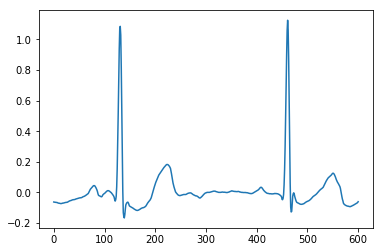

A01540
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

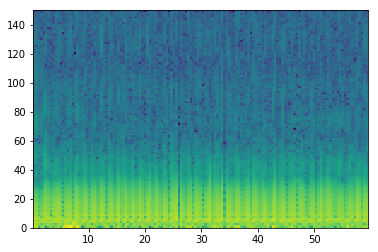

good List
[6, 7, 8, 9, 10, 11, 12, 16, 17, 19, 20, 22, 23, 25, 26, 27, 28, 29, 30, 33, 34, 35, 36, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 49, 51, 52, 53, 55, 56, 60, 62, 63, 65, 66, 67, 68, 69, 70, 72, 74, 77, 78, 79, 80, 81, 82, 83, 85, 86, 87, 88, 89, 90, 92, 93, 94, 97, 101, 104, 105, 108, 109, 110, 112, 113, 114, 115, 116, 117, 118, 120, 121, 122, 123, 124, 125, 126, 128, 129, 130, 132, 133, 134, 135, 136, 137, 138]
[1, 1, 1, 1, 1, 1, 4, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 3, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 2, 1, 4, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 3, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 3, 4, 3, 1, 3, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1]
the temp 3
[[1, 2, 3, 4, 5, 6], [8], [10], [12], [14, 15, 16, 17, 18], [20, 21, 22], [24, 25, 26, 27, 28, 29, 30, 31, 32], [], [35, 36], [38], [], [41], [43, 44, 45, 46, 47], [], [], [51, 52, 53, 54, 55, 56], [58, 59, 60, 61, 62], [64, 65], [], [], [69], [71, 72], [74, 75, 76, 77, 78, 

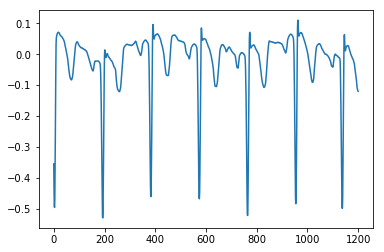

A01543
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


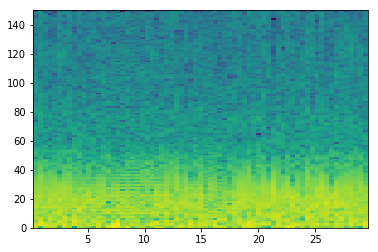

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


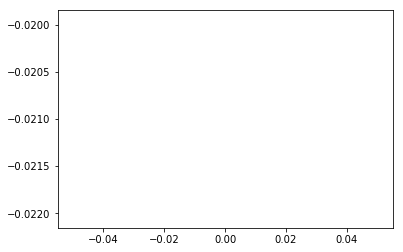

A01544
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


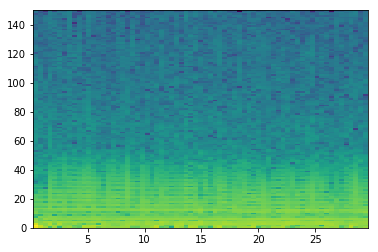

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


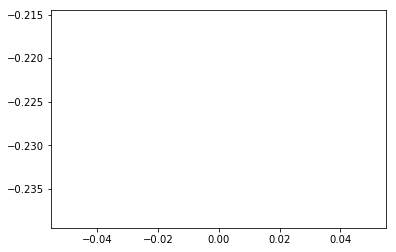

A01546
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


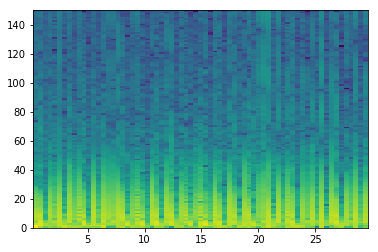

good List
[6, 13, 20, 23, 51, 54, 60, 63, 65, 67]
[7, 7, 3, 28, 3, 6, 3, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


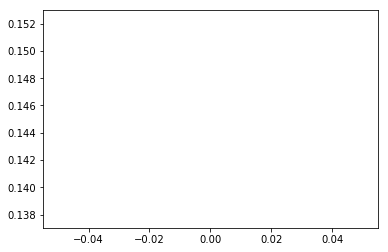

A01547
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


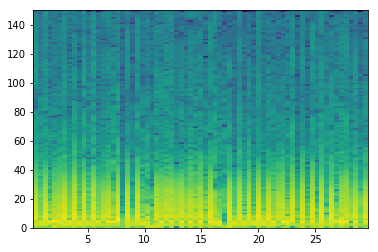

good List
[13, 18, 20, 24, 29, 35, 41, 43, 45, 46, 54, 58, 67]
[5, 2, 4, 5, 6, 6, 2, 2, 1, 8, 4, 9]
the temp 3
[[], [], [], [], [], [], [], [], [9], [], []]
[45, 46]
longest
[45, 46]
indexList
[45, 46]
theMin
5700
theMax
6000


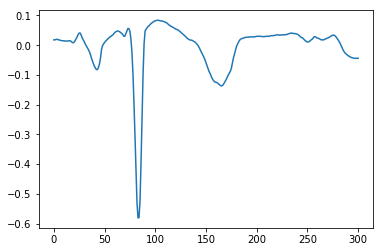

A01552
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


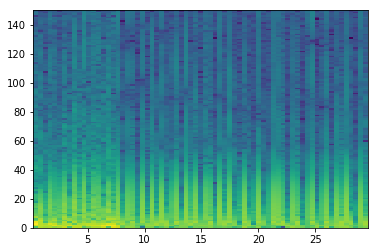

good List
[18, 21, 23, 27, 28, 30, 34, 37, 42, 44, 45, 47, 48, 52, 55, 56, 58, 59, 61, 65, 66]
[3, 2, 4, 1, 2, 4, 3, 5, 2, 1, 2, 1, 4, 3, 1, 2, 1, 2, 4, 1]
the temp 3
[[], [], [], [4], [], [], [], [], [10], [12], [], [15], [17], []]
[27, 28]
longest
[27, 28]
indexList
[27, 28]
theMin
3300
theMax
3600


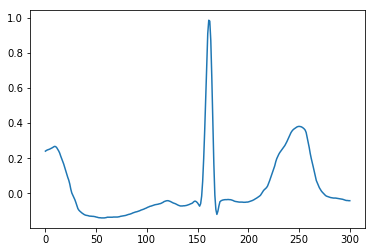

A01561
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

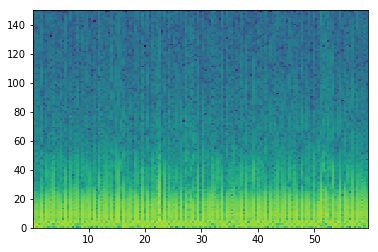

good List
[2, 4, 12, 13, 14, 19, 21, 23, 24, 26, 41, 44, 46, 48, 55, 60, 69, 78, 79, 81, 89, 95, 97, 105, 110, 112, 115, 125, 128, 133, 137]
[2, 8, 1, 1, 5, 2, 2, 1, 2, 15, 3, 2, 2, 7, 5, 9, 9, 1, 2, 8, 6, 2, 8, 5, 2, 3, 10, 3, 5, 4]
the temp 3
[[], [], [3, 4], [], [], [8], [], [], [], [], [], [], [], [], [18], [], [], [], [], [], [], [], [], [], [], []]
[12, 13, 14]
longest
[12, 13, 14]
indexList
[12, 13, 14]
theMin
1500
theMax
1800


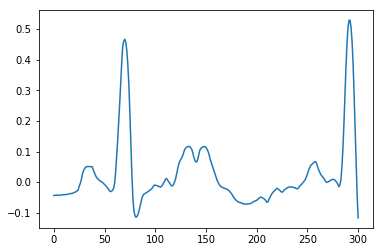

A01563
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

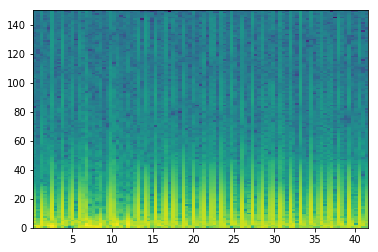

good List
[0, 1, 3, 6, 7, 9, 10, 12, 17, 18, 20, 21, 25, 26, 28, 29, 30, 31, 33, 34, 36, 39, 42, 44, 45, 47, 48, 50, 51, 53, 56, 58, 59, 61, 62, 64, 65, 68, 70, 73, 75, 76, 78, 79, 81, 82, 84, 87, 89, 90, 92, 93, 96]
[1, 2, 3, 1, 2, 1, 2, 5, 1, 2, 1, 4, 1, 2, 1, 1, 1, 2, 1, 2, 3, 3, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 2, 1, 3, 2, 3, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 3]
the temp 3
[[1], [], [4], [6], [], [9], [11], [13], [15, 16, 17], [19], [], [], [], [24], [26], [28], [], [], [32], [34], [36], [], [], [], [41], [43], [45], [], [], [49], [51]]
[28, 29, 30, 31]
longest
[28, 29, 30, 31]
indexList
[28, 29, 30, 31]
theMin
3600
theMax
3900


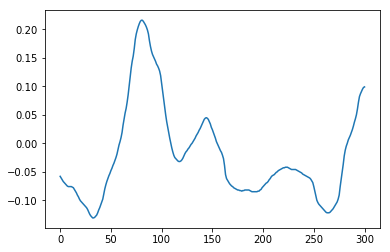

A01564
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


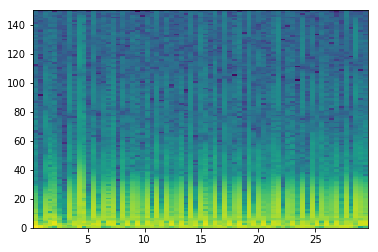

good List
[1, 5, 6, 8, 11, 13, 17, 19, 21, 22, 23, 24, 26, 28, 29, 31, 33, 36, 38, 40, 41, 43, 45, 47, 48, 51, 54, 55, 56, 58, 60, 61, 63, 65]
[4, 1, 2, 3, 2, 4, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 3, 2, 2, 1, 2, 2, 2, 1, 3, 3, 1, 1, 2, 2, 1, 2, 2]
the temp 3
[[], [2], [], [], [], [], [], [9, 10, 11], [], [14], [], [], [], [], [20], [], [], [24], [], [27, 28], [], [31], []]
[21, 22, 23, 24]
longest
[21, 22, 23, 24]
indexList
[21, 22, 23, 24]
theMin
2700
theMax
3000


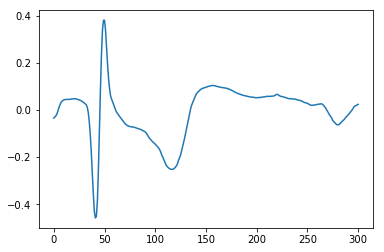

A01565
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


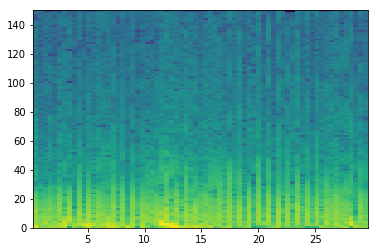

good List
[19]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


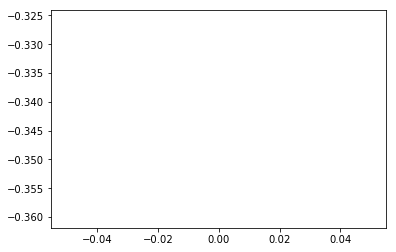

A01571
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


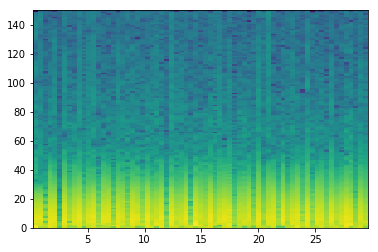

good List
[5, 27, 32, 45, 47, 49, 52]
[22, 5, 13, 2, 2, 3]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


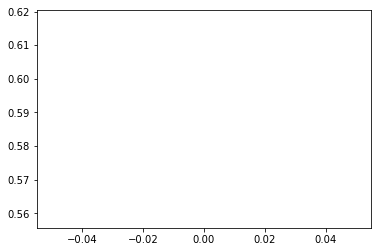

A01576
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


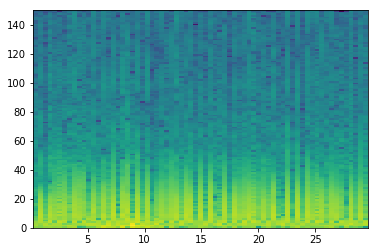

good List
[2, 24, 40, 50, 55]
[22, 16, 10, 5]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


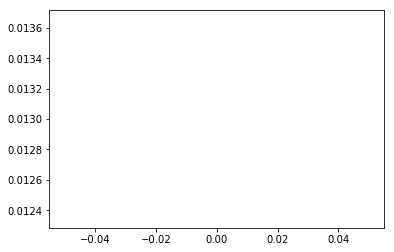

A01577
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


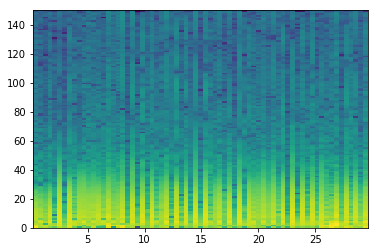

good List
[0, 2, 4, 6, 9, 19, 32, 34, 39, 52, 58, 63]
[2, 2, 2, 3, 10, 13, 2, 5, 13, 6, 5]
the temp 3
[[], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


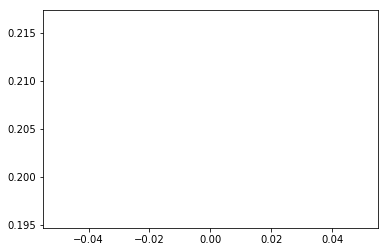

A01581
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


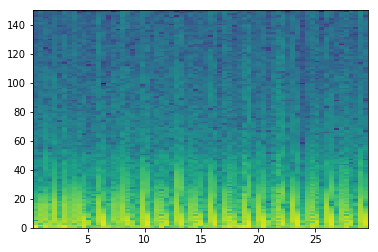

good List
[55]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


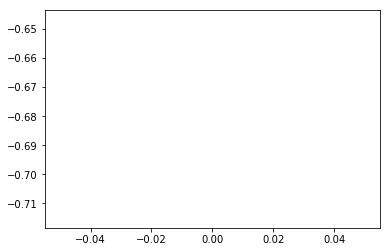

A01583
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


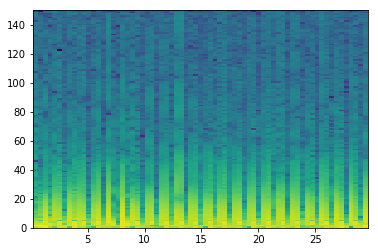

good List
[1, 3, 4, 6, 7, 9, 11, 12, 14, 15, 16, 17, 18, 19, 22, 23, 25, 28, 31, 32, 34, 37, 38, 40, 41, 43, 44, 46, 47, 50, 52, 53, 54, 55, 56, 58, 59, 61, 64, 67]
[2, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 1, 2, 1, 2, 1, 3, 2, 1, 1, 1, 1, 2, 1, 2, 3, 3]
the temp 3
[[], [2], [4], [], [7], [9, 10, 11, 12, 13], [15], [], [], [19], [], [22], [24], [26], [28], [], [31, 32, 33, 34], [36], [], []]
[14, 15, 16, 17, 18, 19]
longest
[14, 15, 16, 17, 18, 19]
indexList
[14, 15, 16, 17, 18, 19]
theMin
1800
theMax
2400


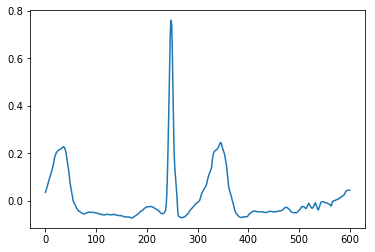

A01586
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

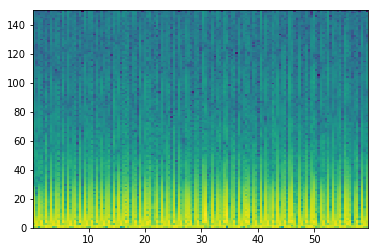

good List
[3, 4, 6, 8, 11, 13, 18, 20, 25, 30, 32, 34, 36, 40, 43, 45, 49, 50, 57, 59, 62, 66, 69, 73, 78, 81, 84, 86, 90, 93, 95, 97, 98, 105, 108, 109, 111, 112, 114, 118, 121, 123, 125, 126, 128, 132, 135, 137]
[1, 2, 2, 3, 2, 5, 2, 5, 5, 2, 2, 2, 4, 3, 2, 4, 1, 7, 2, 3, 4, 3, 4, 5, 3, 3, 2, 4, 3, 2, 2, 1, 7, 3, 1, 2, 1, 2, 4, 3, 2, 2, 1, 2, 4, 3, 2]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [17], [], [], [], [], [], [], [], [], [], [], [], [], [], [32], [], [35], [37], [], [], [], [], [43], [], [], []]
[3, 4]
longest
[3, 4]
indexList
[3, 4]
theMin
300
theMax
600


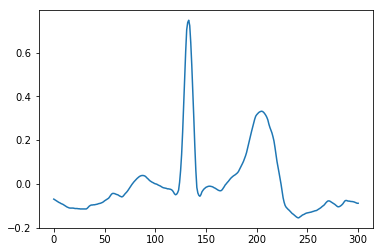

A01587
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

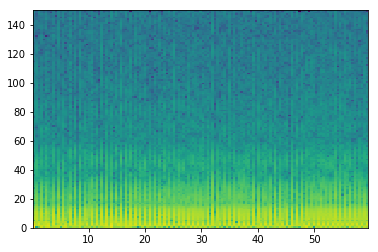

good List
[2, 4, 6, 9, 11, 13, 16, 18, 25, 27, 29, 31, 33, 37, 43, 47, 49, 51, 63, 71, 73, 75, 80, 84, 87, 92, 99, 101, 103, 106, 108, 126, 132]
[2, 2, 3, 2, 2, 3, 2, 7, 2, 2, 2, 2, 4, 6, 4, 2, 2, 12, 8, 2, 2, 5, 4, 3, 5, 7, 2, 2, 3, 2, 18, 6]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


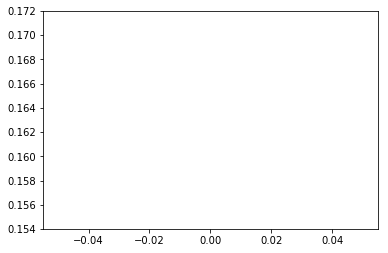

A01588
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


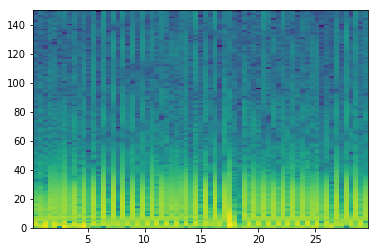

good List
[7, 9, 11, 13, 15, 17, 19, 21, 32, 34, 36, 38, 42, 44, 47, 50, 54, 57, 59, 61, 63, 65, 67]
[2, 2, 2, 2, 2, 2, 2, 11, 2, 2, 2, 4, 2, 3, 3, 4, 3, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


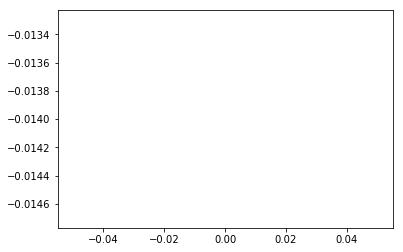

A01590
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


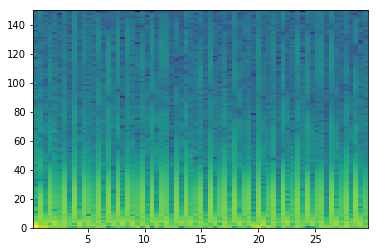

good List
[2, 5, 7, 9, 12, 14, 16, 18, 21, 23, 28, 30, 33, 35, 37, 38, 40, 42, 43, 45, 48, 50, 52, 53, 55, 57, 58, 60, 63, 65, 68]
[3, 2, 2, 3, 2, 2, 2, 3, 2, 5, 2, 3, 2, 2, 1, 2, 2, 1, 2, 3, 2, 2, 1, 2, 2, 1, 2, 3, 2, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [15], [], [18], [], [], [], [23], [], [26], [], [], []]
[37, 38]
longest
[37, 38]
indexList
[37, 38]
theMin
4800
theMax
5100


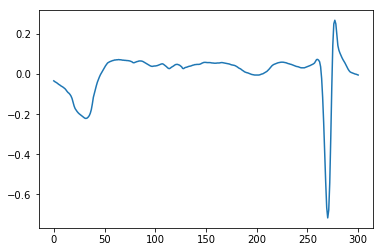

A01591
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


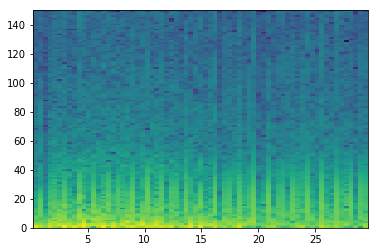

good List
[2, 35, 38, 46, 47, 50, 51, 66]
[33, 3, 8, 1, 3, 1, 15]
the temp 3
[[], [], [], [4], [6]]
[46, 47]
longest
[46, 47]
indexList
[46, 47]
theMin
6000
theMax
6300


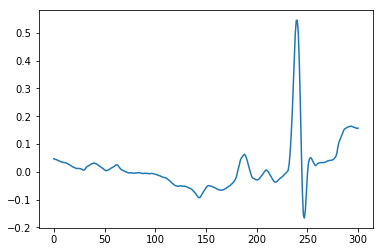

A01592
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


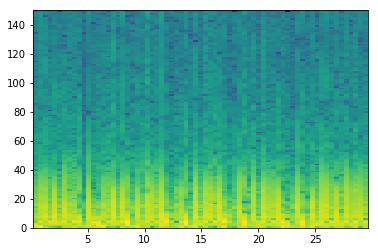

good List
[10, 53, 65]
[43, 12]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


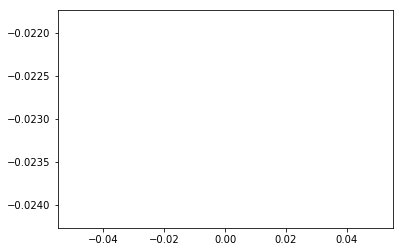

A01598
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


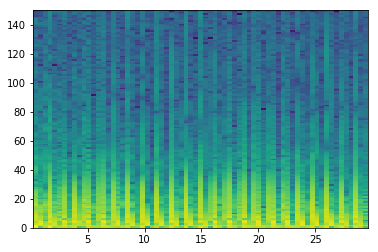

good List
[7, 9, 12, 17, 21, 23, 24, 26, 27, 33, 35, 36, 39, 44, 47, 50, 53, 55, 56, 59, 61, 62, 64, 65, 67]
[2, 3, 5, 4, 2, 1, 2, 1, 6, 2, 1, 3, 5, 3, 3, 3, 2, 1, 3, 2, 1, 2, 1, 2]
the temp 3
[[], [], [], [], [], [6], [8], [], [11], [], [], [], [], [], [18], [], [21], [23]]
[23, 24]
longest
[23, 24]
indexList
[23, 24]
theMin
3000
theMax
3300


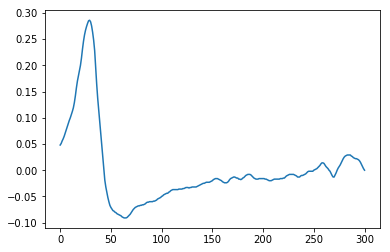

A01602
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


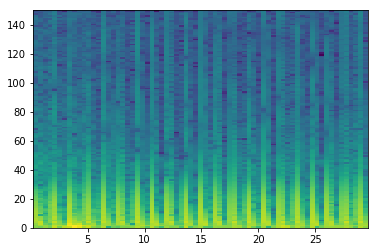

good List
[6, 19, 20, 22, 23, 26, 29, 30, 32, 33, 36, 39, 42, 43, 46, 49, 52, 56, 59, 62, 68]
[13, 1, 2, 1, 3, 3, 1, 2, 1, 3, 3, 3, 1, 3, 3, 3, 4, 3, 3, 6]
the temp 3
[[], [2], [4], [], [7], [9], [], [], [13], [], [], [], [], [], []]
[19, 20]
longest
[19, 20]
indexList
[19, 20]
theMin
2400
theMax
2700


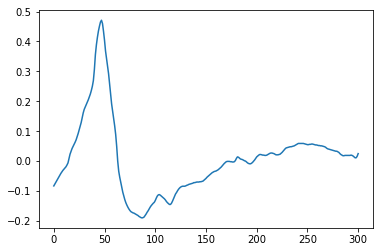

A01606
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


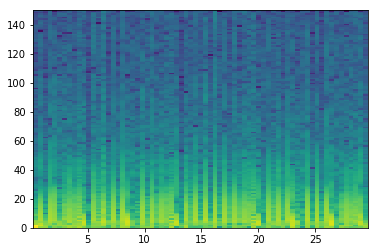

good List
[0, 2, 11, 30, 38, 40, 47, 51, 57, 59, 68]
[2, 9, 19, 8, 2, 7, 4, 6, 2, 9]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


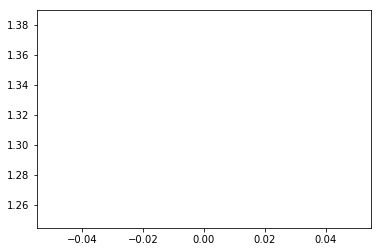

A01608
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


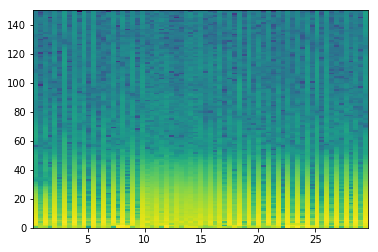

good List
[1, 3, 5, 7, 9, 11, 13, 15, 17, 21, 29, 30, 35, 37, 39, 41, 43, 45, 47, 49, 51, 53, 55, 57, 59, 61, 63, 65, 67]
[2, 2, 2, 2, 2, 2, 2, 2, 4, 8, 1, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [11], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[29, 30]
longest
[29, 30]
indexList
[29, 30]
theMin
3600
theMax
3900


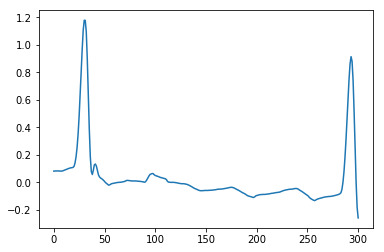

A01619
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

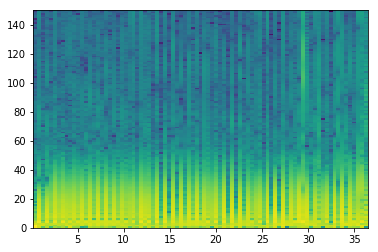

good List
[12, 26, 30, 32, 42, 49, 51, 58, 60, 73, 75]
[14, 4, 2, 10, 7, 2, 7, 2, 13, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


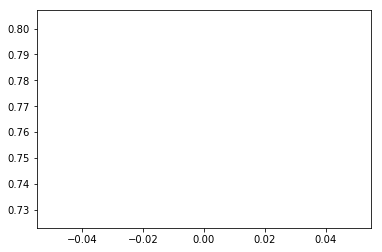

A01620
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


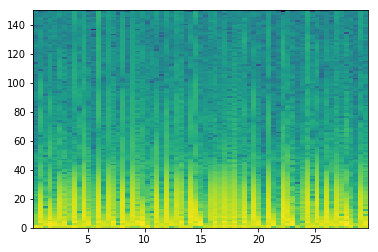

good List
[0, 2, 4, 7, 8, 12, 14, 15, 16, 17, 19, 23, 26, 28, 34, 35, 36, 37, 38, 42, 43, 44, 46, 47, 49, 50, 54, 55, 59, 61, 63, 65, 66]
[2, 2, 3, 1, 4, 2, 1, 1, 1, 2, 4, 3, 2, 6, 1, 1, 1, 1, 4, 1, 1, 2, 1, 2, 1, 4, 1, 4, 2, 2, 2, 1]
the temp 3
[[], [], [], [4], [], [7, 8, 9], [], [], [], [], [15, 16, 17, 18], [20, 21], [23], [25], [27], [], [], []]
[34, 35, 36, 37, 38]
longest
[34, 35, 36, 37, 38]
indexList
[34, 35, 36, 37, 38]
theMin
4200
theMax
4800


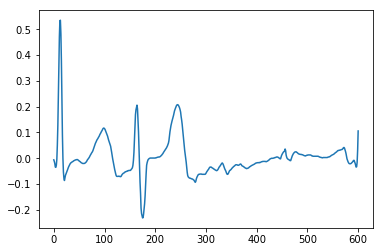

A01622
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


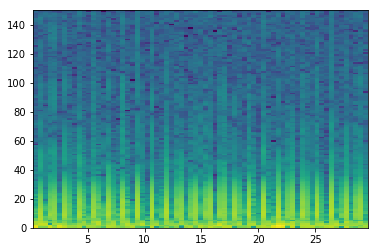

good List
[0, 2, 5, 7, 8, 10, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 45, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 67, 68]
[2, 3, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1]
the temp 3
[[], [], [], [4], [6], [8, 9, 10, 11], [13, 14, 15, 16, 17, 18, 19], [21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35], [37], [39, 40, 41, 42], [44, 45, 46, 47, 48, 49], [51]]
[28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43]
longest
[28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43]
indexList
[28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43]
theMin
3600
theMax
5400


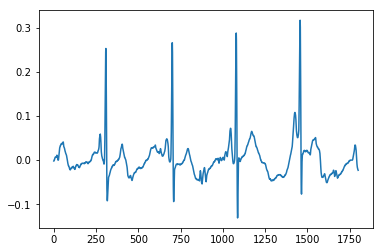

A01627
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


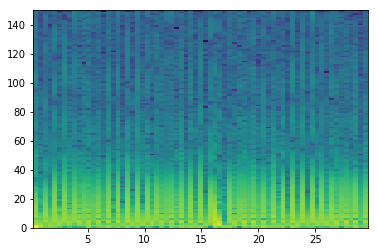

good List
[1, 2, 3, 5, 12, 14, 16, 18, 20, 22, 24, 26, 27, 28, 31, 33, 35, 39, 41, 48, 52, 54, 56, 60, 63, 65, 67]
[1, 1, 2, 7, 2, 2, 2, 2, 2, 2, 2, 1, 1, 3, 2, 2, 4, 2, 7, 4, 2, 2, 4, 3, 2, 2]
the temp 3
[[1, 2], [], [], [], [], [], [], [], [], [12, 13], [], [], [], [], [], [], [], [], [], [], [], []]
[1, 2, 3]
longest
[1, 2, 3]
indexList
[1, 2, 3]
theMin
0
theMax
300


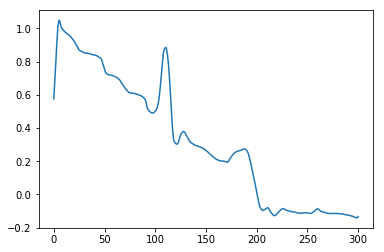

A01632
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


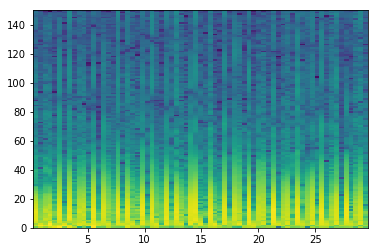

good List
[1, 4, 6, 11, 13, 15, 16, 18, 23, 25, 26, 31, 35, 37, 38, 40, 43, 45, 48, 50, 56, 60, 63, 65, 68]
[3, 2, 5, 2, 2, 1, 2, 5, 2, 1, 5, 4, 2, 1, 2, 3, 2, 3, 2, 6, 4, 3, 2, 3]
the temp 3
[[], [], [], [], [], [6], [], [], [10], [], [], [14], [], [], [], [], [], [], [], [], []]
[15, 16]
longest
[15, 16]
indexList
[15, 16]
theMin
1800
theMax
2100


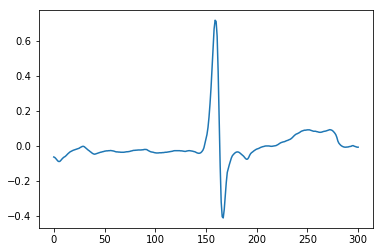

A01633
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


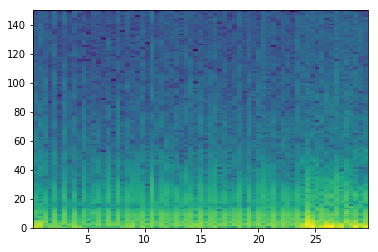

good List
[3, 5, 7, 9, 11, 12, 13, 14, 16, 18, 23, 30, 31, 35, 40, 43, 45, 48, 50, 53]
[2, 2, 2, 2, 1, 1, 1, 2, 2, 5, 7, 1, 4, 5, 3, 2, 3, 2, 3]
the temp 3
[[], [], [], [], [5, 6, 7], [], [], [], [12], [], [], [], [], [], []]
[11, 12, 13, 14]
longest
[11, 12, 13, 14]
indexList
[11, 12, 13, 14]
theMin
1500
theMax
1800


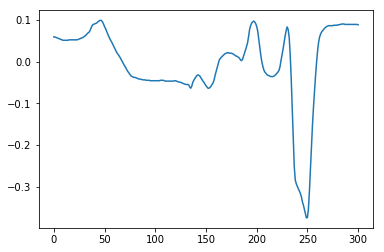

A01634
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


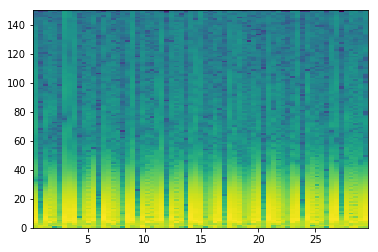

good List
[1, 2, 3, 4, 5, 8, 9, 10, 13, 16, 17, 18, 19, 21, 22, 23, 27, 29, 31, 35, 36, 37, 38, 39, 42, 43, 44, 47, 51, 52, 55, 60, 63, 68]
[1, 1, 1, 1, 3, 1, 1, 3, 3, 1, 1, 1, 2, 1, 1, 4, 2, 2, 4, 1, 1, 1, 1, 3, 1, 1, 3, 4, 1, 3, 5, 3, 5]
the temp 3
[[1, 2, 3, 4], [6, 7], [], [10, 11, 12], [14, 15], [], [], [], [20, 21, 22, 23], [25, 26], [], [29], [], [], []]
[1, 2, 3, 4, 5]
longest
[1, 2, 3, 4, 5]
indexList
[1, 2, 3, 4, 5]
theMin
0
theMax
600


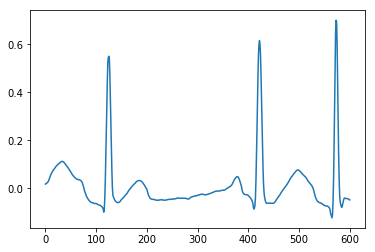

A01635
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667]


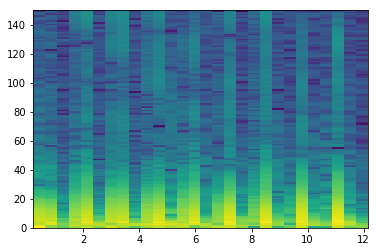

good List
[0, 2, 5, 6, 8, 9, 11, 12, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27]
[2, 3, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [], [3], [5], [7], [9], [11], [13], [15]]
[5, 6]
longest
[5, 6]
indexList
[5, 6]
theMin
600
theMax
900


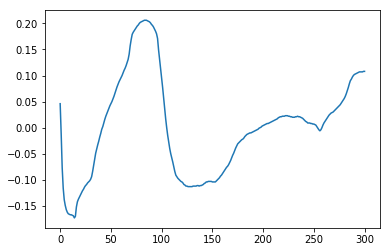

A01636
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


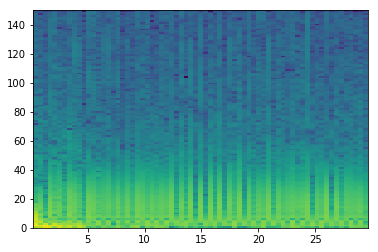

good List
[10, 18, 33, 35, 47, 60]
[8, 15, 2, 12, 13]
the temp 3
[[], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


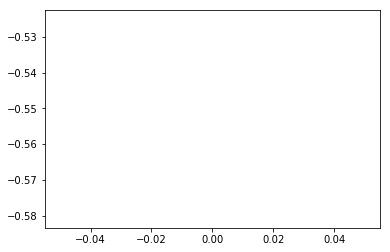

A01639
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


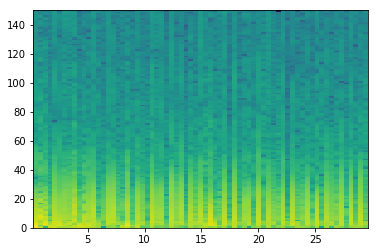

good List
[3, 13, 14, 27, 31, 40, 42, 52, 55, 57, 64]
[10, 1, 13, 4, 9, 2, 10, 3, 2, 7]
the temp 3
[[], [2], [], [], [], [], [], [], []]
[13, 14]
longest
[13, 14]
indexList
[13, 14]
theMin
1500
theMax
1800


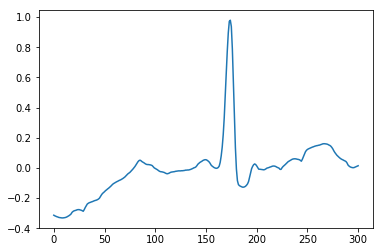

A01641
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


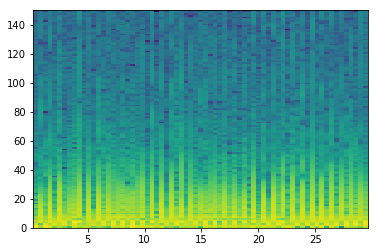

good List
[6, 10, 12, 23, 27, 33, 38, 40, 46, 48, 58, 60, 62]
[4, 2, 11, 4, 6, 5, 2, 6, 2, 10, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


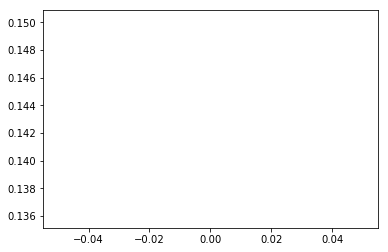

A01643
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


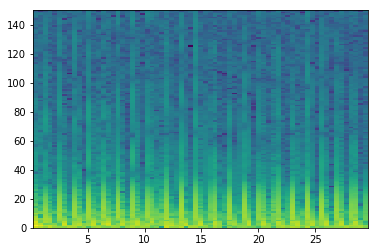

good List
[1, 3, 4, 6, 7, 8, 9, 10, 12, 13, 15, 16, 18, 19, 21, 22, 25, 26, 28, 29, 31, 32, 34, 35, 36, 38, 39, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 54, 55, 57, 58, 60, 61, 63, 64, 67, 68]
[2, 1, 2, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 3, 1, 2, 1, 2, 1, 2, 1, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 3, 1]
the temp 3
[[], [2], [4, 5, 6, 7], [9], [11], [13], [15], [17], [19], [21], [23, 24], [26], [28], [30, 31, 32, 33], [35, 36], [38], [40], [42], [44]]
[6, 7, 8, 9, 10]
longest
[6, 7, 8, 9, 10]
indexList
[6, 7, 8, 9, 10]
theMin
600
theMax
1200


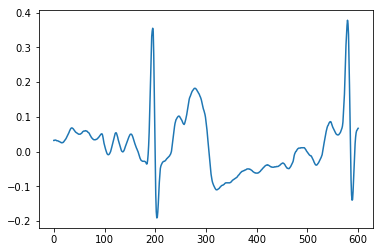

A01647
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


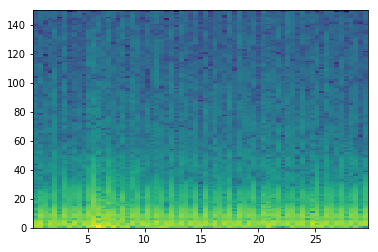

good List
[2, 9, 19, 29, 34, 41, 46, 66, 67]
[7, 10, 10, 5, 7, 5, 20, 1]
the temp 3
[[], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


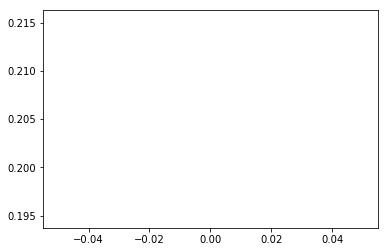

A01649
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

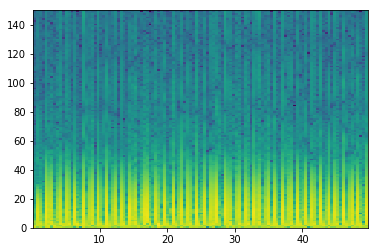

good List
[0, 2, 3, 7, 10, 13, 15, 16, 21, 23, 24, 27, 29, 30, 31, 32, 36, 37, 40, 44, 46, 49, 55, 58, 60, 75, 82, 84, 85, 90, 92, 93, 95, 98, 100, 101, 103, 106, 109]
[2, 1, 4, 3, 3, 2, 1, 5, 2, 1, 3, 2, 1, 1, 1, 4, 1, 3, 4, 2, 3, 6, 3, 2, 15, 7, 2, 1, 5, 2, 1, 2, 3, 2, 1, 2, 3, 3]
the temp 3
[[], [2], [], [], [], [7], [], [10], [], [13, 14, 15], [17], [], [], [], [], [], [], [], [], [], [28], [], [31], [], [], [35], [], []]
[29, 30, 31, 32]
longest
[29, 30, 31, 32]
indexList
[29, 30, 31, 32]
theMin
3600
theMax
4200


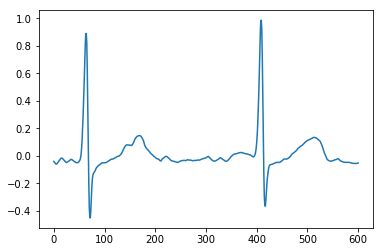

A01651
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

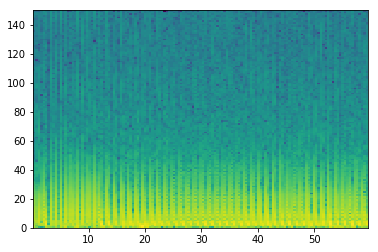

good List
[0, 1, 6, 10, 12, 17, 19, 24, 29, 35, 44, 59, 115, 121, 127, 130]
[1, 5, 4, 2, 5, 2, 5, 5, 6, 9, 15, 56, 6, 6, 3]
the temp 3
[[1], [], [], [], [], [], [], [], [], [], [], [], [], []]
[0, 1]
longest
[0, 1]
indexList
[0, 1]
theMin
0
theMax
300


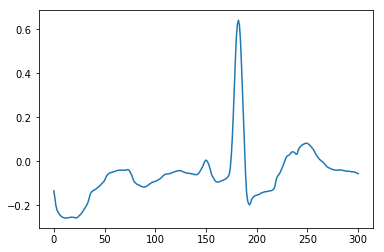

A01653
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


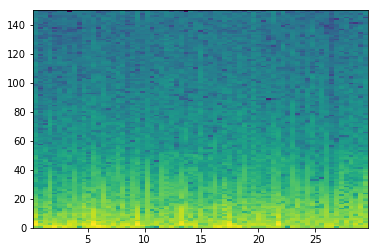

good List
[55]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


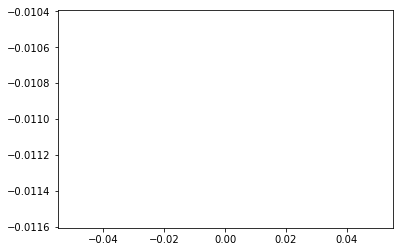

A01654
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


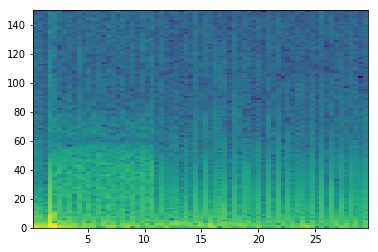

good List
[2, 25, 27, 28, 30, 32, 34, 36, 37, 40, 42, 45, 47, 49, 51, 54, 56, 58, 60, 62, 64, 66, 67]
[23, 2, 1, 2, 2, 2, 2, 1, 3, 2, 3, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 1]
the temp 3
[[], [], [3], [], [], [], [8], [], [], [], [], [], [], [], [], [], [], [], []]
[27, 28]
longest
[27, 28]
indexList
[27, 28]
theMin
3300
theMax
3600


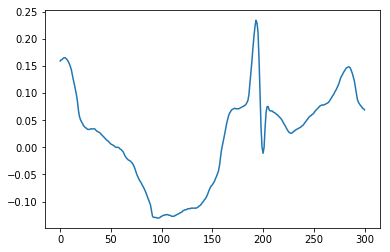

A01667
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


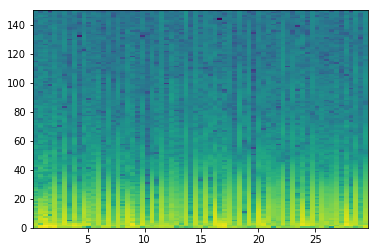

good List
[7, 9, 14, 16, 21, 23, 24, 25, 30, 32, 41, 43, 45, 52, 63, 65, 67]
[2, 5, 2, 5, 2, 1, 1, 5, 2, 9, 2, 2, 7, 11, 2, 2]
the temp 3
[[], [], [], [], [], [6, 7], [], [], [], [], [], [], [], []]
[23, 24, 25]
longest
[23, 24, 25]
indexList
[23, 24, 25]
theMin
3000
theMax
3300


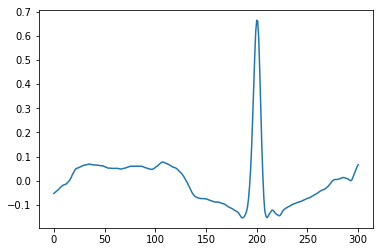

A01668
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

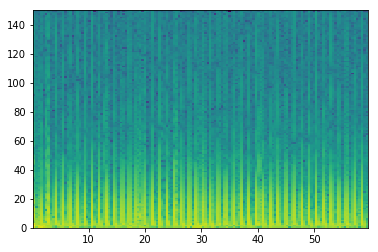

good List
[1, 4, 7, 8, 10, 11, 13, 14, 15, 16, 17, 19, 20, 22, 23, 25, 26, 28, 31, 32, 34, 35, 36, 37, 38, 41, 47, 48, 50, 51, 53, 54, 57, 60, 62, 63, 66, 69, 72, 73, 74, 75, 78, 79, 80, 81, 82, 84, 87, 88, 90, 91, 96, 97, 99, 100, 102, 103, 106, 107, 108, 109, 110, 112, 113, 115, 116, 118, 119, 121, 122, 124, 125, 127, 128, 131, 132, 134, 135, 137, 138]
[3, 3, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 3, 1, 2, 1, 1, 1, 1, 3, 6, 1, 2, 1, 2, 1, 3, 3, 2, 1, 3, 3, 3, 1, 1, 1, 3, 1, 1, 1, 1, 2, 3, 1, 2, 1, 5, 1, 2, 1, 2, 1, 3, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 3, 1, 2, 1, 2, 1]
the temp 3
[[], [], [3], [5], [7, 8, 9, 10], [12], [14], [16], [], [19], [21, 22, 23, 24], [], [27], [29], [31], [], [], [35], [], [], [39, 40, 41], [43, 44, 45, 46], [], [49], [51], [53], [55], [57], [59, 60, 61, 62], [64], [66], [68], [70], [72], [74], [76], [78]]
[13, 14, 15, 16, 17]
longest
[13, 14, 15, 16, 17]
indexList
[13, 14, 15, 16, 17]
theMin
1500
theMax
2100


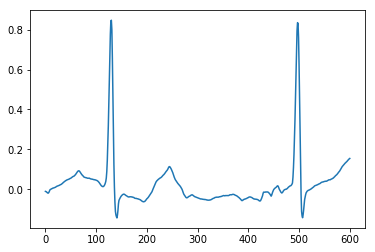

A01669
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


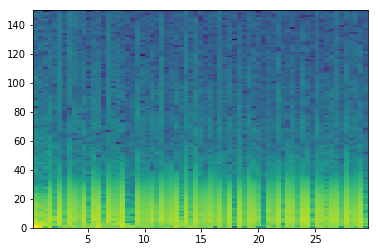

good List
[6, 8, 11, 13, 14, 15, 18, 19, 20, 23, 27, 28, 30, 32, 34, 35, 36, 37, 41, 43, 47, 48, 49, 51, 54, 57, 62, 63, 65, 66, 68]
[2, 3, 2, 1, 1, 3, 1, 1, 3, 4, 1, 2, 2, 2, 1, 1, 1, 4, 2, 4, 1, 1, 2, 3, 3, 5, 1, 2, 1, 2]
the temp 3
[[], [], [], [4, 5], [7, 8], [], [11], [], [], [15, 16, 17], [], [], [21, 22], [], [], [], [27], [29]]
[34, 35, 36, 37]
longest
[34, 35, 36, 37]
indexList
[34, 35, 36, 37]
theMin
4200
theMax
4800


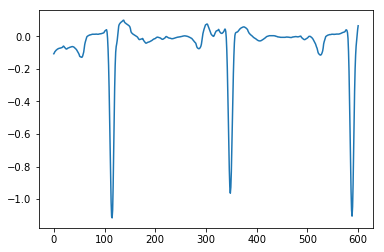

A01672
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


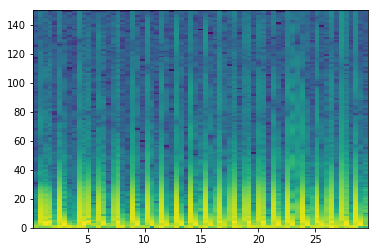

good List
[0, 2, 4, 6, 7, 8, 12, 15, 18, 19, 21, 22, 25, 27, 28, 31, 33, 34, 36, 37, 39, 40, 42, 43, 45, 48, 51, 56, 57, 59, 60, 62, 65, 67, 68]
[2, 2, 2, 1, 1, 4, 3, 3, 1, 2, 1, 3, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 3, 5, 1, 2, 1, 2, 3, 2, 1]
the temp 3
[[], [], [], [4, 5], [], [], [9], [11], [], [14], [], [17], [19], [21], [23], [], [], [], [28], [30], [], []]
[6, 7, 8]
longest
[6, 7, 8]
indexList
[6, 7, 8]
theMin
600
theMax
900


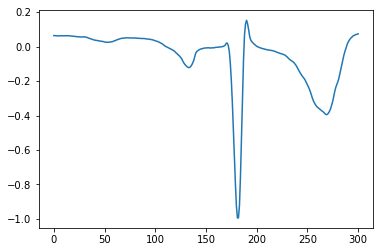

A01676
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


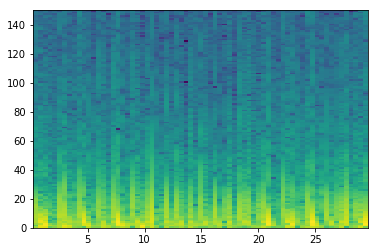

good List
[4, 15, 26, 31, 36, 38]
[11, 11, 5, 5, 2]
the temp 3
[[], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


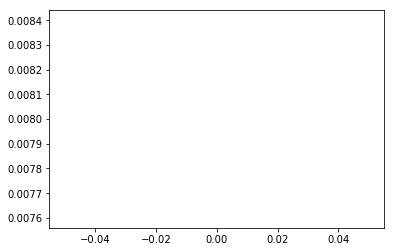

A01679
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


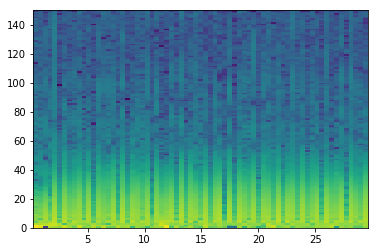

good List
[2, 5, 7, 10, 12, 14, 17, 24, 26, 27, 29, 31, 36, 38, 39, 41, 46, 56, 59, 61, 62, 64]
[3, 2, 3, 2, 2, 3, 7, 2, 1, 2, 2, 5, 2, 1, 2, 5, 10, 3, 2, 1, 2]
the temp 3
[[], [], [], [], [], [], [], [], [9], [], [], [], [14], [], [], [], [], [20]]
[26, 27]
longest
[26, 27]
indexList
[26, 27]
theMin
3300
theMax
3600


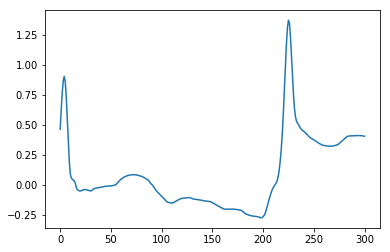

A01682
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

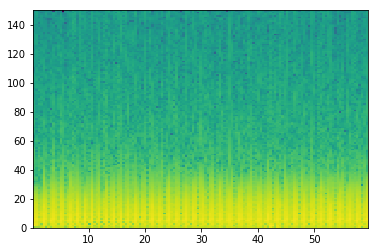

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


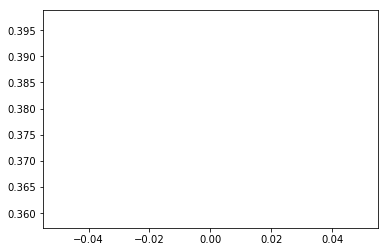

A01690
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


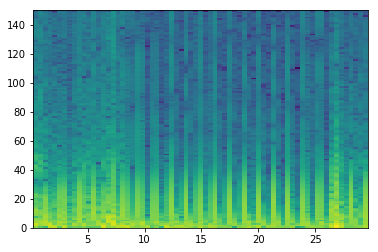

good List
[7, 23, 26, 27, 29, 30, 32, 33, 35, 36, 38, 39, 41, 42, 44, 45, 47, 48, 50, 51, 53, 54, 57, 60]
[16, 3, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 3, 3]
the temp 3
[[], [], [3], [5], [7], [9], [11], [13], [15], [17], [19], [21], []]
[26, 27]
longest
[26, 27]
indexList
[26, 27]
theMin
3300
theMax
3600


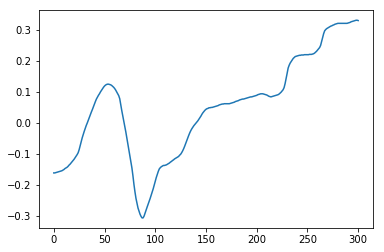

A01692
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


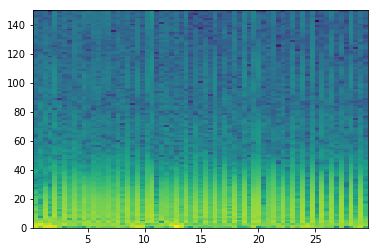

good List
[0, 11, 22, 25, 29, 36, 38, 42, 44, 47, 48, 49, 50, 52, 56, 58, 64, 66, 68]
[11, 11, 3, 4, 7, 2, 4, 2, 3, 1, 1, 1, 2, 4, 2, 6, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [10, 11, 12], [], [], [], [], []]
[47, 48, 49, 50]
longest
[47, 48, 49, 50]
indexList
[47, 48, 49, 50]
theMin
6000
theMax
6300


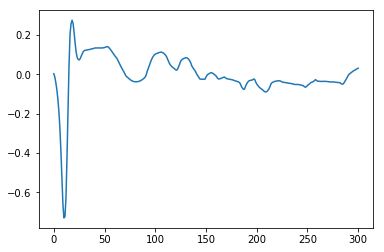

A01701
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


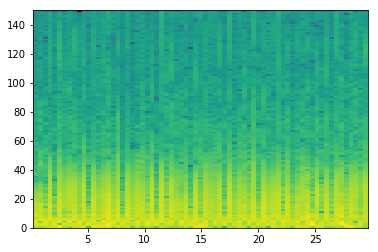

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


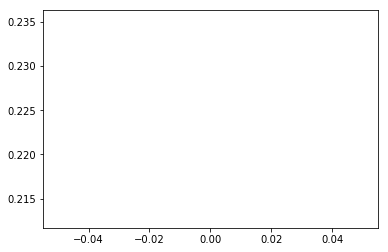

A01709
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


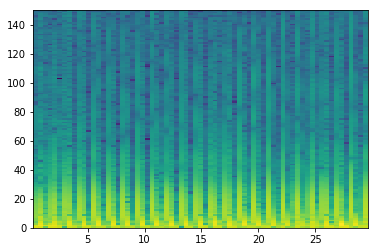

good List
[0, 2, 8, 11, 14, 17, 20, 23, 26, 29, 32, 35, 38, 41, 44, 47, 49, 50, 52, 53, 55, 56, 58, 61, 64, 67]
[2, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 1, 2, 1, 2, 1, 2, 3, 3, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [17], [19], [21], [], [], []]
[49, 50]
longest
[49, 50]
indexList
[49, 50]
theMin
6300
theMax
6600


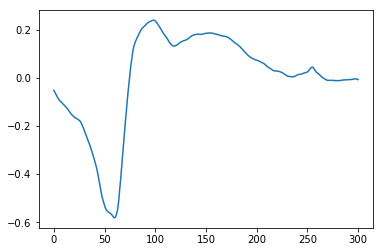

A01716
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


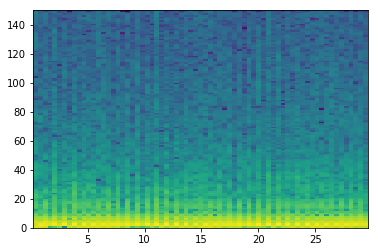

good List
[3, 16, 17, 22, 24, 26, 28, 33, 41, 45, 49, 51, 62, 66, 68]
[13, 1, 5, 2, 2, 2, 5, 8, 4, 4, 2, 11, 4, 2]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [], [], []]
[16, 17]
longest
[16, 17]
indexList
[16, 17]
theMin
2100
theMax
2400


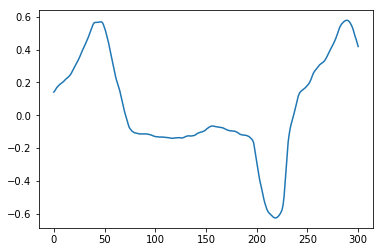

A01720
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


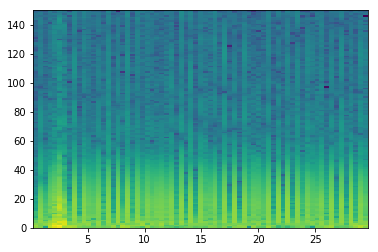

good List
[0, 9, 14, 16, 18, 20, 25, 29, 31, 33, 38, 40, 42, 47, 49, 51, 53, 55, 60, 62, 64, 66]
[9, 5, 2, 2, 2, 5, 4, 2, 2, 5, 2, 2, 5, 2, 2, 2, 2, 5, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


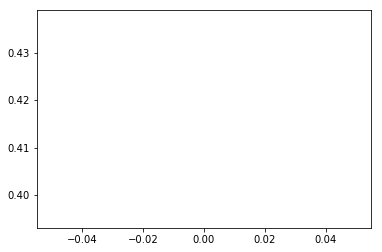

A01722
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

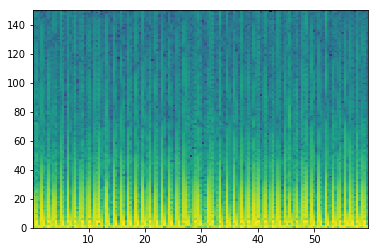

good List
[5, 7, 10, 13, 15, 16, 18, 19, 21, 24, 31, 32, 35, 38, 41, 44, 46, 49, 52, 55, 58, 61, 65, 66, 70, 71, 75, 76, 78, 79, 81, 82, 85, 87, 88, 90, 94, 95, 97, 100, 103, 107, 110, 114, 117, 120, 123, 128, 133, 138]
[2, 3, 3, 2, 1, 2, 1, 2, 3, 7, 1, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 4, 1, 4, 1, 4, 1, 2, 1, 2, 1, 3, 2, 1, 2, 4, 1, 2, 3, 3, 4, 3, 4, 3, 3, 3, 5, 5, 5]
the temp 3
[[], [], [], [], [5], [7], [], [], [11], [], [], [], [], [], [], [], [], [], [], [23], [25], [27], [29], [31], [], [34], [], [37], [], [], [], [], [], [], [], [], [], [], []]
[15, 16]
longest
[15, 16]
indexList
[15, 16]
theMin
1800
theMax
2100


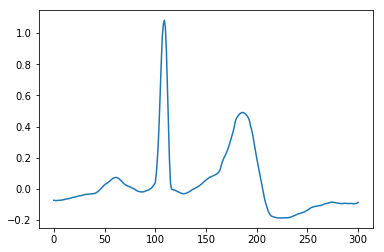

A01723
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


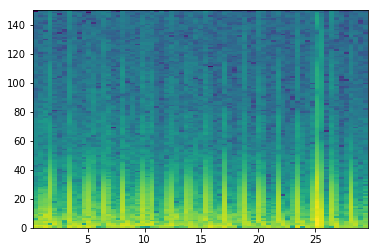

good List
[0, 4, 5, 6, 8, 9, 10, 13, 16, 17, 21, 25, 26, 27, 28, 29, 30, 31, 32, 34, 36, 37, 38, 40, 41, 42, 44, 45, 47, 48, 49, 51, 52, 53, 55, 56, 60, 62, 63, 64, 66, 67, 68]
[4, 1, 1, 2, 1, 1, 3, 3, 1, 4, 4, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 2, 1, 1, 2, 1, 4, 2, 1, 1, 2, 1, 1]
the temp 3
[[], [2, 3], [5, 6], [], [9], [], [12, 13, 14, 15, 16, 17, 18], [], [21, 22], [24, 25], [27], [29, 30], [32, 33], [35], [], [38, 39]]
[25, 26, 27, 28, 29, 30, 31, 32]
longest
[25, 26, 27, 28, 29, 30, 31, 32]
indexList
[25, 26, 27, 28, 29, 30, 31, 32]
theMin
3300
theMax
4200


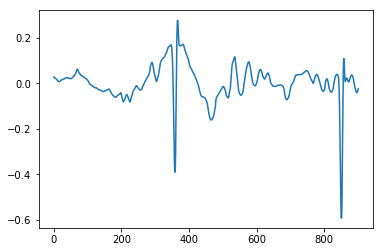

A01731
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


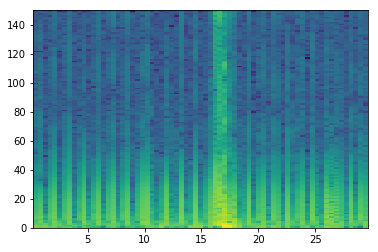

good List
[0, 1, 2, 3, 5, 6, 8, 9, 11, 12, 14, 15, 17, 18, 20, 21, 24, 25, 26, 27, 28, 29, 31, 32, 34, 35, 42, 43, 45, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56, 58, 59, 63, 64, 66]
[1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 2, 1, 7, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 4, 1, 2]
the temp 3
[[1, 2, 3], [5], [7], [9], [11], [13], [15], [17, 18, 19, 20, 21], [23], [25], [27], [29, 30, 31, 32, 33, 34], [36, 37, 38], [40], [42]]
[45, 46, 47, 48, 49, 50, 51]
longest
[45, 46, 47, 48, 49, 50, 51]
indexList
[45, 46, 47, 48, 49, 50, 51]
theMin
5700
theMax
6600


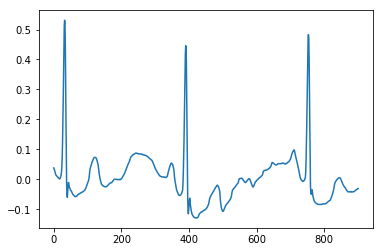

A01737
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


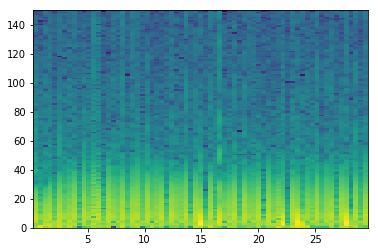

good List
[1, 4, 9, 11, 14, 19, 24, 25, 27, 30, 32, 35, 44, 48, 49, 52, 56, 59, 67]
[3, 5, 2, 3, 5, 5, 1, 2, 3, 2, 3, 9, 4, 1, 3, 4, 3, 8]
the temp 3
[[], [], [], [], [], [], [7], [], [], [], [], [], [14], [], [], []]
[24, 25]
longest
[24, 25]
indexList
[24, 25]
theMin
3000
theMax
3300


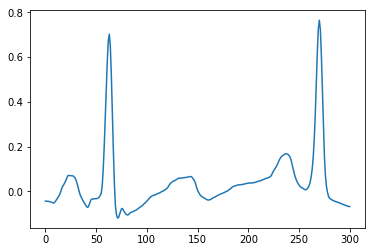

A01744
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

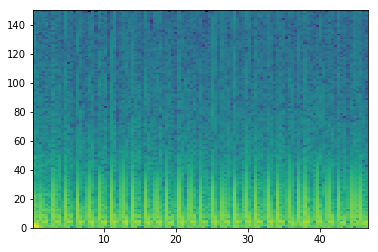

good List
[9, 13, 17, 20, 24, 27, 35, 40, 46, 53, 57, 60, 66, 85, 95, 98, 102]
[4, 4, 3, 4, 3, 8, 5, 6, 7, 4, 3, 6, 19, 10, 3, 4]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


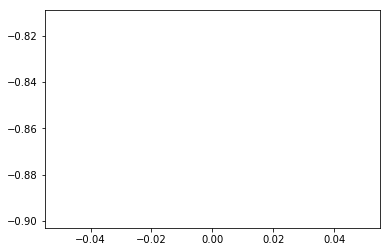

A01746
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


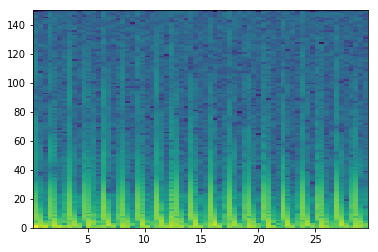

good List
[1, 2, 5, 6, 8, 9, 10, 11, 12, 13, 15, 16, 17, 19, 20, 21, 22, 23, 24, 26, 27, 30, 31, 33, 34, 35, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68]
[1, 3, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 3, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[1], [3], [5, 6, 7, 8, 9], [11, 12], [14, 15, 16, 17, 18], [20], [22], [24, 25], [27, 28, 29, 30, 31, 32, 33, 34, 35]]
[37, 38, 39, 40, 41, 42, 43, 44, 45, 46]
longest
[37, 38, 39, 40, 41, 42, 43, 44, 45, 46]
indexList
[37, 38, 39, 40, 41, 42, 43, 44, 45, 46]
theMin
4800
theMax
6000


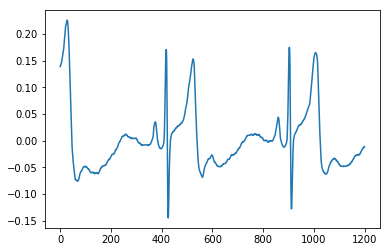

A01757
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


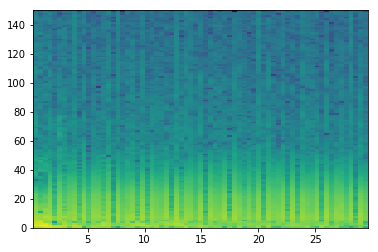

good List
[9, 11, 16, 23, 28, 33, 35, 50, 52, 54, 59, 61, 64, 66, 68]
[2, 5, 7, 5, 5, 2, 15, 2, 2, 5, 2, 3, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


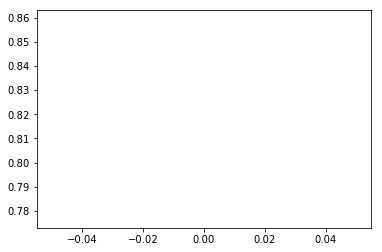

A01761
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

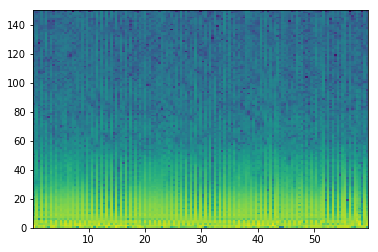

good List
[2, 4, 6, 8, 10, 12, 16, 21, 29, 31, 33, 35, 37, 39, 41, 43, 45, 47, 49, 50, 58, 64, 68, 70, 72, 74, 78, 80, 82, 84, 90, 105, 106, 112, 114, 118, 121, 123, 125, 127, 130, 132, 136, 138]
[2, 2, 2, 2, 2, 4, 5, 8, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 8, 6, 4, 2, 2, 2, 4, 2, 2, 2, 6, 15, 1, 6, 2, 4, 3, 2, 2, 2, 3, 2, 4, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [19], [], [], [], [], [], [], [], [], [], [], [], [32], [], [], [], [], [], [], [], [], [], []]
[49, 50]
longest
[49, 50]
indexList
[49, 50]
theMin
6300
theMax
6600


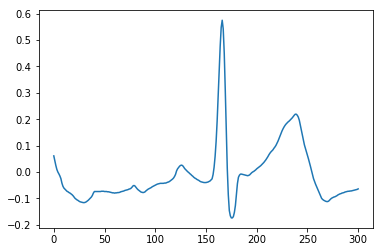

A01764
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


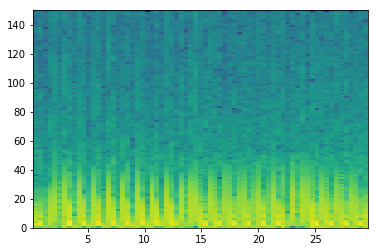

good List
[2]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


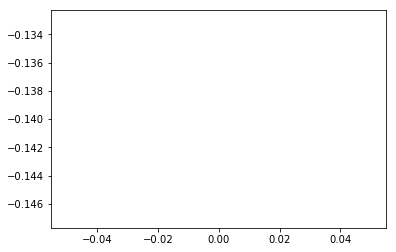

A01774
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

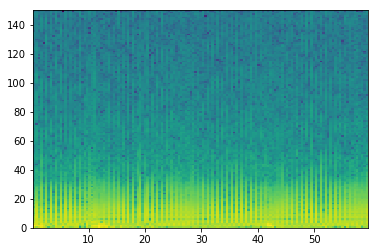

good List
[0, 2, 4, 6, 8, 10, 12, 13, 14, 16, 18, 20, 26, 28, 30, 32, 33, 34, 36, 38, 40, 42, 45, 48, 50, 52, 54, 59, 65, 67, 69, 73, 75, 77, 79, 82, 85, 87, 93, 97, 98, 100, 101, 102, 104, 105, 106, 107, 108, 110, 112, 114, 116, 117, 118, 120, 122, 124, 126, 128, 130, 131, 132, 133, 137]
[2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 6, 2, 2, 2, 1, 1, 2, 2, 2, 2, 3, 3, 2, 2, 2, 5, 6, 2, 2, 4, 2, 2, 2, 3, 3, 2, 6, 4, 1, 2, 1, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 4]
the temp 3
[[], [], [], [], [], [], [7, 8], [], [], [], [], [], [], [16, 17], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [40], [42, 43], [45, 46, 47, 48], [], [], [], [53, 54], [], [], [], [], [], [61, 62, 63]]
[104, 105, 106, 107, 108]
longest
[104, 105, 106, 107, 108]
indexList
[104, 105, 106, 107, 108]
theMin
13200
theMax
13800


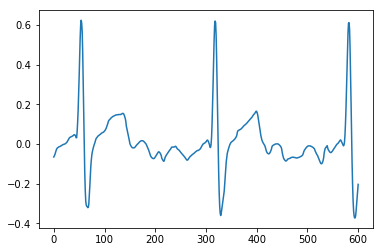

A01777
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


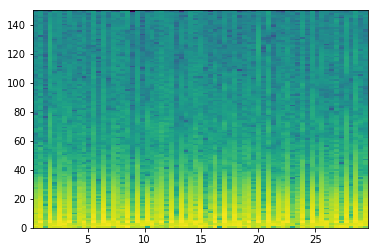

good List
[2, 13, 20, 22, 29, 38, 47, 49, 56]
[11, 7, 2, 7, 9, 9, 2, 7]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


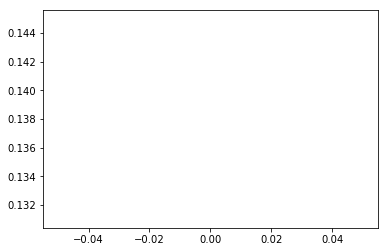

A01785
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


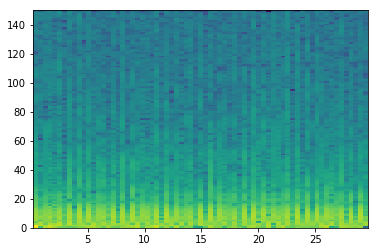

good List
[1, 4, 6, 8, 10, 12, 13, 14, 15, 16, 17, 19, 20, 23, 24, 26, 28, 30, 31, 33, 35, 37, 42, 44, 48, 51, 53, 55, 57, 58, 59, 60, 61, 62, 64, 66]
[3, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 1, 3, 1, 2, 2, 2, 1, 2, 2, 2, 5, 2, 4, 3, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2]
the temp 3
[[], [], [], [], [], [6, 7, 8, 9, 10], [12], [14], [], [], [18], [], [], [], [], [], [], [], [], [], [29, 30, 31, 32, 33], []]
[12, 13, 14, 15, 16, 17]
longest
[12, 13, 14, 15, 16, 17]
indexList
[12, 13, 14, 15, 16, 17]
theMin
1500
theMax
2100


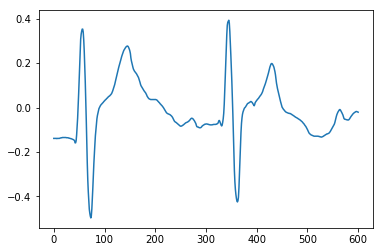

A01790
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

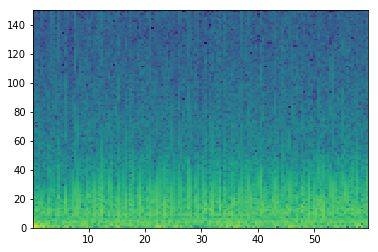

good List
[15]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


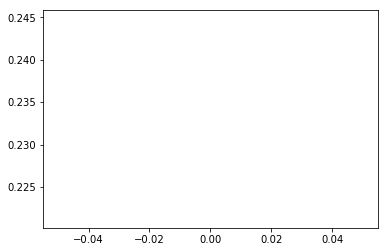

A01795
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


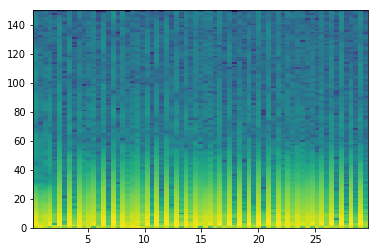

good List
[1, 2, 4, 6, 8, 10, 11, 12, 13, 15, 17, 19, 22, 24, 26, 28, 30, 32, 34, 35, 37, 39, 41, 43, 45, 47, 49, 51, 53, 56, 58, 60, 62, 64, 66, 68]
[1, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2]
the temp 3
[[1], [], [], [], [6, 7, 8], [], [], [], [], [], [], [], [], [], [19], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[10, 11, 12, 13]
longest
[10, 11, 12, 13]
indexList
[10, 11, 12, 13]
theMin
1200
theMax
1500


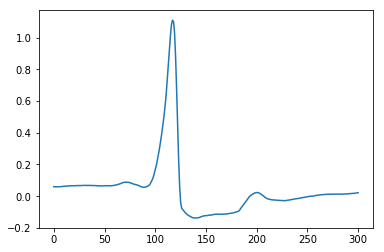

A01798
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04      ]


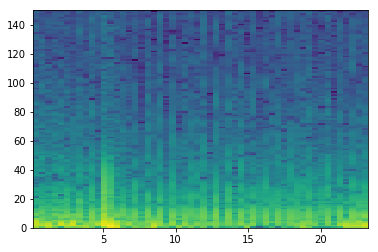

good List
[17, 21]
[4]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


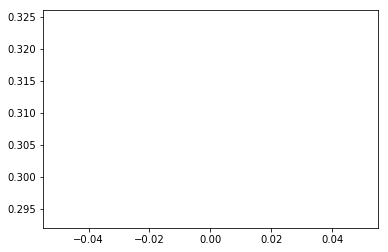

A01801
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


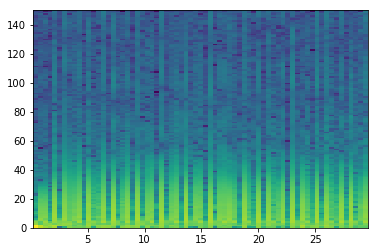

good List
[0, 1, 2, 3, 5, 7, 10, 11, 12, 13, 15, 16, 17, 20, 22, 23, 25, 27, 28, 30, 32, 33, 34, 35, 37, 41, 42, 45, 47, 49, 50, 52, 54, 55, 56, 57, 59, 61, 62, 63, 64, 66, 67]
[1, 1, 1, 2, 2, 3, 1, 1, 1, 2, 1, 1, 3, 2, 1, 2, 2, 1, 2, 2, 1, 1, 1, 2, 4, 1, 3, 2, 2, 1, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1]
the temp 3
[[1, 2, 3], [], [], [7, 8, 9], [11, 12], [], [15], [], [18], [], [21, 22, 23], [], [26], [], [], [30], [], [33, 34, 35], [], [38, 39, 40]]
[0, 1, 2, 3]
longest
[0, 1, 2, 3]
indexList
[0, 1, 2, 3]
theMin
0
theMax
300


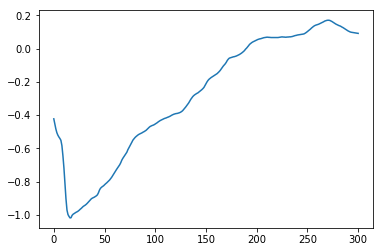

A01809
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

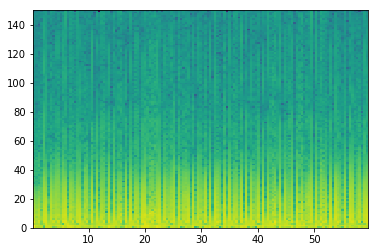

good List
[23, 30, 32, 34, 37, 39, 44, 53, 59, 65, 67, 72, 74, 78, 87, 94, 96, 108, 116, 122, 124, 130, 136]
[7, 2, 2, 3, 2, 5, 9, 6, 6, 2, 5, 2, 4, 9, 7, 2, 12, 8, 6, 2, 6, 6]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


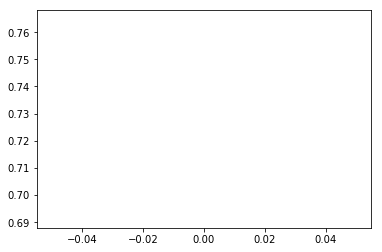

A01813
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


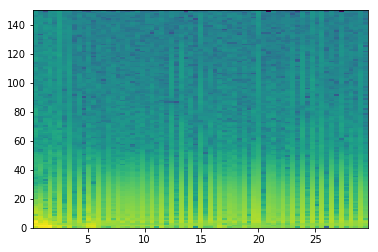

good List
[6, 8, 10, 14, 16, 18, 21, 23, 24, 25, 27, 29, 31, 33, 35, 37, 42, 44, 47, 50, 51, 54, 56, 58, 60, 62, 64, 66, 68]
[2, 2, 4, 2, 2, 3, 2, 1, 1, 2, 2, 2, 2, 2, 2, 5, 2, 3, 3, 1, 3, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [8, 9], [], [], [], [], [], [], [], [], [], [20], [], [], [], [], [], [], []]
[23, 24, 25]
longest
[23, 24, 25]
indexList
[23, 24, 25]
theMin
3000
theMax
3300


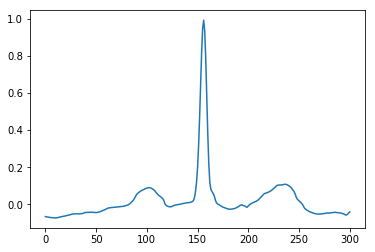

A01814
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333]


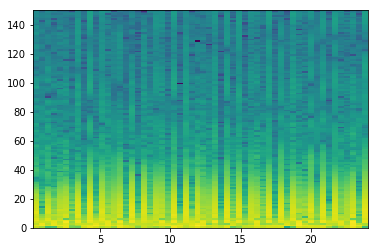

good List
[6, 8, 17, 22, 24, 31, 40, 42, 49]
[2, 9, 5, 2, 7, 9, 2, 7]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


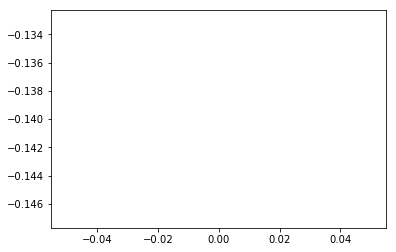

A01820
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


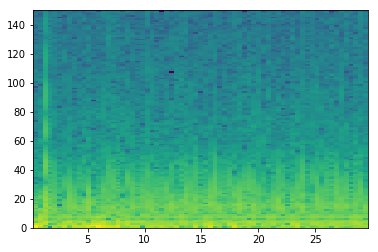

good List
[5, 8, 12, 38]
[3, 4, 26]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


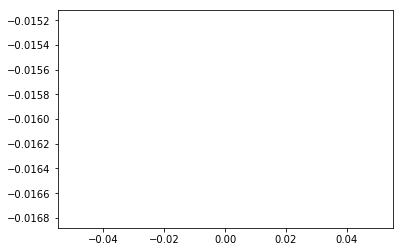

A01822
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


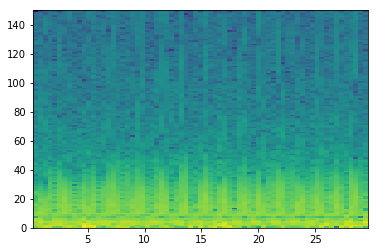

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


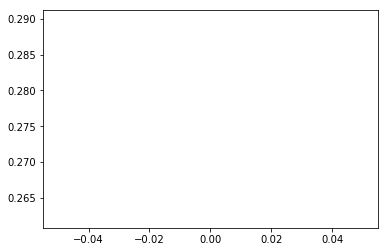

A01825
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


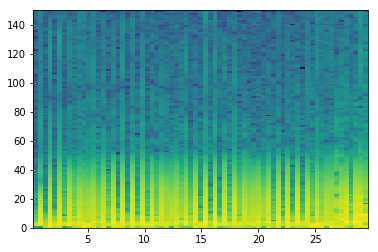

good List
[0, 2, 4, 6, 7, 8, 9, 10, 13, 15, 17, 19, 21, 23, 25, 27, 30, 32, 34, 36, 38, 40, 42, 45, 46, 47, 49, 51, 53, 55, 57]
[2, 2, 2, 1, 1, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 3, 1, 1, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [4, 5, 6, 7], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [24, 25], [], [], [], []]
[6, 7, 8, 9, 10]
longest
[6, 7, 8, 9, 10]
indexList
[6, 7, 8, 9, 10]
theMin
600
theMax
1200


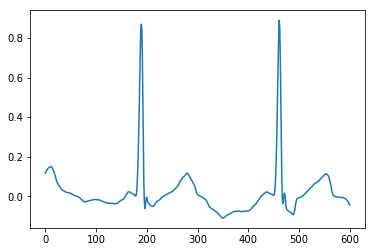

A01826
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


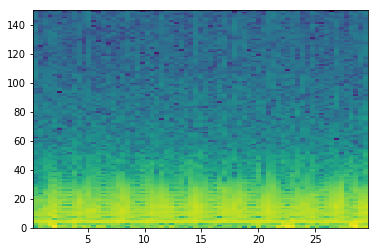

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


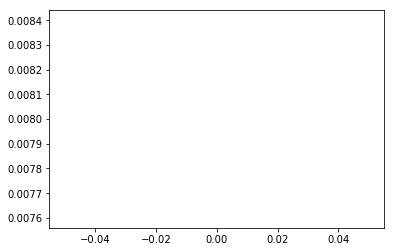

A01829
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


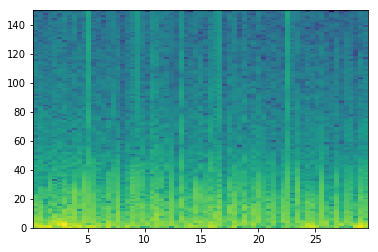

good List
[18, 29, 39, 50, 61, 63]
[11, 10, 11, 11, 2]
the temp 3
[[], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


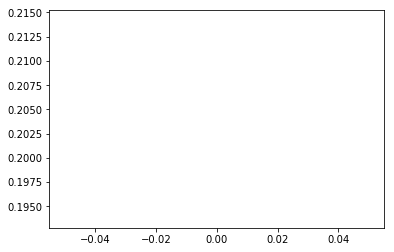

A01834
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

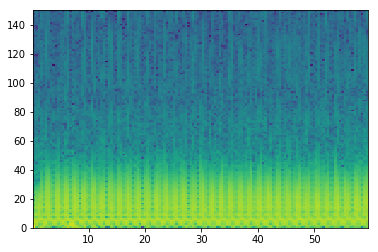

good List
[0, 34]
[34]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


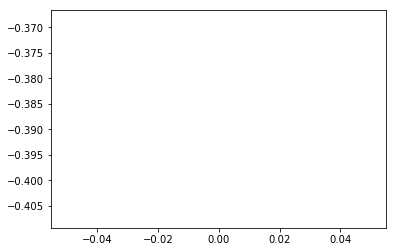

A01836
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667]


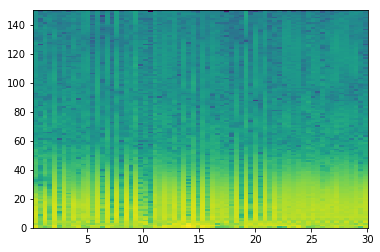

good List
[16, 22]
[6]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


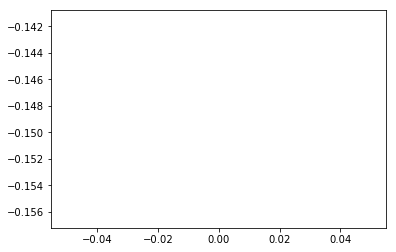

A01839
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

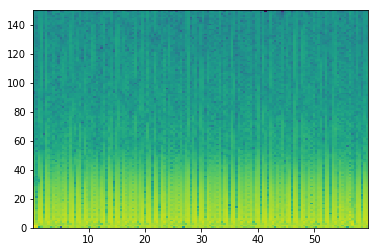

good List
[1, 4, 20, 25, 27, 30, 46, 49, 51, 55, 68, 71, 78, 81, 84, 91, 94, 97, 107, 110, 123, 133, 136]
[3, 16, 5, 2, 3, 16, 3, 2, 4, 13, 3, 7, 3, 3, 7, 3, 3, 10, 3, 13, 10, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


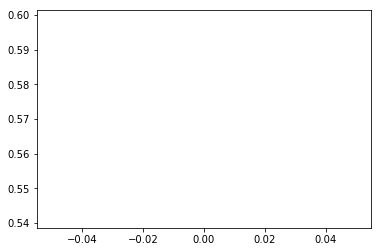

A01842
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667]


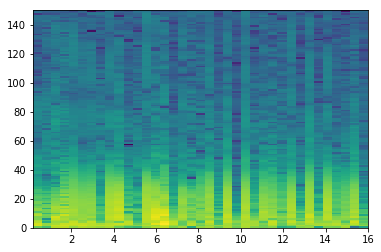

good List
[0, 1, 5, 6, 10, 11, 12, 15, 18, 20, 22, 24, 27, 29, 31, 33, 36]
[1, 4, 1, 4, 1, 1, 3, 3, 2, 2, 2, 3, 2, 2, 2, 3]
the temp 3
[[1], [3], [5, 6], [], [], [], [], [], [], [], [], []]
[10, 11, 12]
longest
[10, 11, 12]
indexList
[10, 11, 12]
theMin
1200
theMax
1500


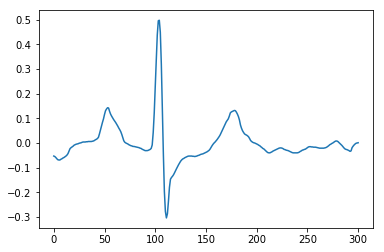

A01846
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

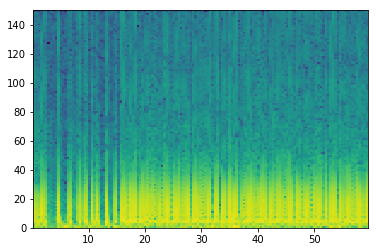

good List
[6, 7, 8, 9, 11, 12, 13, 17, 18, 20, 23, 27, 28, 29, 31, 32, 35, 46, 65, 77, 85, 86, 120, 131]
[1, 1, 1, 2, 1, 1, 4, 1, 2, 3, 4, 1, 1, 2, 1, 3, 11, 19, 12, 8, 1, 34, 11]
the temp 3
[[1, 2, 3], [5, 6], [8], [], [], [12, 13], [15], [], [], [], [], [21], []]
[6, 7, 8, 9]
longest
[6, 7, 8, 9]
indexList
[6, 7, 8, 9]
theMin
600
theMax
1200


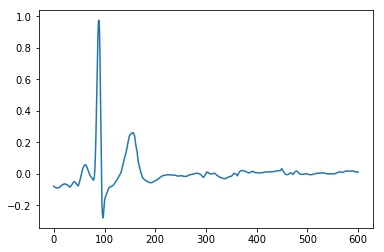

A01852
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


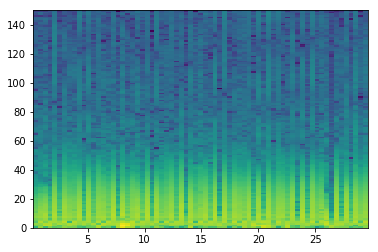

good List
[24, 38, 45, 49, 56, 58, 61]
[14, 7, 4, 7, 2, 3]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


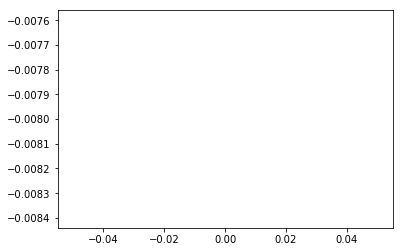

A01860
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


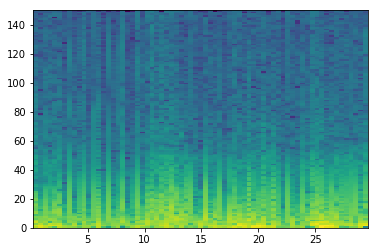

good List
[6, 11, 14, 16, 19, 20, 22, 34, 51, 54]
[5, 3, 2, 3, 1, 2, 12, 17, 3]
the temp 3
[[], [], [], [], [5], [], [], []]
[19, 20]
longest
[19, 20]
indexList
[19, 20]
theMin
2400
theMax
2700


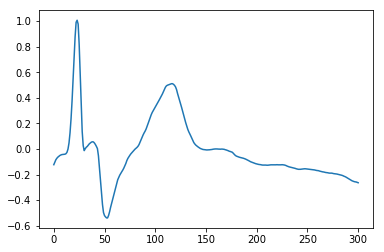

A01872
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


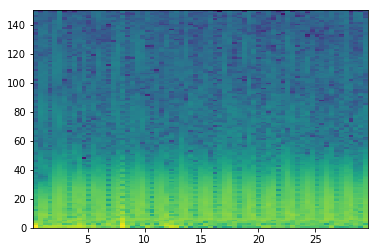

good List
[0, 2, 3, 11, 13, 14, 15, 16, 19, 24, 25, 33, 34, 46, 47, 58, 59, 62, 63, 65, 66]
[2, 1, 8, 2, 1, 1, 1, 3, 5, 1, 8, 1, 12, 1, 11, 1, 3, 1, 2, 1]
the temp 3
[[], [2], [], [5, 6, 7], [], [10], [12], [14], [16], [18]]
[13, 14, 15, 16]
longest
[13, 14, 15, 16]
indexList
[13, 14, 15, 16]
theMin
1500
theMax
2100


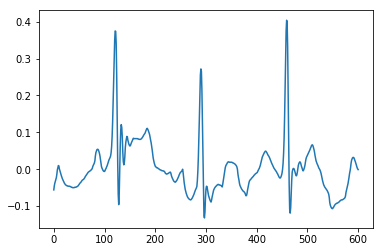

A01873
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


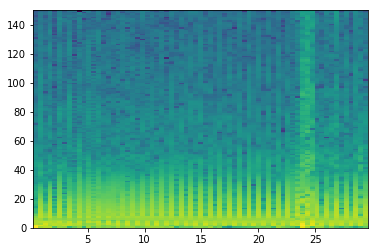

good List
[2, 4, 10, 12, 14, 33, 35, 39, 41, 43, 49]
[2, 6, 2, 2, 19, 2, 4, 2, 2, 6]
the temp 3
[[], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


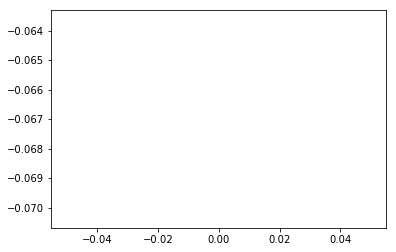

A01876
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


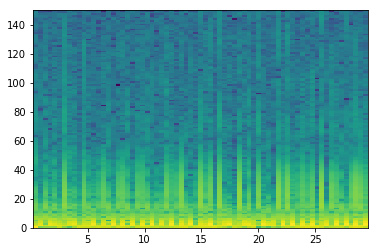

good List
[1, 2, 3, 4, 5, 9, 11, 12, 13, 15, 16, 17, 20, 21, 22, 23, 24, 25, 26, 29, 31, 32, 33, 35, 37, 39, 40, 41, 43, 44, 45, 47, 48, 49, 51, 53, 54, 56, 57, 58, 60, 61, 62, 63, 64, 65]
[1, 1, 1, 1, 4, 2, 1, 1, 2, 1, 1, 3, 1, 1, 1, 1, 1, 1, 3, 2, 1, 1, 2, 2, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1]
the temp 3
[[1, 2, 3, 4], [], [7, 8], [10, 11], [13, 14, 15, 16, 17, 18], [], [21, 22], [], [], [26, 27], [29, 30], [32, 33], [], [36], [38, 39]]
[20, 21, 22, 23, 24, 25, 26]
longest
[20, 21, 22, 23, 24, 25, 26]
indexList
[20, 21, 22, 23, 24, 25, 26]
theMin
2400
theMax
3300


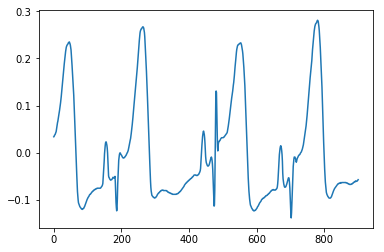

A01880
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


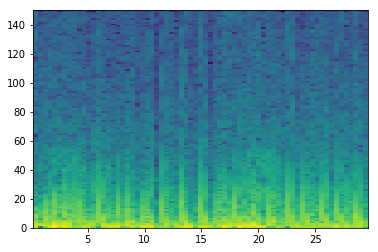

good List
[25, 36]
[11]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


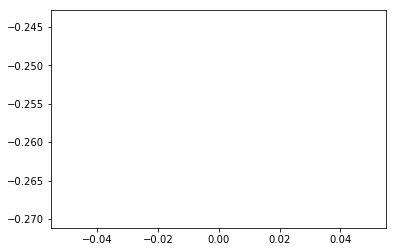

A01890
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

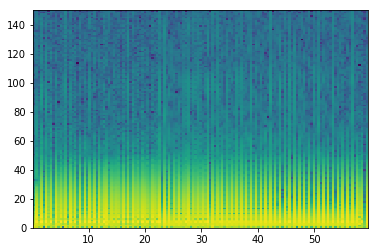

good List
[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 23, 24, 26, 28, 29, 31, 32, 33, 34, 35, 36, 38, 40, 42, 44, 46, 48, 49, 50, 51, 53, 55, 57, 59, 61, 65, 70, 71, 73, 75, 77, 79, 83, 85, 87, 91, 93, 95, 97, 99, 101, 103, 105, 107, 109, 111, 113, 115, 117, 119, 121, 123, 125, 127, 129, 131, 133, 135, 137]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 4, 5, 1, 2, 2, 2, 2, 4, 2, 2, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [12, 13], [], [16], [18, 19, 20, 21, 22], [], [], [], [], [], [29, 30, 31], [], [], [], [], [], [], [39], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[31, 32, 33, 34, 35, 36]
longest
[31, 32, 33, 34, 35, 36]
indexList
[31, 32, 33, 34, 35, 36]
theMin
3900
theMax
4500


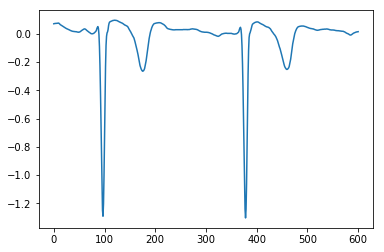

A01891
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


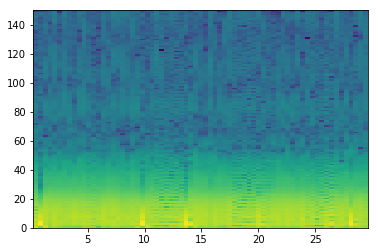

good List
[1, 3, 4, 8, 14, 19, 30, 39, 40, 46, 54, 57, 59, 63, 67]
[2, 1, 4, 6, 5, 11, 9, 1, 6, 8, 3, 2, 4, 4]
the temp 3
[[], [2], [], [], [], [], [8], [], [], [], [], []]
[3, 4]
longest
[3, 4]
indexList
[3, 4]
theMin
300
theMax
600


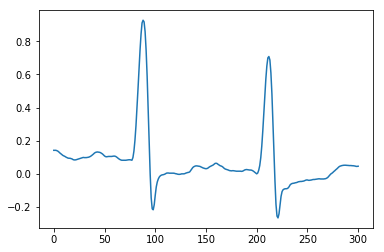

A01893
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


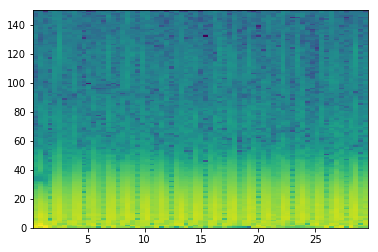

good List
[2, 27, 28, 32, 42, 43, 46, 48, 60]
[25, 1, 4, 10, 1, 3, 2, 12]
the temp 3
[[], [2], [], [5], [], []]
[27, 28]
longest
[27, 28]
indexList
[27, 28]
theMin
3300
theMax
3600


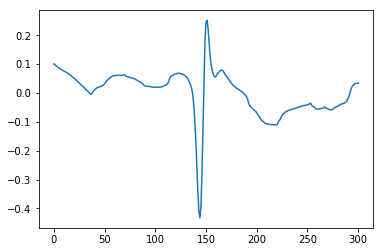

A01897
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

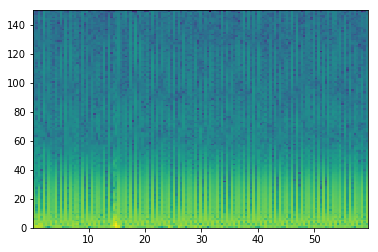

good List
[3, 5, 7, 8, 10, 12, 14, 16, 19, 21, 23, 26, 28, 30, 32, 37, 39, 41, 43, 45, 46, 48, 50, 52, 55, 57, 59, 63, 66, 68, 70, 75, 77, 79, 81, 83, 84, 86, 88, 90, 92, 94, 95, 97, 99, 101, 103, 104, 106, 108, 110, 112, 117, 119, 121, 123, 128, 130, 132, 135, 137]
[2, 2, 1, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 5, 2, 2, 2, 2, 1, 2, 2, 2, 3, 2, 2, 4, 3, 2, 2, 5, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 5, 2, 2, 2, 5, 2, 2, 3, 2]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [20], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [36], [], [], [], [], [42], [], [], [], [47], [], [], [], [], [], [], [], [], [], [], [], []]
[7, 8]
longest
[7, 8]
indexList
[7, 8]
theMin
900
theMax
1200


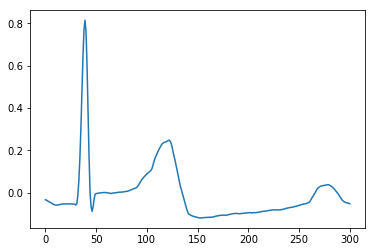

A01902
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


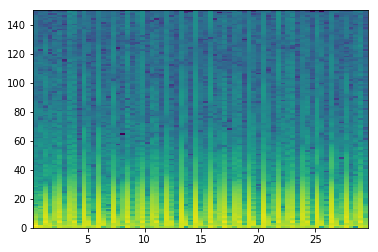

good List
[0, 6, 9, 11, 12, 14, 17, 18, 20, 23, 26, 29, 32, 40, 43, 46, 49, 51, 54, 57, 60, 63, 65, 68]
[6, 3, 2, 1, 2, 3, 1, 2, 3, 3, 3, 3, 8, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3]
the temp 3
[[], [], [], [4], [], [7], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


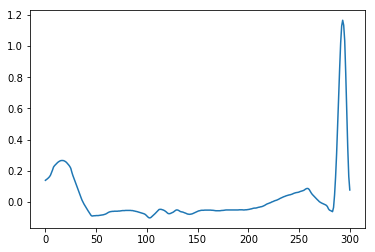

A01903
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667]


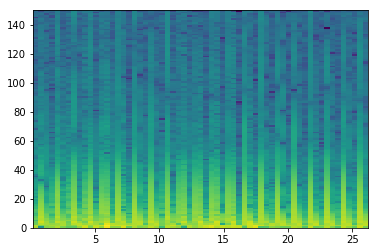

good List
[0, 3, 6, 8, 11, 14, 17, 19, 20, 22, 23, 25, 26, 28, 31, 34, 37, 39, 40, 43, 46, 48, 49, 51, 52, 54, 55, 57, 58]
[3, 3, 2, 3, 3, 3, 2, 1, 2, 1, 2, 1, 2, 3, 3, 3, 2, 1, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [], [], [], [], [], [], [8], [10], [12], [], [], [], [], [18], [], [], [22], [24], [26]]
[19, 20]
longest
[19, 20]
indexList
[19, 20]
theMin
2400
theMax
2700


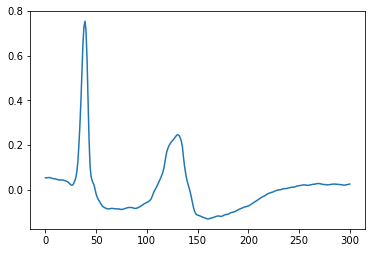

A01907
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


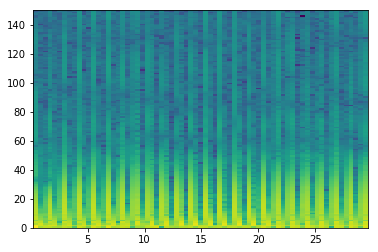

good List
[1, 2, 4, 5, 7, 8, 10, 11, 13, 14, 16, 17, 19, 22, 25, 28, 30, 31, 33, 34, 36, 37, 39, 40, 43, 45, 46, 48, 49, 51, 52, 54, 57, 58, 60, 61, 63, 64, 66, 67]
[1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 3, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[1], [3], [5], [7], [9], [11], [], [], [], [], [17], [19], [21], [23], [], [26], [28], [30], [], [33], [35], [37]]
[1, 2]
longest
[1, 2]
indexList
[1, 2]
theMin
0
theMax
300


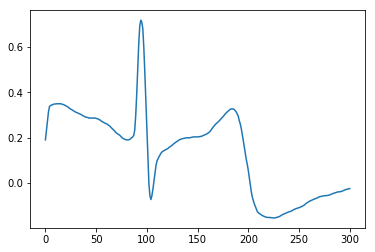

A01909
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

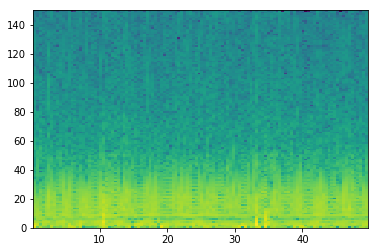

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


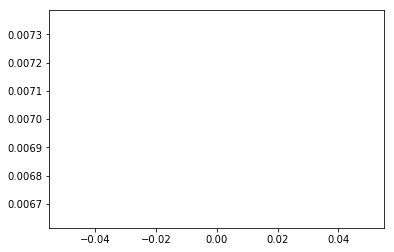

A01913
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

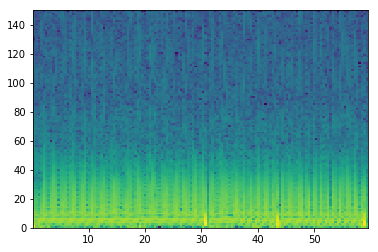

good List
[12, 18, 23, 27, 30, 45, 54, 58, 69, 72, 75, 102, 103, 104, 111, 112, 118, 123, 126, 131, 135, 138]
[6, 5, 4, 3, 15, 9, 4, 11, 3, 3, 27, 1, 1, 7, 1, 6, 5, 3, 5, 4, 3]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [12, 13], [15], [], [], [], [], []]
[102, 103, 104]
longest
[102, 103, 104]
indexList
[102, 103, 104]
theMin
12900
theMax
13200


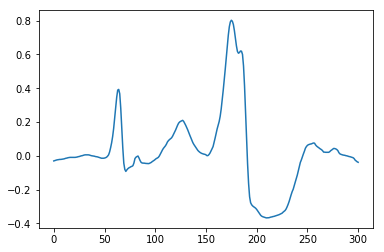

A01916
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

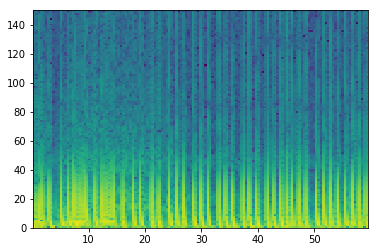

good List
[8, 9, 10, 53, 54, 55, 58, 60, 61, 64, 65, 68, 71, 74, 75, 78, 81, 84, 85, 88, 91, 94, 95, 96, 98, 101, 104, 108, 111, 114, 115, 116, 119, 122, 124, 125, 128, 131, 136]
[1, 1, 43, 1, 1, 3, 2, 1, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 1, 2, 3, 3, 4, 3, 3, 1, 1, 3, 3, 2, 1, 3, 3, 5]
the temp 3
[[1, 2], [4, 5], [], [8], [10], [], [], [14], [], [], [18], [], [], [22, 23], [], [], [], [], [], [30, 31], [], [], [35], [], []]
[8, 9, 10]
longest
[8, 9, 10]
indexList
[8, 9, 10]
theMin
900
theMax
1200


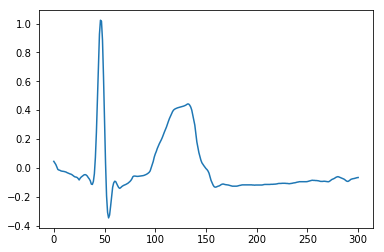

A01918
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


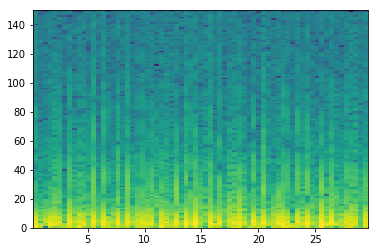

good List
[0, 1, 2, 3, 5, 6, 8, 11, 13, 15, 16, 18, 20, 21, 23, 25, 28, 30, 34, 35, 37, 39, 43, 44, 46, 48, 49, 50, 52, 53, 55, 57, 58, 60, 62, 63, 67, 68]
[1, 1, 1, 2, 1, 2, 3, 2, 2, 1, 2, 2, 1, 2, 2, 3, 2, 4, 1, 2, 2, 4, 1, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 2, 1, 4, 1]
the temp 3
[[1, 2, 3], [5], [], [], [], [10], [], [13], [], [], [], [], [19], [], [], [23], [], [26, 27], [29], [], [32], [], [35]]
[0, 1, 2, 3]
longest
[0, 1, 2, 3]
indexList
[0, 1, 2, 3]
theMin
0
theMax
300


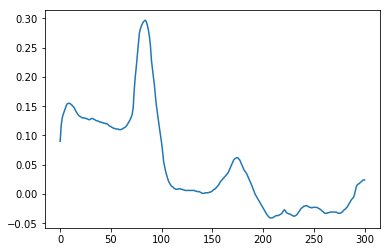

A01919
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


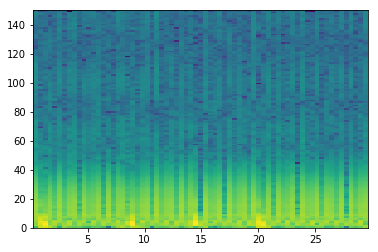

good List
[1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 52, 53, 54, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68]
[1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[1, 2, 3, 4, 5], [7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30], [32, 33, 34, 35, 36, 37, 38, 39, 40, 41], [43, 44, 45, 46, 47, 48, 49, 50]]
[8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]
longest
[8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]
indexList
[8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]
theMin
900
theMax
4200


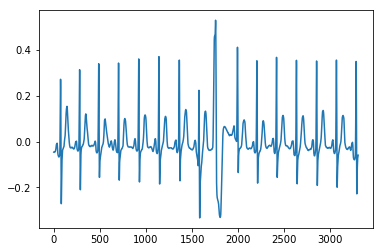

A01921
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

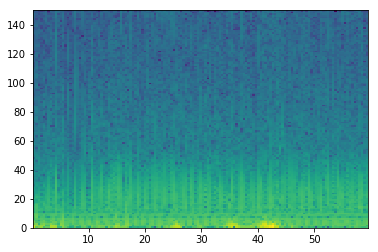

good List
[3, 13, 15, 16, 18, 19, 22, 92]
[10, 2, 1, 2, 1, 3, 70]
the temp 3
[[], [], [3], [5], []]
[15, 16]
longest
[15, 16]
indexList
[15, 16]
theMin
1800
theMax
2100


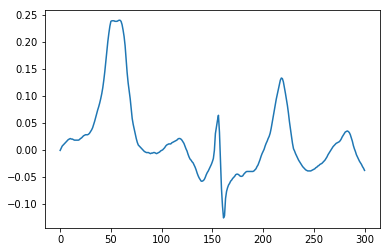

A01925
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


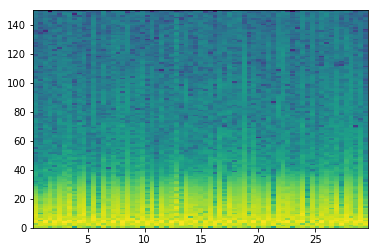

good List
[0, 1, 13, 25, 30, 32, 33, 53, 54, 58, 68]
[1, 12, 12, 5, 2, 1, 20, 1, 4, 10]
the temp 3
[[1], [], [], [], [6], [8], []]
[0, 1]
longest
[0, 1]
indexList
[0, 1]
theMin
0
theMax
300


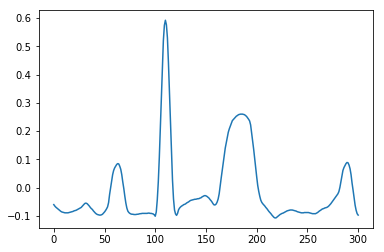

A01928
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


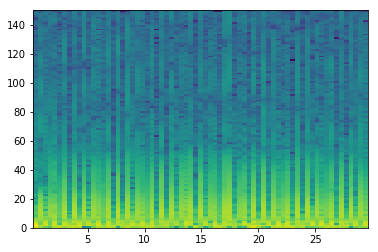

good List
[0, 5, 7, 9, 11, 14, 16, 18, 23, 25, 27, 29, 33, 35, 38, 41, 42, 43, 44, 46, 48, 50, 51, 53, 55, 57, 60, 62, 64, 66]
[5, 2, 2, 2, 3, 2, 2, 5, 2, 2, 2, 4, 2, 3, 3, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 3, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [16, 17, 18], [], [], [22], [], [], [], [], [], []]
[41, 42, 43, 44]
longest
[41, 42, 43, 44]
indexList
[41, 42, 43, 44]
theMin
5100
theMax
5700


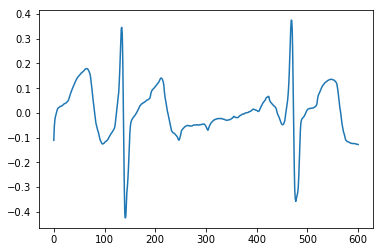

A01929
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

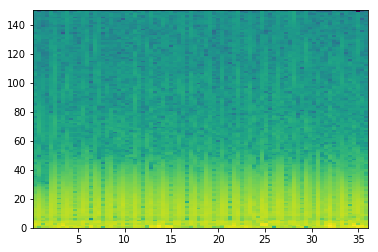

good List
[2, 3, 10, 16, 17, 20, 23, 27, 30, 31, 35, 38, 42, 59]
[1, 7, 6, 1, 3, 3, 4, 3, 1, 4, 3, 4, 17]
the temp 3
[[1], [], [4], [], [], [], [9], [], [], []]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


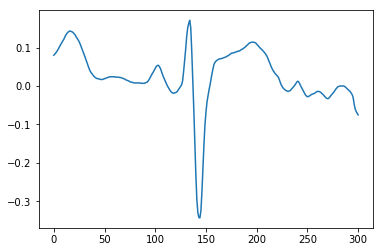

A01937
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


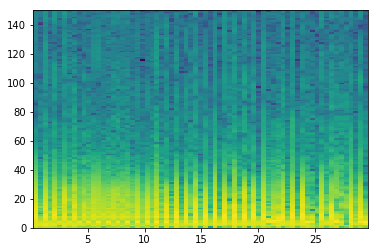

good List
[1, 20, 21, 22, 28, 30, 34, 36, 46, 52, 54, 58, 66, 68]
[19, 1, 1, 6, 2, 4, 2, 10, 6, 2, 4, 8, 2]
the temp 3
[[], [2, 3], [], [], [], [], [], [], [], [], []]
[20, 21, 22]
longest
[20, 21, 22]
indexList
[20, 21, 22]
theMin
2400
theMax
2700


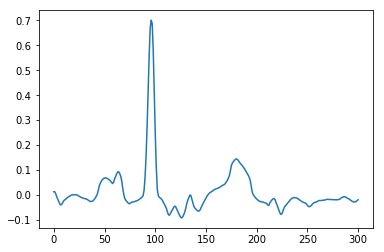

A01944
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


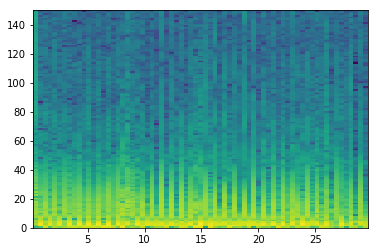

good List
[2, 7, 8, 10, 12, 14, 16, 21, 23, 25, 27, 29, 31, 36, 38, 40, 42, 44, 46, 48, 50, 52, 61, 63, 64, 66, 68]
[5, 1, 2, 2, 2, 2, 5, 2, 2, 2, 2, 2, 5, 2, 2, 2, 2, 2, 2, 2, 2, 9, 2, 1, 2, 2]
the temp 3
[[], [2], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [24], []]
[7, 8]
longest
[7, 8]
indexList
[7, 8]
theMin
900
theMax
1200


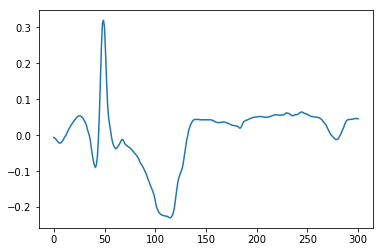

A01946
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


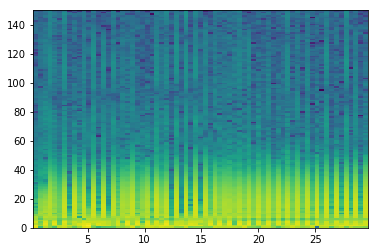

good List
[0, 1, 2, 5, 7, 9, 11, 13, 15, 17, 18, 19, 22, 23, 24, 28, 30, 32, 34, 36, 37, 38, 39, 40, 43, 45, 47, 49, 50, 51, 53, 55, 57, 59, 61, 63, 65, 67]
[1, 1, 3, 2, 2, 2, 2, 2, 2, 1, 1, 3, 1, 1, 4, 2, 2, 2, 2, 1, 1, 1, 1, 3, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2]
the temp 3
[[1, 2], [], [], [], [], [], [], [10, 11], [13, 14], [], [], [], [], [20, 21, 22, 23], [], [], [], [28, 29], [], [], [], [], [], [], []]
[36, 37, 38, 39, 40]
longest
[36, 37, 38, 39, 40]
indexList
[36, 37, 38, 39, 40]
theMin
4500
theMax
5100


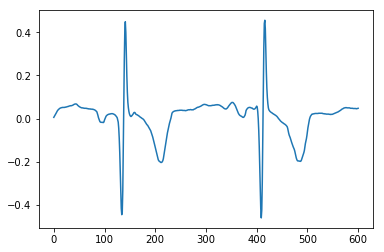

A01954
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


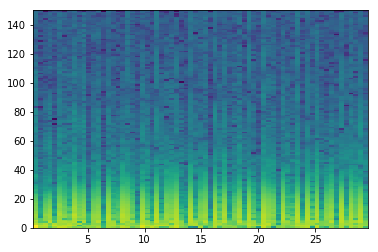

good List
[1, 2, 4, 6, 7, 9, 11, 12, 13, 14, 17, 20, 21, 24, 26, 27, 29, 30, 31, 32, 33, 34, 35, 36, 38, 40, 41, 43, 44, 45, 46, 48, 50, 51, 53, 55, 57, 59, 60, 61, 62, 66, 68]
[1, 2, 2, 1, 2, 2, 1, 1, 1, 3, 3, 1, 3, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 4, 2]
the temp 3
[[1], [], [4], [], [7, 8, 9], [], [12], [], [15], [17, 18, 19, 20, 21, 22, 23], [], [26], [28, 29, 30], [], [33], [], [], [], [38, 39, 40], []]
[29, 30, 31, 32, 33, 34, 35, 36]
longest
[29, 30, 31, 32, 33, 34, 35, 36]
indexList
[29, 30, 31, 32, 33, 34, 35, 36]
theMin
3600
theMax
4500


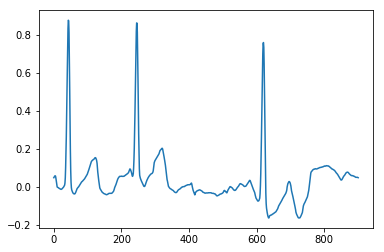

A01955
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


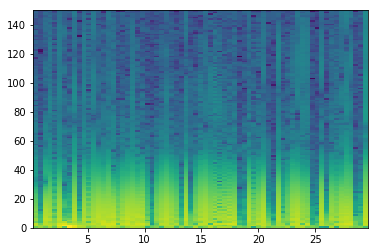

good List
[1, 6, 7, 9, 17, 18, 24, 25, 29, 30, 32, 33, 42, 43, 45, 46, 48, 49, 51, 57, 58, 60, 66, 67]
[5, 1, 2, 8, 1, 6, 1, 4, 1, 2, 1, 9, 1, 2, 1, 2, 1, 2, 6, 1, 2, 6, 1]
the temp 3
[[], [2], [], [5], [7], [9], [11], [13], [15], [17], [], [20], []]
[6, 7]
longest
[6, 7]
indexList
[6, 7]
theMin
600
theMax
900


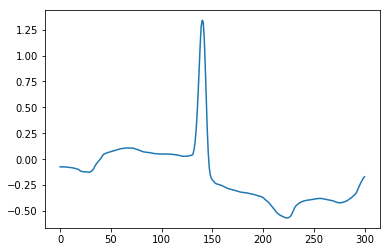

A01961
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


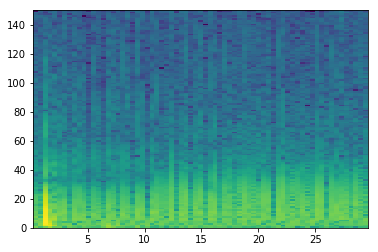

good List
[14, 23, 26, 35, 38, 54, 65]
[9, 3, 9, 3, 16, 11]
the temp 3
[[], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


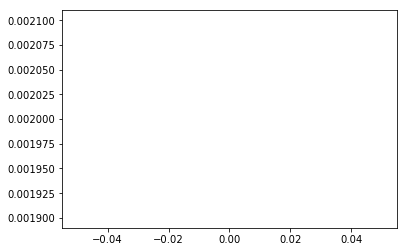

A01962
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

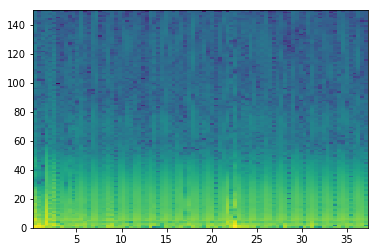

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


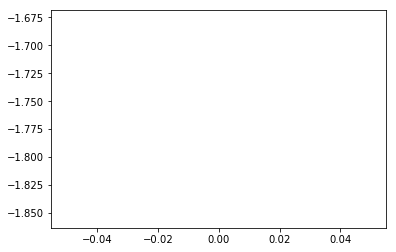

A01970
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


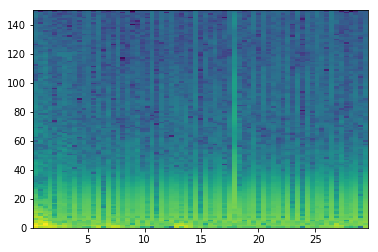

good List
[9, 11, 12, 16, 18, 22, 23, 25, 27, 32, 34, 39, 43, 46, 47, 48, 49, 50, 51, 53, 55, 57, 64, 65]
[2, 1, 4, 2, 4, 1, 2, 2, 5, 2, 5, 4, 3, 1, 1, 1, 1, 1, 2, 2, 2, 7, 1]
the temp 3
[[], [2], [], [], [6], [], [], [], [], [], [], [14, 15, 16, 17, 18], [], [], []]
[46, 47, 48, 49, 50, 51]
longest
[46, 47, 48, 49, 50, 51]
indexList
[46, 47, 48, 49, 50, 51]
theMin
6000
theMax
6600


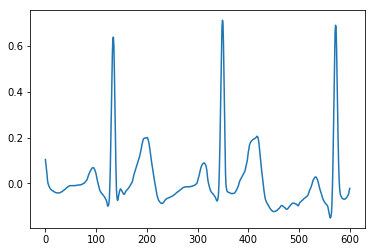

A01974
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


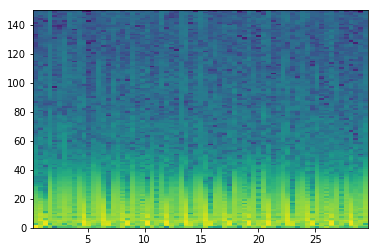

good List
[11, 32, 38, 39, 42, 49, 53]
[21, 6, 1, 3, 7, 4]
the temp 3
[[], [], [3], [], []]
[38, 39]
longest
[38, 39]
indexList
[38, 39]
theMin
4800
theMax
5100


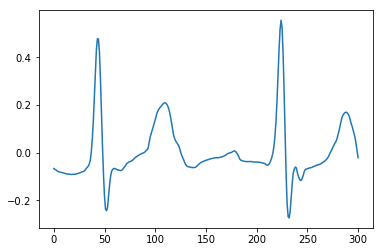

A01983
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


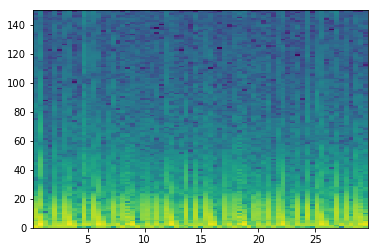

good List
[2, 3, 5, 26, 37, 38, 47, 49, 55, 57, 65]
[1, 2, 21, 11, 1, 9, 2, 6, 2, 8]
the temp 3
[[1], [], [], [5], [], [], [], []]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


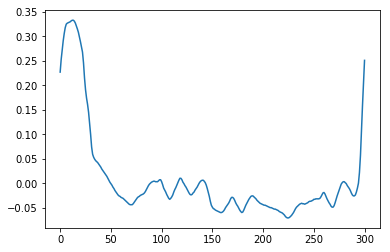

A01997
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


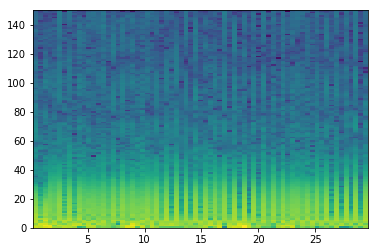

good List
[2, 17, 30, 48, 50, 52, 61, 63, 65, 67]
[15, 13, 18, 2, 2, 9, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


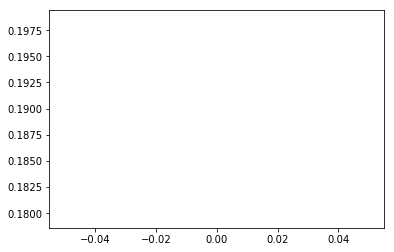

A01999
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


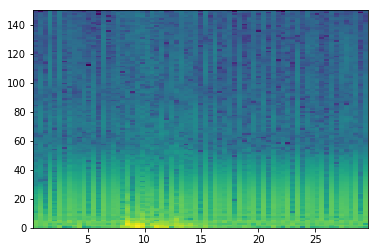

good List
[6, 13, 36, 38, 41, 53, 55, 60, 62]
[7, 23, 2, 3, 12, 2, 5, 2]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


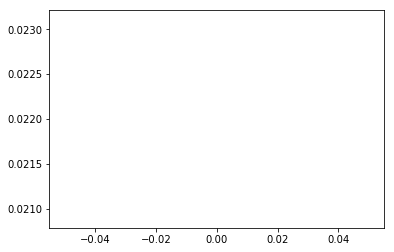

A02002
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


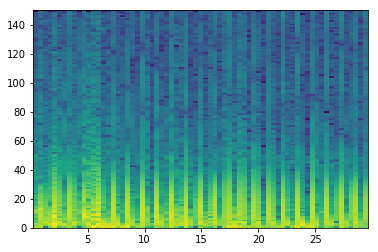

good List
[2, 17, 18, 20, 21, 24, 26, 27, 29, 30, 32, 33, 35, 36, 38, 41, 44, 47, 50, 52, 53, 56, 58, 59, 61, 62, 64, 65, 67]
[15, 1, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 3, 3, 3, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2]
the temp 3
[[], [2], [4], [], [7], [9], [11], [13], [], [], [], [], [], [20], [], [23], [25], [27]]
[17, 18]
longest
[17, 18]
indexList
[17, 18]
theMin
2100
theMax
2400


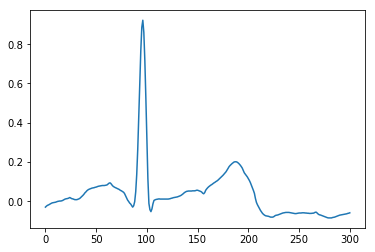

A02003
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


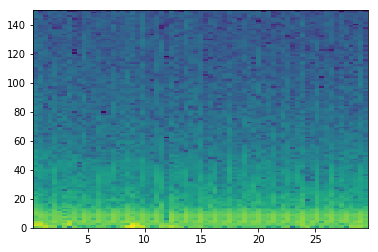

good List
[12, 27, 42]
[15, 15]
the temp 3
[[], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


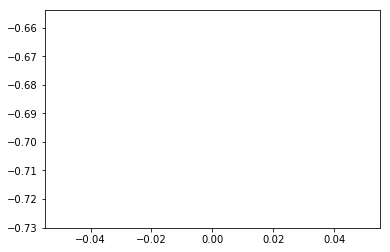

A02004
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

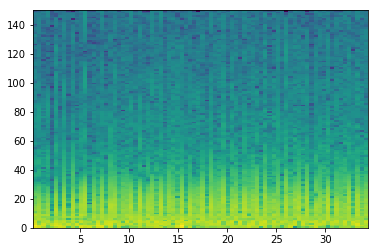

good List
[0, 4, 6, 8, 10, 13, 14, 15, 24, 38, 43]
[4, 2, 2, 2, 3, 1, 1, 9, 14, 5]
the temp 3
[[], [], [], [], [], [6, 7], [], []]
[13, 14, 15]
longest
[13, 14, 15]
indexList
[13, 14, 15]
theMin
1500
theMax
1800


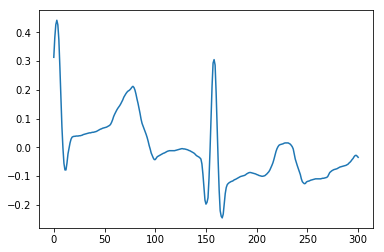

A02005
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

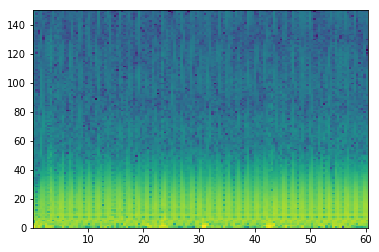

good List
[11, 14, 21, 24, 34, 45, 49, 60, 61, 75, 76, 79, 80, 83, 88, 91, 92, 111, 114]
[3, 7, 3, 10, 11, 4, 11, 1, 14, 1, 3, 1, 3, 5, 3, 1, 19, 3]
the temp 3
[[], [], [], [], [], [], [], [8], [10], [12], [], [], [16], []]
[60, 61]
longest
[60, 61]
indexList
[60, 61]
theMin
7800
theMax
8100


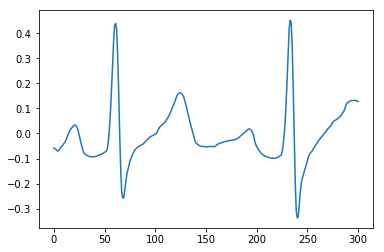

A02007
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


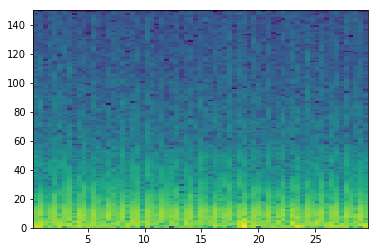

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


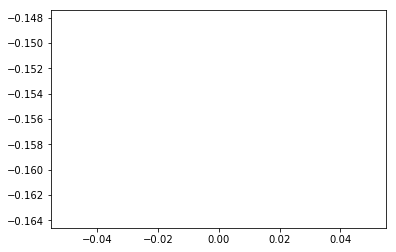

A02011
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

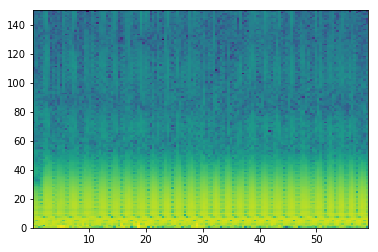

good List
[3, 9, 11, 13, 20, 23, 26, 35, 36, 42, 47, 57, 74, 78, 79, 87, 93, 114, 119, 120, 131]
[6, 2, 2, 7, 3, 3, 9, 1, 6, 5, 10, 17, 4, 1, 8, 6, 21, 5, 1, 11]
the temp 3
[[], [], [], [], [], [], [], [8], [], [], [], [], [14], [], [], [], [19]]
[35, 36]
longest
[35, 36]
indexList
[35, 36]
theMin
4500
theMax
4800


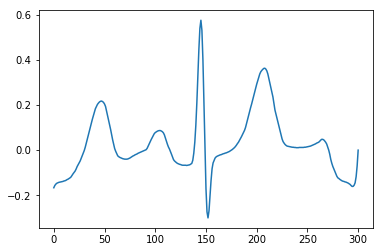

A02012
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


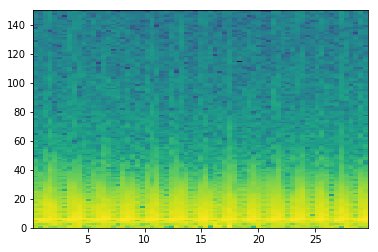

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


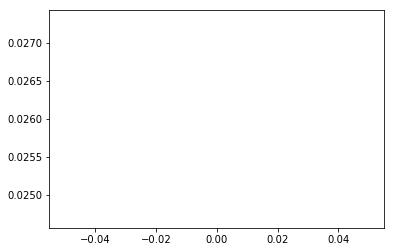

A02014
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667]


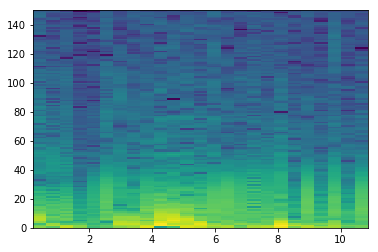

good List
[3, 4, 14, 20, 21]
[1, 10, 6, 1]
the temp 3
[[1], []]
[3, 4]
longest
[3, 4]
indexList
[3, 4]
theMin
300
theMax
600


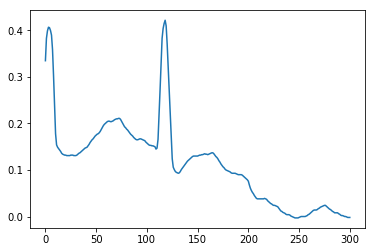

A02019
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


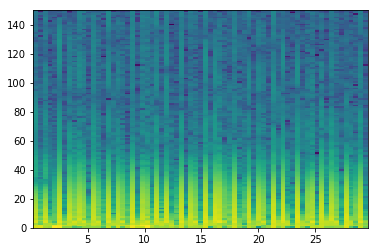

good List
[1, 3, 4, 6, 11, 13, 14, 16, 17, 18, 19, 21, 23, 24, 26, 28, 29, 31, 32, 33, 34, 36, 39, 40, 42, 43, 45, 46, 47, 48, 50, 52, 53, 55, 56, 58, 60, 62, 63, 65, 66, 68]
[2, 1, 2, 5, 2, 1, 2, 1, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 3, 1, 2, 1, 2, 1, 1, 1, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 1, 2]
the temp 3
[[], [2], [], [], [6], [8, 9, 10], [], [13], [], [16], [18, 19, 20], [], [23], [25], [27, 28, 29], [], [32], [34], [], [], [38], [40]]
[16, 17, 18, 19]
longest
[16, 17, 18, 19]
indexList
[16, 17, 18, 19]
theMin
2100
theMax
2400


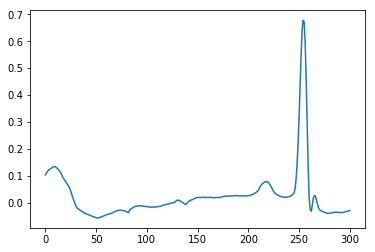

A02024
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


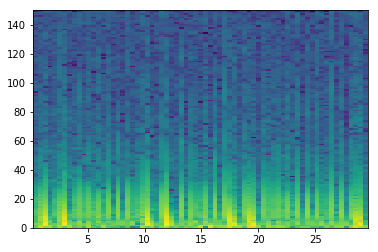

good List
[0, 1, 2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 16, 18, 19, 20, 21, 22, 24, 25, 28, 29, 31, 32, 33, 34, 35, 36, 38, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 51, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 64, 66, 68]
[1, 1, 1, 1, 3, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 2, 1, 3, 1, 2, 1, 1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2]
the temp 3
[[1, 2, 3, 4], [6, 7, 8], [10, 11], [], [14, 15, 16, 17], [19], [21], [23, 24, 25, 26, 27], [], [30, 31, 32, 33, 34, 35, 36, 37, 38], [], [41, 42, 43, 44, 45, 46, 47, 48, 49], [], []]
[40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
longest
[40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
indexList
[40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
theMin
5100
theMax
6300


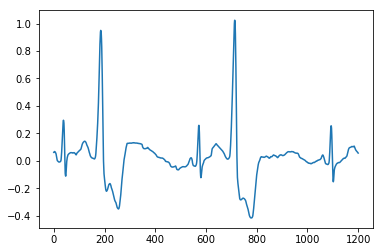

A02027
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


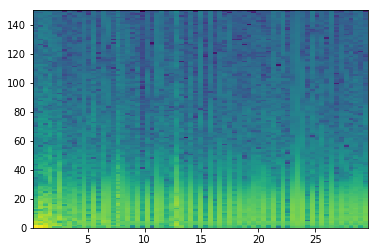

good List
[22, 31, 33, 35]
[9, 2, 2]
the temp 3
[[], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


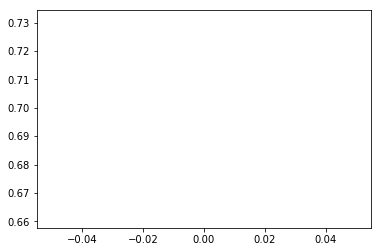

A02031
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


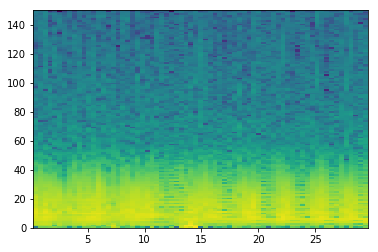

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


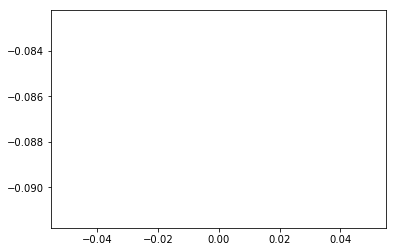

A02035
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


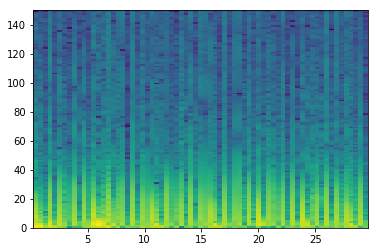

good List
[2, 4, 6, 7, 9, 11, 19, 21, 27, 28, 29, 38, 40, 43, 45, 50, 52, 54, 61, 63, 66, 68]
[2, 2, 1, 2, 2, 8, 2, 6, 1, 1, 9, 2, 3, 2, 5, 2, 2, 7, 2, 3, 2]
the temp 3
[[], [], [3], [], [], [], [], [9, 10], [], [], [], [], [], [], [], [], [], []]
[27, 28, 29]
longest
[27, 28, 29]
indexList
[27, 28, 29]
theMin
3300
theMax
3600


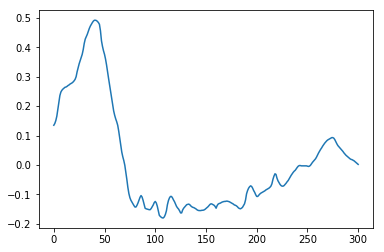

A02036
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


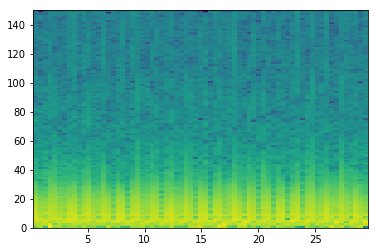

good List
[3, 36, 39, 61, 64]
[33, 3, 22, 3]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


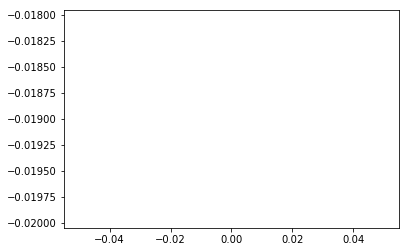

A02044
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


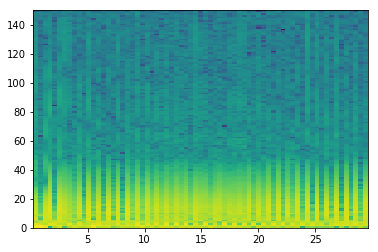

good List
[0, 1, 4, 6, 7, 8, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 63, 64, 65, 66, 67, 68]
[1, 3, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1]
the temp 3
[[1], [], [4, 5], [], [8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56]]
[12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61]
longest
[12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 4

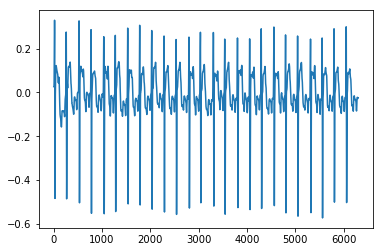

A02049
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


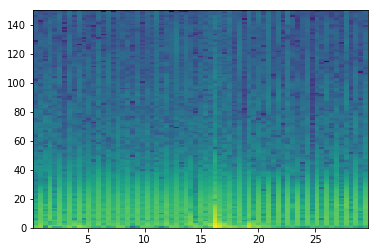

good List
[12, 57]
[45]
the temp 3
[[]]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


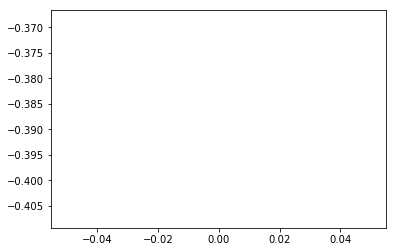

A02053
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667]


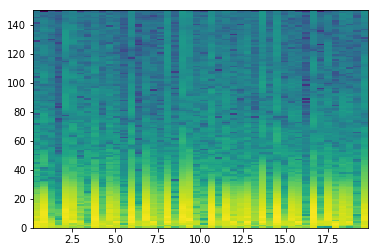

good List
[2, 3, 12, 14, 17, 19, 23, 28, 30, 37]
[1, 9, 2, 3, 2, 4, 5, 2, 7]
the temp 3
[[1], [], [], [], [], [], [], []]
[2, 3]
longest
[2, 3]
indexList
[2, 3]
theMin
300
theMax
600


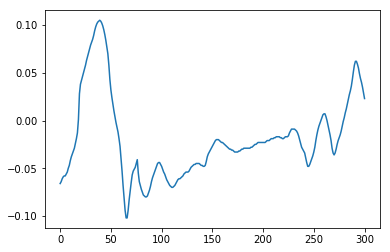

A02056
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


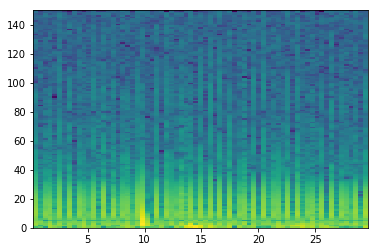

good List
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 41, 42, 43, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 61, 62, 63, 64, 65, 66, 67]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1]
the temp 3
[[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13], [15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25], [27, 28, 29, 30, 31], [33, 34], [], [37, 38, 39, 40, 41], [43, 44, 45, 46, 47], [49, 50, 51]]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
longest
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
indexList
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
theMin
0
theMax
1500


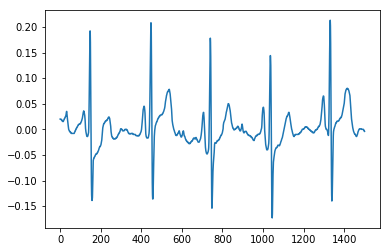

A02060
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


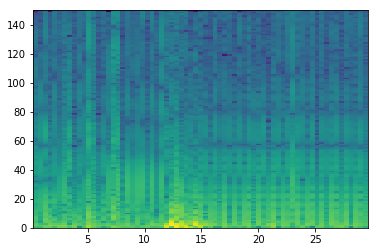

good List
[18, 20, 23, 25, 58]
[2, 3, 2, 33]
the temp 3
[[], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


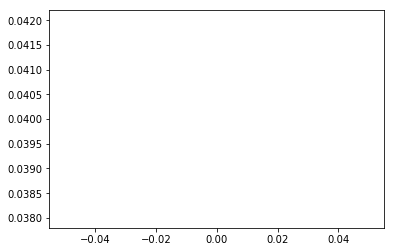

A02062
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

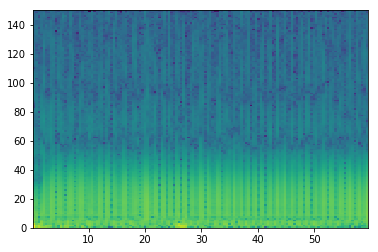

good List
[2, 6, 9, 12, 13, 14, 17, 21, 25, 26, 29, 32, 34, 35, 36, 39, 44, 48, 52, 55, 58, 61, 64, 68, 71, 74, 75, 78, 79, 80, 82, 87, 90, 91, 92, 93, 96, 99, 100, 105, 106, 109, 112, 115, 118, 122, 123, 125, 127, 128, 129, 130, 133, 136]
[4, 3, 3, 1, 1, 3, 4, 4, 1, 3, 3, 2, 1, 1, 3, 5, 4, 4, 3, 3, 3, 3, 4, 3, 3, 1, 3, 1, 1, 2, 5, 3, 1, 1, 1, 3, 3, 1, 5, 1, 3, 3, 3, 3, 4, 1, 2, 2, 1, 1, 1, 3, 3]
the temp 3
[[], [], [], [4, 5], [], [], [9], [], [], [13, 14], [], [], [], [], [], [], [], [], [], [], [26], [28, 29], [], [], [33, 34, 35], [], [38], [40], [], [], [], [], [46], [], [49, 50, 51], []]
[90, 91, 92, 93]
longest
[90, 91, 92, 93]
indexList
[90, 91, 92, 93]
theMin
11400
theMax
12000


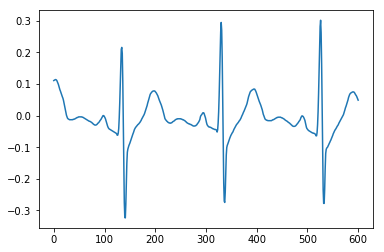

A02066
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

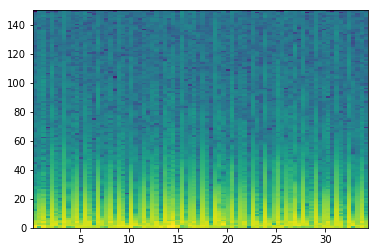

good List
[0, 1, 2, 3, 5, 6, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 32, 34, 36, 37, 38, 39, 41, 42, 43, 45, 46, 48, 49, 50, 51, 53, 54, 56, 57, 59, 60, 61, 63, 65, 66, 67, 68, 69, 70, 71, 73, 74, 76, 77, 78, 79]
[1, 1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1]
the temp 3
[[1, 2, 3], [5], [7, 8, 9], [11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25], [], [], [], [30, 31, 32], [34, 35], [37], [39, 40, 41], [43], [45], [47, 48], [], [51, 52, 53, 54, 55, 56], [58]]
[13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28]
longest
[13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28]
indexList
[13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28]
theMin
1500
theMax
3600


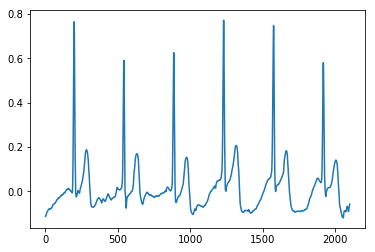

A02067
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


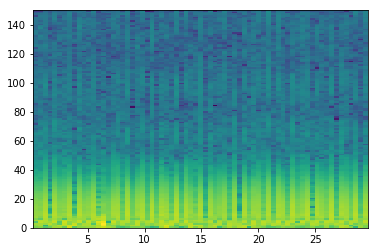

good List
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 62, 63, 64, 65, 66, 67, 68]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1]
the temp 3
[[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]
longest
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11

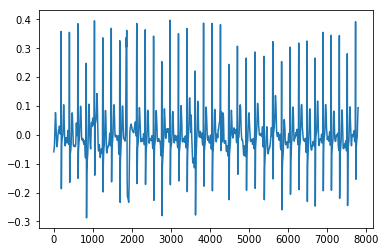

A02068
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


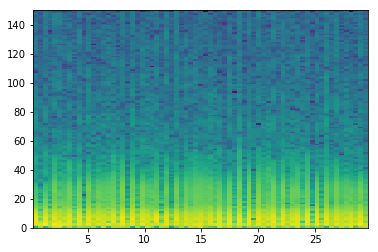

good List
[1, 8, 10, 19, 28, 30, 35, 39, 41, 45, 50, 57, 59, 61, 63, 68]
[7, 2, 9, 9, 2, 5, 4, 2, 4, 5, 7, 2, 2, 2, 5]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


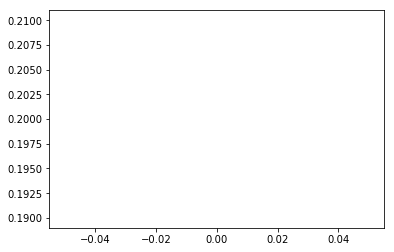

A02077
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


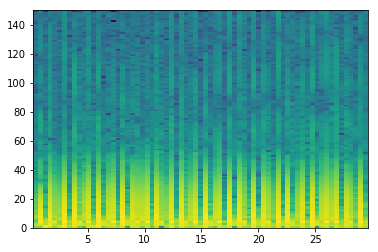

good List
[0, 2, 5, 7, 12, 14, 17, 19, 20, 22, 24, 27, 29, 31, 32, 34, 36, 39, 41, 44, 46, 49, 51, 53, 54, 56, 58, 61, 63, 65, 66, 68]
[2, 3, 2, 5, 2, 3, 2, 1, 2, 2, 3, 2, 2, 1, 2, 2, 3, 2, 3, 2, 3, 2, 2, 1, 2, 2, 3, 2, 2, 1, 2]
the temp 3
[[], [], [], [], [], [], [], [8], [], [], [], [], [14], [], [], [], [], [], [], [], [], [24], [], [], [], [], [30]]
[19, 20]
longest
[19, 20]
indexList
[19, 20]
theMin
2400
theMax
2700


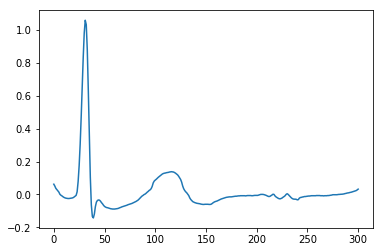

A02084
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


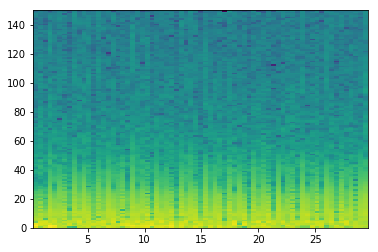

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


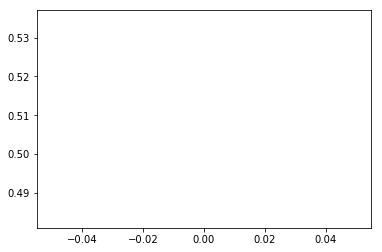

A02090
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


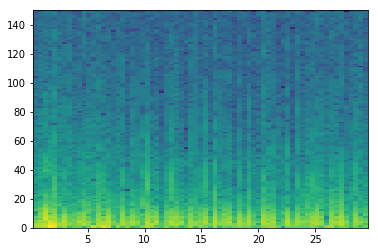

good List
[0, 8, 16, 18, 19, 24, 25, 26, 27, 29, 30, 31, 34, 36, 39, 41, 42, 43, 45, 46, 47, 50, 51, 53, 55, 60, 62, 64, 65, 68]
[8, 8, 2, 1, 5, 1, 1, 1, 2, 1, 1, 3, 2, 3, 2, 1, 1, 2, 1, 1, 3, 1, 2, 2, 5, 2, 2, 1, 3]
the temp 3
[[], [], [], [4], [6, 7, 8], [10, 11], [], [], [], [16, 17], [19, 20], [22], [], [], [], [], [28]]
[24, 25, 26, 27]
longest
[24, 25, 26, 27]
indexList
[24, 25, 26, 27]
theMin
3000
theMax
3300


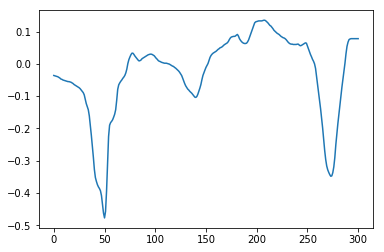

A02091
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


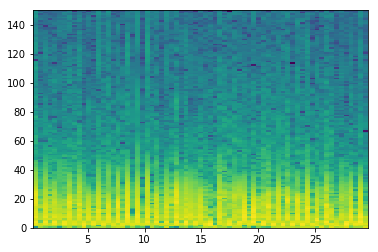

good List
[5, 11, 12, 20, 26, 30, 37, 62, 64, 68]
[6, 1, 8, 6, 4, 7, 25, 2, 4]
the temp 3
[[], [2], [], [], [], [], [], []]
[11, 12]
longest
[11, 12]
indexList
[11, 12]
theMin
1500
theMax
1800


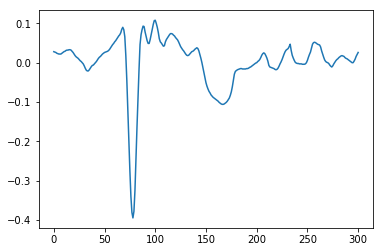

A02092
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


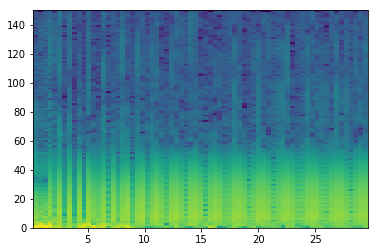

good List
[8]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


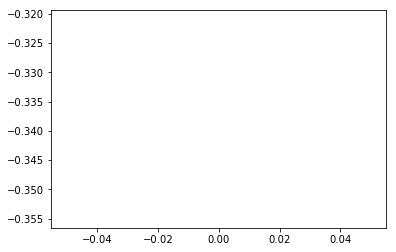

A02101
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


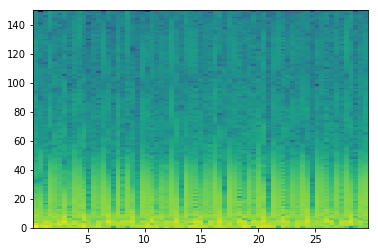

good List
[11, 16, 18, 21, 26, 30, 48, 52, 56, 57, 61, 63]
[5, 2, 3, 5, 4, 18, 4, 4, 1, 4, 2]
the temp 3
[[], [], [], [], [], [], [], [], [9], []]
[56, 57]
longest
[56, 57]
indexList
[56, 57]
theMin
7200
theMax
7500


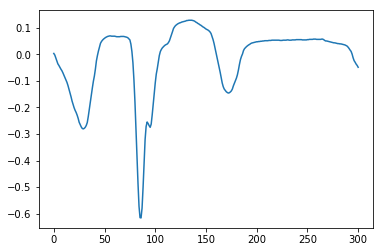

A02103
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


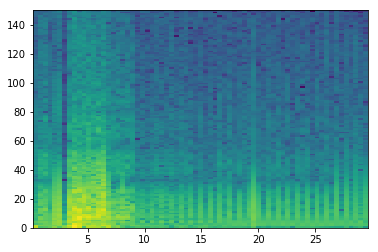

good List
[6, 21, 33, 35, 36, 37, 39, 41, 46, 47, 49, 52, 53, 57, 61, 63, 65, 68]
[15, 12, 2, 1, 1, 2, 2, 5, 1, 2, 3, 1, 4, 4, 2, 2, 3]
the temp 3
[[], [], [], [4, 5], [], [], [9], [], [12], [], [], [], []]
[35, 36, 37]
longest
[35, 36, 37]
indexList
[35, 36, 37]
theMin
4500
theMax
4800


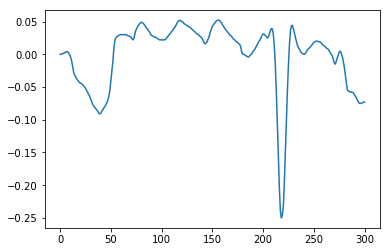

A02105
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


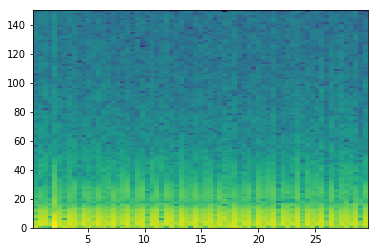

good List
[20, 36, 37, 48, 53, 60, 67]
[16, 1, 11, 5, 7, 7]
the temp 3
[[], [2], [], [], []]
[36, 37]
longest
[36, 37]
indexList
[36, 37]
theMin
4500
theMax
4800


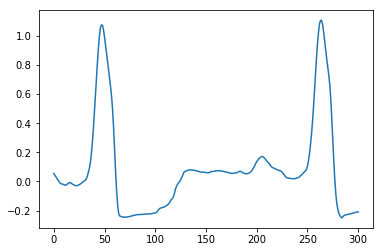

A02107
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

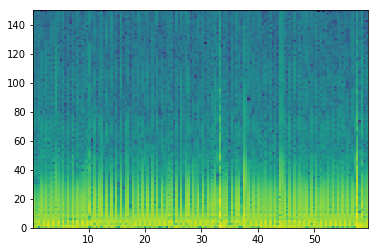

good List
[1, 2, 7, 11, 13, 15, 17, 19, 20, 24, 26, 29, 31, 32, 33, 35, 37, 40, 41, 42, 44, 45, 47, 48, 50, 52, 53, 54, 55, 58, 59, 60, 62, 65, 66, 67, 71, 73, 81, 83, 86, 89, 90, 92, 93, 95, 97, 99, 101, 105, 107, 109, 113, 114, 116, 118, 122, 123, 125, 131, 132, 137]
[1, 5, 4, 2, 2, 2, 2, 1, 4, 2, 3, 2, 1, 1, 2, 2, 3, 1, 1, 2, 1, 2, 1, 2, 2, 1, 1, 1, 3, 1, 1, 2, 3, 1, 1, 4, 2, 8, 2, 3, 3, 1, 2, 1, 2, 2, 2, 2, 4, 2, 2, 4, 1, 2, 2, 4, 1, 2, 6, 1, 5]
the temp 3
[[1], [], [], [], [], [], [8], [], [], [], [13, 14], [], [], [18, 19], [21], [23], [], [26, 27, 28], [30, 31], [], [34, 35], [], [], [], [], [], [42], [44], [], [], [], [], [], [], [], [53], [], [], [57], [], [60]]
[52, 53, 54, 55]
longest
[52, 53, 54, 55]
indexList
[52, 53, 54, 55]
theMin
6600
theMax
6900


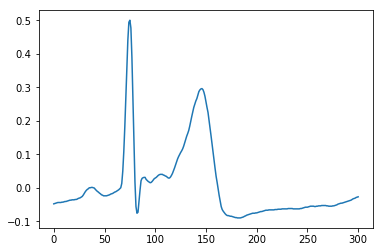

A02111
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


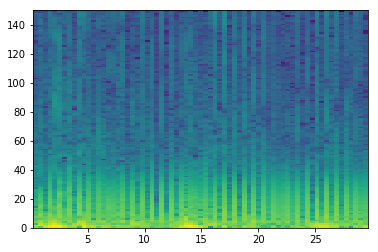

good List
[19, 23, 25, 27, 49, 50, 51, 53, 55, 56, 57, 59, 63]
[4, 2, 2, 22, 1, 1, 2, 2, 1, 1, 2, 4]
the temp 3
[[], [], [], [], [5, 6], [], [9, 10], []]
[49, 50, 51]
longest
[49, 50, 51]
indexList
[49, 50, 51]
theMin
6300
theMax
6600


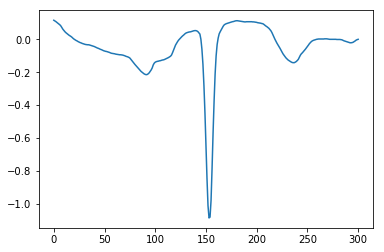

A02112
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


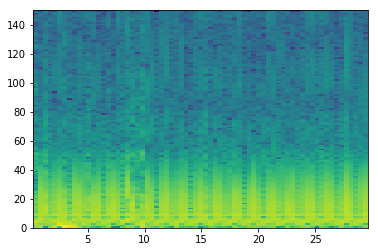

good List
[43]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


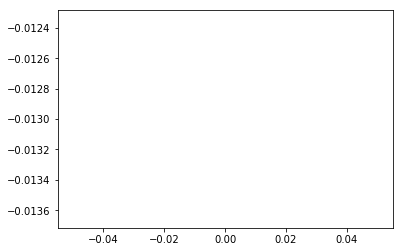

A02114
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6       ]


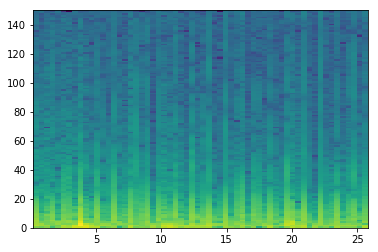

good List
[10, 21, 26, 27, 29, 32, 33, 35, 38, 41, 43, 44, 49, 50, 52, 53, 55, 56, 58, 59]
[11, 5, 1, 2, 3, 1, 2, 3, 3, 2, 1, 5, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [], [3], [], [6], [], [], [], [11], [13], [15], [17]]
[26, 27]
longest
[26, 27]
indexList
[26, 27]
theMin
3300
theMax
3600


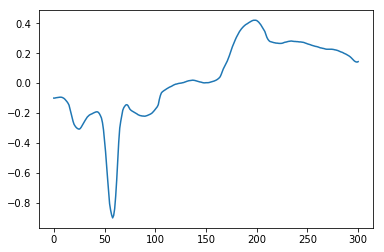

A02117
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


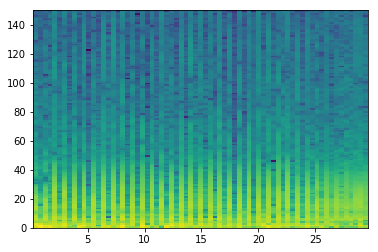

good List
[7, 9, 19, 21, 23, 25, 29, 31, 41, 43, 45, 55]
[2, 10, 2, 2, 2, 4, 2, 10, 2, 2, 10]
the temp 3
[[], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


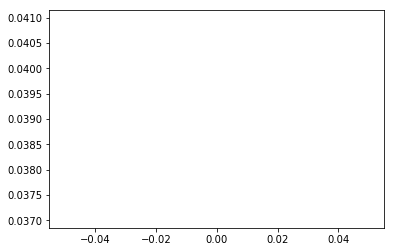

A02118
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

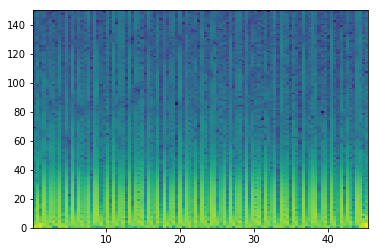

good List
[7, 9, 11, 13, 18, 21, 24, 29, 31, 35, 38, 40, 42, 45, 47, 52, 55, 61, 66, 68, 72, 75, 77, 81, 84, 86, 90, 93, 96, 101]
[2, 2, 2, 5, 3, 3, 5, 2, 4, 3, 2, 2, 3, 2, 5, 3, 6, 5, 2, 4, 3, 2, 4, 3, 2, 4, 3, 3, 5]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


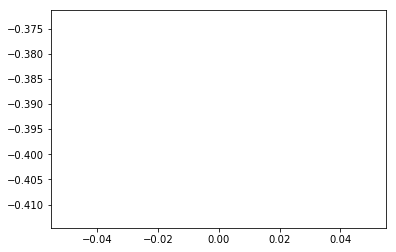

A02121
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2       ]


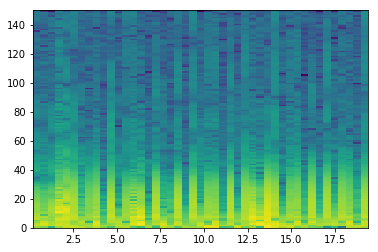

good List
[1, 2, 6, 7, 9, 11, 12, 15, 16, 17, 18, 20, 23, 25, 27, 30, 33, 36, 38, 40, 43]
[1, 4, 1, 2, 2, 1, 3, 1, 1, 1, 2, 3, 2, 2, 3, 3, 3, 2, 2, 3]
the temp 3
[[1], [3], [], [6], [8, 9, 10], [], [], [], [], [], [], [], [], []]
[15, 16, 17, 18]
longest
[15, 16, 17, 18]
indexList
[15, 16, 17, 18]
theMin
1800
theMax
2400


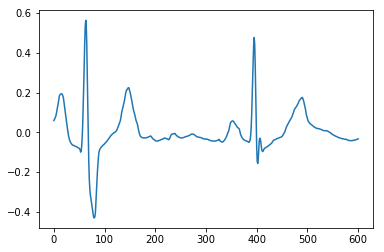

A02129
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


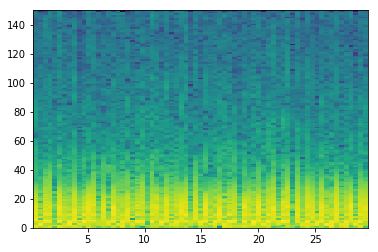

good List
[]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


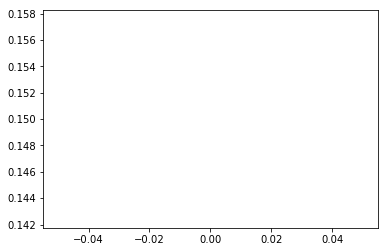

A02152
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


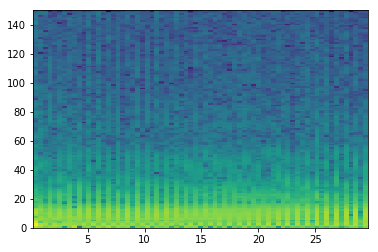

good List
[2, 4, 6, 10, 14, 16, 18, 20, 24, 26, 28, 32, 40, 41, 53, 57, 59, 61, 63, 65, 67]
[2, 2, 4, 4, 2, 2, 2, 4, 2, 2, 4, 8, 1, 12, 4, 2, 2, 2, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [], [], [13], [], [], [], [], [], []]
[40, 41]
longest
[40, 41]
indexList
[40, 41]
theMin
5100
theMax
5400


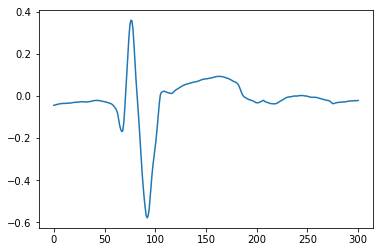

A02153
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


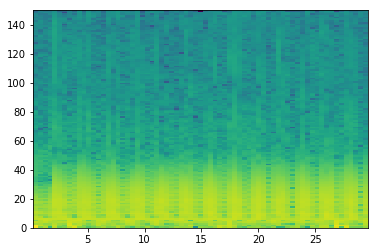

good List
[20]
[]
the temp 3
[]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


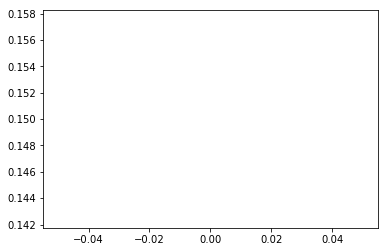

A02157
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


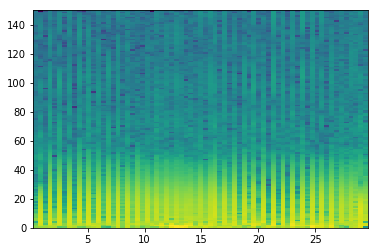

good List
[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 23, 24, 26, 28, 31, 33, 38, 39, 40, 42, 46, 48, 50, 52, 54, 56, 58, 59, 60]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 1, 2, 2, 3, 2, 5, 1, 1, 2, 4, 2, 2, 2, 2, 2, 2, 1, 1]
the temp 3
[[], [], [], [], [], [], [], [], [], [], [11], [], [], [], [], [17, 18], [], [], [], [], [], [], []]
[38, 39, 40]
longest
[38, 39, 40]
indexList
[38, 39, 40]
theMin
4800
theMax
5100


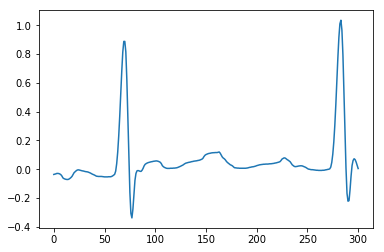

A02158
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

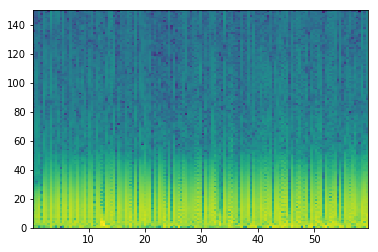

good List
[0, 3, 6, 8, 10, 11, 14, 16, 19, 20, 25, 34, 36, 37, 41, 43, 47, 49, 51, 54, 55, 57, 59, 61, 63, 64, 65, 66, 70, 71, 72, 73, 78, 80, 84, 85, 88, 90, 99, 106, 108, 112, 114, 120, 126, 128, 134, 135]
[3, 3, 2, 2, 1, 3, 2, 3, 1, 5, 9, 2, 1, 4, 2, 4, 2, 2, 3, 1, 2, 2, 2, 2, 1, 1, 1, 4, 1, 1, 1, 5, 2, 4, 1, 3, 2, 9, 7, 2, 4, 2, 6, 6, 2, 6, 1]
the temp 3
[[], [], [], [], [5], [], [], [9], [], [], [13], [], [], [], [], [], [20], [], [], [], [25, 26, 27], [29, 30, 31], [], [], [35], [], [], [], [], [], [], [], [], [], []]
[63, 64, 65, 66]
longest
[63, 64, 65, 66]
indexList
[63, 64, 65, 66]
theMin
8100
theMax
8400


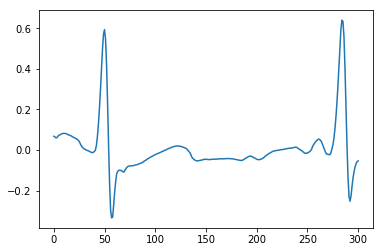

A02163
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


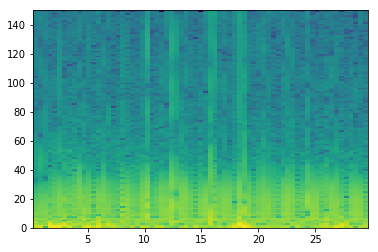

good List
[16, 25, 33, 35, 38, 40, 45, 54, 57, 58]
[9, 8, 2, 3, 2, 5, 9, 3, 1]
the temp 3
[[], [], [], [], [], [], [], []]
[]
longest
[]
indexList
[]
theMin
0
theMax
0


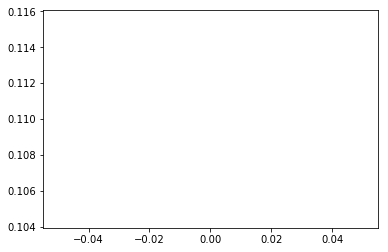

A02164
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667]


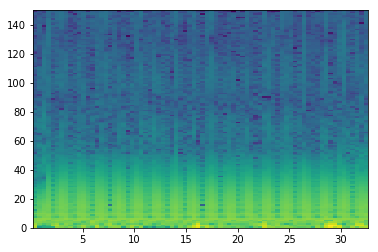

good List
[21, 31, 34, 37, 38, 51, 59, 63, 64]
[10, 3, 3, 1, 13, 8, 4, 1]
the temp 3
[[], [], [], [4], [], []]
[37, 38]
longest
[37, 38]
indexList
[37, 38]
theMin
4800
theMax
5100


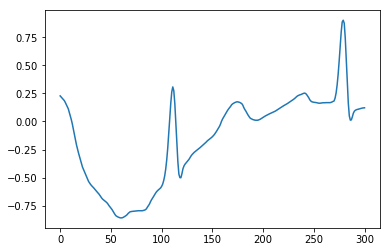

A02170
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


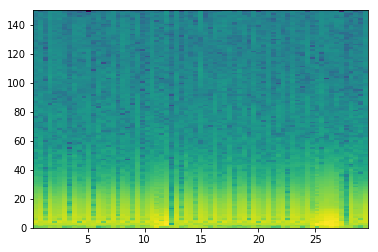

good List
[2, 7, 9, 10, 12, 17, 19, 22, 28, 30, 32, 36, 38, 44, 52]
[5, 2, 1, 2, 5, 2, 3, 6, 2, 2, 4, 2, 6, 8]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], [], [], []]
[9, 10]
longest
[9, 10]
indexList
[9, 10]
theMin
1200
theMax
1500


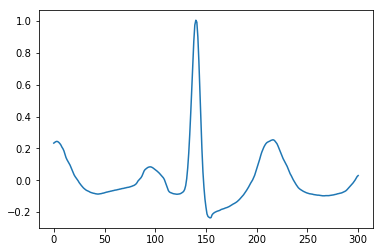

A02171
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


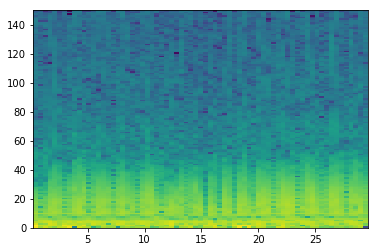

good List
[6, 19, 21, 29, 31, 32, 34, 35, 44, 68]
[13, 2, 8, 2, 1, 2, 1, 9, 24]
the temp 3
[[], [], [], [], [5], [7], []]
[31, 32]
longest
[31, 32]
indexList
[31, 32]
theMin
3900
theMax
4200


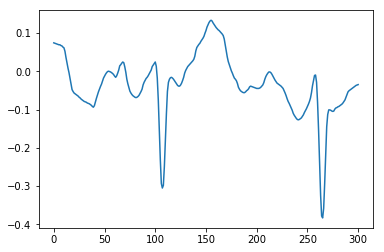

A02176
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


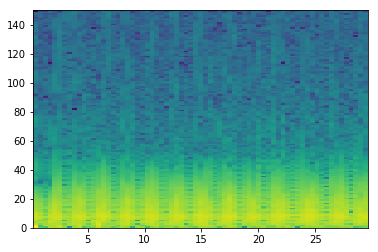

good List
[31, 32, 35, 43]
[1, 3, 8]
the temp 3
[[1], []]
[31, 32]
longest
[31, 32]
indexList
[31, 32]
theMin
3900
theMax
4200


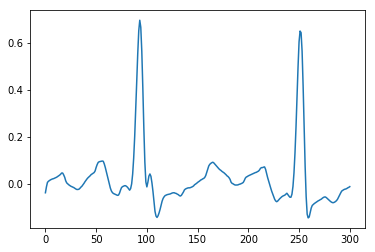

A02177
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


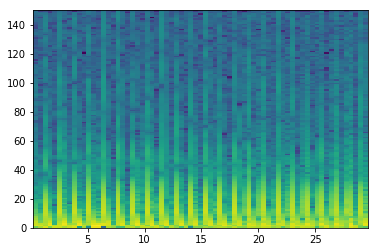

good List
[0, 1, 3, 4, 7, 9, 10, 12, 13, 15, 16, 19, 21, 22, 25, 27, 28, 30, 31, 34, 36, 37, 39, 40, 42, 43, 45, 46, 48, 49, 51, 52, 54, 55, 57, 60, 63, 66, 68]
[1, 2, 1, 3, 2, 1, 2, 1, 2, 1, 3, 2, 1, 3, 2, 1, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 3, 3, 2]
the temp 3
[[1], [3], [], [6], [8], [10], [], [13], [], [16], [18], [], [21], [23], [25], [27], [29], [31], [33], [], [], [], []]
[0, 1]
longest
[0, 1]
indexList
[0, 1]
theMin
0
theMax
300


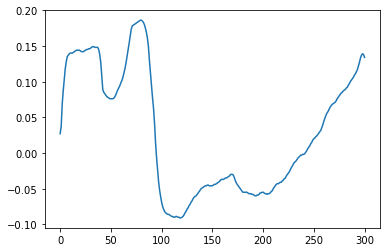

A02180
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


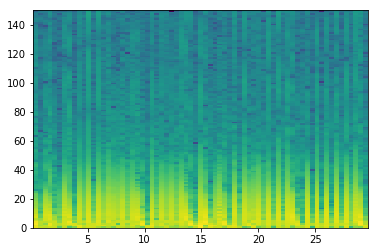

good List
[1, 4, 5, 8, 10, 12, 14, 19, 23, 26, 27, 33, 36, 40, 42, 44, 47, 49, 51, 54, 57, 59, 61, 68]
[3, 1, 3, 2, 2, 2, 5, 4, 3, 1, 6, 3, 4, 2, 2, 3, 2, 2, 3, 3, 2, 2, 7]
the temp 3
[[], [2], [], [], [], [], [], [], [10], [], [], [], [], [], [], [], [], [], [], [], []]
[4, 5]
longest
[4, 5]
indexList
[4, 5]
theMin
600
theMax
900


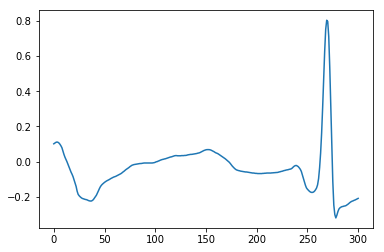

A02187
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

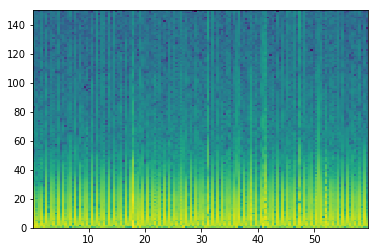

good List
[2, 4, 6, 9, 11, 16, 23, 25, 27, 28, 30, 32, 37, 39, 46, 48, 53, 55, 73, 75, 77, 79, 82, 88, 97, 98, 100, 102, 109, 113, 116, 120, 125, 129, 134, 136, 138]
[2, 2, 3, 2, 5, 7, 2, 2, 1, 2, 2, 5, 2, 7, 2, 5, 2, 18, 2, 2, 2, 3, 6, 9, 1, 2, 2, 7, 4, 3, 4, 5, 4, 5, 2, 2]
the temp 3
[[], [], [], [], [], [], [], [], [9], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [25], [], [], [], [], [], [], [], [], [], []]
[27, 28]
longest
[27, 28]
indexList
[27, 28]
theMin
3300
theMax
3600


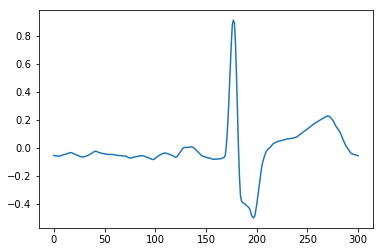

A02192
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44      ]


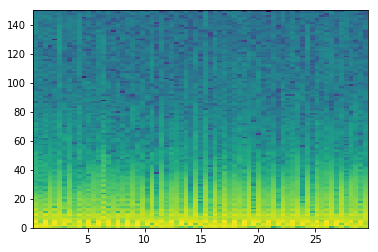

good List
[8, 12, 16, 17, 20, 23, 25, 27, 32, 34, 36, 40, 45, 47, 50, 51, 55, 57, 61, 63, 64]
[4, 4, 1, 3, 3, 2, 2, 5, 2, 2, 4, 5, 2, 3, 1, 4, 2, 4, 2, 1]
the temp 3
[[], [], [3], [], [], [], [], [], [], [], [], [], [], [15], [], [], []]
[16, 17]
longest
[16, 17]
indexList
[16, 17]
theMin
2100
theMax
2400


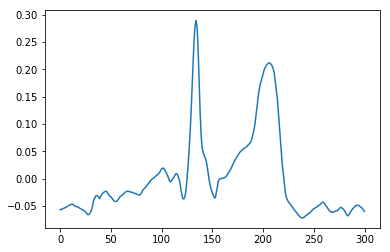

A02193
[  0.42666667   0.85333333   1.28         1.70666667   2.13333333
   2.56         2.98666667   3.41333333   3.84         4.26666667
   4.69333333   5.12         5.54666667   5.97333333   6.4
   6.82666667   7.25333333   7.68         8.10666667   8.53333333
   8.96         9.38666667   9.81333333  10.24        10.66666667
  11.09333333  11.52        11.94666667  12.37333333  12.8
  13.22666667  13.65333333  14.08        14.50666667  14.93333333
  15.36        15.78666667  16.21333333  16.64        17.06666667
  17.49333333  17.92        18.34666667  18.77333333  19.2
  19.62666667  20.05333333  20.48        20.90666667  21.33333333
  21.76        22.18666667  22.61333333  23.04        23.46666667
  23.89333333  24.32        24.74666667  25.17333333  25.6
  26.02666667  26.45333333  26.88        27.30666667  27.73333333
  28.16        28.58666667  29.01333333  29.44        29.86666667
  30.29333333  30.72        31.14666667  31.57333333  32.
  32.42666667  32.85333333  33.28      

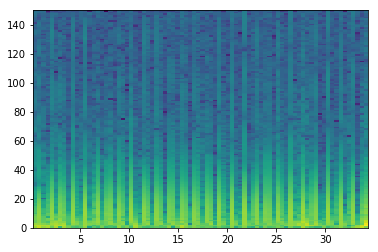

good List
[3, 5, 8, 10, 11, 13, 14, 16, 17, 19, 22, 24, 25, 26, 27, 28, 30, 31, 34, 37, 40, 42, 43, 45, 46, 48, 49, 51, 52, 54, 57, 59, 60, 62, 63, 66, 68, 69, 71, 72, 74, 75, 77, 78]
[2, 3, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 1, 1, 1, 2, 1, 3, 3, 3, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 2, 1, 2, 1, 3, 2, 1, 2, 1, 2, 1, 2, 1]
the temp 3
[[], [], [], [4], [6], [8], [], [], [12, 13, 14, 15], [17], [], [], [], [22], [24], [26], [28], [], [], [32], [34], [], [37], [39], [41]]
[24, 25, 26, 27, 28]
longest
[24, 25, 26, 27, 28]
indexList
[24, 25, 26, 27, 28]
theMin
3000
theMax
3600


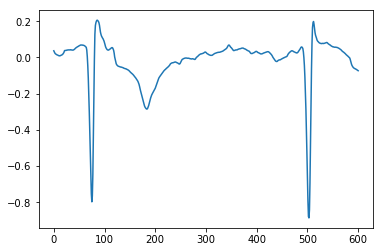

In [7]:
theCSV = open("600_set_of_Norm_AF_Rand_O.csv")
lineSkip = 0
for line in theCSV:
            #remove whitespace
    line = line.strip()
            #split up based off commas
    a,b,c,d,e = line.split(",")
            #if not at first line
    if(lineSkip != 0):
                #create plot diagram with ID at that line
        theStart(d)
    lineSkip += 1
#theStart("A00033")